In [3]:
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
from sklearn.decomposition import PCA
from mpl_toolkits.mplot3d import Axes3D
from sklearn import cluster, datasets
from pandas import DataFrame as df
from IPython.display import clear_output

from sklearn.metrics import mean_squared_error
from sklearn.model_selection import learning_curve

import keras
from keras.models import load_model
from keras.models import Sequential
from keras.layers import Dense, Dropout, Activation
from keras.layers.core import  Activation, Dropout  
from keras.optimizers import RMSprop
from keras.layers import Embedding, RepeatVector
from keras.layers import LSTM
from keras.layers.recurrent import GRU
from keras.optimizers import SGD
from sklearn.preprocessing import MinMaxScaler

import DailyMLPModel as D
import DailyNNModel as DNN
import DailyNeuralNetworkModel1 as DNNm
from DailyNeuralNetworkModel1 import getWinterForecastingResults


import datetime

%matplotlib inline
#%matplotlib qt
%config InlineBackend.figure_format = 'retina'

/Users/mac/anaconda/lib/python2.7/site-packages/h5py/__init__.py:34: FutureWarning: Conversion of the second argument of issubdtype from `float` to `np.floating` is deprecated. In future, it will be treated as `np.float64 == np.dtype(float).type`.
  from ._conv import register_converters as _register_converters
Using Theano backend.


In [4]:
def import_data():
    dataset = pd.read_csv('../data/DP.csv',usecols=[27],engine='python')
    return dataset
def mean_absolute_percentage_error(y_true, y_pred): 

    ## Note: does not handle mix 1d representation
    #if _is_1d(y_true): 
    #    y_true, y_pred = _check_1d_array(y_true, y_pred)
    return np.mean(np.abs((y_true - y_pred) / y_true)) * 100

def mean_absolute_error(y_true, y_pred): 

    ## Note: does not handle mix 1d representation
    #if _is_1d(y_true): 
    #    y_true, y_pred = _check_1d_array(y_true, y_pred)
    return np.mean(np.abs((y_true - y_pred) )) 

def rmse(predictions, targets):
    return np.sqrt(((predictions - targets) ** 2).mean())

def prepareInputs(daydata, season, UsedInputs,testPeriod):
    nbrInputs= 0
    
    previousHours = UsedInputs[0]
    timeSteps = int(UsedInputs[1])
    previousDay = UsedInputs[2]
    previousWeek = UsedInputs[3]
    temp = UsedInputs[4]
    tempMax = UsedInputs[5]
    tempMin = UsedInputs[6]
    dayIndicator = UsedInputs[7]
    HourIndicator= UsedInputs[8]
#     monthIndicator = UsedInputs[9]

    if previousHours == True: 
        nbrInputs = nbrInputs + int(timeSteps)
    if previousDay == True: nbrInputs= nbrInputs+1
    if previousWeek == True : nbrInputs= nbrInputs+ 1
    if temp == True: nbrInputs= nbrInputs+1
    if tempMax == True: nbrInputs= nbrInputs+1
    if tempMin == True: nbrInputs= nbrInputs+1
    if dayIndicator== True: nbrInputs= nbrInputs+7
    if HourIndicator== True : nbrInputs= nbrInputs+24
#     if monthIndicator== True : nbrInputs= nbrInputs + 12
    
    hourclusters= np.empty([(daydata.index.size*24),1])

    hourdataindex= pd.DataFrame(index=pd.date_range('2014-1-8 00:00:00', periods=(365)*24, freq='H'))

    for x in range(0,daydata.index.size):
        for y in range(0,24):
            hourclusters[(x * 24) + y,0] = daydata.iloc[x,24]
    hourclusters.size

    tempAlgiers=  pd.read_csv('../data/tempAlgiers.csv')
    tempA= tempAlgiers.loc[:,'Hour_1':'Hour_24']
    tempnp= np.array(tempA)
    tempnp= tempnp.reshape(-1,1)
    tempdata= pd.DataFrame(tempnp)

    tempmax= tempAlgiers.loc[:,'Tmax']
    tempmin= tempAlgiers.loc[:,'Tmin']




    tempmx= np.random.random([tempmax.size*24,1])
    tempmn= np.random.random([tempmin.size*24,1])



    for x in range(0,tempmax.size):
        for y in range(0,24):
            tempmx[(x * 24) + y,0] = tempmax.iloc[x]

    for x in range(0,tempmin.size):
        for y in range(0,24):
            tempmn[(x * 24) + y,0] = tempmin.iloc[x]
        

    samples = daydata.index.size*24
    daydata2= daydata.copy()
    del(daydata2['cluster'])

    data= pd.DataFrame(np.array(daydata2).reshape(-1,1))

    maxcons= data.values.max()
    mincons= data.values.min()

    maxtemp= np.max(tempdata.values)
    mintemp= tempdata.values.min()

    maxtempmax= np.max(tempmx)
    mintempmax= np.min(tempmx)

    maxtempmin= np.max(tempmn)
    mintempmin= np.min(tempmn)

    sigxx= np.empty((samples - 168 , nbrInputs))
    sigyy= np.empty((samples - 168 , 1))

    i= 0
    for x in list(range(168,samples)):
        i=0
        if previousHours == True: 
            for y in list(range(timeSteps)):
                sigxx[x - 168 , i] = (data.iloc[x - i - 1 , 0])/(2*maxcons)
                i= i + 1
        if previousDay == True: 
            sigxx[x - 168 , i] = (data.iloc[x - 24 , 0])/(2*maxcons)
            i= i+1
        if previousWeek == True : 
            sigxx[x - 168 , i] = (data.iloc[x - 168 , 0])/(2*maxcons)
            i= i+ 1
        if temp == True: 
            sigxx[x - 168 , i] = (tempdata.iloc[x])/(2*maxtemp)
            i= i+1
        if tempMax == True: 
            sigxx[x - 168 , i] = (tempmx[x]) / (2 * maxtempmax)
            i= i+1
        if tempMin == True: 
            sigxx[x - 168 , i] = (tempmn[x]) / (2 * maxtempmin)
            i= i+1
        if dayIndicator == True:
            ind=0
            for y in range(0,7):
                sigxx[x - 168 , i + ind] = 0
                ind = ind + 1
            sigxx[x - 168 , i + pd.datetime.weekday(hourdataindex.index[x])]=1
            i = i + 7
        if HourIndicator == True:
            ind=0
            for y in range(0,24):
                sigxx[x - 168 , i+ind]= 0
                ind = ind + 1
            sigxx[x - 168 , i + hourdataindex.index[x].hour]=1
            i= i + 24
#         if monthIndicator == True:
#             ind=0
#             for y in range(0,12):
#                 sigxx[x - 168 , i + ind] = 0
#                 ind = ind + 1
#             sigxx[x - 168 , i + hourdataindex.index[x].month - 1]=1
#             i = i + 12
    
    for x in list(range(168,samples)):
        sigyy[x - 168 , 0]= (data.iloc[x , 0])/(2*maxcons)

    sigmoidxx= df(sigxx.copy())
    sigmoidyy= df(sigyy.copy())

    sigmoidxx.index= pd.date_range('2014-1-8 00:00:00', periods=(365-7)*24, freq='H')
    sigmoidyy.index= pd.date_range('2014-1-8 00:00:00', periods=(365-7)*24, freq='H')

    sigmoidxx['cluster'] = hourclusters[168:]
    sigmoidyy['cluster'] = hourclusters[168:]
    
    dfhourclusters = df(hourclusters)
    
    SigmoidInputs =sigmoidxx[sigmoidxx.cluster==season].copy()
    
    SigmoidOutputs= sigmoidyy[sigmoidyy.cluster==SigmoidInputs.loc[SigmoidInputs.index[0],'cluster']]
    del(SigmoidInputs['cluster'],SigmoidOutputs['cluster'])
    learningoutputs = pd.DataFrame(SigmoidOutputs.iloc[:int(SigmoidOutputs.size-testPeriod)].values.copy(),
                            index=SigmoidOutputs.iloc[:int(SigmoidOutputs.size-testPeriod)].index)
    testoutputs = pd.DataFrame(SigmoidOutputs.iloc[int(SigmoidOutputs.size-testPeriod):].values.copy(),
                            index=SigmoidOutputs.iloc[int(SigmoidOutputs.size-testPeriod):].index)

    learninginputs = pd.DataFrame(SigmoidInputs.iloc[:int(SigmoidOutputs.size-testPeriod)].values.copy(),
                            index=SigmoidOutputs.iloc[:int(SigmoidOutputs.size-testPeriod)].index)
    testinputs = pd.DataFrame(SigmoidInputs.iloc[int(SigmoidOutputs.size-testPeriod):].values.copy(),
                            index=SigmoidOutputs.iloc[int(SigmoidOutputs.size-testPeriod):].index)

    print('-------Input preparation process complet-------')
    return learninginputs, learningoutputs, testinputs, testoutputs, nbrInputs

[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 4. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 4. 0. 0. 0. 0. 0. 0. 0.
 4. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 4. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 4. 4. 4. 1.
 1. 4. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2.
 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2.
 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2.
 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 3. 3. 3. 3. 3. 3. 3. 3. 3. 3. 3. 3. 3.
 3. 3. 3. 3. 3. 3. 3. 3. 3. 3. 3. 3. 3. 3. 3. 3. 4. 2. 2. 2. 2. 2. 2. 2.
 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2.
 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2.
 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2.
 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 4. 4. 2. 1. 1. 4. 1.
 1. 4. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1.

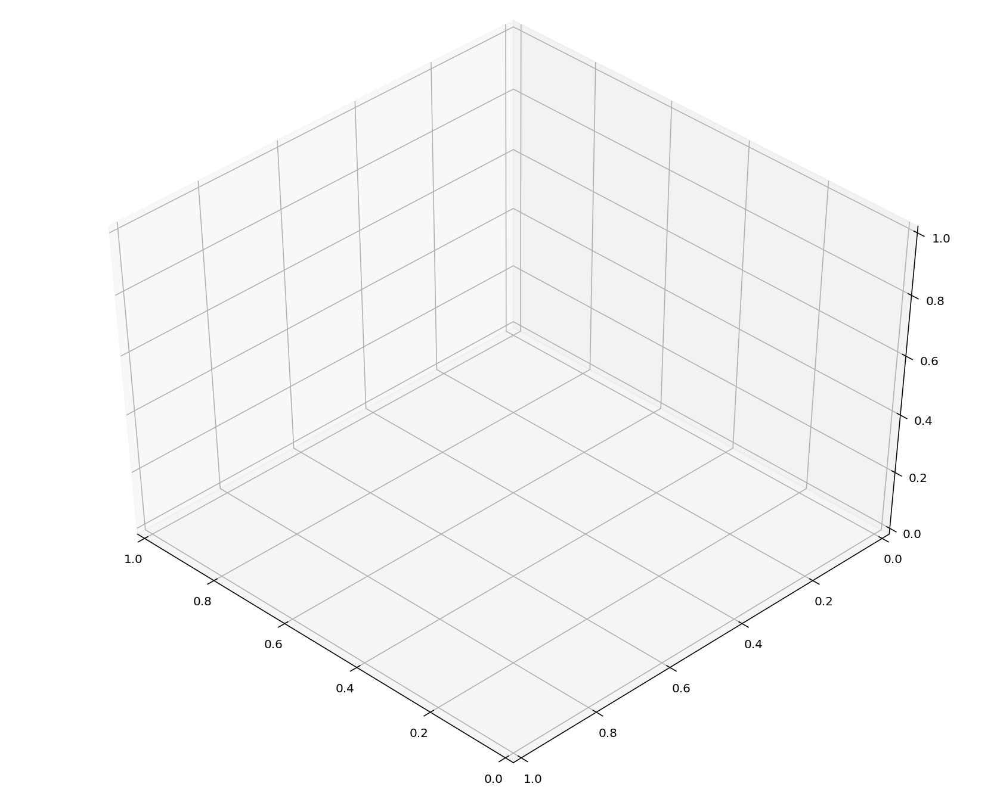

In [5]:
data = import_data()
data= np.array(data)
data= data.reshape(-1,24)

daydata= df(data)
daydata.index= pd.date_range('2014-1-1', periods=365, freq='D')

clusters= np.loadtxt('../data/Mixed_4_Clusters',delimiter=',')

pca= PCA(n_components=3)
pca.fit(daydata)
data_pca =  pca.transform(daydata)

# pdClusters= pd.DataFrame(clusters,index=daydata.index)
print(clusters)



fig = plt.figure(1, figsize=(12, 9))

ax = Axes3D(fig, rect=[0, 0, .95, 1], elev=45, azim=135)

dayofweek = pd.DatetimeIndex(daydata.index).dayofweek

# ax.scatter(data_pca[:,0],data_pca[:,1],data_pca[:,2],cmap=plt.cm.spectral,c=clusters,alpha= 0.4)

# plt.show()


daydata['cluster']=clusters

In [6]:
testPeriod= 360

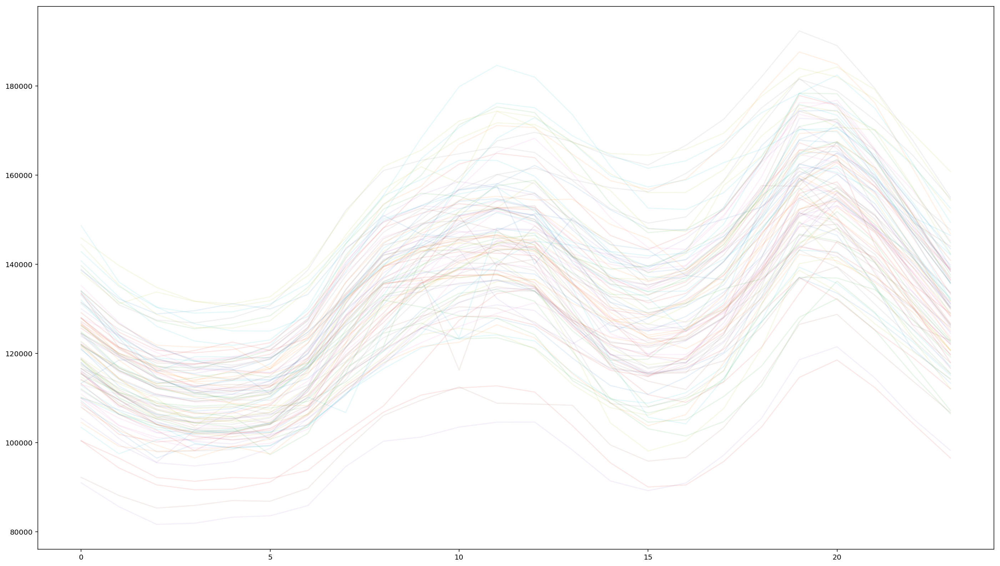

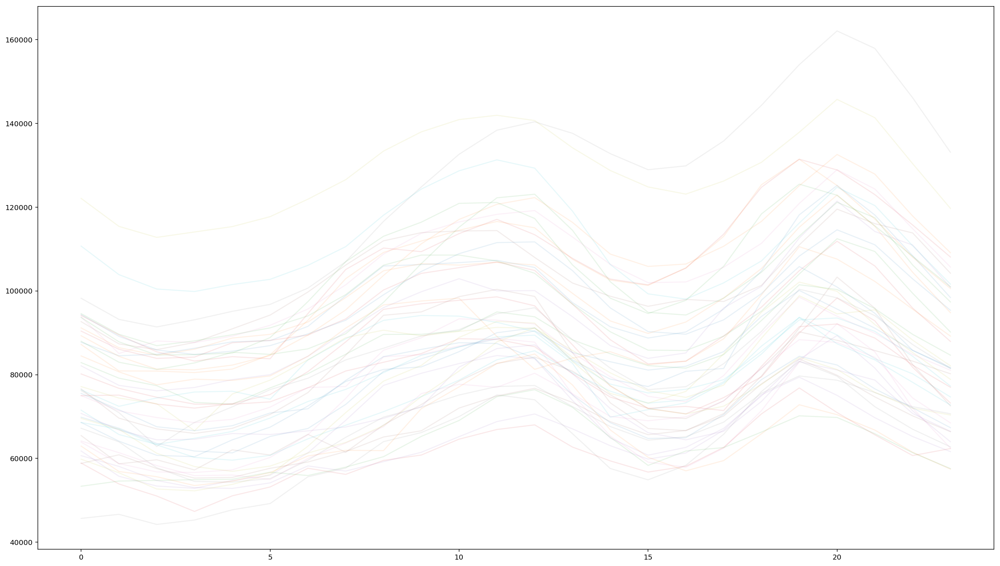

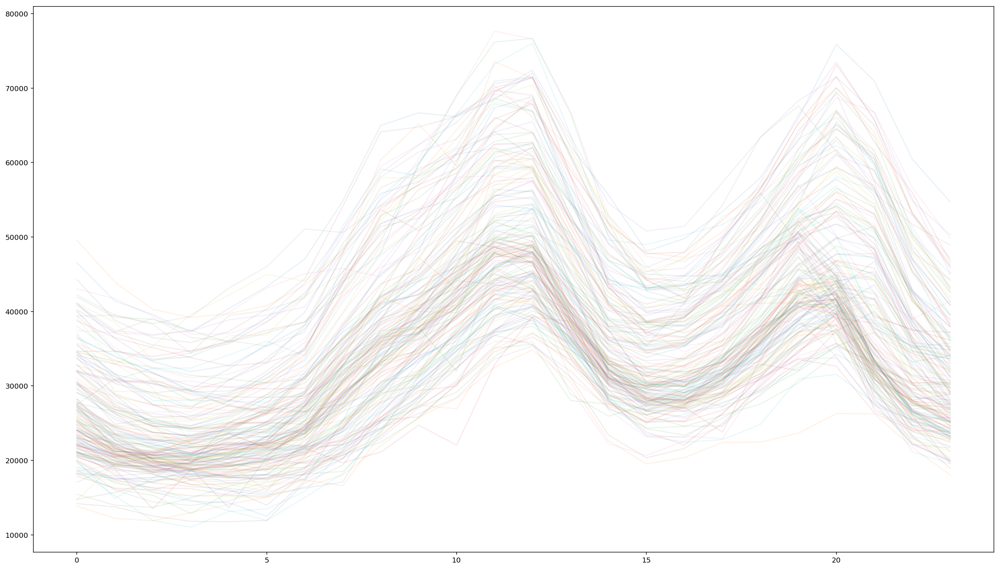

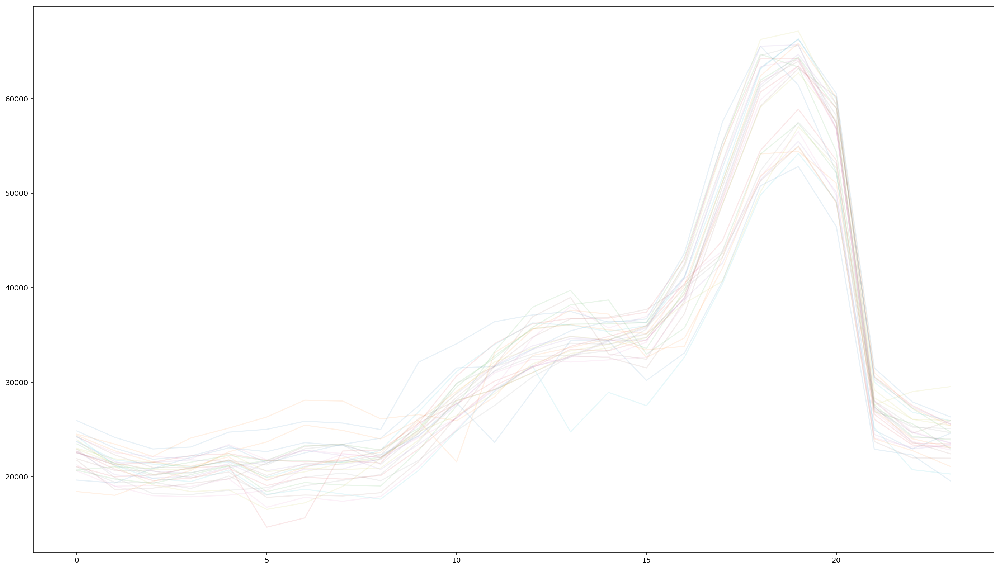

In [7]:

temp=daydata.copy()
del(temp['cluster'])

plt.figsize=(24,14)
temp[daydata.cluster==0].transpose().plot( alpha=0.1,figsize=(24,14),legend=None)

temp[daydata.cluster==1].transpose().plot( alpha=0.1,figsize=(24,14),legend=None)

temp[daydata.cluster==2].transpose().plot( alpha=0.1,figsize=(24,14),legend=None)

temp[daydata.cluster==3].transpose().plot( alpha=0.1,figsize=(24,14),legend=None)


plt.show()

In [8]:
def create_Train_MLP_NN_Model(inputx1,outputx1,inputx2,outputx2,n_features,HiddenNeurons1=None,HiddenNeurons2=None
                              ,LearningRate=None,Epoch=None,Optimizer=None, timeSteps= None):
    
    if HiddenNeurons1 is None: HiddenNeurons1 = 10
    if HiddenNeurons2 is None: HiddenNeurons2 = 5
    if LearningRate is None: LearningRate = 0.001
    if Epoch is None: Epoch = 500
    if Optimizer is None: Opitimizer = 'Adam'
    if timeSteps is None: timeSteps = 1
        
    mlpmodel = Sequential()
    # Dense(64) is a fully-connected layer with 64 hidden units.
    # in the first layer, you must specify the expected input data shape:
    # here, 20-dimensional vectors.
    mlpmodel.add(LSTM(units= HiddenNeurons1, return_sequences=True, activation='sigmoid', input_shape=(timeSteps, n_features)))  # returns a sequence of vectors of dimension 32
    mlpmodel.add(LSTM(units= HiddenNeurons2, activation='sigmoid', return_sequences=False))  # returns a sequence of vectors of dimension 32
    mlpmodel.add(Dense(1, init='uniform',activation='sigmoid'))
    mlpmodel.compile(optimizer=Optimizer, loss='mse')
#     mlpmodel.add(Dense(HiddenNeurons1, input_dim=inputx1.shape[1],activation='sigmoid'))
#     mlpmodel.add(Dense(HiddenNeurons2, init='uniform'))
#     mlpmodel.add(Dense(1, init='uniform'))
#     mlpmodel.add(Activation('sigmoid'))

#     sgd = SGD(lr=LearningRate, decay=1e-6, momentum=0.9, nesterov=True)
#     mlpmodel.compile(loss='mse', optimizer=Optimizer)

    tempMLPmodels= np.empty((Epoch),dtype=object)
    tempErrorHistory= np.empty((Epoch),dtype=object)

    counter=0
    for i in range(0,Epoch):
        print('epoch:   %d .' %counter)
        ErrorHistory= mlpmodel.fit(x=inputx1.reshape(-1,1,n_features), y=outputx1, epochs=1,batch_size=12
                                   ,validation_data=(inputx2.reshape(-1,1,n_features),outputx2),verbose= 2)
        tempMLPmodels[i]= mlpmodel
        mlpmodel.save('temp/lstm_%d_%s'%(i,season))
        tempErrorHistory[i]=ErrorHistory.history['val_loss']
        counter = counter +1    
    print('==============================================================================')
    print('\t \t LSTM model is ready for forecasting')
    print('==============================================================================')
    
    
    return tempMLPmodels, tempErrorHistory, mlpmodel

def getForecastingResults(tempMLPmodels, tempErrorHistory, learninginputs, learningoutputs, testinputs, testoutputs, Model, nbrInputs, IsShift, previoushour, season, timeSteps):
        
    predictionPeriod = learninginputs.index.size
    temp=learninginputs.iloc[:predictionPeriod].resample('D').sum()
    temp= temp.dropna()
    temp2=learninginputs.iloc[:predictionPeriod]

    arg= tempErrorHistory.argmin()
    Model = load_model('temp/lstm_%d_%s'%(arg,season))
        
    LearningForecastingError=pd.DataFrame(np.random.randn((predictionPeriod)/24, 1))

    learningInputs= learninginputs.iloc[:learningoutputs.index.size].copy()
    learningOutputs= learningoutputs.iloc[:learningoutputs.index.size].copy()
    HlearningInputs= learninginputs.iloc[:learninginputs.index.size].copy()

    LearningDailyForecast=pd.DataFrame(np.random.randn(predictionPeriod, 3),index=temp2.index)
    LearningHourlyForecast=pd.DataFrame(np.random.randn(predictionPeriod, 2),index=temp2.index)
    

    print('==============================================================================')
    print('\t \t learning subset results')
    print('==============================================================================')

    for y in range(0,predictionPeriod/24):
        dailyError = 0

        for x in range(0,24):

            if IsShift == True:
                Hforecast=Model.predict(HlearningInputs.iloc[x + (y * 24) + 1].values.reshape(-1,1,nbrInputs))
                forecast=Model.predict(learningInputs.iloc[x + (y * 24) + 1].values.reshape(-1,1,nbrInputs))
            else :
                Hforecast=Model.predict(HlearningInputs.iloc[x + (y * 24)].values.reshape(-1,1,nbrInputs))
                forecast=Model.predict(learningInputs.iloc[x + (y * 24)].values.reshape(-1,1,nbrInputs))
                
            dailyError = dailyError + (np.abs(((learningOutputs.iloc[x + (y * 24),0] - forecast[0]) / 
                                              learningOutputs.iloc[x + (y * 24),0]))*100)
            
            LearningDailyForecast.iloc[x + (y * 24),0]= learningOutputs.iloc[x + (y * 24),0]
            LearningDailyForecast.iloc[x + (y * 24),1]= forecast
            LearningDailyForecast.iloc[x + (y * 24),2]= Hforecast
            
            LearningHourlyForecast.iloc[x + (y * 24),0]= learningOutputs.iloc[x + (y * 24),0]
            LearningHourlyForecast.iloc[x + (y * 24),1]= Hforecast

            
            if previoushour == True: 
                if IsShift == True: 
                    if x + 2 < 24: learningInputs.iloc[(x + (y * 24)) + 2,0] = forecast[0]
                else :
                     for z in range(0,timeSteps):
                        if x + z + 1 < 24: learningInputs.iloc[(x + (y * 24)) + 1 + z, z] = forecast[0]
        
        dailyError = (dailyError / 24)

        LearningForecastingError.iloc[y,0] = dailyError

    HlearningMAPE= mean_absolute_percentage_error(LearningHourlyForecast.iloc[:,1], LearningHourlyForecast.iloc[:,0])
    LearningMAPE= mean_absolute_percentage_error(LearningDailyForecast.iloc[:,1], LearningDailyForecast.iloc[:,0])
    
    HlearningMAE= mean_absolute_error(LearningHourlyForecast.iloc[:,1], LearningHourlyForecast.iloc[:,0])
    LearningMAE= mean_absolute_error(LearningDailyForecast.iloc[:,1], LearningDailyForecast.iloc[:,0])
    
#     HlearningMAPE= mean_absolute_percentage_error(LearningHourlyForecast.iloc[:,1], LearningHourlyForecast.iloc[:,0])
    print('Hourly Learning mean absolute percentage error of %d hours : %s ' %(LearningHourlyForecast.shape[0] , HlearningMAPE))

#     LearningMAPE = LearningForecastingError.mean()
    print('Daily Learning mean absolute percentage error of %d days : %s ' %(LearningHourlyForecast.shape[0]/24 ,LearningMAPE))
    
    
    
#     HlearningMAE= mean_absolute_error(LearningHourlyForecast.iloc[:,1], LearningHourlyForecast.iloc[:,0])
    print('Hourly Learning mean absolute error of %d hours : %s ' %(LearningHourlyForecast.shape[0] , HlearningMAE))

#     LearningMAE = LearningForecastingError.mean()
    print('Daily Learning mean absolute error of %d days : %s ' %(LearningHourlyForecast.shape[0]/24 ,LearningMAE))
    
    print('==================================================================================')
    print('\t \t MAPError plot through Learning DataSet ')
    print('==================================================================================')
    
    fig = plt.figure(figsize=(12,3))
    plt.plot(LearningForecastingError,label='Error')
    plt.show()
    
    dstart= testinputs.index[0]
    dstarti= 0
    dend= testinputs.index[testinputs.index.size-2]
    dendi= testinputs.shape[0]-2
    dend2= testinputs.index[testinputs.index.size-1]
    dend2i= testinputs.shape[0]-1
    
    
    forecasting_history=pd.DataFrame(np.random.randn(dendi, 2),columns=['real', 'forecast 24 steps'])
    Hforecasting_history=pd.DataFrame(np.random.randn(dendi, 2),columns=['real', 'forecast'])


    validationInputs= testinputs.iloc[dstarti:dend2i,:].copy()
    validationOutputs= testoutputs.iloc[dstarti:dendi,:].copy()
    
    HvalidationInputs= testinputs.iloc[dstarti:dend2i,:].copy()

    for x in range(dstarti,dendi):
        if IsShift == True:
            forecast=Model.predict(validationInputs.iloc[x + 1].values.reshape(-1,1,nbrInputs))
            Hforecast=Model.predict(HvalidationInputs.iloc[x + 1].values.reshape(-1,nbrInputs))
        else :
            forecast=Model.predict(validationInputs.iloc[x + 0].values.reshape(-1,1,nbrInputs))
            Hforecast=Model.predict(HvalidationInputs.iloc[x + 0].values.reshape(-1,1,nbrInputs))
        
        forecasting_history.iloc[x,0]= testoutputs.iloc[x,0]
        forecasting_history.iloc[x,1]= forecast[0][0]
#         forecasting_history.iloc[x,2]= Hforecast[0][0]
        
        
        Hforecasting_history.iloc[x,0]= testoutputs.iloc[x,0]
        Hforecasting_history.iloc[x,1]= Hforecast[0][0]

        if previoushour == True: 
            if IsShift == True:
                if ((x + 2)) + 1 < testPeriod - 1: 
                    validationInputs.iloc[x + 2,0] = forecast[0]
            else :
                for z in range(0,timeSteps):
                    if ((x +1)) + z + 1 < testPeriod - 1: 
                        validationInputs.iloc[x + 1 + z , z] = forecast[0]

    
    HtestMAPE= mean_absolute_percentage_error(Hforecasting_history.iloc[:,1], Hforecasting_history.iloc[:,0])
    testMAPE= mean_absolute_percentage_error(forecasting_history.iloc[:,1], forecasting_history.iloc[:,0])
    
    HtestMAE= mean_absolute_error(Hforecasting_history.iloc[:,1], Hforecasting_history.iloc[:,0])
    testMAE= mean_absolute_error(forecasting_history.iloc[:,1], forecasting_history.iloc[:,0])
    
    print('==================================================================================')
    print('\t \t Test subset results')
    print('==================================================================================')


    print('Test mean absolute percentage error per hour: %f' %HtestMAPE)
    print('Test mean absolute percentage error per day: %f ' %testMAPE)
    
    print('Test mean absolute error per hour: %f' %HtestMAE)
    print('Test mean absolute error per day: %f ' %testMAE)


    print('==================================================================================')
    print('\t \t Validation Forecasting visualisation')
    print('==================================================================================')
    fig = plt.figure(figsize=(12,4))
    plt.plot(forecasting_history[:dendi], label=['real','forecast 24 steps'])
    plt.legend(labels=['real','forecast 24 steps'],loc= 'best')
    plt.show()
    
    return LearningMAPE, testMAPE, HlearningMAPE, LearningDailyForecast, LearningHourlyForecast

In [9]:
def getForecastingResults_3(tempMLPmodels, tempErrorHistory, learninginputs, learningoutputs, testinputs, testoutputs, Model, nbrInputs, IsShift, previoushour, season, timeSteps):
        
    predictionPeriod = learninginputs.index.size
    temp=learninginputs.iloc[:predictionPeriod].resample('D').sum()
    temp= temp.dropna()
    temp2=learninginputs.iloc[:predictionPeriod]

    arg= tempErrorHistory.argmin()
    Model = load_model('temp/lstm_%d_%s'%(arg,season))
        
    LearningForecastingError=pd.DataFrame(np.random.randn((predictionPeriod)/24, 1))

    learningInputs= learninginputs.iloc[:learningoutputs.index.size].copy()
    learningOutputs= learningoutputs.iloc[:learningoutputs.index.size].copy()
    HlearningInputs= learninginputs.iloc[:learninginputs.index.size].copy()

    LearningDailyForecast=pd.DataFrame(np.random.randn(predictionPeriod, 3),index=temp2.index)
    LearningHourlyForecast=pd.DataFrame(np.random.randn(predictionPeriod, 2),index=temp2.index)
    

    print('==============================================================================')
    print('\t \t learning subset results')
    print('==============================================================================')

    for y in range(0,predictionPeriod/24):
        dailyError = 0

        for x in range(0,24):

            if IsShift == True:
                Hforecast=Model.predict(HlearningInputs.iloc[x + (y * 24) + 1].values.reshape(-1,1,nbrInputs))
                forecast=Model.predict(learningInputs.iloc[x + (y * 24) + 1].values.reshape(-1,1,nbrInputs))
            else :
                Hforecast=Model.predict(HlearningInputs.iloc[x + (y * 24)].values.reshape(-1,1,nbrInputs))
                forecast=Model.predict(learningInputs.iloc[x + (y * 24)].values.reshape(-1,1,nbrInputs))
                
            dailyError = dailyError + (np.abs(((learningOutputs.iloc[x + (y * 24),0] - forecast[0]) / 
                                              learningOutputs.iloc[x + (y * 24),0]))*100)
            
            LearningDailyForecast.iloc[x + (y * 24),0]= learningOutputs.iloc[x + (y * 24),0]
            LearningDailyForecast.iloc[x + (y * 24),1]= forecast
            LearningDailyForecast.iloc[x + (y * 24),2]= Hforecast
            
            LearningHourlyForecast.iloc[x + (y * 24),0]= learningOutputs.iloc[x + (y * 24),0]
            LearningHourlyForecast.iloc[x + (y * 24),1]= Hforecast

            
            if previoushour == True: 
                if IsShift == True: 
                    if x + 2 < 24: learningInputs.iloc[(x + (y * 24)) + 2,0] = forecast[0]
                else :
                     for z in range(0,timeSteps):
                        if x + z + 1 < 24: learningInputs.iloc[(x + (y * 24)) + 1 + z, z] = forecast[0]
        
        dailyError = (dailyError / 24)

        LearningForecastingError.iloc[y,0] = dailyError

    HlearningMAPE= mean_absolute_percentage_error(LearningHourlyForecast.iloc[:,1], LearningHourlyForecast.iloc[:,0])
    print('Hourly Learning mean absolute percentage error of %d hours : %s ' %(LearningHourlyForecast.shape[0] , HlearningMAPE))

    LearningMAPE = LearningForecastingError.mean()
    print('Daily Learning mean absolute percentage error of %d days : %s ' %(LearningHourlyForecast.shape[0]/24 ,LearningMAPE[0]))
    
    print('==================================================================================')
    print('\t \t MAPError plot through Learning DataSet ')
    print('==================================================================================')
    
    fig = plt.figure(figsize=(12,3))
    plt.plot(LearningForecastingError,label='Error')
    plt.show()
    
    dstart= testinputs.index[0]
    dstarti= 0
    dend= testinputs.index[testinputs.index.size-2]
    dendi= testinputs.shape[0]-2
    dend2= testinputs.index[testinputs.index.size-1]
    dend2i= testinputs.shape[0]-1
    
    
    forecasting_history=pd.DataFrame(np.random.randn(dendi, 2),columns=['real', 'forecast 24 steps'])
    Hforecasting_history=pd.DataFrame(np.random.randn(dendi, 2),columns=['real', 'forecast'])


    validationInputs= testinputs.iloc[dstarti:dend2i,:].copy()
    validationOutputs= testoutputs.iloc[dstarti:dendi,:].copy()
    
    HvalidationInputs= testinputs.iloc[dstarti:dend2i,:].copy()

    for x in range(dstarti,dendi):
        if IsShift == True:
            forecast=Model.predict(validationInputs.iloc[x + 1].values.reshape(-1,1,nbrInputs))
            Hforecast=Model.predict(HvalidationInputs.iloc[x + 1].values.reshape(-1,nbrInputs))
        else :
            forecast=Model.predict(validationInputs.iloc[x + 0].values.reshape(-1,1,nbrInputs))
            Hforecast=Model.predict(HvalidationInputs.iloc[x + 0].values.reshape(-1,1,nbrInputs))
        
        forecasting_history.iloc[x,0]= testoutputs.iloc[x,0]
        forecasting_history.iloc[x,1]= forecast[0][0]
#         forecasting_history.iloc[x,2]= Hforecast[0][0]
        
        
        Hforecasting_history.iloc[x,0]= testoutputs.iloc[x,0]
        Hforecasting_history.iloc[x,1]= Hforecast[0][0]

        if previoushour == True: 
            if IsShift == True:
                if ((x + 2)) + 1 < testPeriod - 1: 
                    validationInputs.iloc[x + 2,0] = forecast[0]
            else :
                for z in range(0,timeSteps):
                    if ((x +1)) + z + 1 < testPeriod - 1: 
                        validationInputs.iloc[x + 1 + z , z] = forecast[0]

    
    HtestMAPE= mean_absolute_percentage_error(Hforecasting_history.iloc[:,1], Hforecasting_history.iloc[:,0])
    testMAPE= mean_absolute_percentage_error(forecasting_history.iloc[:,1], forecasting_history.iloc[:,0])
    
    print('==================================================================================')
    print('\t \t Test subset results')
    print('==================================================================================')


    print('Test mean absolute percentage error per hour: %f' %HtestMAPE)
    print('Test mean absolute percentage error per day: %f ' %testMAPE)


    print('==================================================================================')
    print('\t \t Validation Forecasting visualisation')
    print('==================================================================================')
    fig = plt.figure(figsize=(12,4))
    plt.plot(forecasting_history[:dendi], label=['real','forecast 24 steps'])
    plt.legend(labels=['real','forecast 24 steps'],loc= 'best')
    plt.show()
    
    return LearningMAPE, testMAPE, HlearningMAPE, LearningDailyForecast, LearningHourlyForecast, Model

In [10]:
nbrInputs= 0
UsedInputs= np.empty([9])
season = 4

testPeriod = 72


UsedInputs[0] = previoushour = True
UsedInputs[1] = timeSteps = 24
UsedInputs[2] = previousDay = True
UsedInputs[3] = previousWeek = True
UsedInputs[4] = Temp = True
UsedInputs[5] = TempMax = True
UsedInputs[6] = TempMin = True
UsedInputs[7] = dayIndicator = True
UsedInputs[8] = HourIndicator = True


previousHours = UsedInputs[0]
timeSteps = int(UsedInputs[1])
previousDay = UsedInputs[2]
previousWeek = UsedInputs[3]
temp = UsedInputs[4]
tempMax = UsedInputs[5]
tempMin = UsedInputs[6]
dayIndicator = UsedInputs[7]
HourIndicator= UsedInputs[8]

if previousHours == True: 
    nbrInputs = nbrInputs + int(timeSteps)
if previousDay == True: nbrInputs= nbrInputs+1
if previousWeek == True : nbrInputs= nbrInputs+ 1
if temp == True: nbrInputs= nbrInputs+1
if tempMax == True: nbrInputs= nbrInputs+1
if tempMin == True: nbrInputs= nbrInputs+1
if dayIndicator== True: nbrInputs= nbrInputs+7
if HourIndicator== True : nbrInputs= nbrInputs+24

hourclusters= np.empty([(daydata.index.size*24),1])

hourdataindex= pd.DataFrame(index=pd.date_range('2014-1-8 00:00:00', periods=(365)*24, freq='H'))

for x in range(0,daydata.index.size):
    for y in range(0,24):
        hourclusters[(x * 24) + y,0] = daydata.iloc[x,24]
hourclusters.size

tempAlgiers=  pd.read_csv('../data/tempAlgiers.csv')
tempA= tempAlgiers.loc[:,'Hour_1':'Hour_24']
tempnp= np.array(tempA)
tempnp= tempnp.reshape(-1,1)
tempdata= pd.DataFrame(tempnp)

tempmax= tempAlgiers.loc[:,'Tmax']
tempmin= tempAlgiers.loc[:,'Tmin']




tempmx= np.random.random([tempmax.size*24,1])
tempmn= np.random.random([tempmin.size*24,1])



for x in range(0,tempmax.size):
    for y in range(0,24):
        tempmx[(x * 24) + y,0] = tempmax.iloc[x]

for x in range(0,tempmin.size):
    for y in range(0,24):
        tempmn[(x * 24) + y,0] = tempmin.iloc[x]


samples = daydata.index.size*24
daydata2= daydata.copy()
del(daydata2['cluster'])

data= pd.DataFrame(np.array(daydata2).reshape(-1,1))

maxcons= data.values.max()
mincons= data.values.min()

maxtemp= np.max(tempdata.values)
mintemp= tempdata.values.min()

maxtempmax= np.max(tempmx)
mintempmax= np.min(tempmx)

maxtempmin= np.max(tempmn)
mintempmin= np.min(tempmn)

sigxx= np.empty((samples - 168 , nbrInputs))
sigyy= np.empty((samples - 168 , 1))

i= 0
for x in list(range(168,samples)):
    i=0
    if previousHours == True: 
        for y in list(range(timeSteps)):
            sigxx[x - 168 , i] = (data.iloc[x - i - 1 , 0])/(2*maxcons)
            i= i + 1
    if previousDay == True: 
        sigxx[x - 168 , i] = (data.iloc[x - 24 , 0])/(2*maxcons)
        i= i+1
    if previousWeek == True : 
        sigxx[x - 168 , i] = (data.iloc[x - 168 , 0])/(2*maxcons)
        i= i+ 1
    if temp == True: 
        sigxx[x - 168 , i] = (tempdata.iloc[x])/(2*maxtemp)
        i= i+1
    if tempMax == True: 
        sigxx[x - 168 , i] = (tempmx[x]) / (2 * maxtempmax)
        i= i+1
    if tempMin == True: 
        sigxx[x - 168 , i] = (tempmn[x]) / (2 * maxtempmin)
        i= i+1
    if dayIndicator == True:
        ind=0
        for y in range(0,7):
            sigxx[x - 168 , i + ind] = 0
            ind = ind + 1
        sigxx[x - 168 , i + pd.datetime.weekday(hourdataindex.index[x])]=1
        i = i + 7
    if HourIndicator == True:
        ind=0
        for y in range(0,24):
            sigxx[x - 168 , i+ind]= 0
            ind = ind + 1
        sigxx[x - 168 , i + hourdataindex.index[x].hour]=1


for x in list(range(168,samples)):
    sigyy[x - 168 , 0]= (data.iloc[x , 0])/(2*maxcons)

sigmoidxx= df(sigxx.copy())
sigmoidyy= df(sigyy.copy())

sigmoidxx.index= pd.date_range('2014-1-8 00:00:00', periods=(365-7)*24, freq='H')
sigmoidyy.index= pd.date_range('2014-1-8 00:00:00', periods=(365-7)*24, freq='H')

sigmoidxx['cluster'] = hourclusters[168:]
sigmoidyy['cluster'] = hourclusters[168:]

dfhourclusters = df(hourclusters)

clusters= np.loadtxt('../data/train_test.txt',delimiter=',')

SigmoidInputs =sigmoidxx[sigmoidxx.cluster==season].copy()


SigmoidOutputs= sigmoidyy[sigmoidyy.cluster==SigmoidInputs.loc[SigmoidInputs.index[0],'cluster']]
del(SigmoidInputs['cluster'],SigmoidOutputs['cluster'])
learningoutputs = pd.DataFrame(SigmoidOutputs.iloc[:int(SigmoidOutputs.size-testPeriod)].values.copy(),
                        index=SigmoidOutputs.iloc[:int(SigmoidOutputs.size-testPeriod)].index)
testoutputs = pd.DataFrame(SigmoidOutputs.iloc[int(SigmoidOutputs.size-testPeriod):].values.copy(),
                        index=SigmoidOutputs.iloc[int(SigmoidOutputs.size-testPeriod):].index)

learninginputs = pd.DataFrame(SigmoidInputs.iloc[:int(SigmoidOutputs.size-testPeriod)].values.copy(),
                        index=SigmoidOutputs.iloc[:int(SigmoidOutputs.size-testPeriod)].index)
testinputs = pd.DataFrame(SigmoidInputs.iloc[int(SigmoidOutputs.size-testPeriod):].values.copy(),
                        index=SigmoidOutputs.iloc[int(SigmoidOutputs.size-testPeriod):].index)

for x in range(learninginputs.index.size/24):
    clusters[learninginputs.index[x*24].timetuple().tm_yday -1 ] = 1

for x in range(testinputs.index.size/24):
    clusters[testinputs.index[x*24].timetuple().tm_yday -1] = 0

print clusters
np.savetxt('../data/train_test.txt',clusters,delimiter=',')


print('-------Input preparation process complet-------')




[0. 0. 0. 0. 0. 0. 0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1.
 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1.
 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1.
 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1.
 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1.
 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1.
 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1.
 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1.
 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 1. 1. 1. 1. 1. 1. 1. 1.
 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1.
 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1.
 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 1. 0. 1. 1. 0. 1.
 1. 0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0.

In [11]:
season = 0
Epoch = 3000

testPeriod= 360

UsedInputList = []
ModelsList = []
MAPErrorList = []
ForecastingList = []
Models_IDs = []
Models_parameters = []
Model_ID = 0

today = datetime.date.today()


	 	 test num : 0
	 	 learning subset results
Hourly Learning mean absolute percentage error of 1872 hours : 1.27222693671 
Daily Learning mean absolute percentage error of 78 days : 4.08539279837 
	 	 MAPError plot through Learning DataSet 


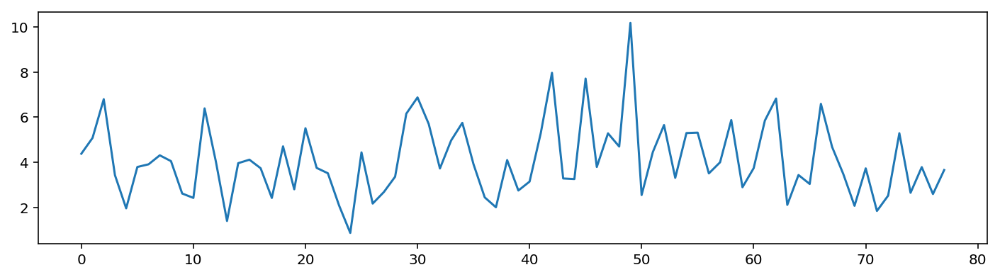

	 	 Test subset results
Test mean absolute percentage error per hour: 1.322154
Test mean absolute percentage error per day: 3.576533 
	 	 Validation Forecasting visualisation


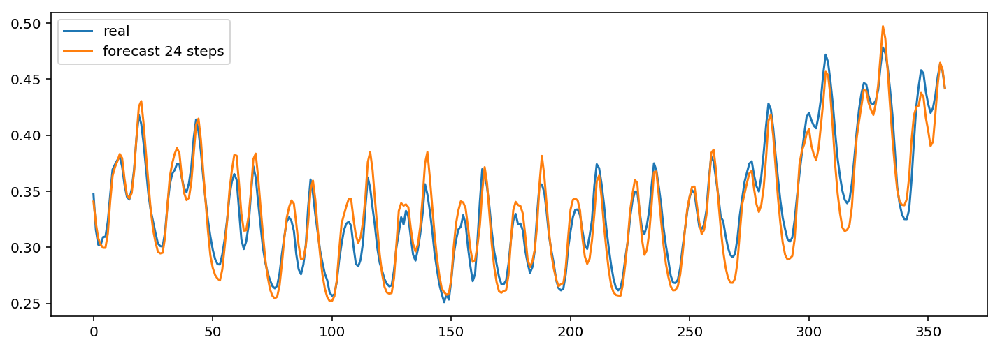

	 	 Forecasting a sample from Learning dataset


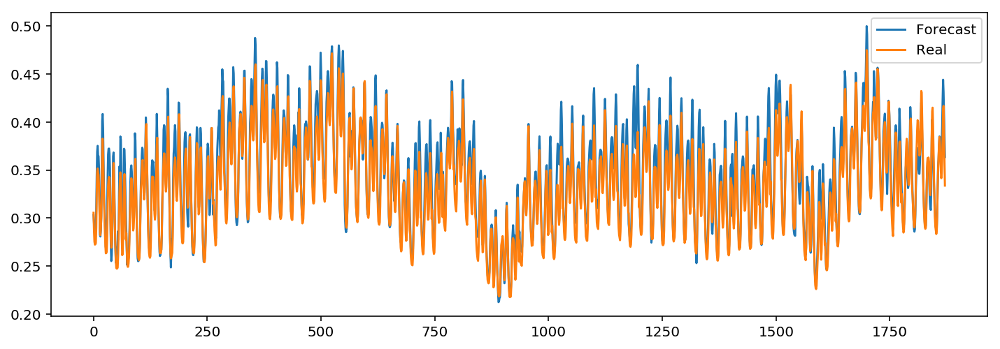

In [12]:
UsedInputsTemp= np.empty([9])
FinalErrorTemp= np.empty([2])
Parameters = np.empty([4])
ID= np.empty([1])
ID[0]=Model_ID


UsedInputsTemp[0] = previoushour = True
UsedInputsTemp[1] = timeSteps = 24
UsedInputsTemp[2] = previousDay = True
UsedInputsTemp[3] = previousWeek = True
UsedInputsTemp[4] = Temp = True
UsedInputsTemp[5] = TempMax = True
UsedInputsTemp[6] = TempMin = True
UsedInputsTemp[7] = dayIndicator = True
UsedInputsTemp[8] = HourIndicator = True

shift = False

learninginputs, learningoutputs, testinputs, testoutputs, nbrInputs = prepareInputs(daydata,season,UsedInputsTemp,testPeriod)
#learning vectors
inputx1 = np.array(pd.DataFrame(learninginputs.copy())).reshape(-1,nbrInputs)
outputx1 = np.array(pd.DataFrame(learningoutputs.copy()))

#test vectors
inputx2 = np.array(pd.DataFrame(testinputs.copy())).reshape(-1,nbrInputs)
outputx2 = np.array(pd.DataFrame(testoutputs.copy()))

Parameters[0]= HiddenNeurons1 = 20
Parameters[1]= HiddenNeurons2 = 10
Parameters[2]= LearningRate = 0.001

tempMLPmodels, tempErrorHistory, MLP_Model = create_Train_MLP_NN_Model(inputx1,outputx1,inputx2,outputx2,inputx1.shape[1],HiddenNeurons1=HiddenNeurons1,HiddenNeurons2=HiddenNeurons2
                                      ,Epoch=Epoch,LearningRate = LearningRate,Optimizer='rmsprop')

Parameters[3]= tempErrorHistory.argmin()


MLP_Model.save('Models/lstm_%d_%s_%s'%(Model_ID,season,today))
# MLP_Model = load_model('Models/lstm_%d_%s_%s'%(Model_ID,season,today))


clear_output()
print('==================================================================================')
print('\t \t test num : %s' %Model_ID )
print('==================================================================================')


LearningMAPE, testMAPE , LearningHourlyMAPE, LearningDailyForecast, LearningHourlyForecast  = getForecastingResults(
    tempMLPmodels, tempErrorHistory,learninginputs,learningoutputs,testinputs,testoutputs,MLP_Model,nbrInputs,shift,previoushour,season,timeSteps)
FinalErrorTemp[0] = LearningMAPE
FinalErrorTemp[1] = testMAPE

UsedInputList.append(UsedInputsTemp)
MAPErrorList.append(FinalErrorTemp)
ModelsList.append(MLP_Model)
ForecastingList.append(LearningDailyForecast)
Models_IDs.append(ID)
Models_parameters.append(Parameters)

print('==================================================================================')
print('\t \t Forecasting a sample from Learning dataset')
print('==================================================================================')
plt.figure(figsize=(12,4))
ForecastingList[Model_ID].index= range(ForecastingList[Model_ID].index.size)
plt.plot(ForecastingList[Model_ID].iloc[:,0],label='Forecast')
plt.plot(ForecastingList[Model_ID].iloc[:,1],label='Real')
plt.legend( loc=1, borderaxespad=0.4)
plt.show()

Model_ID = Model_ID + 1

	 	 test num : 1
	 	 learning subset results
Hourly Learning mean absolute percentage error of 1872 hours : 1.15482097659 
Daily Learning mean absolute percentage error of 78 days : 3.52056612265 
	 	 MAPError plot through Learning DataSet 


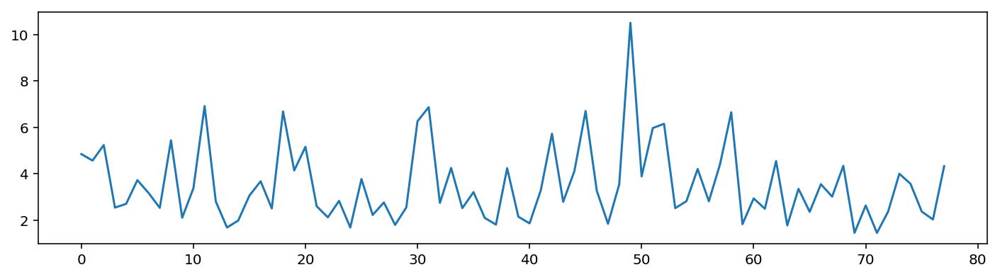

	 	 Test subset results
Test mean absolute percentage error per hour: 1.357683
Test mean absolute percentage error per day: 3.594924 
	 	 Validation Forecasting visualisation


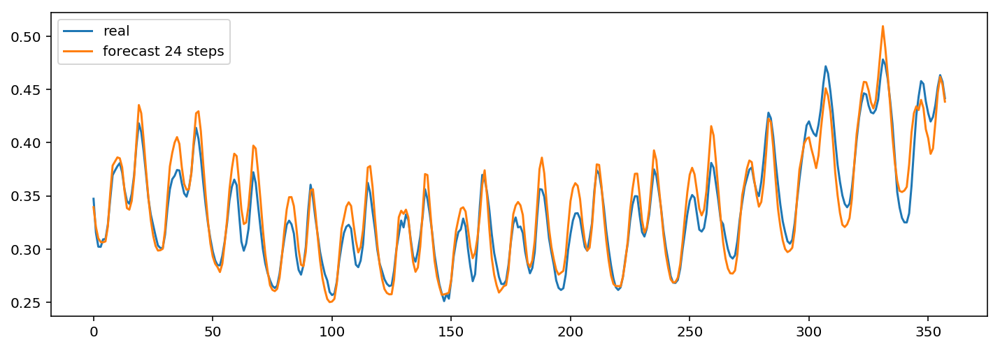

	 	 Forecasting a sample from Learning dataset


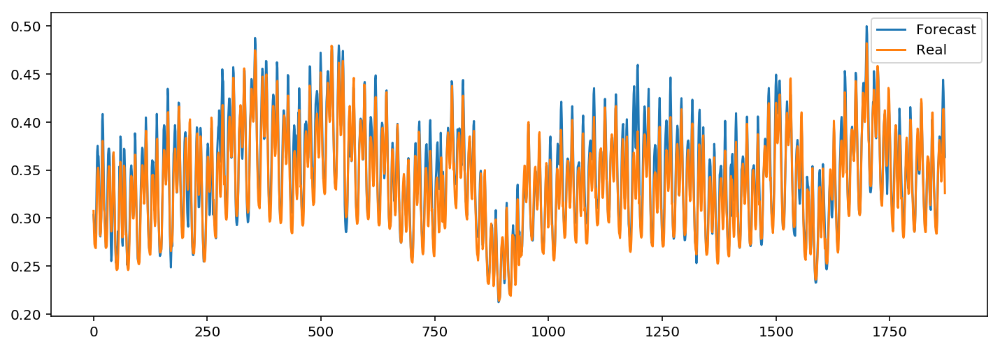

In [13]:
UsedInputsTemp= np.empty([9])
FinalErrorTemp= np.empty([2])
Parameters = np.empty([4])
ID= np.empty([1])
ID[0]=Model_ID


UsedInputsTemp[0] = previoushour = True
UsedInputsTemp[1] = timeSteps = 12
UsedInputsTemp[2] = previousDay = True
UsedInputsTemp[3] = previousWeek = True
UsedInputsTemp[4] = Temp = True
UsedInputsTemp[5] = TempMax = True
UsedInputsTemp[6] = TempMin = True
UsedInputsTemp[7] = dayIndicator = True
UsedInputsTemp[8] = HourIndicator = True

shift = False

learninginputs, learningoutputs, testinputs, testoutputs, nbrInputs = prepareInputs(daydata,season,UsedInputsTemp,testPeriod)
#learning vectors
inputx1 = np.array(pd.DataFrame(learninginputs.copy())).reshape(-1,nbrInputs)
outputx1 = np.array(pd.DataFrame(learningoutputs.copy()))

#test vectors
inputx2 = np.array(pd.DataFrame(testinputs.copy())).reshape(-1,nbrInputs)
outputx2 = np.array(pd.DataFrame(testoutputs.copy()))

Parameters[0]= HiddenNeurons1 = 20
Parameters[1]= HiddenNeurons2 = 10
Parameters[2]= LearningRate = 0.001

tempMLPmodels, tempErrorHistory,MLP_Model = create_Train_MLP_NN_Model(inputx1,outputx1,inputx2,outputx2,inputx1.shape[1],HiddenNeurons1=HiddenNeurons1,HiddenNeurons2=HiddenNeurons2
                                      ,Epoch=Epoch,LearningRate = LearningRate,Optimizer='rmsprop')

Parameters[3]= tempErrorHistory.argmin()


MLP_Model.save('Models/lstm_%d_%s_%s'%(Model_ID,season,today))
# MLP_Model = load_model('Models/lstm_%d_%s_%s'%(Model_ID,season,today))



clear_output()
print('==================================================================================')
print('\t \t test num : %s' %Model_ID )
print('==================================================================================')


LearningMAPE, testMAPE , LearningHourlyMAPE, LearningDailyForecast, LearningHourlyForecast  = getForecastingResults(
    tempMLPmodels, tempErrorHistory,learninginputs,learningoutputs,testinputs,testoutputs,MLP_Model,nbrInputs,shift,previoushour,season,timeSteps)
FinalErrorTemp[0] = LearningMAPE
FinalErrorTemp[1] = testMAPE

UsedInputList.append(UsedInputsTemp)
MAPErrorList.append(FinalErrorTemp)
ModelsList.append(MLP_Model)
ForecastingList.append(LearningDailyForecast)
Models_IDs.append(ID)
Models_parameters.append(Parameters)

print('==================================================================================')
print('\t \t Forecasting a sample from Learning dataset')
print('==================================================================================')
plt.figure(figsize=(12,4))
ForecastingList[Model_ID].index= range(ForecastingList[Model_ID].index.size)
plt.plot(ForecastingList[Model_ID].iloc[:,0],label='Forecast')
plt.plot(ForecastingList[Model_ID].iloc[:,1],label='Real')
plt.legend( loc=1, borderaxespad=0.4)
plt.show()

Model_ID = Model_ID + 1

In [106]:
Epoch= 3000

	 	 test num : 43
	 	 learning subset results
Hourly Learning mean absolute percentage error of 1872 hours : 1.16620783397 
Daily Learning mean absolute percentage error of 78 days : 3.38144231301 
	 	 MAPError plot through Learning DataSet 


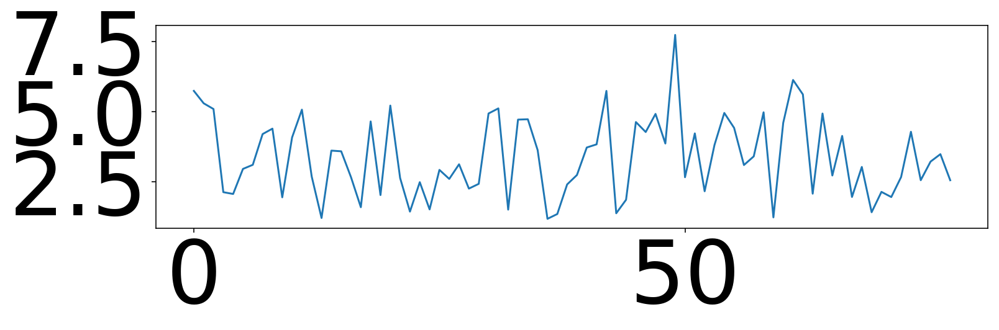

	 	 Test subset results
Test mean absolute percentage error per hour: 1.324619
Test mean absolute percentage error per day: 3.622898 
	 	 Validation Forecasting visualisation


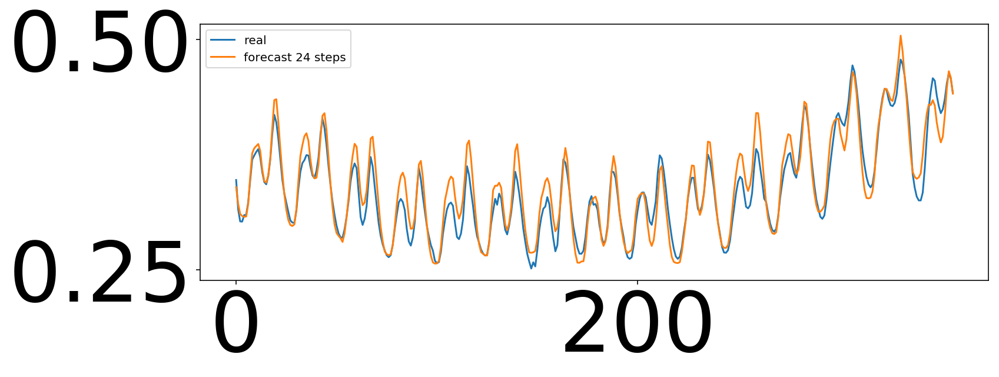

	 	 Forecasting a sample from Learning dataset


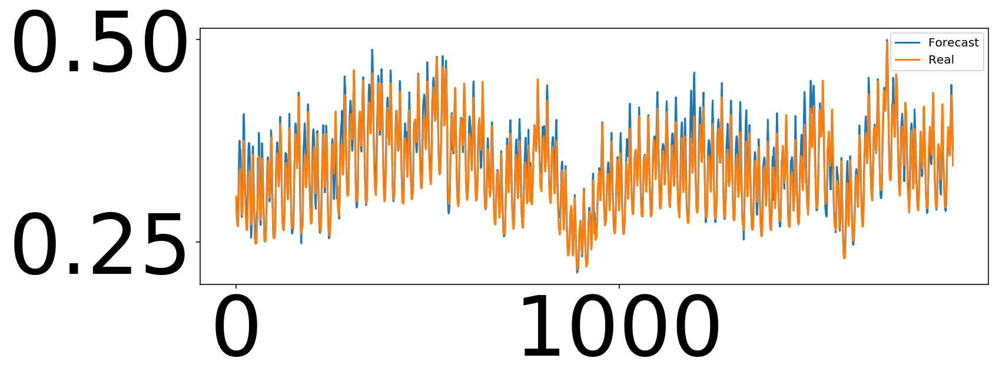

In [107]:
UsedInputsTemp= np.empty([9])
FinalErrorTemp= np.empty([2])
Parameters = np.empty([4])
ID= np.empty([1])
ID[0]=Model_ID


UsedInputsTemp[0] = previoushour = True
UsedInputsTemp[1] = timeSteps = 12
UsedInputsTemp[2] = previousDay = True
UsedInputsTemp[3] = previousWeek = True
UsedInputsTemp[4] = Temp = True
UsedInputsTemp[5] = TempMax = True
UsedInputsTemp[6] = TempMin = True
UsedInputsTemp[7] = dayIndicator = True
UsedInputsTemp[8] = HourIndicator = True

shift = False

learninginputs, learningoutputs, testinputs, testoutputs, nbrInputs = prepareInputs(daydata,season,UsedInputsTemp,testPeriod)
#learning vectors
inputx1 = np.array(pd.DataFrame(learninginputs.copy())).reshape(-1,nbrInputs)
outputx1 = np.array(pd.DataFrame(learningoutputs.copy()))

#test vectors
inputx2 = np.array(pd.DataFrame(testinputs.copy())).reshape(-1,nbrInputs)
outputx2 = np.array(pd.DataFrame(testoutputs.copy()))

Parameters[0]= HiddenNeurons1 = 20
Parameters[1]= HiddenNeurons2 = 10
Parameters[2]= LearningRate = 0.001

tempMLPmodels, tempErrorHistory,MLP_Model = create_Train_MLP_NN_Model(inputx1,outputx1,inputx2,outputx2,inputx1.shape[1],HiddenNeurons1=HiddenNeurons1,HiddenNeurons2=HiddenNeurons2
                                      ,Epoch=Epoch,LearningRate = LearningRate,Optimizer='rmsprop')

Parameters[3]= tempErrorHistory.argmin()


# MLP_Model = load_model('Models/lstm_%d_%s_%s'%(Model_ID,season,today))



clear_output()
print('==================================================================================')
print('\t \t test num : %s' %Model_ID )
print('==================================================================================')


LearningMAPE, testMAPE , LearningHourlyMAPE, LearningDailyForecast, LearningHourlyForecast, MLP_Model  = getForecastingResults_3(
    tempMLPmodels, tempErrorHistory,learninginputs,learningoutputs,testinputs,testoutputs,MLP_Model,nbrInputs,shift,previoushour,season,timeSteps)
FinalErrorTemp[0] = LearningMAPE
FinalErrorTemp[1] = testMAPE

MLP_Model.save('Models/lstm_%d_%s_%s'%(Model_ID,season,today))

UsedInputList.append(UsedInputsTemp)
MAPErrorList.append(FinalErrorTemp)
ModelsList.append(MLP_Model)
ForecastingList.append(LearningDailyForecast)
Models_IDs.append(ID)
Models_parameters.append(Parameters)

print('==================================================================================')
print('\t \t Forecasting a sample from Learning dataset')
print('==================================================================================')
plt.figure(figsize=(12,4))
ForecastingList[Model_ID].index= range(ForecastingList[Model_ID].index.size)
plt.plot(ForecastingList[Model_ID].iloc[:,0],label='Forecast')
plt.plot(ForecastingList[Model_ID].iloc[:,1],label='Real')
plt.legend( loc=1, borderaxespad=0.4)
plt.show()

Model_ID = Model_ID + 1

	 	 test num : 44
	 	 learning subset results
Hourly Learning mean absolute percentage error of 1872 hours : 1.16620783397 
Daily Learning mean absolute percentage error of 78 days : 3.38144231301 
	 	 MAPError plot through Learning DataSet 


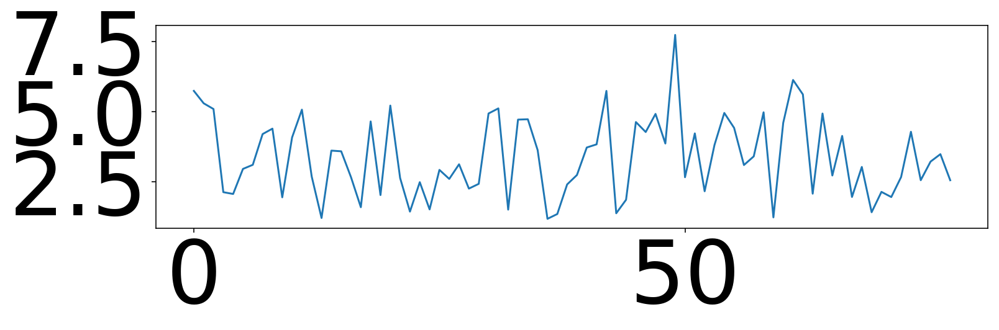

	 	 Test subset results
Test mean absolute percentage error per hour: 1.324619
Test mean absolute percentage error per day: 3.622898 
	 	 Validation Forecasting visualisation


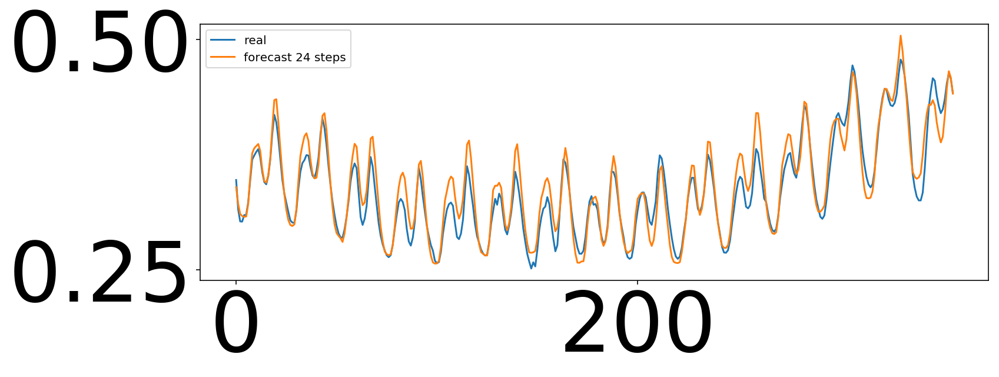

In [111]:
# UsedInputsTemp= np.empty([9])
# FinalErrorTemp= np.empty([2])
# Parameters = np.empty([4])
# ID= np.empty([1])
# ID[0]=Model_ID


# UsedInputsTemp[0] = previoushour = True
# UsedInputsTemp[1] = timeSteps = 12
# UsedInputsTemp[2] = previousDay = True
# UsedInputsTemp[3] = previousWeek = True
# UsedInputsTemp[4] = Temp = True
# UsedInputsTemp[5] = TempMax = True
# UsedInputsTemp[6] = TempMin = True
# UsedInputsTemp[7] = dayIndicator = True
# UsedInputsTemp[8] = HourIndicator = True

# shift = False

# learninginputs, learningoutputs, testinputs, testoutputs, nbrInputs = prepareInputs(daydata,season,UsedInputsTemp,testPeriod)
# #learning vectors
# inputx1 = np.array(pd.DataFrame(learninginputs.copy())).reshape(-1,nbrInputs)
# outputx1 = np.array(pd.DataFrame(learningoutputs.copy()))

# #test vectors
# inputx2 = np.array(pd.DataFrame(testinputs.copy())).reshape(-1,nbrInputs)
# outputx2 = np.array(pd.DataFrame(testoutputs.copy()))

# Parameters[0]= HiddenNeurons1 = 20
# Parameters[1]= HiddenNeurons2 = 10
# Parameters[2]= LearningRate = 0.001

# tempMLPmodels, tempErrorHistory,MLP_Model = create_Train_MLP_NN_Model(inputx1,outputx1,inputx2,outputx2,inputx1.shape[1],HiddenNeurons1=HiddenNeurons1,HiddenNeurons2=HiddenNeurons2
#                                       ,Epoch=Epoch,LearningRate = LearningRate,Optimizer='rmsprop')

# Parameters[3]= tempErrorHistory.argmin()


# MLP_Model.save('Models/lstm_%d_%s_%s'%(Model_ID,season,today))
# MLP_Model = load_model('Models/lstm_%d_%s_%s'%(Model_ID,season,today))



clear_output()
print('==================================================================================')
print('\t \t test num : %s' %Model_ID )
print('==================================================================================')


LearningMAPE, testMAPE , LearningHourlyMAPE, LearningDailyForecast, LearningHourlyForecast,MLP_Model  = getForecastingResults_3(
    tempMLPmodels, tempErrorHistory,learninginputs,learningoutputs,testinputs,testoutputs,MLP_Model,nbrInputs,shift,previoushour,season,timeSteps)
FinalErrorTemp[0] = LearningMAPE
FinalErrorTemp[1] = testMAPE

MLP_Model.save('Models/winter/lstm_%d_%s'%((Model_ID-1),today))

# UsedInputList.append(UsedInputsTemp)
# MAPErrorList.append(FinalErrorTemp)
# ModelsList.append(MLP_Model)
# ForecastingList.append(LearningDailyForecast)
# Models_IDs.append(ID)
# Models_parameters.append(Parameters)

# print('==================================================================================')
# print('\t \t Forecasting a sample from Learning dataset')
# print('==================================================================================')
# plt.figure(figsize=(12,4))
# ForecastingList[Model_ID].index= range(ForecastingList[Model_ID].index.size)
# plt.plot(ForecastingList[Model_ID].iloc[:,0],label='Forecast')
# plt.plot(ForecastingList[Model_ID].iloc[:,1],label='Real')
# plt.legend( loc=1, borderaxespad=0.4)
# plt.show()

# Model_ID = Model_ID + 1

In [108]:
UsedInputsTemp= np.empty([9])
FinalErrorTemp= np.empty([2])
Parameters = np.empty([4])
ID= np.empty([1])
ID[0]=Model_ID


UsedInputsTemp[0] = previoushour = True
UsedInputsTemp[1] = timeSteps = 12
UsedInputsTemp[2] = previousDay = True
UsedInputsTemp[3] = previousWeek = True
UsedInputsTemp[4] = Temp = True
UsedInputsTemp[5] = TempMax = True
UsedInputsTemp[6] = TempMin = True
UsedInputsTemp[7] = dayIndicator = True
UsedInputsTemp[8] = HourIndicator = True

shift = False

learninginputs, learningoutputs, testinputs, testoutputs, nbrInputs = prepareInputs(daydata,season,UsedInputsTemp,testPeriod)
#learning vectors
inputx1 = np.array(pd.DataFrame(learninginputs.copy())).reshape(-1,nbrInputs)
outputx1 = np.array(pd.DataFrame(learningoutputs.copy()))

#test vectors
inputx2 = np.array(pd.DataFrame(testinputs.copy())).reshape(-1,nbrInputs)
outputx2 = np.array(pd.DataFrame(testoutputs.copy()))

Parameters[0]= HiddenNeurons1 = 28
Parameters[1]= HiddenNeurons2 = 12
Parameters[2]= LearningRate = 0.001

tempMLPmodels, tempErrorHistory,MLP_Model = create_Train_MLP_NN_Model(inputx1,outputx1,inputx2,outputx2,inputx1.shape[1],HiddenNeurons1=HiddenNeurons1,HiddenNeurons2=HiddenNeurons2
                                      ,Epoch=Epoch,LearningRate = LearningRate,Optimizer='rmsprop')

Parameters[3]= tempErrorHistory.argmin()


MLP_Model.save('Models/lstm_%d_%s_%s'%(Model_ID,season,today))
# MLP_Model = load_model('Models/lstm_%d_%s_%s'%(Model_ID,season,today))



clear_output()
print('==================================================================================')
print('\t \t test num : %s' %Model_ID )
print('==================================================================================')


LearningMAPE, testMAPE , LearningHourlyMAPE, LearningDailyForecast, LearningHourlyForecast  = getForecastingResults(
    tempMLPmodels, tempErrorHistory,learninginputs,learningoutputs,testinputs,testoutputs,MLP_Model,nbrInputs,shift,previoushour,season,timeSteps)
FinalErrorTemp[0] = LearningMAPE
FinalErrorTemp[1] = testMAPE

UsedInputList.append(UsedInputsTemp)
MAPErrorList.append(FinalErrorTemp)
ModelsList.append(MLP_Model)
ForecastingList.append(LearningDailyForecast)
Models_IDs.append(ID)
Models_parameters.append(Parameters)

print('==================================================================================')
print('\t \t Forecasting a sample from Learning dataset')
print('==================================================================================')
plt.figure(figsize=(12,4))
ForecastingList[Model_ID].index= range(ForecastingList[Model_ID].index.size)
plt.plot(ForecastingList[Model_ID].iloc[:,0],label='Forecast')
plt.plot(ForecastingList[Model_ID].iloc[:,1],label='Real')
plt.legend( loc=1, borderaxespad=0.4)
plt.show()

Model_ID = Model_ID + 1

-------Input preparation process complet-------


/Users/mac/anaconda/lib/python2.7/site-packages/ipykernel/__main__.py:17: UserWarning: Update your `Dense` call to the Keras 2 API: `Dense(1, activation="sigmoid", kernel_initializer="uniform")`


epoch:   0 .
Train on 1872 samples, validate on 360 samples
Epoch 1/1
0s - loss: 0.0089 - val_loss: 0.0027
epoch:   1 .
Train on 1872 samples, validate on 360 samples
Epoch 1/1
0s - loss: 0.0026 - val_loss: 0.0026
epoch:   2 .
Train on 1872 samples, validate on 360 samples
Epoch 1/1
0s - loss: 0.0025 - val_loss: 0.0024
epoch:   3 .
Train on 1872 samples, validate on 360 samples
Epoch 1/1
0s - loss: 0.0023 - val_loss: 0.0023
epoch:   4 .
Train on 1872 samples, validate on 360 samples
Epoch 1/1
0s - loss: 0.0021 - val_loss: 0.0021
epoch:   5 .
Train on 1872 samples, validate on 360 samples
Epoch 1/1
0s - loss: 0.0018 - val_loss: 0.0018
epoch:   6 .
Train on 1872 samples, validate on 360 samples
Epoch 1/1
0s - loss: 0.0015 - val_loss: 0.0015
epoch:   7 .
Train on 1872 samples, validate on 360 samples
Epoch 1/1
0s - loss: 0.0012 - val_loss: 0.0013
epoch:   8 .
Train on 1872 samples, validate on 360 samples
Epoch 1/1
0s - loss: 9.7110e-04 - val_loss: 0.0011
epoch:   9 .
Train on 1872 sample

0s - loss: 1.2169e-04 - val_loss: 1.3362e-04
epoch:   72 .
Train on 1872 samples, validate on 360 samples
Epoch 1/1
0s - loss: 1.2162e-04 - val_loss: 1.5544e-04
epoch:   73 .
Train on 1872 samples, validate on 360 samples
Epoch 1/1
0s - loss: 1.2032e-04 - val_loss: 1.1872e-04
epoch:   74 .
Train on 1872 samples, validate on 360 samples
Epoch 1/1
0s - loss: 1.1930e-04 - val_loss: 1.3725e-04
epoch:   75 .
Train on 1872 samples, validate on 360 samples
Epoch 1/1
0s - loss: 1.1872e-04 - val_loss: 1.5093e-04
epoch:   76 .
Train on 1872 samples, validate on 360 samples
Epoch 1/1
0s - loss: 1.1883e-04 - val_loss: 1.5408e-04
epoch:   77 .
Train on 1872 samples, validate on 360 samples
Epoch 1/1
0s - loss: 1.1685e-04 - val_loss: 1.1408e-04
epoch:   78 .
Train on 1872 samples, validate on 360 samples
Epoch 1/1
0s - loss: 1.1764e-04 - val_loss: 9.9065e-05
epoch:   79 .
Train on 1872 samples, validate on 360 samples
Epoch 1/1
0s - loss: 1.1657e-04 - val_loss: 1.1669e-04
epoch:   80 .
Train on 1872

0s - loss: 8.3402e-05 - val_loss: 8.0496e-05
epoch:   143 .
Train on 1872 samples, validate on 360 samples
Epoch 1/1
0s - loss: 8.2590e-05 - val_loss: 9.0698e-05
epoch:   144 .
Train on 1872 samples, validate on 360 samples
Epoch 1/1
0s - loss: 8.3064e-05 - val_loss: 8.6139e-05
epoch:   145 .
Train on 1872 samples, validate on 360 samples
Epoch 1/1
0s - loss: 8.1959e-05 - val_loss: 1.1678e-04
epoch:   146 .
Train on 1872 samples, validate on 360 samples
Epoch 1/1
0s - loss: 8.1277e-05 - val_loss: 7.4345e-05
epoch:   147 .
Train on 1872 samples, validate on 360 samples
Epoch 1/1
0s - loss: 8.1942e-05 - val_loss: 1.0142e-04
epoch:   148 .
Train on 1872 samples, validate on 360 samples
Epoch 1/1
0s - loss: 8.1487e-05 - val_loss: 8.2605e-05
epoch:   149 .
Train on 1872 samples, validate on 360 samples
Epoch 1/1
0s - loss: 8.2485e-05 - val_loss: 1.2254e-04
epoch:   150 .
Train on 1872 samples, validate on 360 samples
Epoch 1/1
0s - loss: 8.0279e-05 - val_loss: 1.0966e-04
epoch:   151 .
Trai

0s - loss: 7.0644e-05 - val_loss: 7.9779e-05
epoch:   214 .
Train on 1872 samples, validate on 360 samples
Epoch 1/1
0s - loss: 6.9807e-05 - val_loss: 9.6229e-05
epoch:   215 .
Train on 1872 samples, validate on 360 samples
Epoch 1/1
0s - loss: 6.9410e-05 - val_loss: 7.6533e-05
epoch:   216 .
Train on 1872 samples, validate on 360 samples
Epoch 1/1
0s - loss: 6.8558e-05 - val_loss: 7.4217e-05
epoch:   217 .
Train on 1872 samples, validate on 360 samples
Epoch 1/1
0s - loss: 6.8721e-05 - val_loss: 6.4302e-05
epoch:   218 .
Train on 1872 samples, validate on 360 samples
Epoch 1/1
0s - loss: 6.8808e-05 - val_loss: 9.7861e-05
epoch:   219 .
Train on 1872 samples, validate on 360 samples
Epoch 1/1
0s - loss: 6.9600e-05 - val_loss: 8.4289e-05
epoch:   220 .
Train on 1872 samples, validate on 360 samples
Epoch 1/1
0s - loss: 6.9548e-05 - val_loss: 9.6137e-05
epoch:   221 .
Train on 1872 samples, validate on 360 samples
Epoch 1/1
0s - loss: 6.8260e-05 - val_loss: 6.1842e-05
epoch:   222 .
Trai

0s - loss: 6.3302e-05 - val_loss: 6.0737e-05
epoch:   285 .
Train on 1872 samples, validate on 360 samples
Epoch 1/1
0s - loss: 6.4622e-05 - val_loss: 6.0721e-05
epoch:   286 .
Train on 1872 samples, validate on 360 samples
Epoch 1/1
0s - loss: 6.5023e-05 - val_loss: 6.3603e-05
epoch:   287 .
Train on 1872 samples, validate on 360 samples
Epoch 1/1
0s - loss: 6.2774e-05 - val_loss: 6.7649e-05
epoch:   288 .
Train on 1872 samples, validate on 360 samples
Epoch 1/1
0s - loss: 6.3822e-05 - val_loss: 7.3299e-05
epoch:   289 .
Train on 1872 samples, validate on 360 samples
Epoch 1/1
0s - loss: 6.3593e-05 - val_loss: 7.2955e-05
epoch:   290 .
Train on 1872 samples, validate on 360 samples
Epoch 1/1
0s - loss: 6.2494e-05 - val_loss: 6.9368e-05
epoch:   291 .
Train on 1872 samples, validate on 360 samples
Epoch 1/1
0s - loss: 6.4678e-05 - val_loss: 6.4908e-05
epoch:   292 .
Train on 1872 samples, validate on 360 samples
Epoch 1/1
0s - loss: 6.3880e-05 - val_loss: 6.6208e-05
epoch:   293 .
Trai

0s - loss: 5.9037e-05 - val_loss: 5.9979e-05
epoch:   356 .
Train on 1872 samples, validate on 360 samples
Epoch 1/1
0s - loss: 5.9793e-05 - val_loss: 5.8560e-05
epoch:   357 .
Train on 1872 samples, validate on 360 samples
Epoch 1/1
0s - loss: 5.8252e-05 - val_loss: 9.2160e-05
epoch:   358 .
Train on 1872 samples, validate on 360 samples
Epoch 1/1
0s - loss: 5.9643e-05 - val_loss: 5.5335e-05
epoch:   359 .
Train on 1872 samples, validate on 360 samples
Epoch 1/1
0s - loss: 5.9726e-05 - val_loss: 7.0010e-05
epoch:   360 .
Train on 1872 samples, validate on 360 samples
Epoch 1/1
0s - loss: 5.9315e-05 - val_loss: 6.9098e-05
epoch:   361 .
Train on 1872 samples, validate on 360 samples
Epoch 1/1
0s - loss: 5.9206e-05 - val_loss: 8.9394e-05
epoch:   362 .
Train on 1872 samples, validate on 360 samples
Epoch 1/1
0s - loss: 5.9177e-05 - val_loss: 8.0635e-05
epoch:   363 .
Train on 1872 samples, validate on 360 samples
Epoch 1/1
0s - loss: 5.9603e-05 - val_loss: 5.8716e-05
epoch:   364 .
Trai

0s - loss: 5.6710e-05 - val_loss: 6.9356e-05
epoch:   427 .
Train on 1872 samples, validate on 360 samples
Epoch 1/1
0s - loss: 5.5850e-05 - val_loss: 8.7592e-05
epoch:   428 .
Train on 1872 samples, validate on 360 samples
Epoch 1/1
0s - loss: 5.6268e-05 - val_loss: 5.4647e-05
epoch:   429 .
Train on 1872 samples, validate on 360 samples
Epoch 1/1
0s - loss: 5.7187e-05 - val_loss: 6.4260e-05
epoch:   430 .
Train on 1872 samples, validate on 360 samples
Epoch 1/1
0s - loss: 5.6089e-05 - val_loss: 5.4631e-05
epoch:   431 .
Train on 1872 samples, validate on 360 samples
Epoch 1/1
0s - loss: 5.6832e-05 - val_loss: 6.1304e-05
epoch:   432 .
Train on 1872 samples, validate on 360 samples
Epoch 1/1
0s - loss: 5.7763e-05 - val_loss: 5.1231e-05
epoch:   433 .
Train on 1872 samples, validate on 360 samples
Epoch 1/1
0s - loss: 5.7030e-05 - val_loss: 5.4543e-05
epoch:   434 .
Train on 1872 samples, validate on 360 samples
Epoch 1/1
0s - loss: 5.7016e-05 - val_loss: 6.1973e-05
epoch:   435 .
Trai

0s - loss: 5.4163e-05 - val_loss: 6.8742e-05
epoch:   498 .
Train on 1872 samples, validate on 360 samples
Epoch 1/1
0s - loss: 5.4892e-05 - val_loss: 5.2460e-05
epoch:   499 .
Train on 1872 samples, validate on 360 samples
Epoch 1/1
0s - loss: 5.5366e-05 - val_loss: 5.3329e-05
epoch:   500 .
Train on 1872 samples, validate on 360 samples
Epoch 1/1
0s - loss: 5.4974e-05 - val_loss: 5.6364e-05
epoch:   501 .
Train on 1872 samples, validate on 360 samples
Epoch 1/1
0s - loss: 5.4314e-05 - val_loss: 4.9889e-05
epoch:   502 .
Train on 1872 samples, validate on 360 samples
Epoch 1/1
0s - loss: 5.4771e-05 - val_loss: 6.5077e-05
epoch:   503 .
Train on 1872 samples, validate on 360 samples
Epoch 1/1
0s - loss: 5.4291e-05 - val_loss: 1.0980e-04
epoch:   504 .
Train on 1872 samples, validate on 360 samples
Epoch 1/1
0s - loss: 5.4775e-05 - val_loss: 7.5458e-05
epoch:   505 .
Train on 1872 samples, validate on 360 samples
Epoch 1/1
0s - loss: 5.4151e-05 - val_loss: 5.2064e-05
epoch:   506 .
Trai

0s - loss: 5.3372e-05 - val_loss: 5.3879e-05
epoch:   569 .
Train on 1872 samples, validate on 360 samples
Epoch 1/1
0s - loss: 5.2863e-05 - val_loss: 5.3191e-05
epoch:   570 .
Train on 1872 samples, validate on 360 samples
Epoch 1/1
0s - loss: 5.4227e-05 - val_loss: 4.8966e-05
epoch:   571 .
Train on 1872 samples, validate on 360 samples
Epoch 1/1
0s - loss: 5.3247e-05 - val_loss: 5.2621e-05
epoch:   572 .
Train on 1872 samples, validate on 360 samples
Epoch 1/1
0s - loss: 5.2315e-05 - val_loss: 5.3850e-05
epoch:   573 .
Train on 1872 samples, validate on 360 samples
Epoch 1/1
0s - loss: 5.3585e-05 - val_loss: 7.2293e-05
epoch:   574 .
Train on 1872 samples, validate on 360 samples
Epoch 1/1
0s - loss: 5.4160e-05 - val_loss: 5.6559e-05
epoch:   575 .
Train on 1872 samples, validate on 360 samples
Epoch 1/1
0s - loss: 5.2980e-05 - val_loss: 4.9171e-05
epoch:   576 .
Train on 1872 samples, validate on 360 samples
Epoch 1/1
0s - loss: 5.3187e-05 - val_loss: 4.7910e-05
epoch:   577 .
Trai

0s - loss: 5.2800e-05 - val_loss: 6.1161e-05
epoch:   640 .
Train on 1872 samples, validate on 360 samples
Epoch 1/1
0s - loss: 5.2767e-05 - val_loss: 6.2027e-05
epoch:   641 .
Train on 1872 samples, validate on 360 samples
Epoch 1/1
0s - loss: 5.2116e-05 - val_loss: 4.8260e-05
epoch:   642 .
Train on 1872 samples, validate on 360 samples
Epoch 1/1
0s - loss: 5.1814e-05 - val_loss: 7.1421e-05
epoch:   643 .
Train on 1872 samples, validate on 360 samples
Epoch 1/1
0s - loss: 5.1641e-05 - val_loss: 4.9000e-05
epoch:   644 .
Train on 1872 samples, validate on 360 samples
Epoch 1/1
0s - loss: 5.1394e-05 - val_loss: 6.8540e-05
epoch:   645 .
Train on 1872 samples, validate on 360 samples
Epoch 1/1
0s - loss: 5.1716e-05 - val_loss: 5.9857e-05
epoch:   646 .
Train on 1872 samples, validate on 360 samples
Epoch 1/1
0s - loss: 5.1122e-05 - val_loss: 5.2923e-05
epoch:   647 .
Train on 1872 samples, validate on 360 samples
Epoch 1/1
0s - loss: 5.2067e-05 - val_loss: 4.8178e-05
epoch:   648 .
Trai

0s - loss: 5.1055e-05 - val_loss: 4.7947e-05
epoch:   711 .
Train on 1872 samples, validate on 360 samples
Epoch 1/1
0s - loss: 5.0543e-05 - val_loss: 4.7105e-05
epoch:   712 .
Train on 1872 samples, validate on 360 samples
Epoch 1/1
0s - loss: 5.1460e-05 - val_loss: 6.2159e-05
epoch:   713 .
Train on 1872 samples, validate on 360 samples
Epoch 1/1
0s - loss: 5.0763e-05 - val_loss: 4.8622e-05
epoch:   714 .
Train on 1872 samples, validate on 360 samples
Epoch 1/1
0s - loss: 5.0835e-05 - val_loss: 5.4689e-05
epoch:   715 .
Train on 1872 samples, validate on 360 samples
Epoch 1/1
0s - loss: 5.1014e-05 - val_loss: 5.0833e-05
epoch:   716 .
Train on 1872 samples, validate on 360 samples
Epoch 1/1
0s - loss: 5.1240e-05 - val_loss: 5.0976e-05
epoch:   717 .
Train on 1872 samples, validate on 360 samples
Epoch 1/1
0s - loss: 5.0278e-05 - val_loss: 6.2233e-05
epoch:   718 .
Train on 1872 samples, validate on 360 samples
Epoch 1/1
0s - loss: 5.1435e-05 - val_loss: 5.1585e-05
epoch:   719 .
Trai

0s - loss: 5.1234e-05 - val_loss: 5.1401e-05
epoch:   782 .
Train on 1872 samples, validate on 360 samples
Epoch 1/1
0s - loss: 5.1281e-05 - val_loss: 4.5422e-05
epoch:   783 .
Train on 1872 samples, validate on 360 samples
Epoch 1/1
0s - loss: 5.0592e-05 - val_loss: 5.6538e-05
epoch:   784 .
Train on 1872 samples, validate on 360 samples
Epoch 1/1
0s - loss: 5.1352e-05 - val_loss: 5.4872e-05
epoch:   785 .
Train on 1872 samples, validate on 360 samples
Epoch 1/1
0s - loss: 5.0016e-05 - val_loss: 7.5437e-05
epoch:   786 .
Train on 1872 samples, validate on 360 samples
Epoch 1/1
0s - loss: 5.0678e-05 - val_loss: 4.7012e-05
epoch:   787 .
Train on 1872 samples, validate on 360 samples
Epoch 1/1
0s - loss: 4.9723e-05 - val_loss: 5.2259e-05
epoch:   788 .
Train on 1872 samples, validate on 360 samples
Epoch 1/1
0s - loss: 5.0624e-05 - val_loss: 5.9700e-05
epoch:   789 .
Train on 1872 samples, validate on 360 samples
Epoch 1/1
0s - loss: 5.0613e-05 - val_loss: 5.2989e-05
epoch:   790 .
Trai

0s - loss: 5.0059e-05 - val_loss: 6.6421e-05
epoch:   853 .
Train on 1872 samples, validate on 360 samples
Epoch 1/1
0s - loss: 4.8993e-05 - val_loss: 5.6793e-05
epoch:   854 .
Train on 1872 samples, validate on 360 samples
Epoch 1/1
0s - loss: 5.0319e-05 - val_loss: 4.7323e-05
epoch:   855 .
Train on 1872 samples, validate on 360 samples
Epoch 1/1
0s - loss: 4.8478e-05 - val_loss: 6.0287e-05
epoch:   856 .
Train on 1872 samples, validate on 360 samples
Epoch 1/1
0s - loss: 4.9726e-05 - val_loss: 6.5733e-05
epoch:   857 .
Train on 1872 samples, validate on 360 samples
Epoch 1/1
0s - loss: 4.9496e-05 - val_loss: 4.6779e-05
epoch:   858 .
Train on 1872 samples, validate on 360 samples
Epoch 1/1
0s - loss: 4.8780e-05 - val_loss: 4.5053e-05
epoch:   859 .
Train on 1872 samples, validate on 360 samples
Epoch 1/1
0s - loss: 4.9899e-05 - val_loss: 5.3887e-05
epoch:   860 .
Train on 1872 samples, validate on 360 samples
Epoch 1/1
0s - loss: 5.0186e-05 - val_loss: 4.3707e-05
epoch:   861 .
Trai

KeyboardInterrupt: 

In [ ]:
UsedInputsTemp= np.empty([9])
FinalErrorTemp= np.empty([2])
Parameters = np.empty([4])
ID= np.empty([1])
ID[0]=Model_ID


UsedInputsTemp[0] = previoushour = True
UsedInputsTemp[1] = timeSteps = 12
UsedInputsTemp[2] = previousDay = True
UsedInputsTemp[3] = previousWeek = True
UsedInputsTemp[4] = Temp = True
UsedInputsTemp[5] = TempMax = True
UsedInputsTemp[6] = TempMin = True
UsedInputsTemp[7] = dayIndicator = True
UsedInputsTemp[8] = HourIndicator = True

shift = False

learninginputs, learningoutputs, testinputs, testoutputs, nbrInputs = prepareInputs(daydata,season,UsedInputsTemp,testPeriod)
#learning vectors
inputx1 = np.array(pd.DataFrame(learninginputs.copy())).reshape(-1,nbrInputs)
outputx1 = np.array(pd.DataFrame(learningoutputs.copy()))

#test vectors
inputx2 = np.array(pd.DataFrame(testinputs.copy())).reshape(-1,nbrInputs)
outputx2 = np.array(pd.DataFrame(testoutputs.copy()))

Parameters[0]= HiddenNeurons1 = 26
Parameters[1]= HiddenNeurons2 = 7
Parameters[2]= LearningRate = 0.001

tempMLPmodels, tempErrorHistory,MLP_Model = create_Train_MLP_NN_Model(inputx1,outputx1,inputx2,outputx2,inputx1.shape[1],HiddenNeurons1=HiddenNeurons1,HiddenNeurons2=HiddenNeurons2
                                      ,Epoch=Epoch,LearningRate = LearningRate,Optimizer='rmsprop')

Parameters[3]= tempErrorHistory.argmin()


MLP_Model.save('Models/lstm_%d_%s_%s'%(Model_ID,season,today))
# MLP_Model = load_model('Models/lstm_%d_%s_%s'%(Model_ID,season,today))



clear_output()
print('==================================================================================')
print('\t \t test num : %s' %Model_ID )
print('==================================================================================')


LearningMAPE, testMAPE , LearningHourlyMAPE, LearningDailyForecast, LearningHourlyForecast  = getForecastingResults(
    tempMLPmodels, tempErrorHistory,learninginputs,learningoutputs,testinputs,testoutputs,MLP_Model,nbrInputs,shift,previoushour,season,timeSteps)
FinalErrorTemp[0] = LearningMAPE
FinalErrorTemp[1] = testMAPE

UsedInputList.append(UsedInputsTemp)
MAPErrorList.append(FinalErrorTemp)
ModelsList.append(MLP_Model)
ForecastingList.append(LearningDailyForecast)
Models_IDs.append(ID)
Models_parameters.append(Parameters)

print('==================================================================================')
print('\t \t Forecasting a sample from Learning dataset')
print('==================================================================================')
plt.figure(figsize=(12,4))
ForecastingList[Model_ID].index= range(ForecastingList[Model_ID].index.size)
plt.plot(ForecastingList[Model_ID].iloc[:,0],label='Forecast')
plt.plot(ForecastingList[Model_ID].iloc[:,1],label='Real')
plt.legend( loc=1, borderaxespad=0.4)
plt.show()

Model_ID = Model_ID + 1

In [ ]:
UsedInputsTemp= np.empty([9])
FinalErrorTemp= np.empty([2])
Parameters = np.empty([4])
ID= np.empty([1])
ID[0]=Model_ID


UsedInputsTemp[0] = previoushour = True
UsedInputsTemp[1] = timeSteps = 12
UsedInputsTemp[2] = previousDay = True
UsedInputsTemp[3] = previousWeek = True
UsedInputsTemp[4] = Temp = True
UsedInputsTemp[5] = TempMax = True
UsedInputsTemp[6] = TempMin = True
UsedInputsTemp[7] = dayIndicator = True
UsedInputsTemp[8] = HourIndicator = True

shift = False

learninginputs, learningoutputs, testinputs, testoutputs, nbrInputs = prepareInputs(daydata,season,UsedInputsTemp,testPeriod)
#learning vectors
inputx1 = np.array(pd.DataFrame(learninginputs.copy())).reshape(-1,nbrInputs)
outputx1 = np.array(pd.DataFrame(learningoutputs.copy()))

#test vectors
inputx2 = np.array(pd.DataFrame(testinputs.copy())).reshape(-1,nbrInputs)
outputx2 = np.array(pd.DataFrame(testoutputs.copy()))

Parameters[0]= HiddenNeurons1 = 28
Parameters[1]= HiddenNeurons2 = 12
Parameters[2]= LearningRate = 0.001

tempMLPmodels, tempErrorHistory,MLP_Model = create_Train_MLP_NN_Model(inputx1,outputx1,inputx2,outputx2,inputx1.shape[1],HiddenNeurons1=HiddenNeurons1,HiddenNeurons2=HiddenNeurons2
                                      ,Epoch=Epoch,LearningRate = LearningRate,Optimizer='rmsprop')

Parameters[3]= tempErrorHistory.argmin()


MLP_Model.save('Models/lstm_%d_%s_%s'%(Model_ID,season,today))
# MLP_Model = load_model('Models/lstm_%d_%s_%s'%(Model_ID,season,today))



clear_output()
print('==================================================================================')
print('\t \t test num : %s' %Model_ID )
print('==================================================================================')


LearningMAPE, testMAPE , LearningHourlyMAPE, LearningDailyForecast, LearningHourlyForecast  = getForecastingResults(
    tempMLPmodels, tempErrorHistory,learninginputs,learningoutputs,testinputs,testoutputs,MLP_Model,nbrInputs,shift,previoushour,season,timeSteps)
FinalErrorTemp[0] = LearningMAPE
FinalErrorTemp[1] = testMAPE

UsedInputList.append(UsedInputsTemp)
MAPErrorList.append(FinalErrorTemp)
ModelsList.append(MLP_Model)
ForecastingList.append(LearningDailyForecast)
Models_IDs.append(ID)
Models_parameters.append(Parameters)

print('==================================================================================')
print('\t \t Forecasting a sample from Learning dataset')
print('==================================================================================')
plt.figure(figsize=(12,4))
ForecastingList[Model_ID].index= range(ForecastingList[Model_ID].index.size)
plt.plot(ForecastingList[Model_ID].iloc[:,0],label='Forecast')
plt.plot(ForecastingList[Model_ID].iloc[:,1],label='Real')
plt.legend( loc=1, borderaxespad=0.4)
plt.show()

Model_ID = Model_ID + 1

	 	 test num : 2
	 	 learning subset results
Hourly Learning mean absolute percentage error of 1872 hours : 1.17990696866 
Daily Learning mean absolute percentage error of 78 days : 3.08259748496 
	 	 MAPError plot through Learning DataSet 


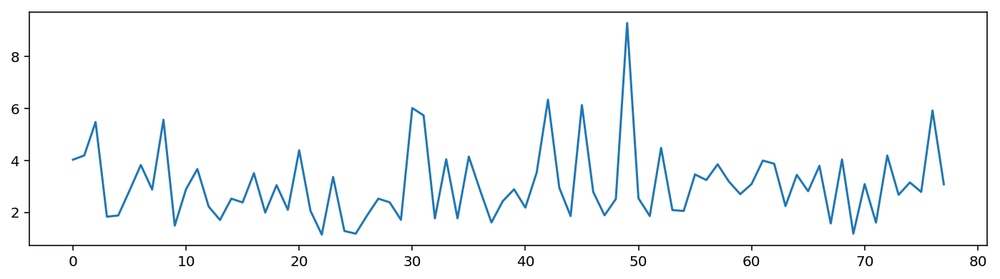

	 	 Test subset results
Test mean absolute percentage error per hour: 1.414390
Test mean absolute percentage error per day: 4.263560 
	 	 Validation Forecasting visualisation


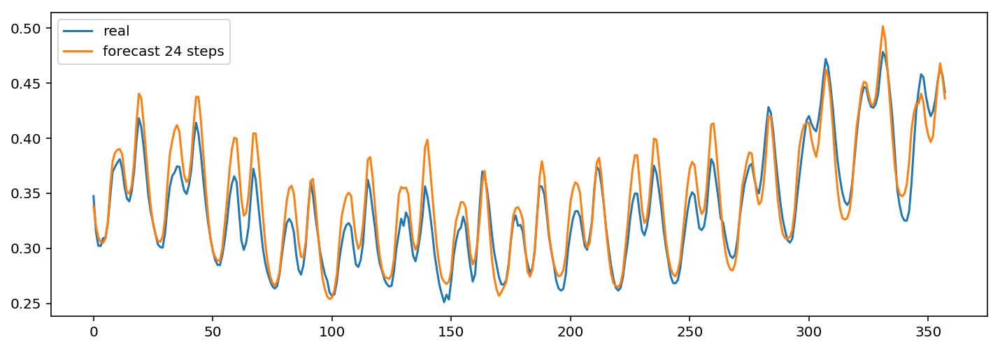

	 	 Forecasting a sample from Learning dataset


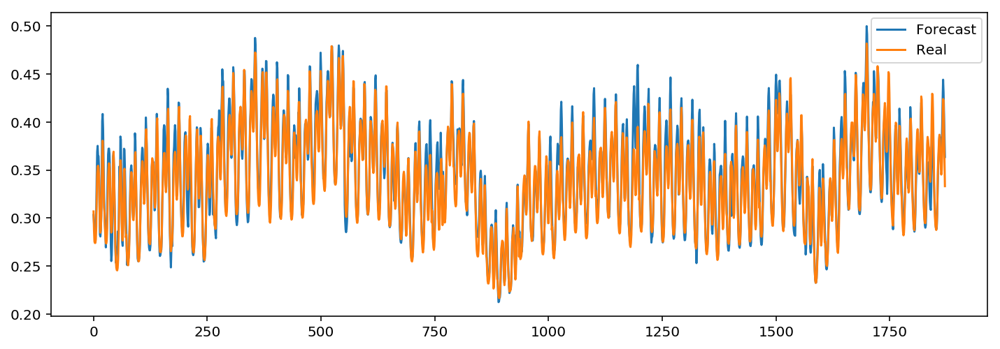

In [14]:
UsedInputsTemp= np.empty([9])
FinalErrorTemp= np.empty([2])
Parameters = np.empty([4])
ID= np.empty([1])
ID[0]=Model_ID


UsedInputsTemp[0] = previoushour = True
UsedInputsTemp[1] = timeSteps = 12
UsedInputsTemp[2] = previousDay = True
UsedInputsTemp[3] = previousWeek = True
UsedInputsTemp[4] = Temp = True
UsedInputsTemp[5] = TempMax = True
UsedInputsTemp[6] = TempMin = True
UsedInputsTemp[7] = dayIndicator = True
UsedInputsTemp[8] = HourIndicator = True

shift = False

learninginputs, learningoutputs, testinputs, testoutputs, nbrInputs = prepareInputs(daydata,season,UsedInputsTemp,testPeriod)
#learning vectors
inputx1 = np.array(pd.DataFrame(learninginputs.copy())).reshape(-1,nbrInputs)
outputx1 = np.array(pd.DataFrame(learningoutputs.copy()))

#test vectors
inputx2 = np.array(pd.DataFrame(testinputs.copy())).reshape(-1,nbrInputs)
outputx2 = np.array(pd.DataFrame(testoutputs.copy()))

Parameters[0]= HiddenNeurons1 = 20
Parameters[1]= HiddenNeurons2 = 10
Parameters[2]= LearningRate = 0.001

tempMLPmodels, tempErrorHistory,MLP_Model = create_Train_MLP_NN_Model(inputx1,outputx1,inputx2,outputx2,inputx1.shape[1],HiddenNeurons1=HiddenNeurons1,HiddenNeurons2=HiddenNeurons2
                                      ,Epoch=Epoch,LearningRate = LearningRate,Optimizer='rmsprop')

Parameters[3]= tempErrorHistory.argmin()


MLP_Model.save('Models/lstm_%d_%s_%s'%(Model_ID,season,today))
# MLP_Model = load_model('Models/lstm_%d_%s_%s'%(Model_ID,season,today))



clear_output()
print('==================================================================================')
print('\t \t test num : %s' %Model_ID )
print('==================================================================================')


LearningMAPE, testMAPE , LearningHourlyMAPE, LearningDailyForecast, LearningHourlyForecast  = getForecastingResults(
    tempMLPmodels, tempErrorHistory,learninginputs,learningoutputs,testinputs,testoutputs,MLP_Model,nbrInputs,shift,previoushour,season,timeSteps)
FinalErrorTemp[0] = LearningMAPE
FinalErrorTemp[1] = testMAPE

UsedInputList.append(UsedInputsTemp)
MAPErrorList.append(FinalErrorTemp)
ModelsList.append(MLP_Model)
ForecastingList.append(LearningDailyForecast)
Models_IDs.append(ID)
Models_parameters.append(Parameters)

print('==================================================================================')
print('\t \t Forecasting a sample from Learning dataset')
print('==================================================================================')
plt.figure(figsize=(12,4))
ForecastingList[Model_ID].index= range(ForecastingList[Model_ID].index.size)
plt.plot(ForecastingList[Model_ID].iloc[:,0],label='Forecast')
plt.plot(ForecastingList[Model_ID].iloc[:,1],label='Real')
plt.legend( loc=1, borderaxespad=0.4)
plt.show()

Model_ID = Model_ID + 1

	 	 test num : 3
	 	 learning subset results
Hourly Learning mean absolute percentage error of 1872 hours : 1.30779742279 
Daily Learning mean absolute percentage error of 78 days : 4.48615156534 
	 	 MAPError plot through Learning DataSet 


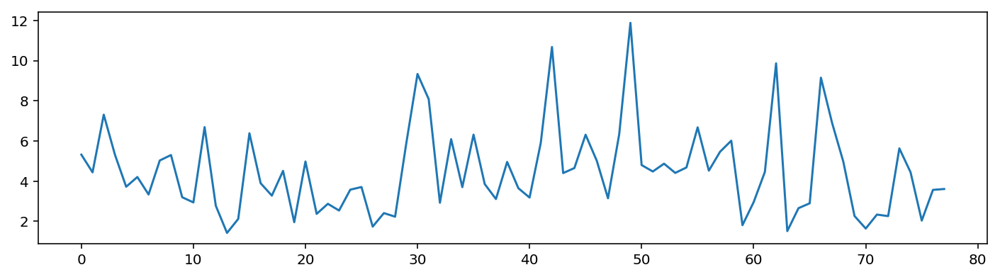

	 	 Test subset results
Test mean absolute percentage error per hour: 1.458158
Test mean absolute percentage error per day: 3.269316 
	 	 Validation Forecasting visualisation


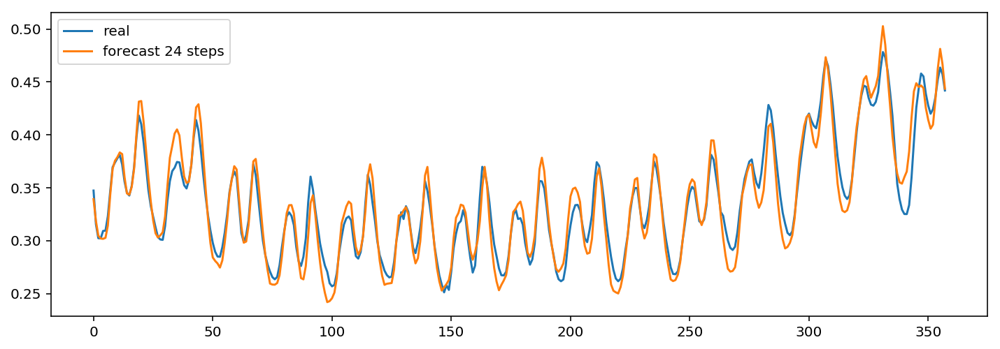

	 	 Forecasting a sample from Learning dataset


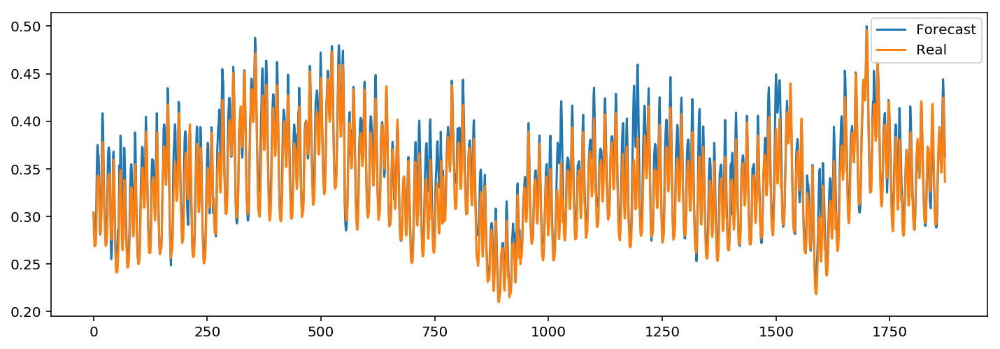

In [15]:
UsedInputsTemp= np.empty([9])
FinalErrorTemp= np.empty([2])
Parameters = np.empty([4])
ID= np.empty([1])
ID[0]=Model_ID


UsedInputsTemp[0] = previoushour = True
UsedInputsTemp[1] = timeSteps = 6
UsedInputsTemp[2] = previousDay = True
UsedInputsTemp[3] = previousWeek = True
UsedInputsTemp[4] = Temp = True
UsedInputsTemp[5] = TempMax = True
UsedInputsTemp[6] = TempMin = True
UsedInputsTemp[7] = dayIndicator = True
UsedInputsTemp[8] = HourIndicator = True

shift = False

learninginputs, learningoutputs, testinputs, testoutputs, nbrInputs = prepareInputs(daydata,season,UsedInputsTemp,testPeriod)
#learning vectors
inputx1 = np.array(pd.DataFrame(learninginputs.copy())).reshape(-1,nbrInputs)
outputx1 = np.array(pd.DataFrame(learningoutputs.copy()))

#test vectors
inputx2 = np.array(pd.DataFrame(testinputs.copy())).reshape(-1,nbrInputs)
outputx2 = np.array(pd.DataFrame(testoutputs.copy()))

Parameters[0]= HiddenNeurons1 = 20
Parameters[1]= HiddenNeurons2 = 10
Parameters[2]= LearningRate = 0.001

tempMLPmodels, tempErrorHistory,MLP_Model = create_Train_MLP_NN_Model(inputx1,outputx1,inputx2,outputx2,inputx1.shape[1],HiddenNeurons1=HiddenNeurons1,HiddenNeurons2=HiddenNeurons2
                                      ,Epoch=Epoch,LearningRate = LearningRate,Optimizer='rmsprop')

Parameters[3]= tempErrorHistory.argmin()

MLP_Model.save('Models/lstm_%d_%s_%s'%(Model_ID,season,today))
# MLP_Model = load_model('Models/lstm_%d_%s_%s'%(Model_ID,season,today))

clear_output()
print('==================================================================================')
print('\t \t test num : %s' %Model_ID )
print('==================================================================================')


LearningMAPE, testMAPE , LearningHourlyMAPE, LearningDailyForecast, LearningHourlyForecast  = getForecastingResults(
    tempMLPmodels, tempErrorHistory,learninginputs,learningoutputs,testinputs,testoutputs,MLP_Model,nbrInputs,shift,previoushour,season,timeSteps)
FinalErrorTemp[0] = LearningMAPE
FinalErrorTemp[1] = testMAPE

UsedInputList.append(UsedInputsTemp)
MAPErrorList.append(FinalErrorTemp)
ModelsList.append(MLP_Model)
ForecastingList.append(LearningDailyForecast)
Models_IDs.append(ID)
Models_parameters.append(Parameters)

print('==================================================================================')
print('\t \t Forecasting a sample from Learning dataset')
print('==================================================================================')
plt.figure(figsize=(12,4))
ForecastingList[Model_ID].index= range(ForecastingList[Model_ID].index.size)
plt.plot(ForecastingList[Model_ID].iloc[:,0],label='Forecast')
plt.plot(ForecastingList[Model_ID].iloc[:,1],label='Real')
plt.legend( loc=1, borderaxespad=0.4)
plt.show()

Model_ID = Model_ID + 1

	 	 test num : 4
	 	 learning subset results
Hourly Learning mean absolute percentage error of 1872 hours : 1.29399626292 
Daily Learning mean absolute percentage error of 78 days : 4.04294968721 
	 	 MAPError plot through Learning DataSet 


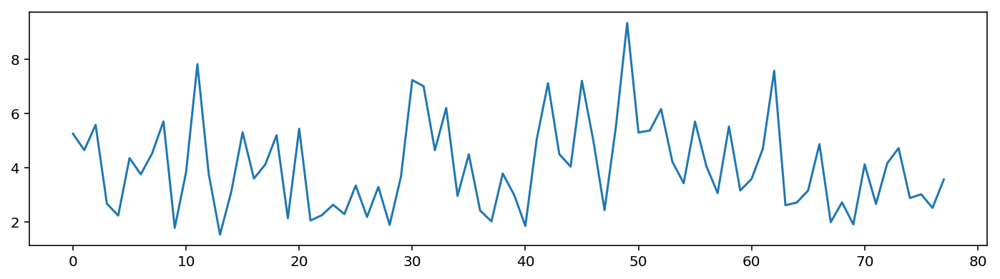

	 	 Test subset results
Test mean absolute percentage error per hour: 1.398507
Test mean absolute percentage error per day: 3.386997 
	 	 Validation Forecasting visualisation


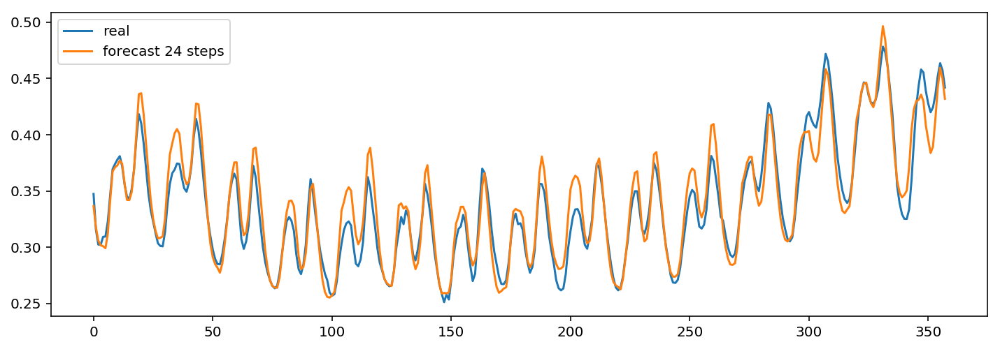

	 	 Forecasting a sample from Learning dataset


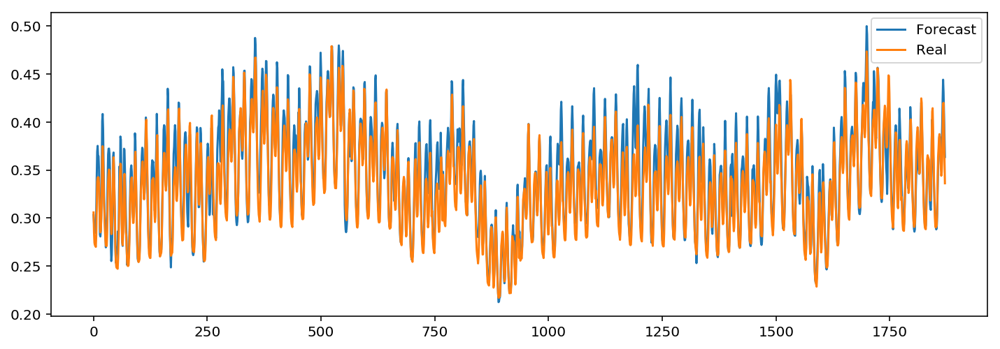

In [16]:
UsedInputsTemp= np.empty([9])
FinalErrorTemp= np.empty([2])
Parameters = np.empty([4])
ID= np.empty([1])
ID[0]=Model_ID


UsedInputsTemp[0] = previoushour = True
UsedInputsTemp[1] = timeSteps = 3
UsedInputsTemp[2] = previousDay = True
UsedInputsTemp[3] = previousWeek = True
UsedInputsTemp[4] = Temp = True
UsedInputsTemp[5] = TempMax = True
UsedInputsTemp[6] = TempMin = True
UsedInputsTemp[7] = dayIndicator = True
UsedInputsTemp[8] = HourIndicator = True

shift = False

learninginputs, learningoutputs, testinputs, testoutputs, nbrInputs = prepareInputs(daydata,season,UsedInputsTemp,testPeriod)
#learning vectors
inputx1 = np.array(pd.DataFrame(learninginputs.copy())).reshape(-1,nbrInputs)
outputx1 = np.array(pd.DataFrame(learningoutputs.copy()))

#test vectors
inputx2 = np.array(pd.DataFrame(testinputs.copy())).reshape(-1,nbrInputs)
outputx2 = np.array(pd.DataFrame(testoutputs.copy()))

Parameters[0]= HiddenNeurons1 = 20
Parameters[1]= HiddenNeurons2 = 10
Parameters[2]= LearningRate = 0.001

tempMLPmodels, tempErrorHistory,MLP_Model = create_Train_MLP_NN_Model(inputx1,outputx1,inputx2,outputx2,inputx1.shape[1],HiddenNeurons1=HiddenNeurons1,HiddenNeurons2=HiddenNeurons2
                                      ,Epoch=Epoch,LearningRate = LearningRate,Optimizer='rmsprop')

Parameters[3]= tempErrorHistory.argmin()


MLP_Model.save('Models/lstm_%d_%s_%s'%(Model_ID,season,today))
# MLP_Model = load_model('Models/lstm_%d_%s_%s'%(Model_ID,season,today))

clear_output()
print('==================================================================================')
print('\t \t test num : %s' %Model_ID )
print('==================================================================================')



LearningMAPE, testMAPE , LearningHourlyMAPE, LearningDailyForecast, LearningHourlyForecast  = getForecastingResults(
    tempMLPmodels, tempErrorHistory,learninginputs,learningoutputs,testinputs,testoutputs,MLP_Model,nbrInputs,shift,previoushour,season,timeSteps)
FinalErrorTemp[0] = LearningMAPE
FinalErrorTemp[1] = testMAPE

UsedInputList.append(UsedInputsTemp)
MAPErrorList.append(FinalErrorTemp)
ModelsList.append(MLP_Model)
ForecastingList.append(LearningDailyForecast)
Models_IDs.append(ID)
Models_parameters.append(Parameters)

print('==================================================================================')
print('\t \t Forecasting a sample from Learning dataset')
print('==================================================================================')
plt.figure(figsize=(12,4))
ForecastingList[Model_ID].index= range(ForecastingList[Model_ID].index.size)
plt.plot(ForecastingList[Model_ID].iloc[:,0],label='Forecast')
plt.plot(ForecastingList[Model_ID].iloc[:,1],label='Real')
plt.legend( loc=1, borderaxespad=0.4)
plt.show()

Model_ID = Model_ID + 1

	 	 test num : 5
	 	 learning subset results
Hourly Learning mean absolute percentage error of 1872 hours : 1.31507263332 
Daily Learning mean absolute percentage error of 78 days : 3.80155177453 
	 	 MAPError plot through Learning DataSet 


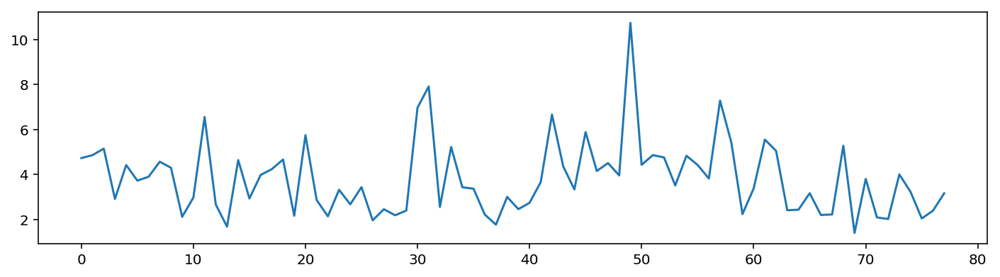

	 	 Test subset results
Test mean absolute percentage error per hour: 1.400071
Test mean absolute percentage error per day: 3.532179 
	 	 Validation Forecasting visualisation


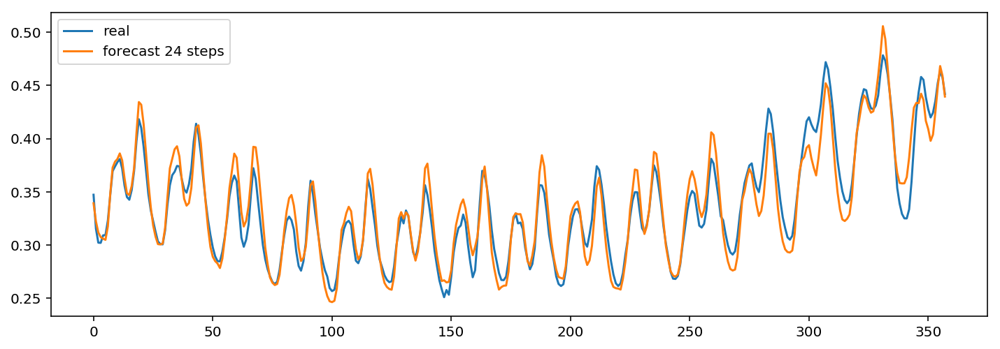

	 	 Forecasting a sample from Learning dataset


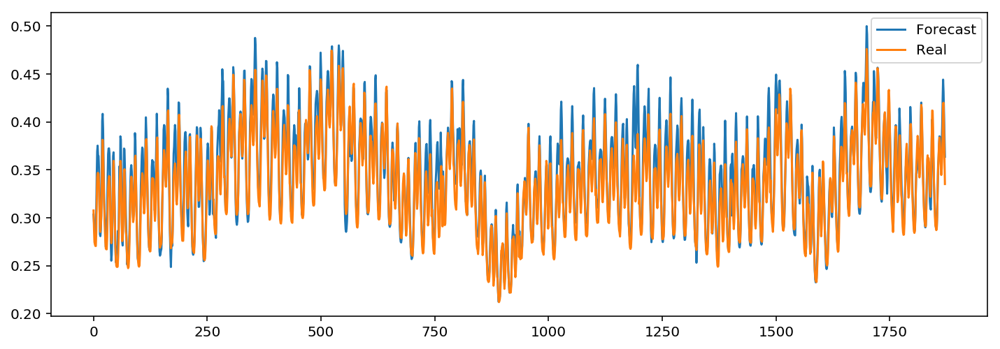

In [17]:
UsedInputsTemp= np.empty([9])
FinalErrorTemp= np.empty([2])
Parameters = np.empty([4])
ID= np.empty([1])
ID[0]=Model_ID


UsedInputsTemp[0] = previoushour = True
UsedInputsTemp[1] = timeSteps = 12
UsedInputsTemp[2] = previousDay = True
UsedInputsTemp[3] = previousWeek = True
UsedInputsTemp[4] = Temp = True
UsedInputsTemp[5] = TempMax = True
UsedInputsTemp[6] = TempMin = True
UsedInputsTemp[7] = dayIndicator = True
UsedInputsTemp[8] = HourIndicator = True

shift = False

learninginputs, learningoutputs, testinputs, testoutputs, nbrInputs = prepareInputs(daydata,season,UsedInputsTemp,testPeriod)
#learning vectors
inputx1 = np.array(pd.DataFrame(learninginputs.copy())).reshape(-1,nbrInputs)
outputx1 = np.array(pd.DataFrame(learningoutputs.copy()))

#test vectors
inputx2 = np.array(pd.DataFrame(testinputs.copy())).reshape(-1,nbrInputs)
outputx2 = np.array(pd.DataFrame(testoutputs.copy()))

Parameters[0]= HiddenNeurons1 = 20
Parameters[1]= HiddenNeurons2 = 10
Parameters[2]= LearningRate = 0.001

tempMLPmodels, tempErrorHistory,MLP_Model = create_Train_MLP_NN_Model(inputx1,outputx1,inputx2,outputx2,inputx1.shape[1],HiddenNeurons1=HiddenNeurons1,HiddenNeurons2=HiddenNeurons2
                                      ,Epoch=Epoch,LearningRate = LearningRate,Optimizer='Nadam')

Parameters[3]= tempErrorHistory.argmin()

MLP_Model.save('Models/lstm_%d_%s_%s'%(Model_ID,season,today))
# MLP_Model = load_model('Models/lstm_%d_%s_%s'%(Model_ID,season,today))

clear_output()
print('==================================================================================')
print('\t \t test num : %s' %Model_ID )
print('==================================================================================')


LearningMAPE, testMAPE , LearningHourlyMAPE, LearningDailyForecast, LearningHourlyForecast  = getForecastingResults(
    tempMLPmodels, tempErrorHistory,learninginputs,learningoutputs,testinputs,testoutputs,MLP_Model,nbrInputs,shift,previoushour,season,timeSteps)
FinalErrorTemp[0] = LearningMAPE
FinalErrorTemp[1] = testMAPE

UsedInputList.append(UsedInputsTemp)
MAPErrorList.append(FinalErrorTemp)
ModelsList.append(MLP_Model)
ForecastingList.append(LearningDailyForecast)
Models_IDs.append(ID)
Models_parameters.append(Parameters)

print('==================================================================================')
print('\t \t Forecasting a sample from Learning dataset')
print('==================================================================================')
plt.figure(figsize=(12,4))
ForecastingList[Model_ID].index= range(ForecastingList[Model_ID].index.size)
plt.plot(ForecastingList[Model_ID].iloc[:,0],label='Forecast')
plt.plot(ForecastingList[Model_ID].iloc[:,1],label='Real')
plt.legend( loc=1, borderaxespad=0.4)
plt.show()

Model_ID = Model_ID + 1

	 	 test num : 6
	 	 learning subset results
Hourly Learning mean absolute percentage error of 1872 hours : 1.26842258852 
Daily Learning mean absolute percentage error of 78 days : 3.82208531636 
	 	 MAPError plot through Learning DataSet 


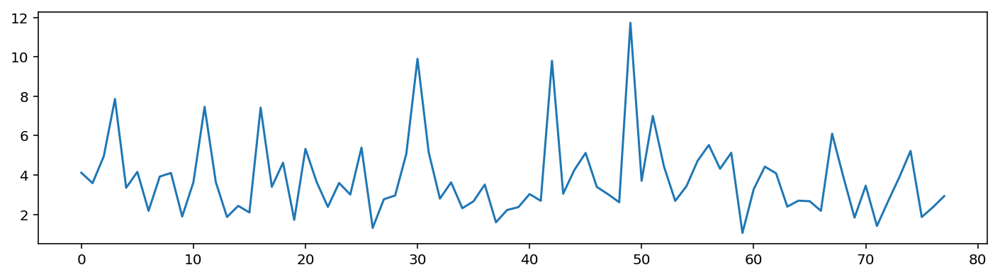

	 	 Test subset results
Test mean absolute percentage error per hour: 1.512198
Test mean absolute percentage error per day: 3.980042 
	 	 Validation Forecasting visualisation


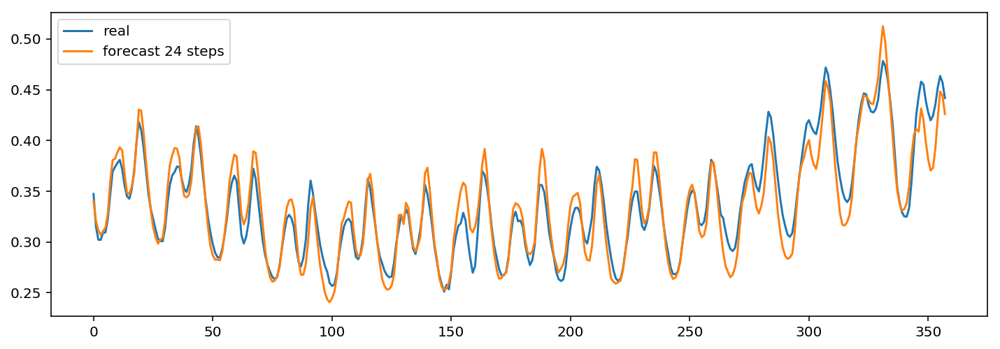

	 	 Forecasting a sample from Learning dataset


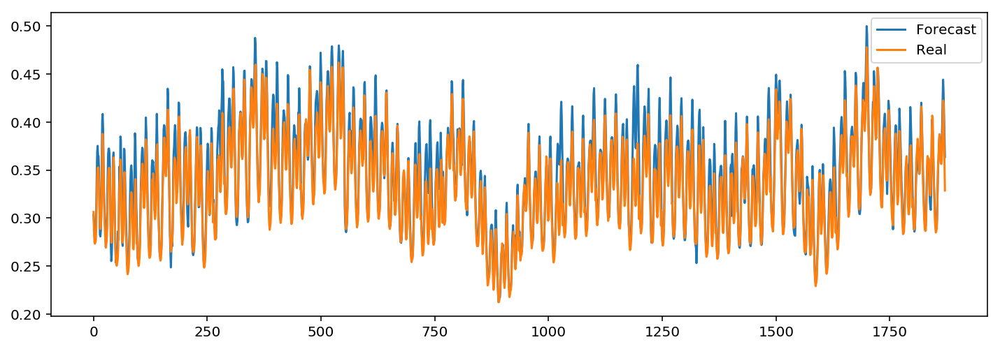

In [18]:
UsedInputsTemp= np.empty([9])
FinalErrorTemp= np.empty([2])
Parameters = np.empty([4])
ID= np.empty([1])
ID[0]=Model_ID


UsedInputsTemp[0] = previoushour = True
UsedInputsTemp[1] = timeSteps = 12
UsedInputsTemp[2] = previousDay = True
UsedInputsTemp[3] = previousWeek = True
UsedInputsTemp[4] = Temp = True
UsedInputsTemp[5] = TempMax = True
UsedInputsTemp[6] = TempMin = True
UsedInputsTemp[7] = dayIndicator = True
UsedInputsTemp[8] = HourIndicator = True

shift = False

learninginputs, learningoutputs, testinputs, testoutputs, nbrInputs = prepareInputs(daydata,season,UsedInputsTemp,testPeriod)
#learning vectors
inputx1 = np.array(pd.DataFrame(learninginputs.copy())).reshape(-1,nbrInputs)
outputx1 = np.array(pd.DataFrame(learningoutputs.copy()))

#test vectors
inputx2 = np.array(pd.DataFrame(testinputs.copy())).reshape(-1,nbrInputs)
outputx2 = np.array(pd.DataFrame(testoutputs.copy()))

Parameters[0]= HiddenNeurons1 = 60
Parameters[1]= HiddenNeurons2 = 30
Parameters[2]= LearningRate = 0.001

tempMLPmodels, tempErrorHistory,MLP_Model = create_Train_MLP_NN_Model(inputx1,outputx1,inputx2,outputx2,inputx1.shape[1],HiddenNeurons1=HiddenNeurons1,HiddenNeurons2=HiddenNeurons2
                                      ,Epoch=Epoch,LearningRate = LearningRate,Optimizer='Nadam')

Parameters[3]= tempErrorHistory.argmin()

MLP_Model.save('Models/lstm_%d_%s_%s'%(Model_ID,season,today))
# MLP_Model = load_model('Models/lstm_%d_%s_%s'%(Model_ID,season,today))

clear_output()
print('==================================================================================')
print('\t \t test num : %s' %Model_ID )
print('==================================================================================')


LearningMAPE, testMAPE , LearningHourlyMAPE, LearningDailyForecast, LearningHourlyForecast  = getForecastingResults(
    tempMLPmodels, tempErrorHistory,learninginputs,learningoutputs,testinputs,testoutputs,MLP_Model,nbrInputs,shift,previoushour,season,timeSteps)
FinalErrorTemp[0] = LearningMAPE
FinalErrorTemp[1] = testMAPE

UsedInputList.append(UsedInputsTemp)
MAPErrorList.append(FinalErrorTemp)
ModelsList.append(MLP_Model)
ForecastingList.append(LearningDailyForecast)
Models_IDs.append(ID)
Models_parameters.append(Parameters)

print('==================================================================================')
print('\t \t Forecasting a sample from Learning dataset')
print('==================================================================================')
plt.figure(figsize=(12,4))
ForecastingList[Model_ID].index= range(ForecastingList[Model_ID].index.size)
plt.plot(ForecastingList[Model_ID].iloc[:,0],label='Forecast')
plt.plot(ForecastingList[Model_ID].iloc[:,1],label='Real')
plt.legend( loc=1, borderaxespad=0.4)
plt.show()

Model_ID = Model_ID + 1

	 	 test num : 7
	 	 learning subset results
Hourly Learning mean absolute percentage error of 1872 hours : 1.27532423136 
Daily Learning mean absolute percentage error of 78 days : 3.26689396913 
	 	 MAPError plot through Learning DataSet 


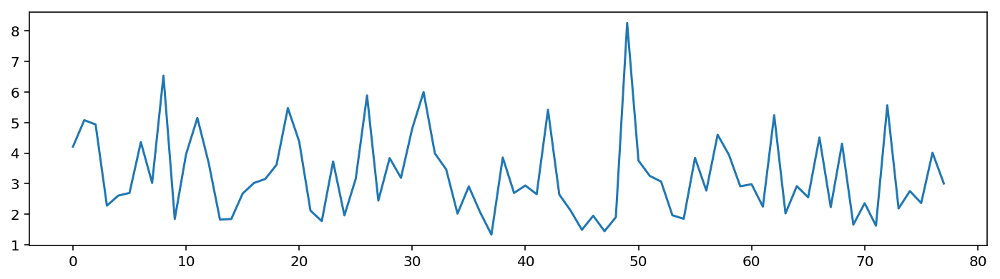

	 	 Test subset results
Test mean absolute percentage error per hour: 1.429221
Test mean absolute percentage error per day: 4.578066 
	 	 Validation Forecasting visualisation


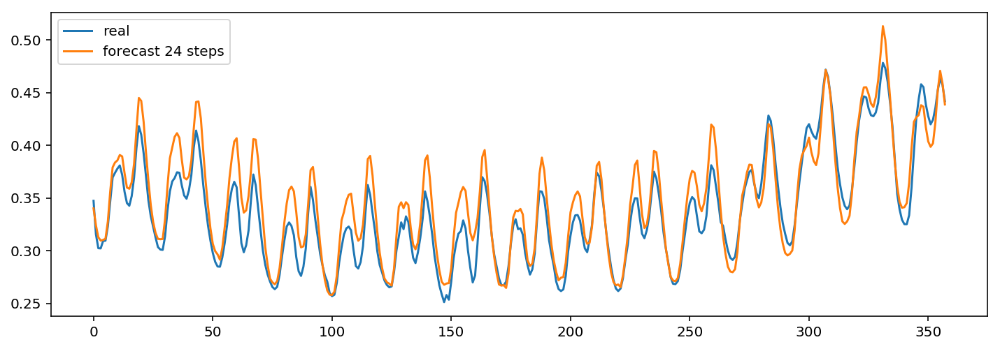

	 	 Forecasting a sample from Learning dataset


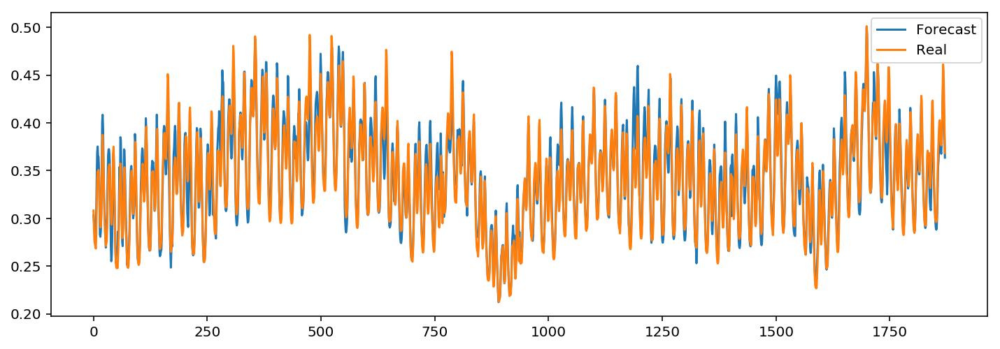

In [19]:
UsedInputsTemp= np.empty([9])
FinalErrorTemp= np.empty([2])
Parameters = np.empty([4])
ID= np.empty([1])
ID[0]=Model_ID


UsedInputsTemp[0] = previoushour = True
UsedInputsTemp[1] = timeSteps = 12
UsedInputsTemp[2] = previousDay = True
UsedInputsTemp[3] = previousWeek = True
UsedInputsTemp[4] = Temp = True
UsedInputsTemp[5] = TempMax = True
UsedInputsTemp[6] = TempMin = True
UsedInputsTemp[7] = dayIndicator = True
UsedInputsTemp[8] = HourIndicator = True

shift = False

learninginputs, learningoutputs, testinputs, testoutputs, nbrInputs = prepareInputs(daydata,season,UsedInputsTemp,testPeriod)
#learning vectors
inputx1 = np.array(pd.DataFrame(learninginputs.copy())).reshape(-1,nbrInputs)
outputx1 = np.array(pd.DataFrame(learningoutputs.copy()))

#test vectors
inputx2 = np.array(pd.DataFrame(testinputs.copy())).reshape(-1,nbrInputs)
outputx2 = np.array(pd.DataFrame(testoutputs.copy()))

Parameters[0]= HiddenNeurons1 = 50
Parameters[1]= HiddenNeurons2 = 10
Parameters[2]= LearningRate = 0.001

tempMLPmodels, tempErrorHistory,MLP_Model = create_Train_MLP_NN_Model(inputx1,outputx1,inputx2,outputx2,inputx1.shape[1],HiddenNeurons1=HiddenNeurons1,HiddenNeurons2=HiddenNeurons2
                                      ,Epoch=Epoch,LearningRate = LearningRate,Optimizer='Nadam')

Parameters[3]= tempErrorHistory.argmin()

MLP_Model.save('Models/lstm_%d_%s_%s'%(Model_ID,season,today))
# MLP_Model = load_model('Models/lstm_%d_%s_%s'%(Model_ID,season,today))

clear_output()
print('==================================================================================')
print('\t \t test num : %s' %Model_ID )
print('==================================================================================')


LearningMAPE, testMAPE , LearningHourlyMAPE, LearningDailyForecast, LearningHourlyForecast  = getForecastingResults(
    tempMLPmodels, tempErrorHistory,learninginputs,learningoutputs,testinputs,testoutputs,MLP_Model,nbrInputs,shift,previoushour,season,timeSteps)
FinalErrorTemp[0] = LearningMAPE
FinalErrorTemp[1] = testMAPE

UsedInputList.append(UsedInputsTemp)
MAPErrorList.append(FinalErrorTemp)
ModelsList.append(MLP_Model)
ForecastingList.append(LearningDailyForecast)
Models_IDs.append(ID)
Models_parameters.append(Parameters)

print('==================================================================================')
print('\t \t Forecasting a sample from Learning dataset')
print('==================================================================================')
plt.figure(figsize=(12,4))
ForecastingList[Model_ID].index= range(ForecastingList[Model_ID].index.size)
plt.plot(ForecastingList[Model_ID].iloc[:,0],label='Forecast')
plt.plot(ForecastingList[Model_ID].iloc[:,1],label='Real')
plt.legend( loc=1, borderaxespad=0.4)
plt.show()

Model_ID = Model_ID + 1

	 	 test num : 8
	 	 learning subset results
Hourly Learning mean absolute percentage error of 1872 hours : 1.37076579394 
Daily Learning mean absolute percentage error of 78 days : 3.3648273792 
	 	 MAPError plot through Learning DataSet 


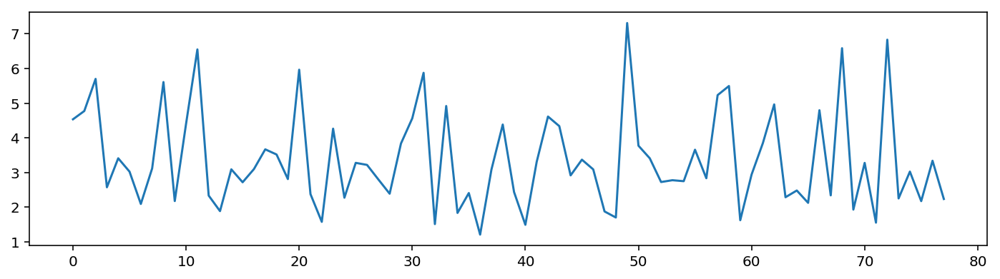

	 	 Test subset results
Test mean absolute percentage error per hour: 1.621412
Test mean absolute percentage error per day: 3.901970 
	 	 Validation Forecasting visualisation


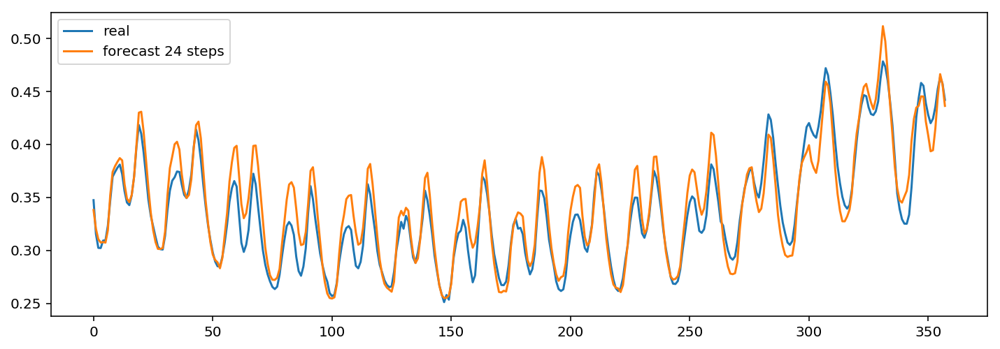

	 	 Forecasting a sample from Learning dataset


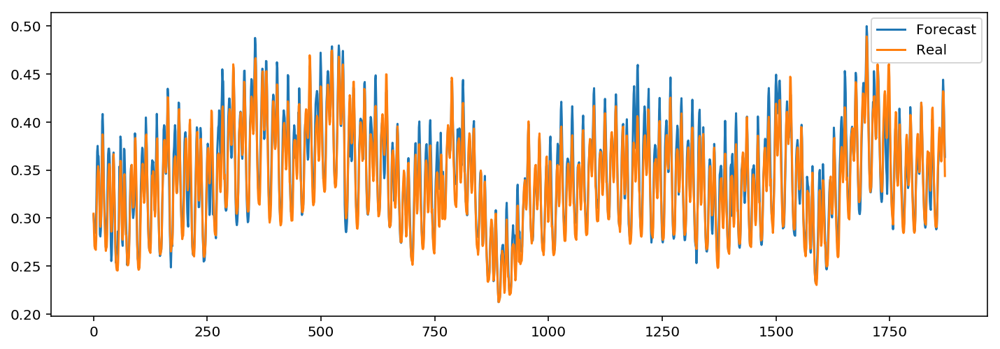

In [20]:
UsedInputsTemp= np.empty([9])
FinalErrorTemp= np.empty([2])
Parameters = np.empty([4])
ID= np.empty([1])
ID[0]=Model_ID


UsedInputsTemp[0] = previoushour = True
UsedInputsTemp[1] = timeSteps = 12
UsedInputsTemp[2] = previousDay = True
UsedInputsTemp[3] = previousWeek = True
UsedInputsTemp[4] = Temp = True
UsedInputsTemp[5] = TempMax = True
UsedInputsTemp[6] = TempMin = True
UsedInputsTemp[7] = dayIndicator = True
UsedInputsTemp[8] = HourIndicator = True

shift = False

learninginputs, learningoutputs, testinputs, testoutputs, nbrInputs = prepareInputs(daydata,season,UsedInputsTemp,testPeriod)
#learning vectors
inputx1 = np.array(pd.DataFrame(learninginputs.copy())).reshape(-1,nbrInputs)
outputx1 = np.array(pd.DataFrame(learningoutputs.copy()))

#test vectors
inputx2 = np.array(pd.DataFrame(testinputs.copy())).reshape(-1,nbrInputs)
outputx2 = np.array(pd.DataFrame(testoutputs.copy()))

Parameters[0]= HiddenNeurons1 = 80
Parameters[1]= HiddenNeurons2 = 50
Parameters[2]= LearningRate = 0.001

tempMLPmodels, tempErrorHistory,MLP_Model = create_Train_MLP_NN_Model(inputx1,outputx1,inputx2,outputx2,inputx1.shape[1],HiddenNeurons1=HiddenNeurons1,HiddenNeurons2=HiddenNeurons2
                                      ,Epoch=Epoch,LearningRate = LearningRate,Optimizer='Nadam')

Parameters[3]= tempErrorHistory.argmin()

MLP_Model.save('Models/lstm_%d_%s_%s'%(Model_ID,season,today))
# MLP_Model = load_model('Models/lstm_%d_%s_%s'%(Model_ID,season,today))

clear_output()
print('==================================================================================')
print('\t \t test num : %s' %Model_ID )
print('==================================================================================')


LearningMAPE, testMAPE , LearningHourlyMAPE, LearningDailyForecast, LearningHourlyForecast  = getForecastingResults(
    tempMLPmodels, tempErrorHistory,learninginputs,learningoutputs,testinputs,testoutputs,MLP_Model,nbrInputs,shift,previoushour,season,timeSteps)
FinalErrorTemp[0] = LearningMAPE
FinalErrorTemp[1] = testMAPE

UsedInputList.append(UsedInputsTemp)
MAPErrorList.append(FinalErrorTemp)
ModelsList.append(MLP_Model)
ForecastingList.append(LearningDailyForecast)
Models_IDs.append(ID)
Models_parameters.append(Parameters)

print('==================================================================================')
print('\t \t Forecasting a sample from Learning dataset')
print('==================================================================================')
plt.figure(figsize=(12,4))
ForecastingList[Model_ID].index= range(ForecastingList[Model_ID].index.size)
plt.plot(ForecastingList[Model_ID].iloc[:,0],label='Forecast')
plt.plot(ForecastingList[Model_ID].iloc[:,1],label='Real')
plt.legend( loc=1, borderaxespad=0.4)
plt.show()

Model_ID = Model_ID + 1

	 	 test num : 9
	 	 learning subset results
Hourly Learning mean absolute percentage error of 1872 hours : 1.44231475161 
Daily Learning mean absolute percentage error of 78 days : 4.03923257803 
	 	 MAPError plot through Learning DataSet 


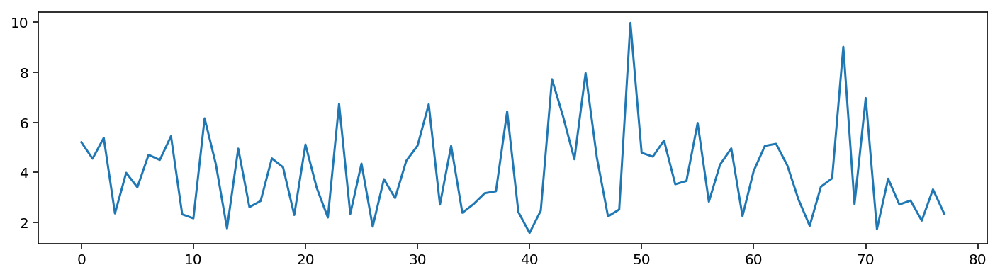

	 	 Test subset results
Test mean absolute percentage error per hour: 1.337163
Test mean absolute percentage error per day: 4.239113 
	 	 Validation Forecasting visualisation


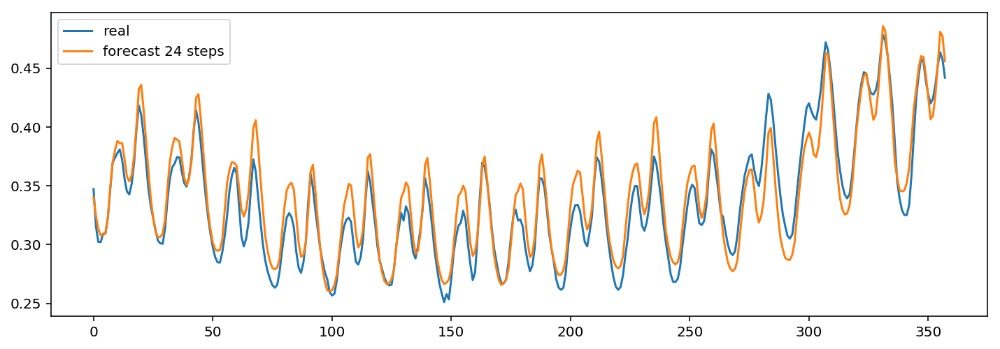

	 	 Forecasting a sample from Learning dataset


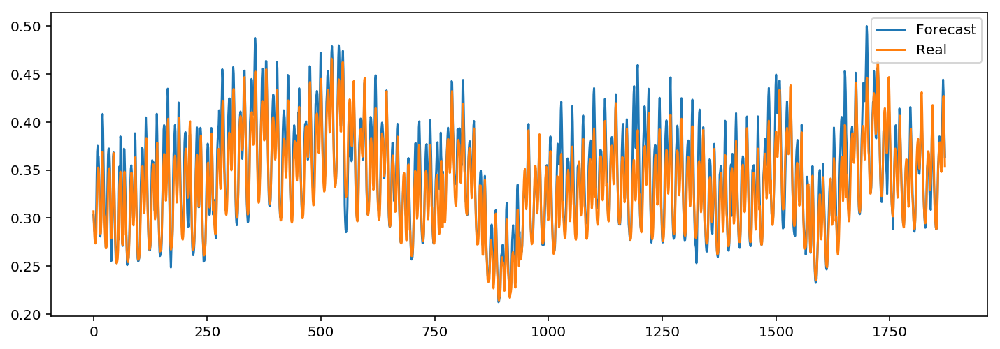

In [21]:
UsedInputsTemp= np.empty([9])
FinalErrorTemp= np.empty([2])
Parameters = np.empty([4])
ID= np.empty([1])
ID[0]=Model_ID


UsedInputsTemp[0] = previoushour = True
UsedInputsTemp[1] = timeSteps = 12
UsedInputsTemp[2] = previousDay = True
UsedInputsTemp[3] = previousWeek = True
UsedInputsTemp[4] = Temp = True
UsedInputsTemp[5] = TempMax = True
UsedInputsTemp[6] = TempMin = True
UsedInputsTemp[7] = dayIndicator = False
UsedInputsTemp[8] = HourIndicator = True

shift = False

learninginputs, learningoutputs, testinputs, testoutputs, nbrInputs = prepareInputs(daydata,season,UsedInputsTemp,testPeriod)
#learning vectors
inputx1 = np.array(pd.DataFrame(learninginputs.copy())).reshape(-1,nbrInputs)
outputx1 = np.array(pd.DataFrame(learningoutputs.copy()))

#test vectors
inputx2 = np.array(pd.DataFrame(testinputs.copy())).reshape(-1,nbrInputs)
outputx2 = np.array(pd.DataFrame(testoutputs.copy()))

Parameters[0]= HiddenNeurons1 = 90
Parameters[1]= HiddenNeurons2 = 30
Parameters[2]= LearningRate = 0.002

tempMLPmodels, tempErrorHistory,MLP_Model = create_Train_MLP_NN_Model(inputx1,outputx1,inputx2,outputx2,inputx1.shape[1],HiddenNeurons1=HiddenNeurons1,HiddenNeurons2=HiddenNeurons2
                                      ,Epoch=Epoch,LearningRate = LearningRate,Optimizer='Nadam')

Parameters[3]= tempErrorHistory.argmin()

MLP_Model.save('Models/lstm_%d_%s_%s'%(Model_ID,season,today))
# MLP_Model = load_model('Models/lstm_%d_%s_%s'%(Model_ID,season,today))

clear_output()
print('==================================================================================')
print('\t \t test num : %s' %Model_ID )
print('==================================================================================')


LearningMAPE, testMAPE , LearningHourlyMAPE, LearningDailyForecast, LearningHourlyForecast  = getForecastingResults(
    tempMLPmodels, tempErrorHistory,learninginputs,learningoutputs,testinputs,testoutputs,MLP_Model,nbrInputs,shift,previoushour,season,timeSteps)
FinalErrorTemp[0] = LearningMAPE
FinalErrorTemp[1] = testMAPE

UsedInputList.append(UsedInputsTemp)
MAPErrorList.append(FinalErrorTemp)
ModelsList.append(MLP_Model)
ForecastingList.append(LearningDailyForecast)
Models_IDs.append(ID)
Models_parameters.append(Parameters)

print('==================================================================================')
print('\t \t Forecasting a sample from Learning dataset')
print('==================================================================================')
plt.figure(figsize=(12,4))
ForecastingList[Model_ID].index= range(ForecastingList[Model_ID].index.size)
plt.plot(ForecastingList[Model_ID].iloc[:,0],label='Forecast')
plt.plot(ForecastingList[Model_ID].iloc[:,1],label='Real')
plt.legend( loc=1, borderaxespad=0.4)
plt.show()

Model_ID = Model_ID + 1

	 	 test num : 10
	 	 learning subset results
Hourly Learning mean absolute percentage error of 1872 hours : 2.06918170373 
Daily Learning mean absolute percentage error of 78 days : 5.24104230068 
	 	 MAPError plot through Learning DataSet 


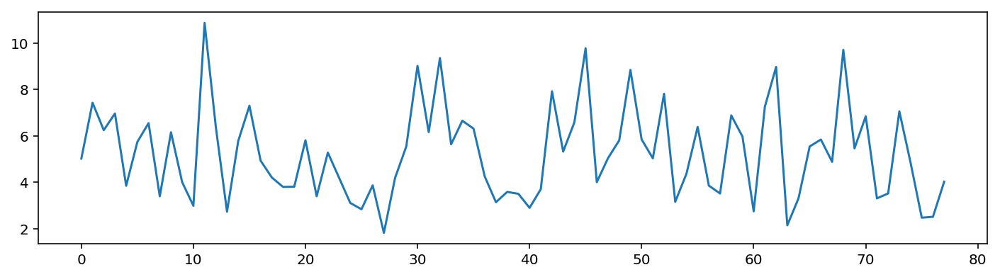

	 	 Test subset results
Test mean absolute percentage error per hour: 1.533316
Test mean absolute percentage error per day: 4.156270 
	 	 Validation Forecasting visualisation


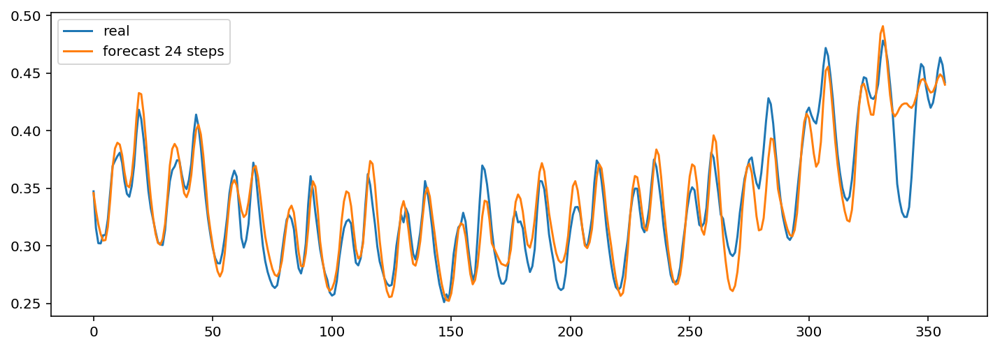

	 	 Forecasting a sample from Learning dataset


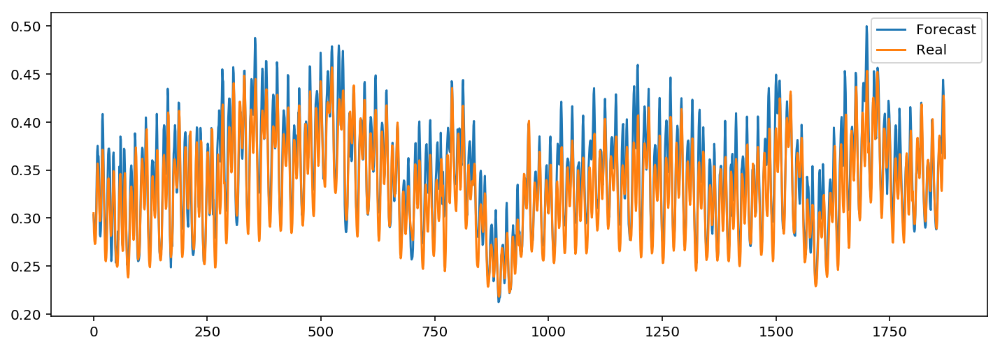

In [22]:
UsedInputsTemp= np.empty([9])
FinalErrorTemp= np.empty([2])
Parameters = np.empty([4])
ID= np.empty([1])
ID[0]=Model_ID


UsedInputsTemp[0] = previoushour = True
UsedInputsTemp[1] = timeSteps = 12
UsedInputsTemp[2] = previousDay = True
UsedInputsTemp[3] = previousWeek = True
UsedInputsTemp[4] = Temp = True
UsedInputsTemp[5] = TempMax = True
UsedInputsTemp[6] = TempMin = True
UsedInputsTemp[7] = dayIndicator = True
UsedInputsTemp[8] = HourIndicator = False

shift = False

learninginputs, learningoutputs, testinputs, testoutputs, nbrInputs = prepareInputs(daydata,season,UsedInputsTemp,testPeriod)
#learning vectors
inputx1 = np.array(pd.DataFrame(learninginputs.copy())).reshape(-1,nbrInputs)
outputx1 = np.array(pd.DataFrame(learningoutputs.copy()))

#test vectors
inputx2 = np.array(pd.DataFrame(testinputs.copy())).reshape(-1,nbrInputs)
outputx2 = np.array(pd.DataFrame(testoutputs.copy()))

Parameters[0]= HiddenNeurons1 = 90
Parameters[1]= HiddenNeurons2 = 30
Parameters[2]= LearningRate = 0.002

tempMLPmodels, tempErrorHistory,MLP_Model = create_Train_MLP_NN_Model(inputx1,outputx1,inputx2,outputx2,inputx1.shape[1],HiddenNeurons1=HiddenNeurons1,HiddenNeurons2=HiddenNeurons2
                                      ,Epoch=Epoch,LearningRate = LearningRate,Optimizer='Nadam')

Parameters[3]= tempErrorHistory.argmin()

MLP_Model.save('Models/lstm_%d_%s_%s'%(Model_ID,season,today))
# MLP_Model = load_model('Models/lstm_%d_%s_%s'%(Model_ID,season,today))

clear_output()
print('==================================================================================')
print('\t \t test num : %s' %Model_ID )
print('==================================================================================')


LearningMAPE, testMAPE , LearningHourlyMAPE, LearningDailyForecast, LearningHourlyForecast  = getForecastingResults(
    tempMLPmodels, tempErrorHistory,learninginputs,learningoutputs,testinputs,testoutputs,MLP_Model,nbrInputs,shift,previoushour,season,timeSteps)
FinalErrorTemp[0] = LearningMAPE
FinalErrorTemp[1] = testMAPE

UsedInputList.append(UsedInputsTemp)
MAPErrorList.append(FinalErrorTemp)
ModelsList.append(MLP_Model)
ForecastingList.append(LearningDailyForecast)
Models_IDs.append(ID)
Models_parameters.append(Parameters)

print('==================================================================================')
print('\t \t Forecasting a sample from Learning dataset')
print('==================================================================================')
plt.figure(figsize=(12,4))
ForecastingList[Model_ID].index= range(ForecastingList[Model_ID].index.size)
plt.plot(ForecastingList[Model_ID].iloc[:,0],label='Forecast')
plt.plot(ForecastingList[Model_ID].iloc[:,1],label='Real')
plt.legend( loc=1, borderaxespad=0.4)
plt.show()

Model_ID = Model_ID + 1

	 	 test num : 11
	 	 learning subset results
Hourly Learning mean absolute percentage error of 1872 hours : 1.66941954537 
Daily Learning mean absolute percentage error of 78 days : 4.87223350849 
	 	 MAPError plot through Learning DataSet 


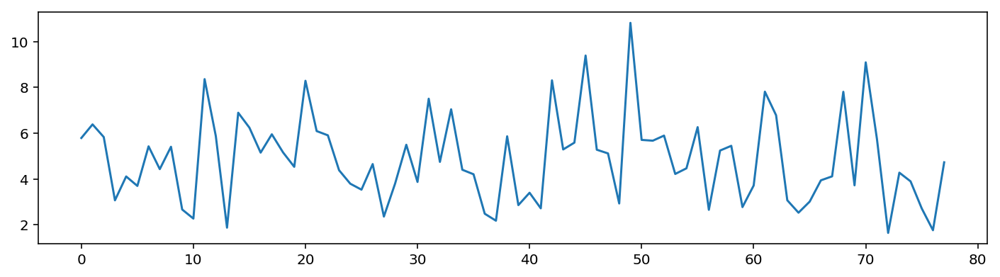

	 	 Test subset results
Test mean absolute percentage error per hour: 1.254609
Test mean absolute percentage error per day: 4.286271 
	 	 Validation Forecasting visualisation


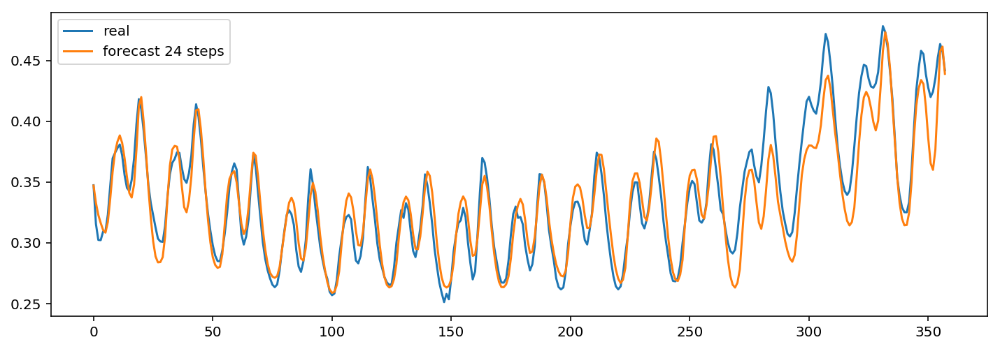

	 	 Forecasting a sample from Learning dataset


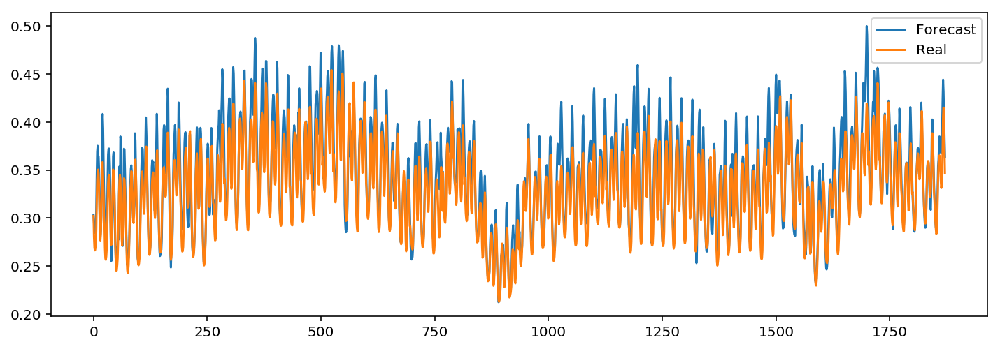

In [23]:
UsedInputsTemp= np.empty([9])
FinalErrorTemp= np.empty([2])
Parameters = np.empty([4])
ID= np.empty([1])
ID[0]=Model_ID


UsedInputsTemp[0] = previoushour = True
UsedInputsTemp[1] = timeSteps = 12
UsedInputsTemp[2] = previousDay = True
UsedInputsTemp[3] = previousWeek = True
UsedInputsTemp[4] = Temp = True
UsedInputsTemp[5] = TempMax = True
UsedInputsTemp[6] = TempMin = True
UsedInputsTemp[7] = dayIndicator = False
UsedInputsTemp[8] = HourIndicator = False

shift = False

learninginputs, learningoutputs, testinputs, testoutputs, nbrInputs = prepareInputs(daydata,season,UsedInputsTemp,testPeriod)
#learning vectors
inputx1 = np.array(pd.DataFrame(learninginputs.copy())).reshape(-1,nbrInputs)
outputx1 = np.array(pd.DataFrame(learningoutputs.copy()))

#test vectors
inputx2 = np.array(pd.DataFrame(testinputs.copy())).reshape(-1,nbrInputs)
outputx2 = np.array(pd.DataFrame(testoutputs.copy()))

Parameters[0]= HiddenNeurons1 = 90
Parameters[1]= HiddenNeurons2 = 30
Parameters[2]= LearningRate = 0.002

tempMLPmodels, tempErrorHistory,MLP_Model = create_Train_MLP_NN_Model(inputx1,outputx1,inputx2,outputx2,inputx1.shape[1],HiddenNeurons1=HiddenNeurons1,HiddenNeurons2=HiddenNeurons2
                                      ,Epoch=Epoch,LearningRate = LearningRate,Optimizer='Nadam')

Parameters[3]= tempErrorHistory.argmin()

MLP_Model.save('Models/lstm_%d_%s_%s'%(Model_ID,season,today))
# MLP_Model = load_model('Models/lstm_%d_%s_%s'%(Model_ID,season,today))

clear_output()
print('==================================================================================')
print('\t \t test num : %s' %Model_ID )
print('==================================================================================')


LearningMAPE, testMAPE , LearningHourlyMAPE, LearningDailyForecast, LearningHourlyForecast  = getForecastingResults(
    tempMLPmodels, tempErrorHistory,learninginputs,learningoutputs,testinputs,testoutputs,MLP_Model,nbrInputs,shift,previoushour,season,timeSteps)
FinalErrorTemp[0] = LearningMAPE
FinalErrorTemp[1] = testMAPE

UsedInputList.append(UsedInputsTemp)
MAPErrorList.append(FinalErrorTemp)
ModelsList.append(MLP_Model)
ForecastingList.append(LearningDailyForecast)
Models_IDs.append(ID)
Models_parameters.append(Parameters)

print('==================================================================================')
print('\t \t Forecasting a sample from Learning dataset')
print('==================================================================================')
plt.figure(figsize=(12,4))
ForecastingList[Model_ID].index= range(ForecastingList[Model_ID].index.size)
plt.plot(ForecastingList[Model_ID].iloc[:,0],label='Forecast')
plt.plot(ForecastingList[Model_ID].iloc[:,1],label='Real')
plt.legend( loc=1, borderaxespad=0.4)
plt.show()

Model_ID = Model_ID + 1

	 	 test num : 12
	 	 learning subset results
Hourly Learning mean absolute percentage error of 1872 hours : 1.33918018569 
Daily Learning mean absolute percentage error of 78 days : 4.09608558508 
	 	 MAPError plot through Learning DataSet 


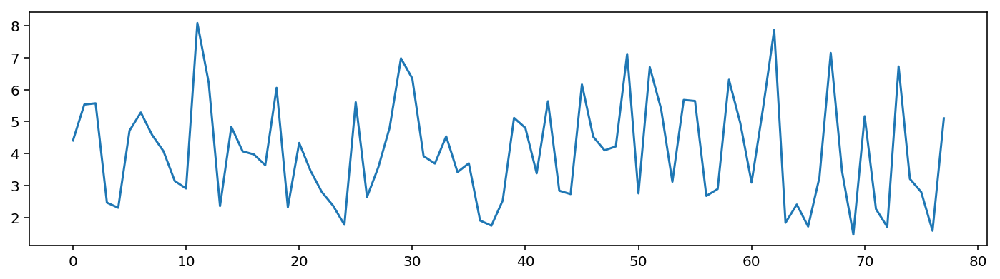

	 	 Test subset results
Test mean absolute percentage error per hour: 1.580964
Test mean absolute percentage error per day: 4.483940 
	 	 Validation Forecasting visualisation


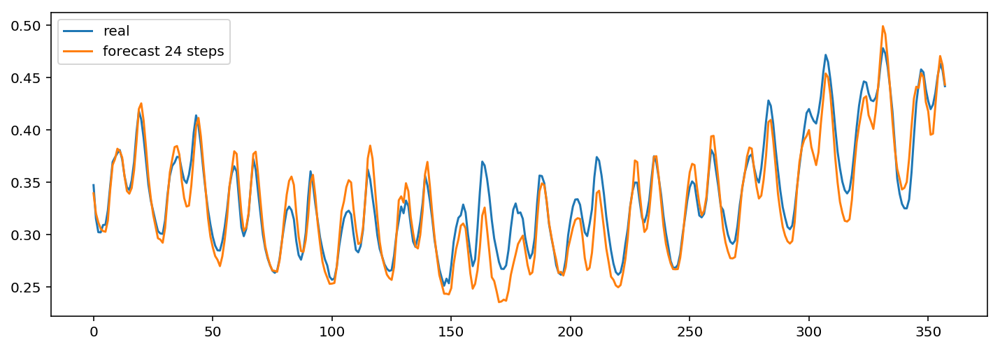

	 	 Forecasting a sample from Learning dataset


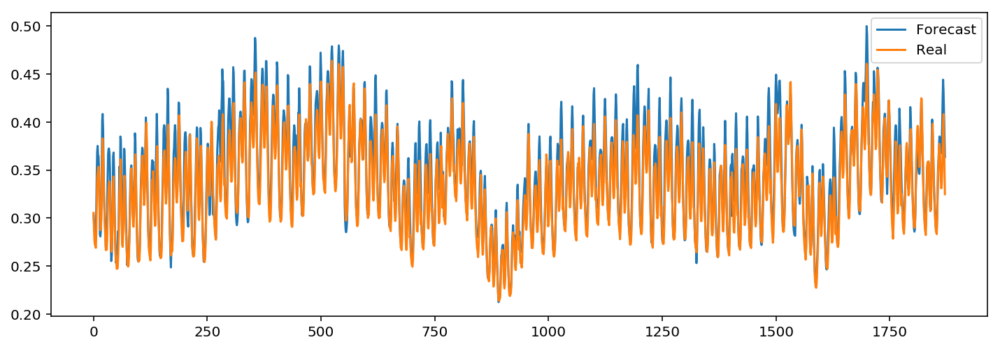

In [24]:
UsedInputsTemp= np.empty([9])
FinalErrorTemp= np.empty([2])
Parameters = np.empty([4])
ID= np.empty([1])
ID[0]=Model_ID


UsedInputsTemp[0] = previoushour = True
UsedInputsTemp[1] = timeSteps = 12
UsedInputsTemp[2] = previousDay = True
UsedInputsTemp[3] = previousWeek = True
UsedInputsTemp[4] = Temp = False
UsedInputsTemp[5] = TempMax = True
UsedInputsTemp[6] = TempMin = True
UsedInputsTemp[7] = dayIndicator = True
UsedInputsTemp[8] = HourIndicator = True

shift = False

learninginputs, learningoutputs, testinputs, testoutputs, nbrInputs = prepareInputs(daydata,season,UsedInputsTemp,testPeriod)
#learning vectors
inputx1 = np.array(pd.DataFrame(learninginputs.copy())).reshape(-1,nbrInputs)
outputx1 = np.array(pd.DataFrame(learningoutputs.copy()))

#test vectors
inputx2 = np.array(pd.DataFrame(testinputs.copy())).reshape(-1,nbrInputs)
outputx2 = np.array(pd.DataFrame(testoutputs.copy()))

Parameters[0]= HiddenNeurons1 = 90
Parameters[1]= HiddenNeurons2 = 30
Parameters[2]= LearningRate = 0.002

tempMLPmodels, tempErrorHistory,MLP_Model = create_Train_MLP_NN_Model(inputx1,outputx1,inputx2,outputx2,inputx1.shape[1],HiddenNeurons1=HiddenNeurons1,HiddenNeurons2=HiddenNeurons2
                                      ,Epoch=Epoch,LearningRate = LearningRate,Optimizer='Nadam')

Parameters[3]= tempErrorHistory.argmin()

MLP_Model.save('Models/lstm_%d_%s_%s'%(Model_ID,season,today))
# MLP_Model = load_model('Models/lstm_%d_%s_%s'%(Model_ID,season,today))

clear_output()
print('==================================================================================')
print('\t \t test num : %s' %Model_ID )
print('==================================================================================')


LearningMAPE, testMAPE , LearningHourlyMAPE, LearningDailyForecast, LearningHourlyForecast  = getForecastingResults(
    tempMLPmodels, tempErrorHistory,learninginputs,learningoutputs,testinputs,testoutputs,MLP_Model,nbrInputs,shift,previoushour,season,timeSteps)
FinalErrorTemp[0] = LearningMAPE
FinalErrorTemp[1] = testMAPE

UsedInputList.append(UsedInputsTemp)
MAPErrorList.append(FinalErrorTemp)
ModelsList.append(MLP_Model)
ForecastingList.append(LearningDailyForecast)
Models_IDs.append(ID)
Models_parameters.append(Parameters)

print('==================================================================================')
print('\t \t Forecasting a sample from Learning dataset')
print('==================================================================================')
plt.figure(figsize=(12,4))
ForecastingList[Model_ID].index= range(ForecastingList[Model_ID].index.size)
plt.plot(ForecastingList[Model_ID].iloc[:,0],label='Forecast')
plt.plot(ForecastingList[Model_ID].iloc[:,1],label='Real')
plt.legend( loc=1, borderaxespad=0.4)
plt.show()

Model_ID = Model_ID + 1

	 	 test num : 13
	 	 learning subset results
Hourly Learning mean absolute percentage error of 1872 hours : 1.53773786026 
Daily Learning mean absolute percentage error of 78 days : 4.12294674073 
	 	 MAPError plot through Learning DataSet 


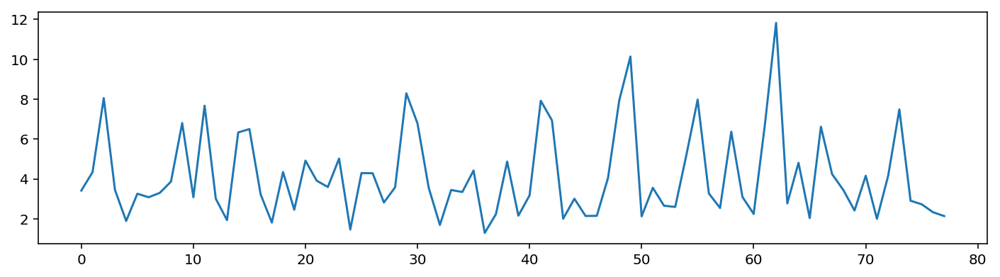

	 	 Test subset results
Test mean absolute percentage error per hour: 1.638597
Test mean absolute percentage error per day: 4.100821 
	 	 Validation Forecasting visualisation


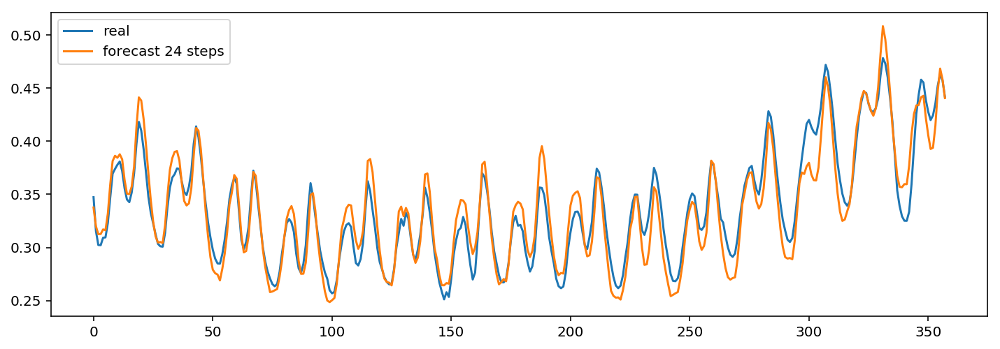

	 	 Forecasting a sample from Learning dataset


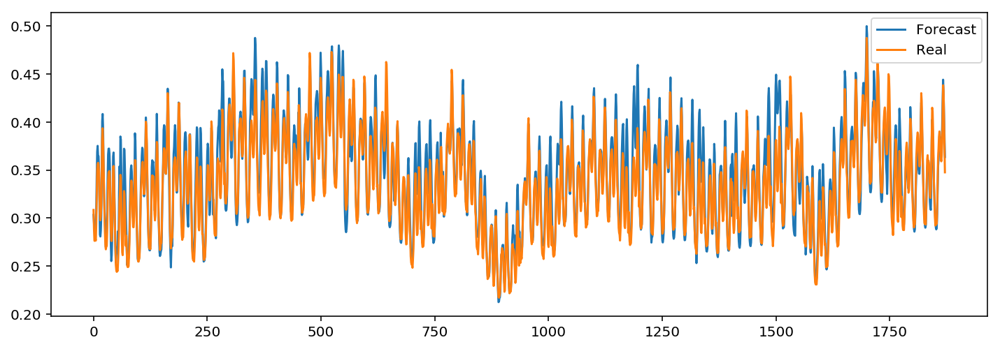

In [25]:
UsedInputsTemp= np.empty([9])
FinalErrorTemp= np.empty([2])
Parameters = np.empty([4])
ID= np.empty([1])
ID[0]=Model_ID


UsedInputsTemp[0] = previoushour = True
UsedInputsTemp[1] = timeSteps = 12
UsedInputsTemp[2] = previousDay = True
UsedInputsTemp[3] = previousWeek = True
UsedInputsTemp[4] = Temp = True
UsedInputsTemp[5] = TempMax = False
UsedInputsTemp[6] = TempMin = True
UsedInputsTemp[7] = dayIndicator = True
UsedInputsTemp[8] = HourIndicator = True

shift = False

learninginputs, learningoutputs, testinputs, testoutputs, nbrInputs = prepareInputs(daydata,season,UsedInputsTemp,testPeriod)
#learning vectors
inputx1 = np.array(pd.DataFrame(learninginputs.copy())).reshape(-1,nbrInputs)
outputx1 = np.array(pd.DataFrame(learningoutputs.copy()))

#test vectors
inputx2 = np.array(pd.DataFrame(testinputs.copy())).reshape(-1,nbrInputs)
outputx2 = np.array(pd.DataFrame(testoutputs.copy()))

Parameters[0]= HiddenNeurons1 = 90
Parameters[1]= HiddenNeurons2 = 30
Parameters[2]= LearningRate = 0.002

tempMLPmodels, tempErrorHistory,MLP_Model = create_Train_MLP_NN_Model(inputx1,outputx1,inputx2,outputx2,inputx1.shape[1],HiddenNeurons1=HiddenNeurons1,HiddenNeurons2=HiddenNeurons2
                                      ,Epoch=Epoch,LearningRate = LearningRate,Optimizer='Nadam')

Parameters[3]= tempErrorHistory.argmin()

MLP_Model.save('Models/lstm_%d_%s_%s'%(Model_ID,season,today))
# MLP_Model = load_model('Models/lstm_%d_%s_%s'%(Model_ID,season,today))

clear_output()
print('==================================================================================')
print('\t \t test num : %s' %Model_ID )
print('==================================================================================')


LearningMAPE, testMAPE , LearningHourlyMAPE, LearningDailyForecast, LearningHourlyForecast  = getForecastingResults(
    tempMLPmodels, tempErrorHistory,learninginputs,learningoutputs,testinputs,testoutputs,MLP_Model,nbrInputs,shift,previoushour,season,timeSteps)
FinalErrorTemp[0] = LearningMAPE
FinalErrorTemp[1] = testMAPE

UsedInputList.append(UsedInputsTemp)
MAPErrorList.append(FinalErrorTemp)
ModelsList.append(MLP_Model)
ForecastingList.append(LearningDailyForecast)
Models_IDs.append(ID)
Models_parameters.append(Parameters)

print('==================================================================================')
print('\t \t Forecasting a sample from Learning dataset')
print('==================================================================================')
plt.figure(figsize=(12,4))
ForecastingList[Model_ID].index= range(ForecastingList[Model_ID].index.size)
plt.plot(ForecastingList[Model_ID].iloc[:,0],label='Forecast')
plt.plot(ForecastingList[Model_ID].iloc[:,1],label='Real')
plt.legend( loc=1, borderaxespad=0.4)
plt.show()

Model_ID = Model_ID + 1

	 	 test num : 14
	 	 learning subset results
Hourly Learning mean absolute percentage error of 1872 hours : 1.36072381593 
Daily Learning mean absolute percentage error of 78 days : 3.95074244875 
	 	 MAPError plot through Learning DataSet 


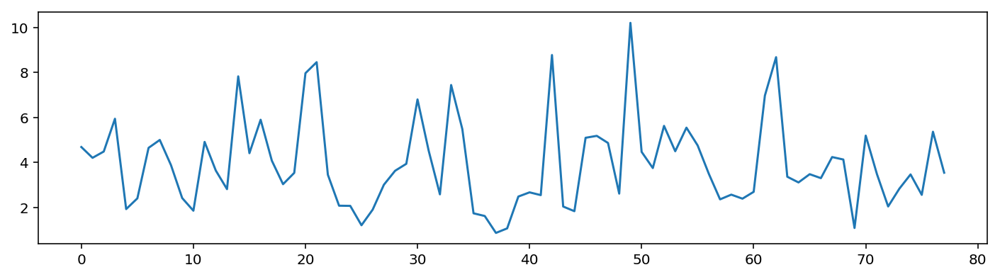

	 	 Test subset results
Test mean absolute percentage error per hour: 1.596586
Test mean absolute percentage error per day: 3.558472 
	 	 Validation Forecasting visualisation


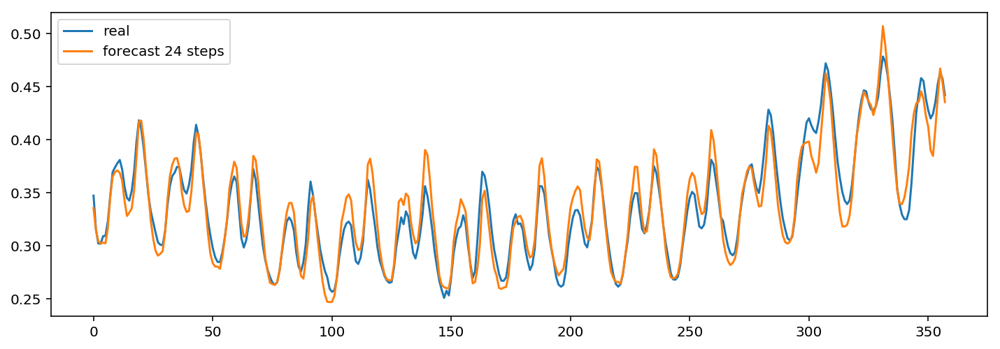

	 	 Forecasting a sample from Learning dataset


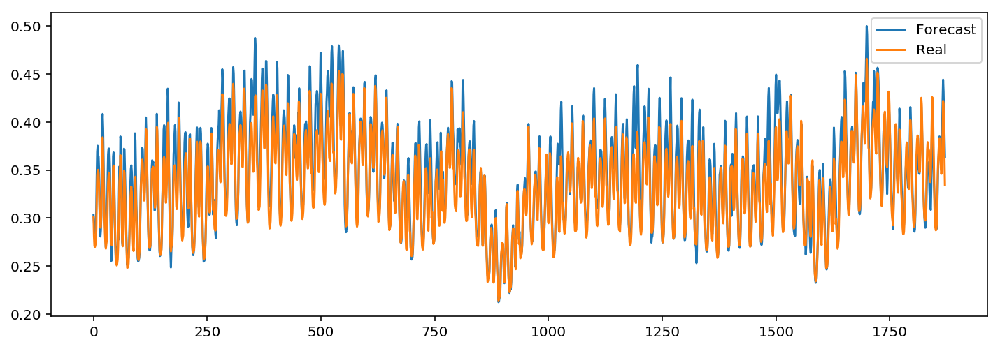

In [26]:
UsedInputsTemp= np.empty([9])
FinalErrorTemp= np.empty([2])
Parameters = np.empty([4])
ID= np.empty([1])
ID[0]=Model_ID


UsedInputsTemp[0] = previoushour = True
UsedInputsTemp[1] = timeSteps = 12
UsedInputsTemp[2] = previousDay = True
UsedInputsTemp[3] = previousWeek = True
UsedInputsTemp[4] = Temp = True
UsedInputsTemp[5] = TempMax = True
UsedInputsTemp[6] = TempMin = False
UsedInputsTemp[7] = dayIndicator = True
UsedInputsTemp[8] = HourIndicator = True

shift = False

learninginputs, learningoutputs, testinputs, testoutputs, nbrInputs = prepareInputs(daydata,season,UsedInputsTemp,testPeriod)
#learning vectors
inputx1 = np.array(pd.DataFrame(learninginputs.copy())).reshape(-1,nbrInputs)
outputx1 = np.array(pd.DataFrame(learningoutputs.copy()))

#test vectors
inputx2 = np.array(pd.DataFrame(testinputs.copy())).reshape(-1,nbrInputs)
outputx2 = np.array(pd.DataFrame(testoutputs.copy()))

Parameters[0]= HiddenNeurons1 = 90
Parameters[1]= HiddenNeurons2 = 30
Parameters[2]= LearningRate = 0.002

tempMLPmodels, tempErrorHistory,MLP_Model = create_Train_MLP_NN_Model(inputx1,outputx1,inputx2,outputx2,inputx1.shape[1],HiddenNeurons1=HiddenNeurons1,HiddenNeurons2=HiddenNeurons2
                                      ,Epoch=Epoch,LearningRate = LearningRate,Optimizer='Nadam')

Parameters[3]= tempErrorHistory.argmin()

MLP_Model.save('Models/lstm_%d_%s_%s'%(Model_ID,season,today))
# MLP_Model = load_model('Models/lstm_%d_%s_%s'%(Model_ID,season,today))

clear_output()
print('==================================================================================')
print('\t \t test num : %s' %Model_ID )
print('==================================================================================')


LearningMAPE, testMAPE , LearningHourlyMAPE, LearningDailyForecast, LearningHourlyForecast  = getForecastingResults(
    tempMLPmodels, tempErrorHistory,learninginputs,learningoutputs,testinputs,testoutputs,MLP_Model,nbrInputs,shift,previoushour,season,timeSteps)
FinalErrorTemp[0] = LearningMAPE
FinalErrorTemp[1] = testMAPE

UsedInputList.append(UsedInputsTemp)
MAPErrorList.append(FinalErrorTemp)
ModelsList.append(MLP_Model)
ForecastingList.append(LearningDailyForecast)
Models_IDs.append(ID)
Models_parameters.append(Parameters)

print('==================================================================================')
print('\t \t Forecasting a sample from Learning dataset')
print('==================================================================================')
plt.figure(figsize=(12,4))
ForecastingList[Model_ID].index= range(ForecastingList[Model_ID].index.size)
plt.plot(ForecastingList[Model_ID].iloc[:,0],label='Forecast')
plt.plot(ForecastingList[Model_ID].iloc[:,1],label='Real')
plt.legend( loc=1, borderaxespad=0.4)
plt.show()

Model_ID = Model_ID + 1

	 	 test num : 15
	 	 learning subset results
Hourly Learning mean absolute percentage error of 1872 hours : 1.40954071631 
Daily Learning mean absolute percentage error of 78 days : 3.93363931087 
	 	 MAPError plot through Learning DataSet 


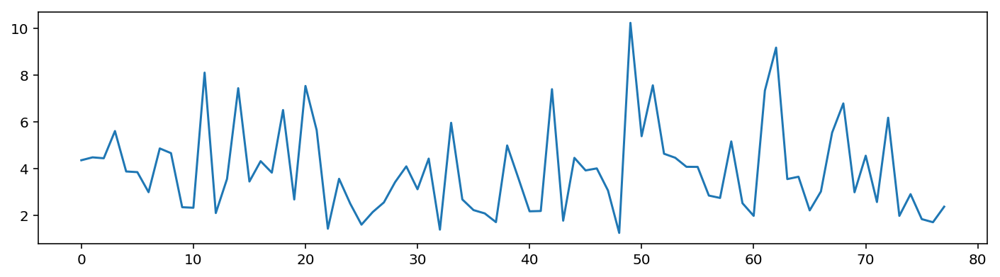

	 	 Test subset results
Test mean absolute percentage error per hour: 1.616842
Test mean absolute percentage error per day: 4.498525 
	 	 Validation Forecasting visualisation


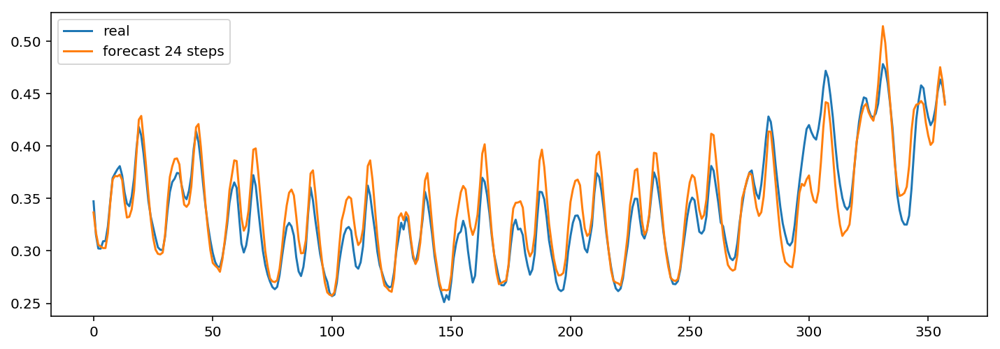

	 	 Forecasting a sample from Learning dataset


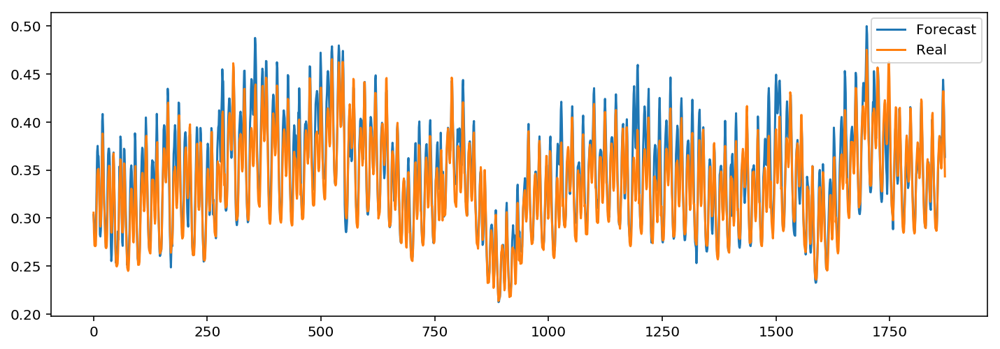

In [27]:
UsedInputsTemp= np.empty([9])
FinalErrorTemp= np.empty([2])
Parameters = np.empty([4])
ID= np.empty([1])
ID[0]=Model_ID


UsedInputsTemp[0] = previoushour = True
UsedInputsTemp[1] = timeSteps = 12
UsedInputsTemp[2] = previousDay = True
UsedInputsTemp[3] = previousWeek = True
UsedInputsTemp[4] = Temp = True
UsedInputsTemp[5] = TempMax = False
UsedInputsTemp[6] = TempMin = False
UsedInputsTemp[7] = dayIndicator = True
UsedInputsTemp[8] = HourIndicator = True

shift = False

learninginputs, learningoutputs, testinputs, testoutputs, nbrInputs = prepareInputs(daydata,season,UsedInputsTemp,testPeriod)
#learning vectors
inputx1 = np.array(pd.DataFrame(learninginputs.copy())).reshape(-1,nbrInputs)
outputx1 = np.array(pd.DataFrame(learningoutputs.copy()))

#test vectors
inputx2 = np.array(pd.DataFrame(testinputs.copy())).reshape(-1,nbrInputs)
outputx2 = np.array(pd.DataFrame(testoutputs.copy()))

Parameters[0]= HiddenNeurons1 = 90
Parameters[1]= HiddenNeurons2 = 30
Parameters[2]= LearningRate = 0.002

tempMLPmodels, tempErrorHistory,MLP_Model = create_Train_MLP_NN_Model(inputx1,outputx1,inputx2,outputx2,inputx1.shape[1],HiddenNeurons1=HiddenNeurons1,HiddenNeurons2=HiddenNeurons2
                                      ,Epoch=Epoch,LearningRate = LearningRate,Optimizer='Nadam')

Parameters[3]= tempErrorHistory.argmin()

MLP_Model.save('Models/lstm_%d_%s_%s'%(Model_ID,season,today))
# MLP_Model = load_model('Models/lstm_%d_%s_%s'%(Model_ID,season,today))


clear_output()
print('==================================================================================')
print('\t \t test num : %s' %Model_ID )
print('==================================================================================')


LearningMAPE, testMAPE , LearningHourlyMAPE, LearningDailyForecast, LearningHourlyForecast  = getForecastingResults(
    tempMLPmodels, tempErrorHistory,learninginputs,learningoutputs,testinputs,testoutputs,MLP_Model,nbrInputs,shift,previoushour,season,timeSteps)
FinalErrorTemp[0] = LearningMAPE
FinalErrorTemp[1] = testMAPE

UsedInputList.append(UsedInputsTemp)
MAPErrorList.append(FinalErrorTemp)
ModelsList.append(MLP_Model)
ForecastingList.append(LearningDailyForecast)
Models_IDs.append(ID)
Models_parameters.append(Parameters)

print('==================================================================================')
print('\t \t Forecasting a sample from Learning dataset')
print('==================================================================================')
plt.figure(figsize=(12,4))
ForecastingList[Model_ID].index= range(ForecastingList[Model_ID].index.size)
plt.plot(ForecastingList[Model_ID].iloc[:,0],label='Forecast')
plt.plot(ForecastingList[Model_ID].iloc[:,1],label='Real')
plt.legend( loc=1, borderaxespad=0.4)
plt.show()

Model_ID = Model_ID + 1

	 	 test num : 16
	 	 learning subset results
Hourly Learning mean absolute percentage error of 1872 hours : 1.40936006374 
Daily Learning mean absolute percentage error of 78 days : 3.90993575255 
	 	 MAPError plot through Learning DataSet 


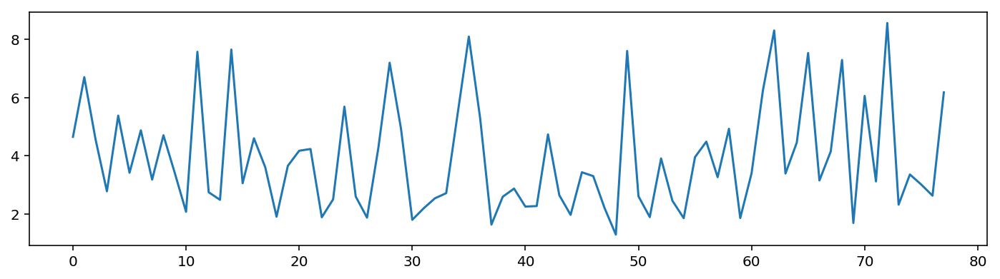

	 	 Test subset results
Test mean absolute percentage error per hour: 1.634308
Test mean absolute percentage error per day: 7.542754 
	 	 Validation Forecasting visualisation


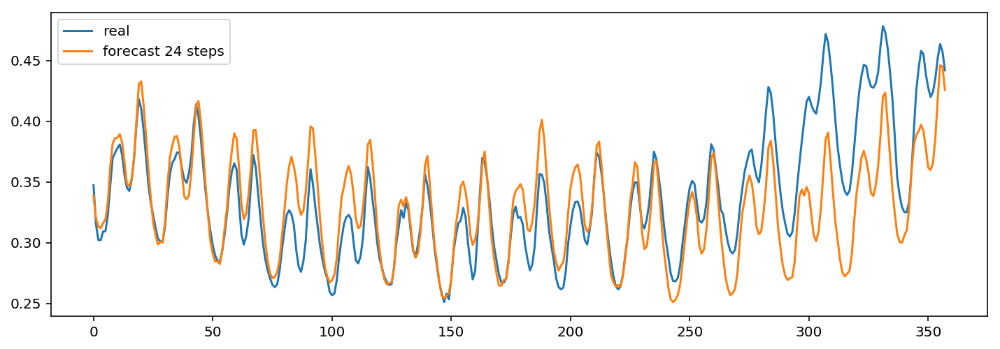

	 	 Forecasting a sample from Learning dataset


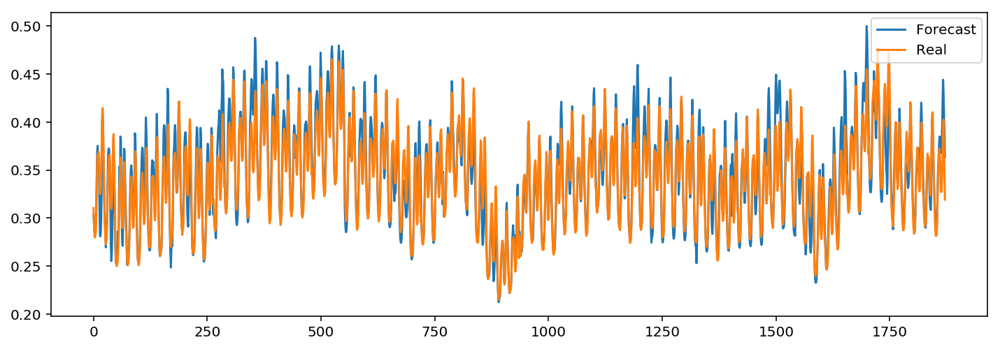

In [28]:
UsedInputsTemp= np.empty([9])
FinalErrorTemp= np.empty([2])
Parameters = np.empty([4])
ID= np.empty([1])
ID[0]=Model_ID


UsedInputsTemp[0] = previoushour = True
UsedInputsTemp[1] = timeSteps = 12
UsedInputsTemp[2] = previousDay = True
UsedInputsTemp[3] = previousWeek = True
UsedInputsTemp[4] = Temp = False
UsedInputsTemp[5] = TempMax = False
UsedInputsTemp[6] = TempMin = False
UsedInputsTemp[7] = dayIndicator = True
UsedInputsTemp[8] = HourIndicator = True

shift = False

learninginputs, learningoutputs, testinputs, testoutputs, nbrInputs = prepareInputs(daydata,season,UsedInputsTemp,testPeriod)
#learning vectors
inputx1 = np.array(pd.DataFrame(learninginputs.copy())).reshape(-1,nbrInputs)
outputx1 = np.array(pd.DataFrame(learningoutputs.copy()))

#test vectors
inputx2 = np.array(pd.DataFrame(testinputs.copy())).reshape(-1,nbrInputs)
outputx2 = np.array(pd.DataFrame(testoutputs.copy()))

Parameters[0]= HiddenNeurons1 = 90
Parameters[1]= HiddenNeurons2 = 30
Parameters[2]= LearningRate = 0.002

tempMLPmodels, tempErrorHistory,MLP_Model = create_Train_MLP_NN_Model(inputx1,outputx1,inputx2,outputx2,inputx1.shape[1],HiddenNeurons1=HiddenNeurons1,HiddenNeurons2=HiddenNeurons2
                                      ,Epoch=Epoch,LearningRate = LearningRate,Optimizer='Nadam')

Parameters[3]= tempErrorHistory.argmin()

MLP_Model.save('Models/lstm_%d_%s_%s'%(Model_ID,season,today))
# MLP_Model = load_model('Models/lstm_%d_%s_%s'%(Model_ID,season,today))

clear_output()
print('==================================================================================')
print('\t \t test num : %s' %Model_ID )
print('==================================================================================')


LearningMAPE, testMAPE , LearningHourlyMAPE, LearningDailyForecast, LearningHourlyForecast  = getForecastingResults(
    tempMLPmodels, tempErrorHistory,learninginputs,learningoutputs,testinputs,testoutputs,MLP_Model,nbrInputs,shift,previoushour,season,timeSteps)
FinalErrorTemp[0] = LearningMAPE
FinalErrorTemp[1] = testMAPE

UsedInputList.append(UsedInputsTemp)
MAPErrorList.append(FinalErrorTemp)
ModelsList.append(MLP_Model)
ForecastingList.append(LearningDailyForecast)
Models_IDs.append(ID)
Models_parameters.append(Parameters)

print('==================================================================================')
print('\t \t Forecasting a sample from Learning dataset')
print('==================================================================================')
plt.figure(figsize=(12,4))
ForecastingList[Model_ID].index= range(ForecastingList[Model_ID].index.size)
plt.plot(ForecastingList[Model_ID].iloc[:,0],label='Forecast')
plt.plot(ForecastingList[Model_ID].iloc[:,1],label='Real')
plt.legend( loc=1, borderaxespad=0.4)
plt.show()

Model_ID = Model_ID + 1

	 	 test num : 17
	 	 learning subset results
Hourly Learning mean absolute percentage error of 1872 hours : 1.22141554174 
Daily Learning mean absolute percentage error of 78 days : 2.94418859864 
	 	 MAPError plot through Learning DataSet 


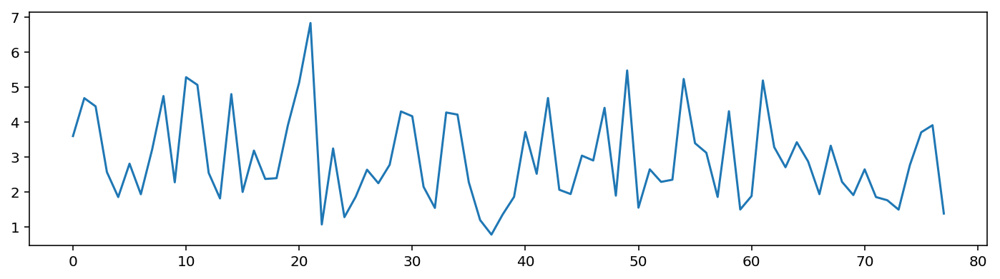

	 	 Test subset results
Test mean absolute percentage error per hour: 1.533284
Test mean absolute percentage error per day: 4.509755 
	 	 Validation Forecasting visualisation


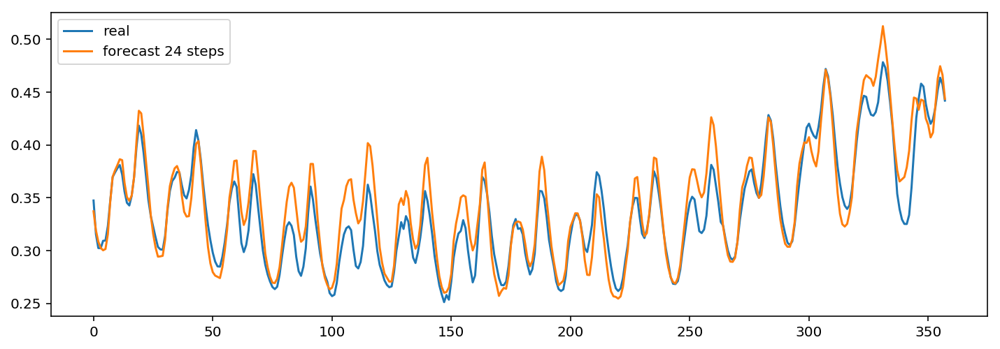

	 	 Forecasting a sample from Learning dataset


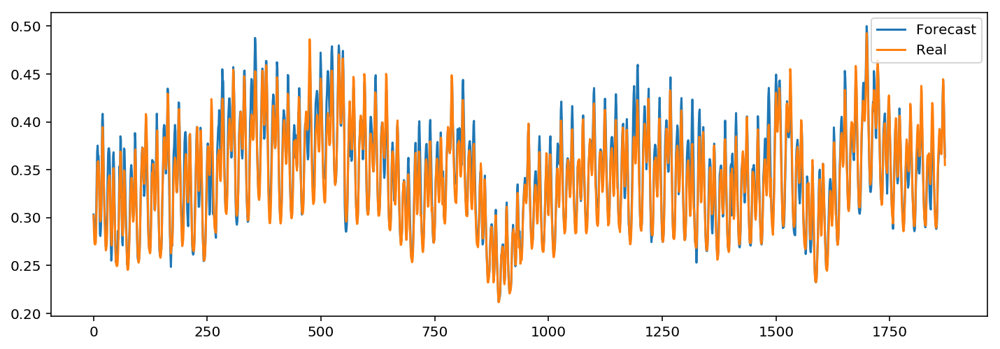

In [29]:
UsedInputsTemp= np.empty([9])
FinalErrorTemp= np.empty([2])
Parameters = np.empty([4])
ID= np.empty([1])
ID[0]=Model_ID


UsedInputsTemp[0] = previoushour = True
UsedInputsTemp[1] = timeSteps = 12
UsedInputsTemp[2] = previousDay = True
UsedInputsTemp[3] = previousWeek = False
UsedInputsTemp[4] = Temp = True
UsedInputsTemp[5] = TempMax = True
UsedInputsTemp[6] = TempMin = True
UsedInputsTemp[7] = dayIndicator = True
UsedInputsTemp[8] = HourIndicator = True

shift = False

learninginputs, learningoutputs, testinputs, testoutputs, nbrInputs = prepareInputs(daydata,season,UsedInputsTemp,testPeriod)
#learning vectors
inputx1 = np.array(pd.DataFrame(learninginputs.copy())).reshape(-1,nbrInputs)
outputx1 = np.array(pd.DataFrame(learningoutputs.copy()))

#test vectors
inputx2 = np.array(pd.DataFrame(testinputs.copy())).reshape(-1,nbrInputs)
outputx2 = np.array(pd.DataFrame(testoutputs.copy()))

Parameters[0]= HiddenNeurons1 = 90
Parameters[1]= HiddenNeurons2 = 30
Parameters[2]= LearningRate = 0.002

tempMLPmodels, tempErrorHistory,MLP_Model = create_Train_MLP_NN_Model(inputx1,outputx1,inputx2,outputx2,inputx1.shape[1],HiddenNeurons1=HiddenNeurons1,HiddenNeurons2=HiddenNeurons2
                                      ,Epoch=Epoch,LearningRate = LearningRate,Optimizer='Nadam')

Parameters[3]= tempErrorHistory.argmin()

MLP_Model.save('Models/lstm_%d_%s_%s'%(Model_ID,season,today))
# MLP_Model = load_model('Models/lstm_%d_%s_%s'%(Model_ID,season,today))

clear_output()
print('==================================================================================')
print('\t \t test num : %s' %Model_ID )
print('==================================================================================')


LearningMAPE, testMAPE , LearningHourlyMAPE, LearningDailyForecast, LearningHourlyForecast  = getForecastingResults(
    tempMLPmodels, tempErrorHistory,learninginputs,learningoutputs,testinputs,testoutputs,MLP_Model,nbrInputs,shift,previoushour,season,timeSteps)
FinalErrorTemp[0] = LearningMAPE
FinalErrorTemp[1] = testMAPE

UsedInputList.append(UsedInputsTemp)
MAPErrorList.append(FinalErrorTemp)
ModelsList.append(MLP_Model)
ForecastingList.append(LearningDailyForecast)
Models_IDs.append(ID)
Models_parameters.append(Parameters)

print('==================================================================================')
print('\t \t Forecasting a sample from Learning dataset')
print('==================================================================================')
plt.figure(figsize=(12,4))
ForecastingList[Model_ID].index= range(ForecastingList[Model_ID].index.size)
plt.plot(ForecastingList[Model_ID].iloc[:,0],label='Forecast')
plt.plot(ForecastingList[Model_ID].iloc[:,1],label='Real')
plt.legend( loc=1, borderaxespad=0.4)
plt.show()

Model_ID = Model_ID + 1

In [23]:
UsedInputs = np.array(UsedInputList)

FinalError= np.array(MAPErrorList)

summary = pd.DataFrame(np.concatenate((Models_IDs,Models_parameters,UsedInputs,FinalError),axis=1),columns=
                       ['Model ID','Neurons L1','Neurons L2','Learning rate','Epochs','Previous hour','Time steps','Previous day'
                        ,'Previous week','Temperature','Temp Max','Temp Min','Day indicator','Hour indicator','Training MAPE %',
                        'Test MAPE %'])

summary

,Model ID,Neurons L1,Neurons L2,Learning rate,Epochs,Previous hour,Time steps,Previous day,Previous week,Temperature,Temp Max,Temp Min,Day indicator,Hour indicator,Training MAPE %,Test MAPE %
0,0.0,20.0,10.0,0.001,1993.0,1.0,24.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,3.424512,5.723504
1,1.0,20.0,10.0,0.001,2139.0,1.0,12.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,3.757517,3.261083
2,2.0,20.0,10.0,0.001,2908.0,1.0,6.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,3.378894,3.875166
3,3.0,20.0,10.0,0.001,2823.0,1.0,3.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,5.406009,3.657073
4,4.0,20.0,10.0,0.001,1559.0,1.0,12.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,3.721944,3.594098
5,5.0,60.0,30.0,0.001,303.0,1.0,12.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,4.207533,3.870154
6,6.0,50.0,10.0,0.001,847.0,1.0,12.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,3.545194,3.848644
7,7.0,80.0,50.0,0.001,357.0,1.0,12.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,3.360741,4.977711
8,8.0,90.0,30.0,0.002,678.0,1.0,12.0,1.0,1.0,1.0,1.0,1.0,0.0,1.0,4.660033,4.573435
9,9.0,90.0,30.0,0.002,269.0,1.0,12.0,1.0,1.0,1.0,1.0,1.0,1.0,0.0,5.776559,4.181391


In [30]:
UsedInputs = np.array(UsedInputList)

FinalError= np.array(MAPErrorList)

summary = pd.DataFrame(np.concatenate((Models_IDs,Models_parameters,UsedInputs,FinalError),axis=1),columns=
                       ['Model ID','Neurons L1','Neurons L2','Learning rate','Epochs','Previous hour','Time steps','Previous day'
                        ,'Previous week','Temperature','Temp Max','Temp Min','Day indicator','Hour indicator','Training MAPE %',
                        'Test MAPE %'])

summary

,Model ID,Neurons L1,Neurons L2,Learning rate,Epochs,Previous hour,Time steps,Previous day,Previous week,Temperature,Temp Max,Temp Min,Day indicator,Hour indicator,Training MAPE %,Test MAPE %
0,0.0,20.0,10.0,0.001,2574.0,1.0,24.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,4.085393,3.576533
1,1.0,20.0,10.0,0.001,2419.0,1.0,12.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,3.520566,3.594924
2,2.0,20.0,10.0,0.001,2175.0,1.0,12.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,3.082597,4.263560
3,3.0,20.0,10.0,0.001,2691.0,1.0,6.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,4.486152,3.269316
4,4.0,20.0,10.0,0.001,1606.0,1.0,3.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,4.042950,3.386997
5,5.0,20.0,10.0,0.001,805.0,1.0,12.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,3.801552,3.532179
6,6.0,60.0,30.0,0.001,786.0,1.0,12.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,3.822085,3.980042
7,7.0,50.0,10.0,0.001,492.0,1.0,12.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,3.266894,4.578066
8,8.0,80.0,50.0,0.001,314.0,1.0,12.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,3.364827,3.901970
9,9.0,90.0,30.0,0.002,376.0,1.0,12.0,1.0,1.0,1.0,1.0,1.0,0.0,1.0,4.039233,4.239113


In [31]:
Epoch= 1000

	 	 test num : 18
	 	 learning subset results
Hourly Learning mean absolute percentage error of 1872 hours : 3.6444518138 
Daily Learning mean absolute percentage error of 78 days : 7.14624142647 
	 	 MAPError plot through Learning DataSet 


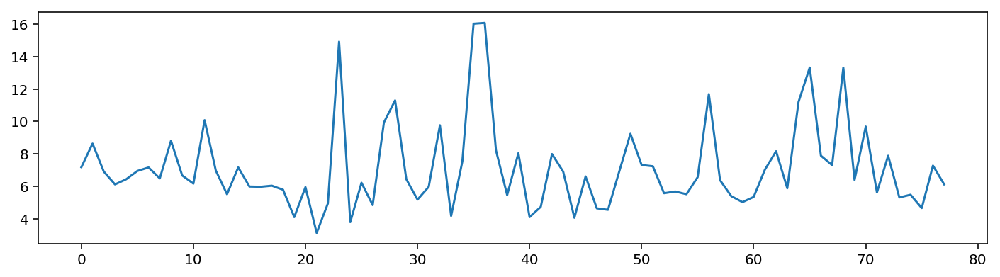

	 	 Test subset results
Test mean absolute percentage error per hour: 3.010151
Test mean absolute percentage error per day: 6.507890 
	 	 Validation Forecasting visualisation


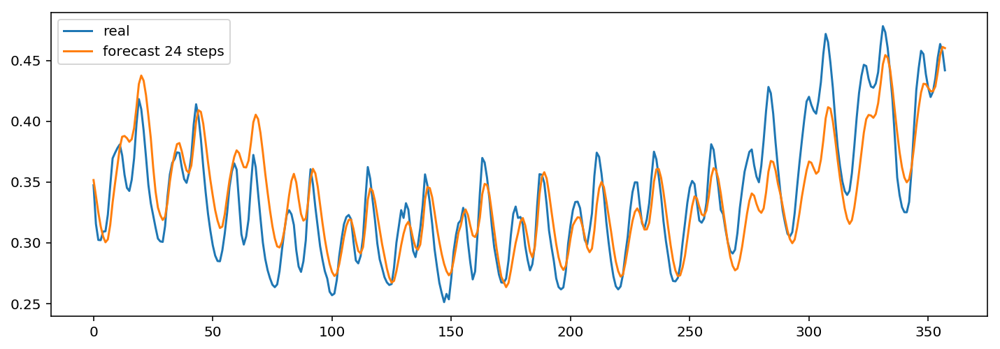

	 	 Forecasting a sample from Learning dataset


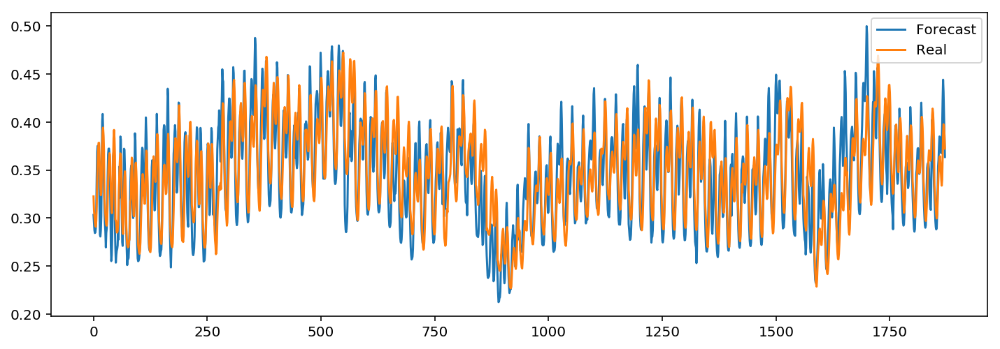

In [33]:
UsedInputsTemp= np.empty([9])
FinalErrorTemp= np.empty([2])
Parameters = np.empty([4])
ID= np.empty([1])
ID[0]=Model_ID


UsedInputsTemp[0] = previoushour = True
UsedInputsTemp[1] = timeSteps = 1
UsedInputsTemp[2] = previousDay = True
UsedInputsTemp[3] = previousWeek = True
UsedInputsTemp[4] = Temp = False
UsedInputsTemp[5] = TempMax = False
UsedInputsTemp[6] = TempMin = False
UsedInputsTemp[7] = dayIndicator = False
UsedInputsTemp[8] = HourIndicator = False

shift = False

learninginputs, learningoutputs, testinputs, testoutputs, nbrInputs = prepareInputs(daydata,season,UsedInputsTemp,testPeriod)
#learning vectors
inputx1 = np.array(pd.DataFrame(learninginputs.copy())).reshape(-1,nbrInputs)
outputx1 = np.array(pd.DataFrame(learningoutputs.copy()))

#test vectors
inputx2 = np.array(pd.DataFrame(testinputs.copy())).reshape(-1,nbrInputs)
outputx2 = np.array(pd.DataFrame(testoutputs.copy()))

Parameters[0]= HiddenNeurons1 = 90
Parameters[1]= HiddenNeurons2 = 30
Parameters[2]= LearningRate = 0.002

tempMLPmodels, tempErrorHistory,MLP_Model = create_Train_MLP_NN_Model(inputx1,outputx1,inputx2,outputx2,inputx1.shape[1],HiddenNeurons1=HiddenNeurons1,HiddenNeurons2=HiddenNeurons2
                                      ,Epoch=Epoch,LearningRate = LearningRate,Optimizer='Nadam')

Parameters[3]= tempErrorHistory.argmin()

MLP_Model.save('Models/lstm_%d_%s_%s'%(Model_ID,season,today))
# MLP_Model = load_model('Models/lstm_%d_%s_%s'%(Model_ID,season,today))

clear_output()
print('==================================================================================')
print('\t \t test num : %s' %Model_ID )
print('==================================================================================')


LearningMAPE, testMAPE , LearningHourlyMAPE, LearningDailyForecast, LearningHourlyForecast  = getForecastingResults(
    tempMLPmodels, tempErrorHistory,learninginputs,learningoutputs,testinputs,testoutputs,MLP_Model,nbrInputs,shift,previoushour,season,timeSteps)
FinalErrorTemp[0] = LearningMAPE
FinalErrorTemp[1] = testMAPE

UsedInputList.append(UsedInputsTemp)
MAPErrorList.append(FinalErrorTemp)
ModelsList.append(MLP_Model)
ForecastingList.append(LearningDailyForecast)
Models_IDs.append(ID)
Models_parameters.append(Parameters)

print('==================================================================================')
print('\t \t Forecasting a sample from Learning dataset')
print('==================================================================================')
plt.figure(figsize=(12,4))
ForecastingList[Model_ID].index= range(ForecastingList[Model_ID].index.size)
plt.plot(ForecastingList[Model_ID].iloc[:,0],label='Forecast')
plt.plot(ForecastingList[Model_ID].iloc[:,1],label='Real')
plt.legend( loc=1, borderaxespad=0.4)
plt.show()

Model_ID = Model_ID + 1

	 	 test num : 19
	 	 learning subset results
Hourly Learning mean absolute percentage error of 1872 hours : 2.3447499757 
Daily Learning mean absolute percentage error of 78 days : 7.64195629572 
	 	 MAPError plot through Learning DataSet 


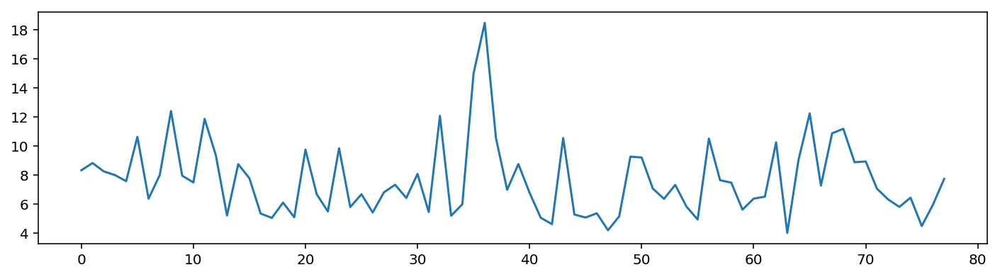

	 	 Test subset results
Test mean absolute percentage error per hour: 1.973366
Test mean absolute percentage error per day: 8.518130 
	 	 Validation Forecasting visualisation


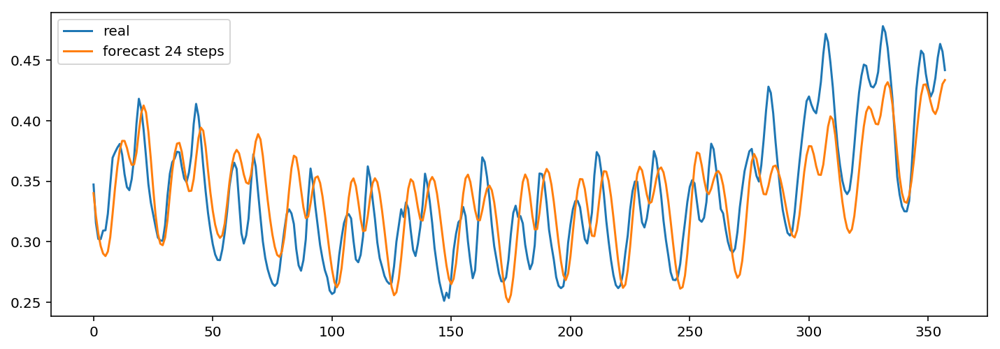

	 	 Forecasting a sample from Learning dataset


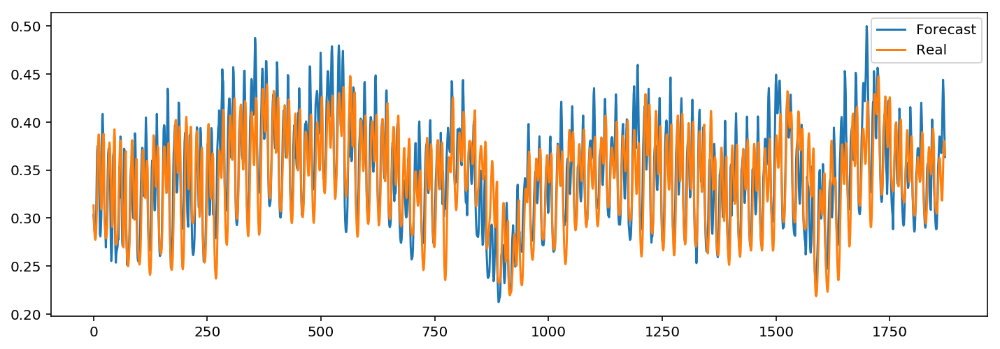

In [34]:
UsedInputsTemp= np.empty([9])
FinalErrorTemp= np.empty([2])
Parameters = np.empty([4])
ID= np.empty([1])
ID[0]=Model_ID


UsedInputsTemp[0] = previoushour = True
UsedInputsTemp[1] = timeSteps = 2
UsedInputsTemp[2] = previousDay = True
UsedInputsTemp[3] = previousWeek = True
UsedInputsTemp[4] = Temp = False
UsedInputsTemp[5] = TempMax = False
UsedInputsTemp[6] = TempMin = False
UsedInputsTemp[7] = dayIndicator = False
UsedInputsTemp[8] = HourIndicator = False

shift = False

learninginputs, learningoutputs, testinputs, testoutputs, nbrInputs = prepareInputs(daydata,season,UsedInputsTemp,testPeriod)
#learning vectors
inputx1 = np.array(pd.DataFrame(learninginputs.copy())).reshape(-1,nbrInputs)
outputx1 = np.array(pd.DataFrame(learningoutputs.copy()))

#test vectors
inputx2 = np.array(pd.DataFrame(testinputs.copy())).reshape(-1,nbrInputs)
outputx2 = np.array(pd.DataFrame(testoutputs.copy()))

Parameters[0]= HiddenNeurons1 = 90
Parameters[1]= HiddenNeurons2 = 30
Parameters[2]= LearningRate = 0.002

tempMLPmodels, tempErrorHistory,MLP_Model = create_Train_MLP_NN_Model(inputx1,outputx1,inputx2,outputx2,inputx1.shape[1],HiddenNeurons1=HiddenNeurons1,HiddenNeurons2=HiddenNeurons2
                                      ,Epoch=Epoch,LearningRate = LearningRate,Optimizer='Nadam')

Parameters[3]= tempErrorHistory.argmin()

MLP_Model.save('Models/lstm_%d_%s_%s'%(Model_ID,season,today))
# MLP_Model = load_model('Models/lstm_%d_%s_%s'%(Model_ID,season,today))

clear_output()
print('==================================================================================')
print('\t \t test num : %s' %Model_ID )
print('==================================================================================')


LearningMAPE, testMAPE , LearningHourlyMAPE, LearningDailyForecast, LearningHourlyForecast  = getForecastingResults(
    tempMLPmodels, tempErrorHistory,learninginputs,learningoutputs,testinputs,testoutputs,MLP_Model,nbrInputs,shift,previoushour,season,timeSteps)
FinalErrorTemp[0] = LearningMAPE
FinalErrorTemp[1] = testMAPE

UsedInputList.append(UsedInputsTemp)
MAPErrorList.append(FinalErrorTemp)
ModelsList.append(MLP_Model)
ForecastingList.append(LearningDailyForecast)
Models_IDs.append(ID)
Models_parameters.append(Parameters)

print('==================================================================================')
print('\t \t Forecasting a sample from Learning dataset')
print('==================================================================================')
plt.figure(figsize=(12,4))
ForecastingList[Model_ID].index= range(ForecastingList[Model_ID].index.size)
plt.plot(ForecastingList[Model_ID].iloc[:,0],label='Forecast')
plt.plot(ForecastingList[Model_ID].iloc[:,1],label='Real')
plt.legend( loc=1, borderaxespad=0.4)
plt.show()

Model_ID = Model_ID + 1

	 	 test num : 20
	 	 learning subset results
Hourly Learning mean absolute percentage error of 1872 hours : 2.1665419144 
Daily Learning mean absolute percentage error of 78 days : 7.31054752912 
	 	 MAPError plot through Learning DataSet 


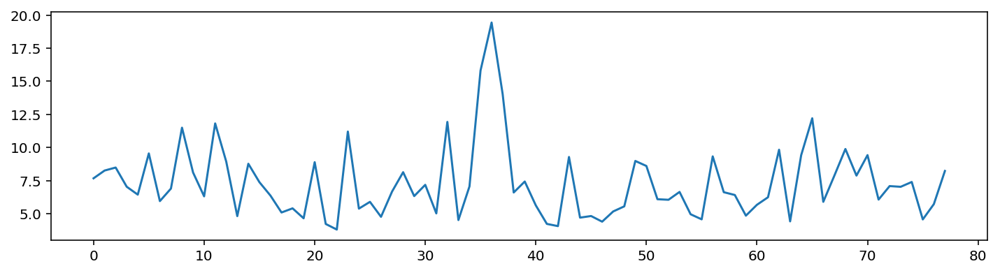

	 	 Test subset results
Test mean absolute percentage error per hour: 1.809664
Test mean absolute percentage error per day: 7.916848 
	 	 Validation Forecasting visualisation


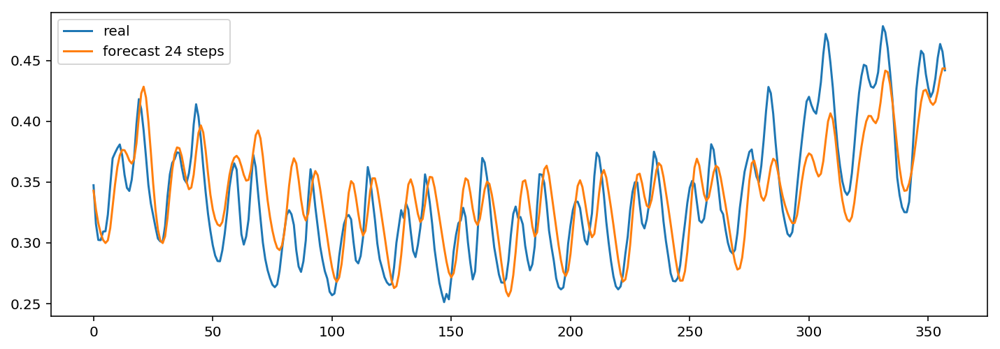

	 	 Forecasting a sample from Learning dataset


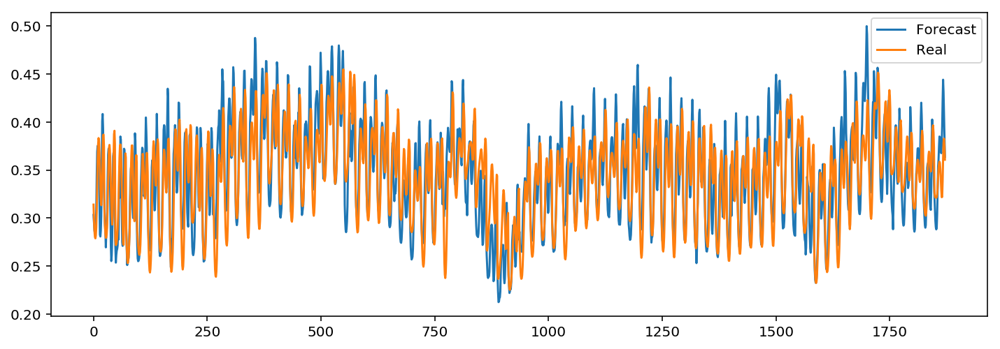

In [35]:
UsedInputsTemp= np.empty([9])
FinalErrorTemp= np.empty([2])
Parameters = np.empty([4])
ID= np.empty([1])
ID[0]=Model_ID


UsedInputsTemp[0] = previoushour = True
UsedInputsTemp[1] = timeSteps = 3
UsedInputsTemp[2] = previousDay = True
UsedInputsTemp[3] = previousWeek = True
UsedInputsTemp[4] = Temp = False
UsedInputsTemp[5] = TempMax = False
UsedInputsTemp[6] = TempMin = False
UsedInputsTemp[7] = dayIndicator = False
UsedInputsTemp[8] = HourIndicator = False

shift = False

learninginputs, learningoutputs, testinputs, testoutputs, nbrInputs = prepareInputs(daydata,season,UsedInputsTemp,testPeriod)
#learning vectors
inputx1 = np.array(pd.DataFrame(learninginputs.copy())).reshape(-1,nbrInputs)
outputx1 = np.array(pd.DataFrame(learningoutputs.copy()))

#test vectors
inputx2 = np.array(pd.DataFrame(testinputs.copy())).reshape(-1,nbrInputs)
outputx2 = np.array(pd.DataFrame(testoutputs.copy()))

Parameters[0]= HiddenNeurons1 = 90
Parameters[1]= HiddenNeurons2 = 30
Parameters[2]= LearningRate = 0.002

tempMLPmodels, tempErrorHistory,MLP_Model = create_Train_MLP_NN_Model(inputx1,outputx1,inputx2,outputx2,inputx1.shape[1],HiddenNeurons1=HiddenNeurons1,HiddenNeurons2=HiddenNeurons2
                                      ,Epoch=Epoch,LearningRate = LearningRate,Optimizer='Nadam')

Parameters[3]= tempErrorHistory.argmin()

MLP_Model.save('Models/lstm_%d_%s_%s'%(Model_ID,season,today))
# MLP_Model = load_model('Models/lstm_%d_%s_%s'%(Model_ID,season,today))

clear_output()
print('==================================================================================')
print('\t \t test num : %s' %Model_ID )
print('==================================================================================')


LearningMAPE, testMAPE , LearningHourlyMAPE, LearningDailyForecast, LearningHourlyForecast  = getForecastingResults(
    tempMLPmodels, tempErrorHistory,learninginputs,learningoutputs,testinputs,testoutputs,MLP_Model,nbrInputs,shift,previoushour,season,timeSteps)
FinalErrorTemp[0] = LearningMAPE
FinalErrorTemp[1] = testMAPE

UsedInputList.append(UsedInputsTemp)
MAPErrorList.append(FinalErrorTemp)
ModelsList.append(MLP_Model)
ForecastingList.append(LearningDailyForecast)
Models_IDs.append(ID)
Models_parameters.append(Parameters)

print('==================================================================================')
print('\t \t Forecasting a sample from Learning dataset')
print('==================================================================================')
plt.figure(figsize=(12,4))
ForecastingList[Model_ID].index= range(ForecastingList[Model_ID].index.size)
plt.plot(ForecastingList[Model_ID].iloc[:,0],label='Forecast')
plt.plot(ForecastingList[Model_ID].iloc[:,1],label='Real')
plt.legend( loc=1, borderaxespad=0.4)
plt.show()

Model_ID = Model_ID + 1

	 	 test num : 21
	 	 learning subset results
Hourly Learning mean absolute percentage error of 1872 hours : 2.14735966213 
Daily Learning mean absolute percentage error of 78 days : 7.2554030449 
	 	 MAPError plot through Learning DataSet 


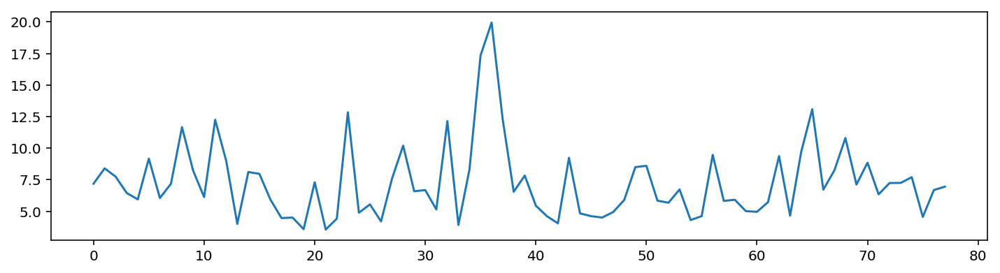

	 	 Test subset results
Test mean absolute percentage error per hour: 1.748914
Test mean absolute percentage error per day: 7.464012 
	 	 Validation Forecasting visualisation


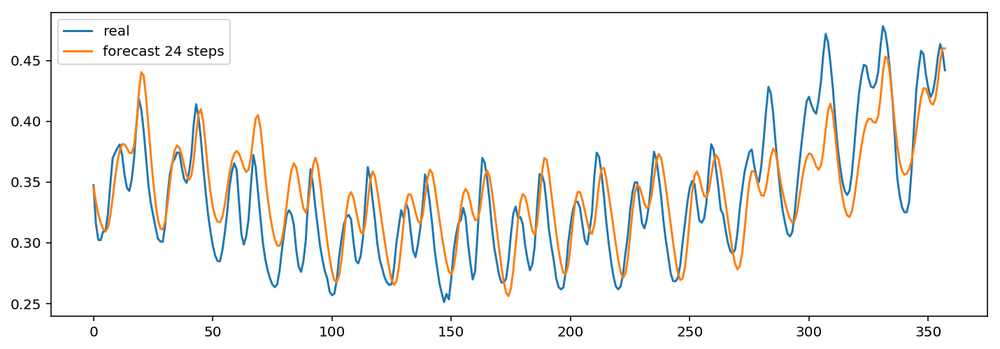

	 	 Forecasting a sample from Learning dataset


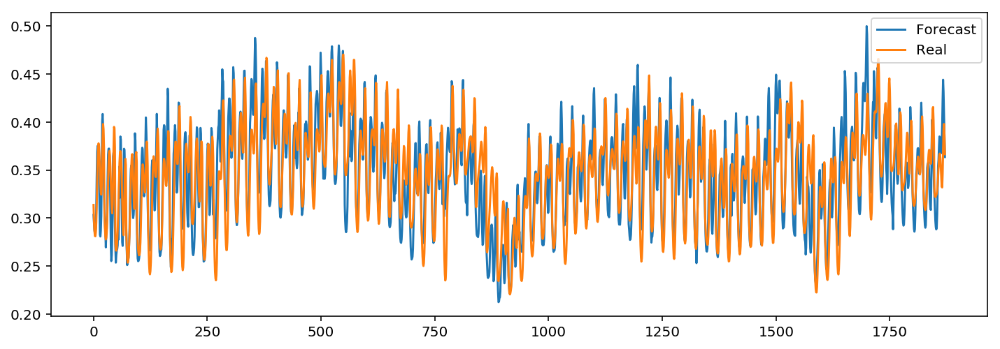

In [36]:
UsedInputsTemp= np.empty([9])
FinalErrorTemp= np.empty([2])
Parameters = np.empty([4])
ID= np.empty([1])
ID[0]=Model_ID


UsedInputsTemp[0] = previoushour = True
UsedInputsTemp[1] = timeSteps = 4
UsedInputsTemp[2] = previousDay = True
UsedInputsTemp[3] = previousWeek = True
UsedInputsTemp[4] = Temp = False
UsedInputsTemp[5] = TempMax = False
UsedInputsTemp[6] = TempMin = False
UsedInputsTemp[7] = dayIndicator = False
UsedInputsTemp[8] = HourIndicator = False

shift = False

learninginputs, learningoutputs, testinputs, testoutputs, nbrInputs = prepareInputs(daydata,season,UsedInputsTemp,testPeriod)
#learning vectors
inputx1 = np.array(pd.DataFrame(learninginputs.copy())).reshape(-1,nbrInputs)
outputx1 = np.array(pd.DataFrame(learningoutputs.copy()))

#test vectors
inputx2 = np.array(pd.DataFrame(testinputs.copy())).reshape(-1,nbrInputs)
outputx2 = np.array(pd.DataFrame(testoutputs.copy()))

Parameters[0]= HiddenNeurons1 = 90
Parameters[1]= HiddenNeurons2 = 30
Parameters[2]= LearningRate = 0.002

tempMLPmodels, tempErrorHistory,MLP_Model = create_Train_MLP_NN_Model(inputx1,outputx1,inputx2,outputx2,inputx1.shape[1],HiddenNeurons1=HiddenNeurons1,HiddenNeurons2=HiddenNeurons2
                                      ,Epoch=Epoch,LearningRate = LearningRate,Optimizer='Nadam')

Parameters[3]= tempErrorHistory.argmin()

MLP_Model.save('Models/lstm_%d_%s_%s'%(Model_ID,season,today))
# MLP_Model = load_model('Models/lstm_%d_%s_%s'%(Model_ID,season,today))

clear_output()
print('==================================================================================')
print('\t \t test num : %s' %Model_ID )
print('==================================================================================')


LearningMAPE, testMAPE , LearningHourlyMAPE, LearningDailyForecast, LearningHourlyForecast  = getForecastingResults(
    tempMLPmodels, tempErrorHistory,learninginputs,learningoutputs,testinputs,testoutputs,MLP_Model,nbrInputs,shift,previoushour,season,timeSteps)
FinalErrorTemp[0] = LearningMAPE
FinalErrorTemp[1] = testMAPE

UsedInputList.append(UsedInputsTemp)
MAPErrorList.append(FinalErrorTemp)
ModelsList.append(MLP_Model)
ForecastingList.append(LearningDailyForecast)
Models_IDs.append(ID)
Models_parameters.append(Parameters)

print('==================================================================================')
print('\t \t Forecasting a sample from Learning dataset')
print('==================================================================================')
plt.figure(figsize=(12,4))
ForecastingList[Model_ID].index= range(ForecastingList[Model_ID].index.size)
plt.plot(ForecastingList[Model_ID].iloc[:,0],label='Forecast')
plt.plot(ForecastingList[Model_ID].iloc[:,1],label='Real')
plt.legend( loc=1, borderaxespad=0.4)
plt.show()

Model_ID = Model_ID + 1

	 	 test num : 22
	 	 learning subset results
Hourly Learning mean absolute percentage error of 1872 hours : 2.07526643551 
Daily Learning mean absolute percentage error of 78 days : 7.03680670567 
	 	 MAPError plot through Learning DataSet 


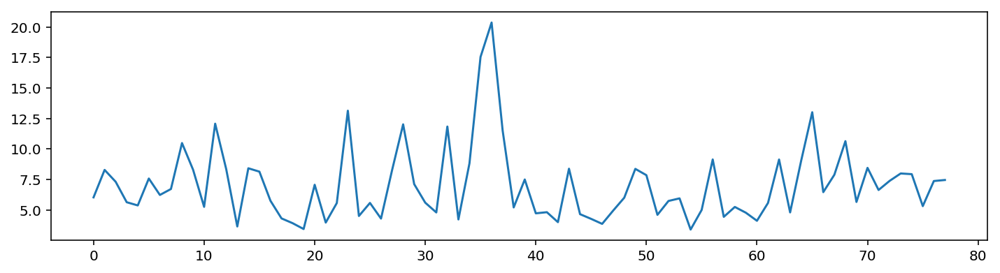

	 	 Test subset results
Test mean absolute percentage error per hour: 1.719283
Test mean absolute percentage error per day: 7.098789 
	 	 Validation Forecasting visualisation


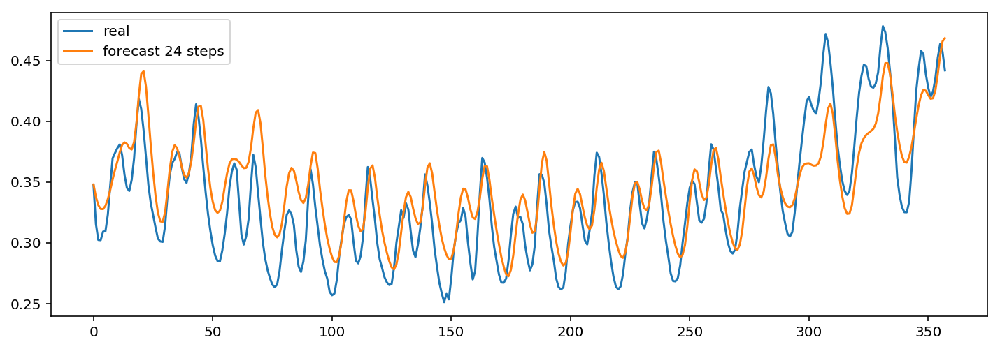

	 	 Forecasting a sample from Learning dataset


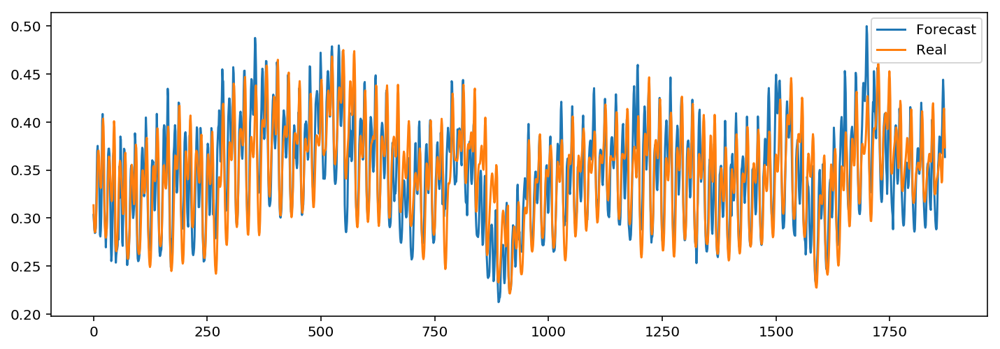

In [37]:
UsedInputsTemp= np.empty([9])
FinalErrorTemp= np.empty([2])
Parameters = np.empty([4])
ID= np.empty([1])
ID[0]=Model_ID


UsedInputsTemp[0] = previoushour = True
UsedInputsTemp[1] = timeSteps = 5
UsedInputsTemp[2] = previousDay = True
UsedInputsTemp[3] = previousWeek = True
UsedInputsTemp[4] = Temp = False
UsedInputsTemp[5] = TempMax = False
UsedInputsTemp[6] = TempMin = False
UsedInputsTemp[7] = dayIndicator = False
UsedInputsTemp[8] = HourIndicator = False

shift = False

learninginputs, learningoutputs, testinputs, testoutputs, nbrInputs = prepareInputs(daydata,season,UsedInputsTemp,testPeriod)
#learning vectors
inputx1 = np.array(pd.DataFrame(learninginputs.copy())).reshape(-1,nbrInputs)
outputx1 = np.array(pd.DataFrame(learningoutputs.copy()))

#test vectors
inputx2 = np.array(pd.DataFrame(testinputs.copy())).reshape(-1,nbrInputs)
outputx2 = np.array(pd.DataFrame(testoutputs.copy()))

Parameters[0]= HiddenNeurons1 = 90
Parameters[1]= HiddenNeurons2 = 30
Parameters[2]= LearningRate = 0.002

tempMLPmodels, tempErrorHistory,MLP_Model = create_Train_MLP_NN_Model(inputx1,outputx1,inputx2,outputx2,inputx1.shape[1],HiddenNeurons1=HiddenNeurons1,HiddenNeurons2=HiddenNeurons2
                                      ,Epoch=Epoch,LearningRate = LearningRate,Optimizer='Nadam')

Parameters[3]= tempErrorHistory.argmin()

MLP_Model.save('Models/lstm_%d_%s_%s'%(Model_ID,season,today))
# MLP_Model = load_model('Models/lstm_%d_%s_%s'%(Model_ID,season,today))

clear_output()
print('==================================================================================')
print('\t \t test num : %s' %Model_ID )
print('==================================================================================')


LearningMAPE, testMAPE , LearningHourlyMAPE, LearningDailyForecast, LearningHourlyForecast  = getForecastingResults(
    tempMLPmodels, tempErrorHistory,learninginputs,learningoutputs,testinputs,testoutputs,MLP_Model,nbrInputs,shift,previoushour,season,timeSteps)
FinalErrorTemp[0] = LearningMAPE
FinalErrorTemp[1] = testMAPE

UsedInputList.append(UsedInputsTemp)
MAPErrorList.append(FinalErrorTemp)
ModelsList.append(MLP_Model)
ForecastingList.append(LearningDailyForecast)
Models_IDs.append(ID)
Models_parameters.append(Parameters)

print('==================================================================================')
print('\t \t Forecasting a sample from Learning dataset')
print('==================================================================================')
plt.figure(figsize=(12,4))
ForecastingList[Model_ID].index= range(ForecastingList[Model_ID].index.size)
plt.plot(ForecastingList[Model_ID].iloc[:,0],label='Forecast')
plt.plot(ForecastingList[Model_ID].iloc[:,1],label='Real')
plt.legend( loc=1, borderaxespad=0.4)
plt.show()

Model_ID = Model_ID + 1

	 	 test num : 23
	 	 learning subset results
Hourly Learning mean absolute percentage error of 1872 hours : 2.00574589878 
Daily Learning mean absolute percentage error of 78 days : 6.95524364251 
	 	 MAPError plot through Learning DataSet 


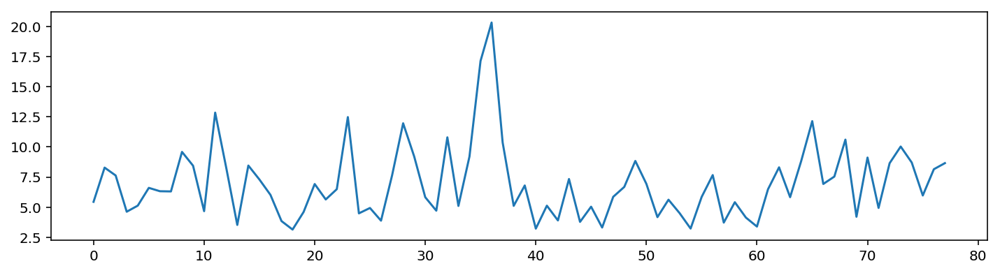

	 	 Test subset results
Test mean absolute percentage error per hour: 1.603984
Test mean absolute percentage error per day: 8.303675 
	 	 Validation Forecasting visualisation


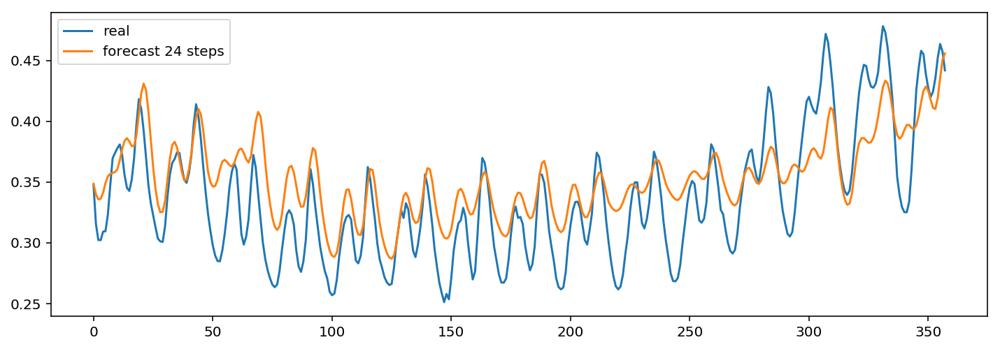

	 	 Forecasting a sample from Learning dataset


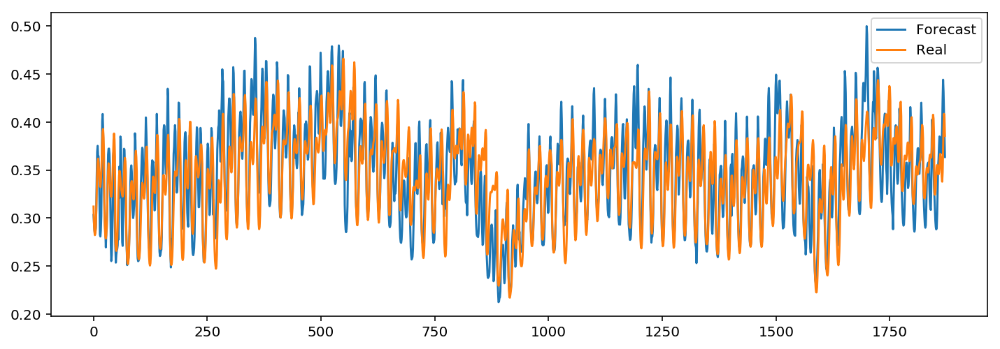

In [38]:
UsedInputsTemp= np.empty([9])
FinalErrorTemp= np.empty([2])
Parameters = np.empty([4])
ID= np.empty([1])
ID[0]=Model_ID


UsedInputsTemp[0] = previoushour = True
UsedInputsTemp[1] = timeSteps = 6
UsedInputsTemp[2] = previousDay = True
UsedInputsTemp[3] = previousWeek = True
UsedInputsTemp[4] = Temp = False
UsedInputsTemp[5] = TempMax = False
UsedInputsTemp[6] = TempMin = False
UsedInputsTemp[7] = dayIndicator = False
UsedInputsTemp[8] = HourIndicator = False

shift = False

learninginputs, learningoutputs, testinputs, testoutputs, nbrInputs = prepareInputs(daydata,season,UsedInputsTemp,testPeriod)
#learning vectors
inputx1 = np.array(pd.DataFrame(learninginputs.copy())).reshape(-1,nbrInputs)
outputx1 = np.array(pd.DataFrame(learningoutputs.copy()))

#test vectors
inputx2 = np.array(pd.DataFrame(testinputs.copy())).reshape(-1,nbrInputs)
outputx2 = np.array(pd.DataFrame(testoutputs.copy()))

Parameters[0]= HiddenNeurons1 = 90
Parameters[1]= HiddenNeurons2 = 30
Parameters[2]= LearningRate = 0.002

tempMLPmodels, tempErrorHistory,MLP_Model = create_Train_MLP_NN_Model(inputx1,outputx1,inputx2,outputx2,inputx1.shape[1],HiddenNeurons1=HiddenNeurons1,HiddenNeurons2=HiddenNeurons2
                                      ,Epoch=Epoch,LearningRate = LearningRate,Optimizer='Nadam')

Parameters[3]= tempErrorHistory.argmin()

MLP_Model.save('Models/lstm_%d_%s_%s'%(Model_ID,season,today))
# MLP_Model = load_model('Models/lstm_%d_%s_%s'%(Model_ID,season,today))

clear_output()
print('==================================================================================')
print('\t \t test num : %s' %Model_ID )
print('==================================================================================')


LearningMAPE, testMAPE , LearningHourlyMAPE, LearningDailyForecast, LearningHourlyForecast  = getForecastingResults(
    tempMLPmodels, tempErrorHistory,learninginputs,learningoutputs,testinputs,testoutputs,MLP_Model,nbrInputs,shift,previoushour,season,timeSteps)
FinalErrorTemp[0] = LearningMAPE
FinalErrorTemp[1] = testMAPE

UsedInputList.append(UsedInputsTemp)
MAPErrorList.append(FinalErrorTemp)
ModelsList.append(MLP_Model)
ForecastingList.append(LearningDailyForecast)
Models_IDs.append(ID)
Models_parameters.append(Parameters)

print('==================================================================================')
print('\t \t Forecasting a sample from Learning dataset')
print('==================================================================================')
plt.figure(figsize=(12,4))
ForecastingList[Model_ID].index= range(ForecastingList[Model_ID].index.size)
plt.plot(ForecastingList[Model_ID].iloc[:,0],label='Forecast')
plt.plot(ForecastingList[Model_ID].iloc[:,1],label='Real')
plt.legend( loc=1, borderaxespad=0.4)
plt.show()

Model_ID = Model_ID + 1

	 	 test num : 24
	 	 learning subset results
Hourly Learning mean absolute percentage error of 1872 hours : 1.92047220821 
Daily Learning mean absolute percentage error of 78 days : 7.10271629615 
	 	 MAPError plot through Learning DataSet 


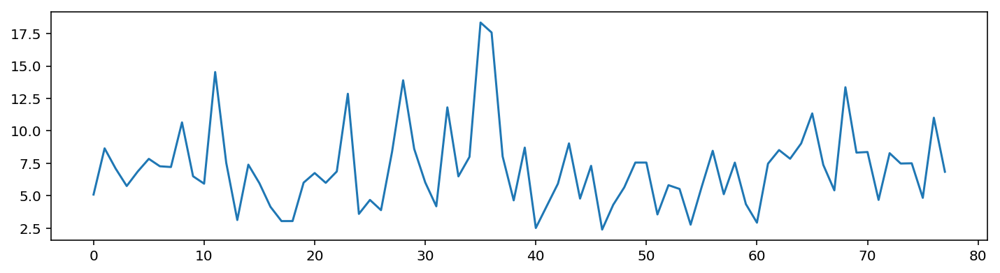

	 	 Test subset results
Test mean absolute percentage error per hour: 1.492392
Test mean absolute percentage error per day: 9.957874 
	 	 Validation Forecasting visualisation


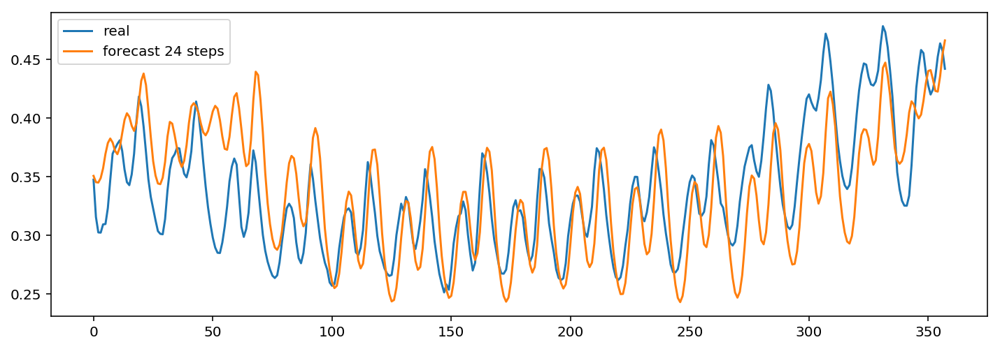

	 	 Forecasting a sample from Learning dataset


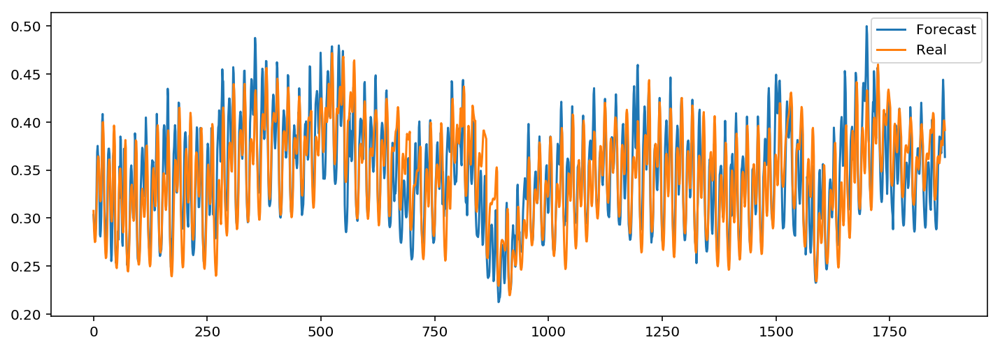

In [39]:
UsedInputsTemp= np.empty([9])
FinalErrorTemp= np.empty([2])
Parameters = np.empty([4])
ID= np.empty([1])
ID[0]=Model_ID


UsedInputsTemp[0] = previoushour = True
UsedInputsTemp[1] = timeSteps = 7
UsedInputsTemp[2] = previousDay = True
UsedInputsTemp[3] = previousWeek = True
UsedInputsTemp[4] = Temp = False
UsedInputsTemp[5] = TempMax = False
UsedInputsTemp[6] = TempMin = False
UsedInputsTemp[7] = dayIndicator = False
UsedInputsTemp[8] = HourIndicator = False

shift = False

learninginputs, learningoutputs, testinputs, testoutputs, nbrInputs = prepareInputs(daydata,season,UsedInputsTemp,testPeriod)
#learning vectors
inputx1 = np.array(pd.DataFrame(learninginputs.copy())).reshape(-1,nbrInputs)
outputx1 = np.array(pd.DataFrame(learningoutputs.copy()))

#test vectors
inputx2 = np.array(pd.DataFrame(testinputs.copy())).reshape(-1,nbrInputs)
outputx2 = np.array(pd.DataFrame(testoutputs.copy()))

Parameters[0]= HiddenNeurons1 = 90
Parameters[1]= HiddenNeurons2 = 30
Parameters[2]= LearningRate = 0.002

tempMLPmodels, tempErrorHistory,MLP_Model = create_Train_MLP_NN_Model(inputx1,outputx1,inputx2,outputx2,inputx1.shape[1],HiddenNeurons1=HiddenNeurons1,HiddenNeurons2=HiddenNeurons2
                                      ,Epoch=Epoch,LearningRate = LearningRate,Optimizer='Nadam')

Parameters[3]= tempErrorHistory.argmin()

MLP_Model.save('Models/lstm_%d_%s_%s'%(Model_ID,season,today))
# MLP_Model = load_model('Models/lstm_%d_%s_%s'%(Model_ID,season,today))

clear_output()
print('==================================================================================')
print('\t \t test num : %s' %Model_ID )
print('==================================================================================')


LearningMAPE, testMAPE , LearningHourlyMAPE, LearningDailyForecast, LearningHourlyForecast  = getForecastingResults(
    tempMLPmodels, tempErrorHistory,learninginputs,learningoutputs,testinputs,testoutputs,MLP_Model,nbrInputs,shift,previoushour,season,timeSteps)
FinalErrorTemp[0] = LearningMAPE
FinalErrorTemp[1] = testMAPE

UsedInputList.append(UsedInputsTemp)
MAPErrorList.append(FinalErrorTemp)
ModelsList.append(MLP_Model)
ForecastingList.append(LearningDailyForecast)
Models_IDs.append(ID)
Models_parameters.append(Parameters)

print('==================================================================================')
print('\t \t Forecasting a sample from Learning dataset')
print('==================================================================================')
plt.figure(figsize=(12,4))
ForecastingList[Model_ID].index= range(ForecastingList[Model_ID].index.size)
plt.plot(ForecastingList[Model_ID].iloc[:,0],label='Forecast')
plt.plot(ForecastingList[Model_ID].iloc[:,1],label='Real')
plt.legend( loc=1, borderaxespad=0.4)
plt.show()

Model_ID = Model_ID + 1

	 	 test num : 25
	 	 learning subset results
Hourly Learning mean absolute percentage error of 1872 hours : 1.95176034958 
Daily Learning mean absolute percentage error of 78 days : 7.71248384928 
	 	 MAPError plot through Learning DataSet 


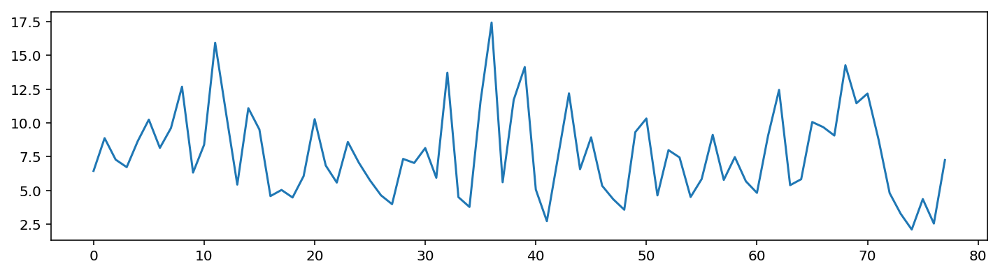

	 	 Test subset results
Test mean absolute percentage error per hour: 1.499847
Test mean absolute percentage error per day: 9.881772 
	 	 Validation Forecasting visualisation


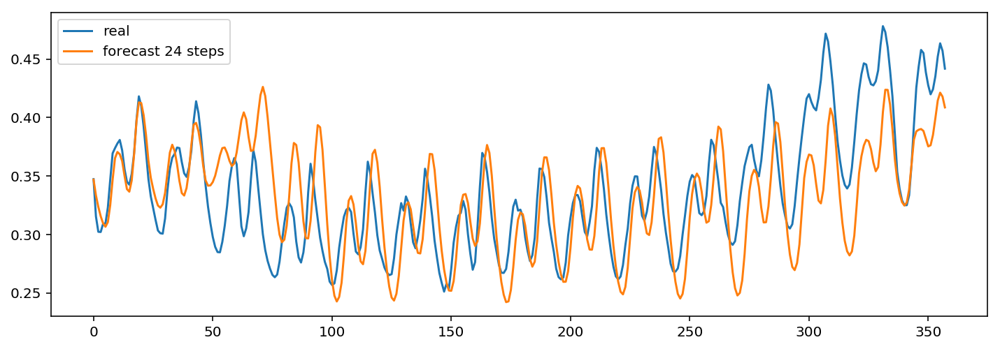

	 	 Forecasting a sample from Learning dataset


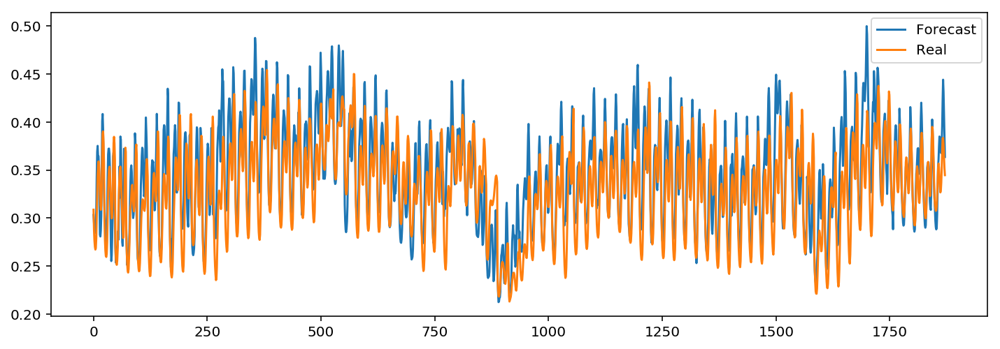

In [40]:
UsedInputsTemp= np.empty([9])
FinalErrorTemp= np.empty([2])
Parameters = np.empty([4])
ID= np.empty([1])
ID[0]=Model_ID


UsedInputsTemp[0] = previoushour = True
UsedInputsTemp[1] = timeSteps = 8
UsedInputsTemp[2] = previousDay = True
UsedInputsTemp[3] = previousWeek = True
UsedInputsTemp[4] = Temp = False
UsedInputsTemp[5] = TempMax = False
UsedInputsTemp[6] = TempMin = False
UsedInputsTemp[7] = dayIndicator = False
UsedInputsTemp[8] = HourIndicator = False

shift = False

learninginputs, learningoutputs, testinputs, testoutputs, nbrInputs = prepareInputs(daydata,season,UsedInputsTemp,testPeriod)
#learning vectors
inputx1 = np.array(pd.DataFrame(learninginputs.copy())).reshape(-1,nbrInputs)
outputx1 = np.array(pd.DataFrame(learningoutputs.copy()))

#test vectors
inputx2 = np.array(pd.DataFrame(testinputs.copy())).reshape(-1,nbrInputs)
outputx2 = np.array(pd.DataFrame(testoutputs.copy()))

Parameters[0]= HiddenNeurons1 = 90
Parameters[1]= HiddenNeurons2 = 30
Parameters[2]= LearningRate = 0.002

tempMLPmodels, tempErrorHistory,MLP_Model = create_Train_MLP_NN_Model(inputx1,outputx1,inputx2,outputx2,inputx1.shape[1],HiddenNeurons1=HiddenNeurons1,HiddenNeurons2=HiddenNeurons2
                                      ,Epoch=Epoch,LearningRate = LearningRate,Optimizer='Nadam')

Parameters[3]= tempErrorHistory.argmin()

MLP_Model.save('Models/lstm_%d_%s_%s'%(Model_ID,season,today))
# MLP_Model = load_model('Models/lstm_%d_%s_%s'%(Model_ID,season,today))

clear_output()
print('==================================================================================')
print('\t \t test num : %s' %Model_ID )
print('==================================================================================')


LearningMAPE, testMAPE , LearningHourlyMAPE, LearningDailyForecast, LearningHourlyForecast  = getForecastingResults(
    tempMLPmodels, tempErrorHistory,learninginputs,learningoutputs,testinputs,testoutputs,MLP_Model,nbrInputs,shift,previoushour,season,timeSteps)
FinalErrorTemp[0] = LearningMAPE
FinalErrorTemp[1] = testMAPE

UsedInputList.append(UsedInputsTemp)
MAPErrorList.append(FinalErrorTemp)
ModelsList.append(MLP_Model)
ForecastingList.append(LearningDailyForecast)
Models_IDs.append(ID)
Models_parameters.append(Parameters)

print('==================================================================================')
print('\t \t Forecasting a sample from Learning dataset')
print('==================================================================================')
plt.figure(figsize=(12,4))
ForecastingList[Model_ID].index= range(ForecastingList[Model_ID].index.size)
plt.plot(ForecastingList[Model_ID].iloc[:,0],label='Forecast')
plt.plot(ForecastingList[Model_ID].iloc[:,1],label='Real')
plt.legend( loc=1, borderaxespad=0.4)
plt.show()

Model_ID = Model_ID + 1

	 	 test num : 26
	 	 learning subset results
Hourly Learning mean absolute percentage error of 1872 hours : 1.86805582451 
Daily Learning mean absolute percentage error of 78 days : 6.78050199686 
	 	 MAPError plot through Learning DataSet 


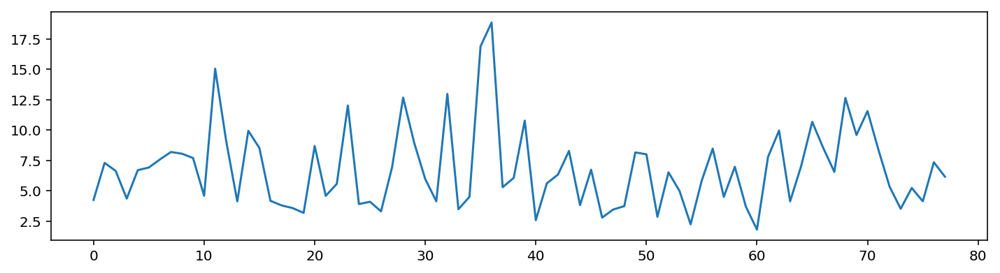

	 	 Test subset results
Test mean absolute percentage error per hour: 1.501037
Test mean absolute percentage error per day: 9.850678 
	 	 Validation Forecasting visualisation


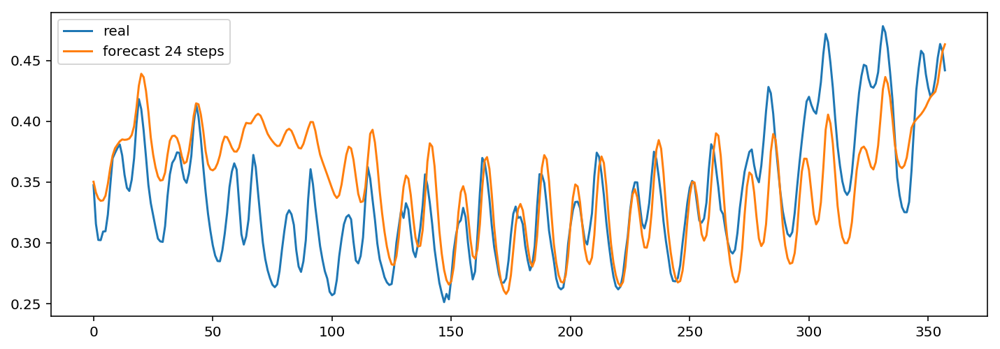

	 	 Forecasting a sample from Learning dataset


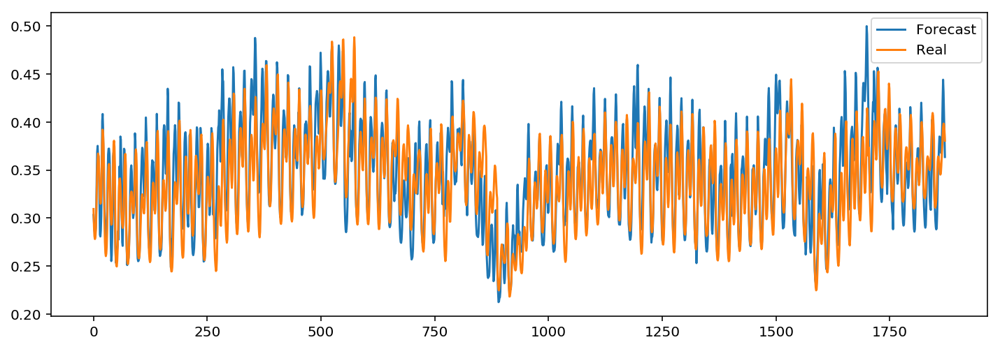

In [41]:
UsedInputsTemp= np.empty([9])
FinalErrorTemp= np.empty([2])
Parameters = np.empty([4])
ID= np.empty([1])
ID[0]=Model_ID


UsedInputsTemp[0] = previoushour = True
UsedInputsTemp[1] = timeSteps = 9
UsedInputsTemp[2] = previousDay = True
UsedInputsTemp[3] = previousWeek = True
UsedInputsTemp[4] = Temp = False
UsedInputsTemp[5] = TempMax = False
UsedInputsTemp[6] = TempMin = False
UsedInputsTemp[7] = dayIndicator = False
UsedInputsTemp[8] = HourIndicator = False

shift = False

learninginputs, learningoutputs, testinputs, testoutputs, nbrInputs = prepareInputs(daydata,season,UsedInputsTemp,testPeriod)
#learning vectors
inputx1 = np.array(pd.DataFrame(learninginputs.copy())).reshape(-1,nbrInputs)
outputx1 = np.array(pd.DataFrame(learningoutputs.copy()))

#test vectors
inputx2 = np.array(pd.DataFrame(testinputs.copy())).reshape(-1,nbrInputs)
outputx2 = np.array(pd.DataFrame(testoutputs.copy()))

Parameters[0]= HiddenNeurons1 = 90
Parameters[1]= HiddenNeurons2 = 30
Parameters[2]= LearningRate = 0.002

tempMLPmodels, tempErrorHistory,MLP_Model = create_Train_MLP_NN_Model(inputx1,outputx1,inputx2,outputx2,inputx1.shape[1],HiddenNeurons1=HiddenNeurons1,HiddenNeurons2=HiddenNeurons2
                                      ,Epoch=Epoch,LearningRate = LearningRate,Optimizer='Nadam')

Parameters[3]= tempErrorHistory.argmin()

MLP_Model.save('Models/lstm_%d_%s_%s'%(Model_ID,season,today))
# MLP_Model = load_model('Models/lstm_%d_%s_%s'%(Model_ID,season,today))

clear_output()
print('==================================================================================')
print('\t \t test num : %s' %Model_ID )
print('==================================================================================')


LearningMAPE, testMAPE , LearningHourlyMAPE, LearningDailyForecast, LearningHourlyForecast  = getForecastingResults(
    tempMLPmodels, tempErrorHistory,learninginputs,learningoutputs,testinputs,testoutputs,MLP_Model,nbrInputs,shift,previoushour,season,timeSteps)
FinalErrorTemp[0] = LearningMAPE
FinalErrorTemp[1] = testMAPE

UsedInputList.append(UsedInputsTemp)
MAPErrorList.append(FinalErrorTemp)
ModelsList.append(MLP_Model)
ForecastingList.append(LearningDailyForecast)
Models_IDs.append(ID)
Models_parameters.append(Parameters)

print('==================================================================================')
print('\t \t Forecasting a sample from Learning dataset')
print('==================================================================================')
plt.figure(figsize=(12,4))
ForecastingList[Model_ID].index= range(ForecastingList[Model_ID].index.size)
plt.plot(ForecastingList[Model_ID].iloc[:,0],label='Forecast')
plt.plot(ForecastingList[Model_ID].iloc[:,1],label='Real')
plt.legend( loc=1, borderaxespad=0.4)
plt.show()

Model_ID = Model_ID + 1

	 	 test num : 27
	 	 learning subset results
Hourly Learning mean absolute percentage error of 1872 hours : 1.84905535333 
Daily Learning mean absolute percentage error of 78 days : 7.04329552864 
	 	 MAPError plot through Learning DataSet 


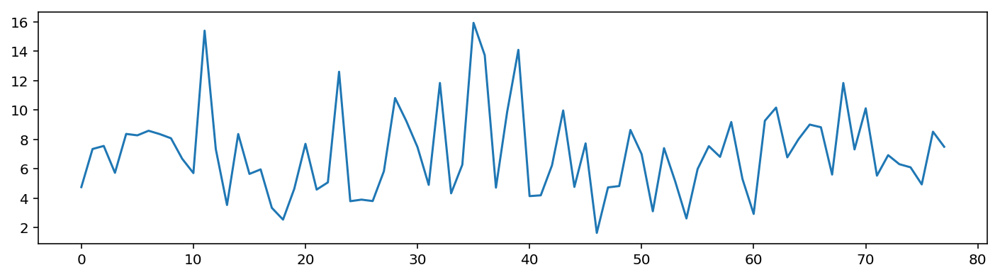

	 	 Test subset results
Test mean absolute percentage error per hour: 1.514196
Test mean absolute percentage error per day: 9.115064 
	 	 Validation Forecasting visualisation


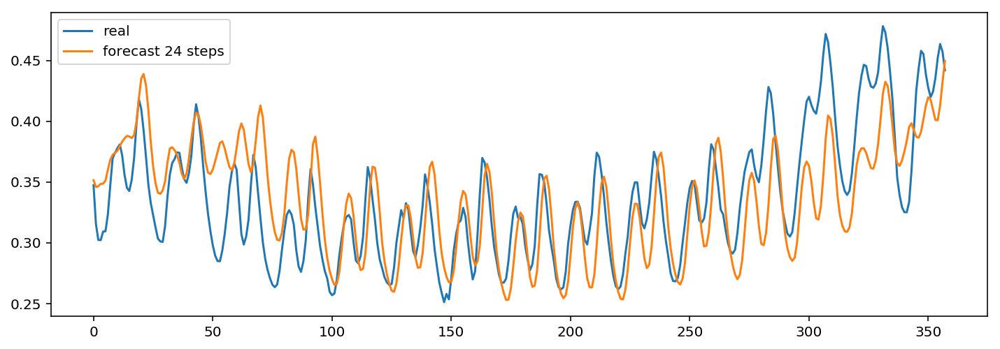

	 	 Forecasting a sample from Learning dataset


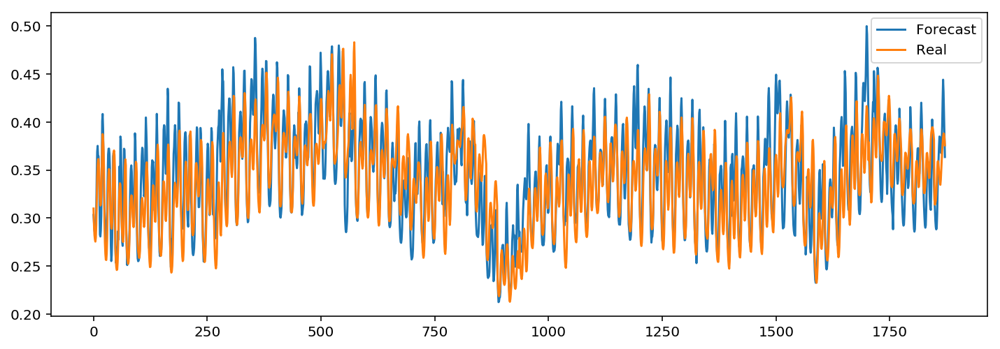

In [42]:
UsedInputsTemp= np.empty([9])
FinalErrorTemp= np.empty([2])
Parameters = np.empty([4])
ID= np.empty([1])
ID[0]=Model_ID


UsedInputsTemp[0] = previoushour = True
UsedInputsTemp[1] = timeSteps = 10
UsedInputsTemp[2] = previousDay = True
UsedInputsTemp[3] = previousWeek = True
UsedInputsTemp[4] = Temp = False
UsedInputsTemp[5] = TempMax = False
UsedInputsTemp[6] = TempMin = False
UsedInputsTemp[7] = dayIndicator = False
UsedInputsTemp[8] = HourIndicator = False

shift = False

learninginputs, learningoutputs, testinputs, testoutputs, nbrInputs = prepareInputs(daydata,season,UsedInputsTemp,testPeriod)
#learning vectors
inputx1 = np.array(pd.DataFrame(learninginputs.copy())).reshape(-1,nbrInputs)
outputx1 = np.array(pd.DataFrame(learningoutputs.copy()))

#test vectors
inputx2 = np.array(pd.DataFrame(testinputs.copy())).reshape(-1,nbrInputs)
outputx2 = np.array(pd.DataFrame(testoutputs.copy()))

Parameters[0]= HiddenNeurons1 = 90
Parameters[1]= HiddenNeurons2 = 30
Parameters[2]= LearningRate = 0.002

tempMLPmodels, tempErrorHistory,MLP_Model = create_Train_MLP_NN_Model(inputx1,outputx1,inputx2,outputx2,inputx1.shape[1],HiddenNeurons1=HiddenNeurons1,HiddenNeurons2=HiddenNeurons2
                                      ,Epoch=Epoch,LearningRate = LearningRate,Optimizer='Nadam')

Parameters[3]= tempErrorHistory.argmin()

MLP_Model.save('Models/lstm_%d_%s_%s'%(Model_ID,season,today))
# MLP_Model = load_model('Models/lstm_%d_%s_%s'%(Model_ID,season,today))

clear_output()
print('==================================================================================')
print('\t \t test num : %s' %Model_ID )
print('==================================================================================')


LearningMAPE, testMAPE , LearningHourlyMAPE, LearningDailyForecast, LearningHourlyForecast  = getForecastingResults(
    tempMLPmodels, tempErrorHistory,learninginputs,learningoutputs,testinputs,testoutputs,MLP_Model,nbrInputs,shift,previoushour,season,timeSteps)
FinalErrorTemp[0] = LearningMAPE
FinalErrorTemp[1] = testMAPE

UsedInputList.append(UsedInputsTemp)
MAPErrorList.append(FinalErrorTemp)
ModelsList.append(MLP_Model)
ForecastingList.append(LearningDailyForecast)
Models_IDs.append(ID)
Models_parameters.append(Parameters)

print('==================================================================================')
print('\t \t Forecasting a sample from Learning dataset')
print('==================================================================================')
plt.figure(figsize=(12,4))
ForecastingList[Model_ID].index= range(ForecastingList[Model_ID].index.size)
plt.plot(ForecastingList[Model_ID].iloc[:,0],label='Forecast')
plt.plot(ForecastingList[Model_ID].iloc[:,1],label='Real')
plt.legend( loc=1, borderaxespad=0.4)
plt.show()

Model_ID = Model_ID + 1

	 	 test num : 28
	 	 learning subset results
Hourly Learning mean absolute percentage error of 1872 hours : 1.69716709797 
Daily Learning mean absolute percentage error of 78 days : 5.72048529753 
	 	 MAPError plot through Learning DataSet 


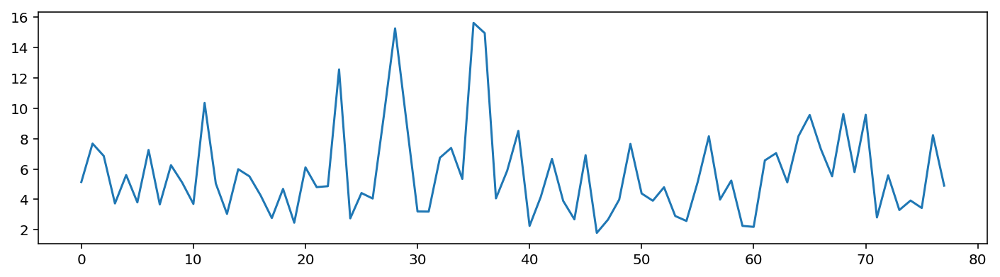

	 	 Test subset results
Test mean absolute percentage error per hour: 1.462301
Test mean absolute percentage error per day: 11.035969 
	 	 Validation Forecasting visualisation


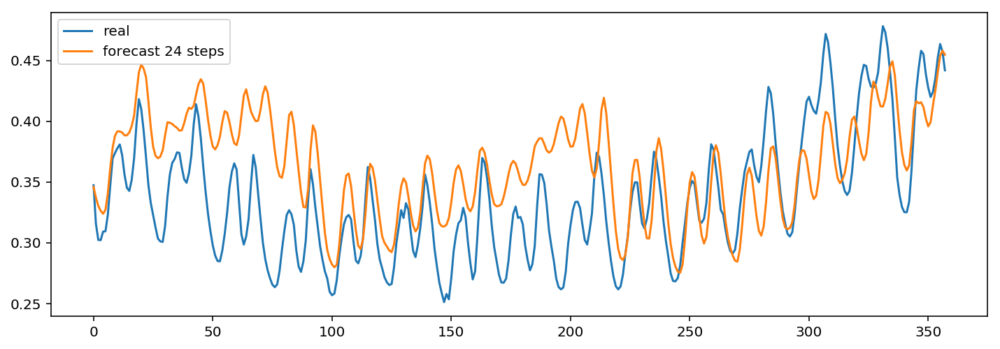

	 	 Forecasting a sample from Learning dataset


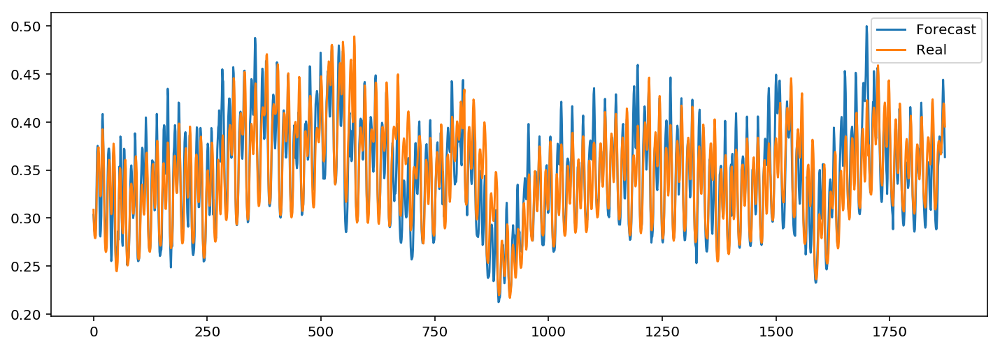

In [43]:
UsedInputsTemp= np.empty([9])
FinalErrorTemp= np.empty([2])
Parameters = np.empty([4])
ID= np.empty([1])
ID[0]=Model_ID


UsedInputsTemp[0] = previoushour = True
UsedInputsTemp[1] = timeSteps = 11
UsedInputsTemp[2] = previousDay = True
UsedInputsTemp[3] = previousWeek = True
UsedInputsTemp[4] = Temp = False
UsedInputsTemp[5] = TempMax = False
UsedInputsTemp[6] = TempMin = False
UsedInputsTemp[7] = dayIndicator = False
UsedInputsTemp[8] = HourIndicator = False

shift = False

learninginputs, learningoutputs, testinputs, testoutputs, nbrInputs = prepareInputs(daydata,season,UsedInputsTemp,testPeriod)
#learning vectors
inputx1 = np.array(pd.DataFrame(learninginputs.copy())).reshape(-1,nbrInputs)
outputx1 = np.array(pd.DataFrame(learningoutputs.copy()))

#test vectors
inputx2 = np.array(pd.DataFrame(testinputs.copy())).reshape(-1,nbrInputs)
outputx2 = np.array(pd.DataFrame(testoutputs.copy()))

Parameters[0]= HiddenNeurons1 = 90
Parameters[1]= HiddenNeurons2 = 30
Parameters[2]= LearningRate = 0.002

tempMLPmodels, tempErrorHistory,MLP_Model = create_Train_MLP_NN_Model(inputx1,outputx1,inputx2,outputx2,inputx1.shape[1],HiddenNeurons1=HiddenNeurons1,HiddenNeurons2=HiddenNeurons2
                                      ,Epoch=Epoch,LearningRate = LearningRate,Optimizer='Nadam')

Parameters[3]= tempErrorHistory.argmin()

MLP_Model.save('Models/lstm_%d_%s_%s'%(Model_ID,season,today))
# MLP_Model = load_model('Models/lstm_%d_%s_%s'%(Model_ID,season,today))

clear_output()
print('==================================================================================')
print('\t \t test num : %s' %Model_ID )
print('==================================================================================')


LearningMAPE, testMAPE , LearningHourlyMAPE, LearningDailyForecast, LearningHourlyForecast  = getForecastingResults(
    tempMLPmodels, tempErrorHistory,learninginputs,learningoutputs,testinputs,testoutputs,MLP_Model,nbrInputs,shift,previoushour,season,timeSteps)
FinalErrorTemp[0] = LearningMAPE
FinalErrorTemp[1] = testMAPE

UsedInputList.append(UsedInputsTemp)
MAPErrorList.append(FinalErrorTemp)
ModelsList.append(MLP_Model)
ForecastingList.append(LearningDailyForecast)
Models_IDs.append(ID)
Models_parameters.append(Parameters)

print('==================================================================================')
print('\t \t Forecasting a sample from Learning dataset')
print('==================================================================================')
plt.figure(figsize=(12,4))
ForecastingList[Model_ID].index= range(ForecastingList[Model_ID].index.size)
plt.plot(ForecastingList[Model_ID].iloc[:,0],label='Forecast')
plt.plot(ForecastingList[Model_ID].iloc[:,1],label='Real')
plt.legend( loc=1, borderaxespad=0.4)
plt.show()

Model_ID = Model_ID + 1

	 	 test num : 29
	 	 learning subset results
Hourly Learning mean absolute percentage error of 1872 hours : 1.6787308778 
Daily Learning mean absolute percentage error of 78 days : 5.6641320953 
	 	 MAPError plot through Learning DataSet 


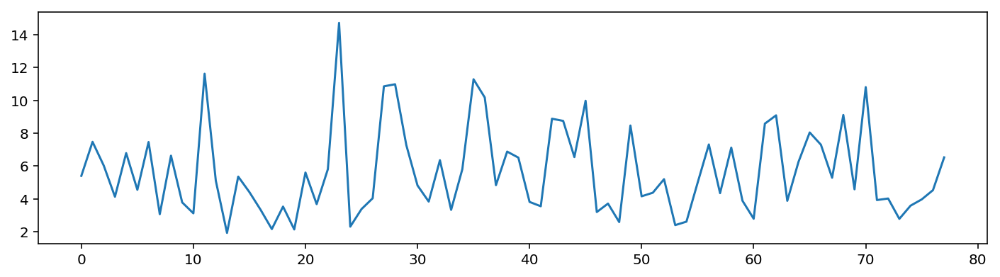

	 	 Test subset results
Test mean absolute percentage error per hour: 1.509324
Test mean absolute percentage error per day: 8.259576 
	 	 Validation Forecasting visualisation


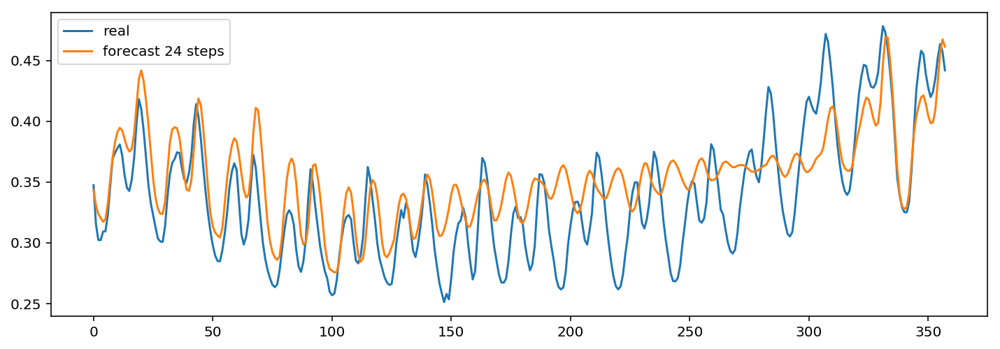

	 	 Forecasting a sample from Learning dataset


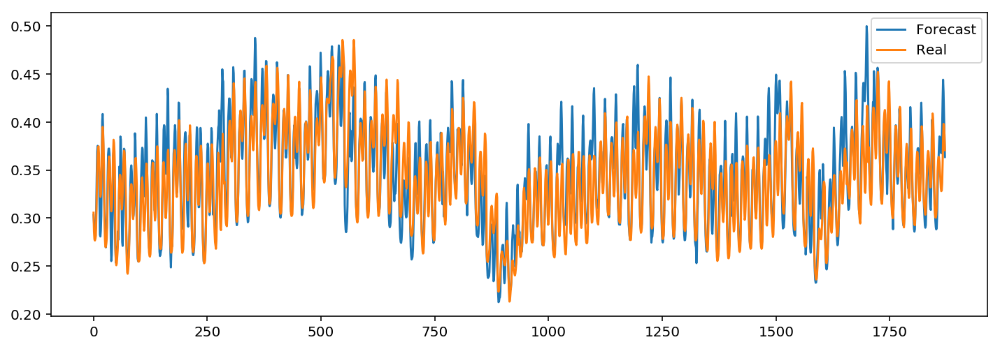

In [44]:
UsedInputsTemp= np.empty([9])
FinalErrorTemp= np.empty([2])
Parameters = np.empty([4])
ID= np.empty([1])
ID[0]=Model_ID


UsedInputsTemp[0] = previoushour = True
UsedInputsTemp[1] = timeSteps = 12
UsedInputsTemp[2] = previousDay = True
UsedInputsTemp[3] = previousWeek = True
UsedInputsTemp[4] = Temp = False
UsedInputsTemp[5] = TempMax = False
UsedInputsTemp[6] = TempMin = False
UsedInputsTemp[7] = dayIndicator = False
UsedInputsTemp[8] = HourIndicator = False

shift = False

learninginputs, learningoutputs, testinputs, testoutputs, nbrInputs = prepareInputs(daydata,season,UsedInputsTemp,testPeriod)
#learning vectors
inputx1 = np.array(pd.DataFrame(learninginputs.copy())).reshape(-1,nbrInputs)
outputx1 = np.array(pd.DataFrame(learningoutputs.copy()))

#test vectors
inputx2 = np.array(pd.DataFrame(testinputs.copy())).reshape(-1,nbrInputs)
outputx2 = np.array(pd.DataFrame(testoutputs.copy()))

Parameters[0]= HiddenNeurons1 = 90
Parameters[1]= HiddenNeurons2 = 30
Parameters[2]= LearningRate = 0.002

tempMLPmodels, tempErrorHistory,MLP_Model = create_Train_MLP_NN_Model(inputx1,outputx1,inputx2,outputx2,inputx1.shape[1],HiddenNeurons1=HiddenNeurons1,HiddenNeurons2=HiddenNeurons2
                                      ,Epoch=Epoch,LearningRate = LearningRate,Optimizer='Nadam')

Parameters[3]= tempErrorHistory.argmin()

MLP_Model.save('Models/lstm_%d_%s_%s'%(Model_ID,season,today))
# MLP_Model = load_model('Models/lstm_%d_%s_%s'%(Model_ID,season,today))

clear_output()
print('==================================================================================')
print('\t \t test num : %s' %Model_ID )
print('==================================================================================')


LearningMAPE, testMAPE , LearningHourlyMAPE, LearningDailyForecast, LearningHourlyForecast  = getForecastingResults(
    tempMLPmodels, tempErrorHistory,learninginputs,learningoutputs,testinputs,testoutputs,MLP_Model,nbrInputs,shift,previoushour,season,timeSteps)
FinalErrorTemp[0] = LearningMAPE
FinalErrorTemp[1] = testMAPE

UsedInputList.append(UsedInputsTemp)
MAPErrorList.append(FinalErrorTemp)
ModelsList.append(MLP_Model)
ForecastingList.append(LearningDailyForecast)
Models_IDs.append(ID)
Models_parameters.append(Parameters)

print('==================================================================================')
print('\t \t Forecasting a sample from Learning dataset')
print('==================================================================================')
plt.figure(figsize=(12,4))
ForecastingList[Model_ID].index= range(ForecastingList[Model_ID].index.size)
plt.plot(ForecastingList[Model_ID].iloc[:,0],label='Forecast')
plt.plot(ForecastingList[Model_ID].iloc[:,1],label='Real')
plt.legend( loc=1, borderaxespad=0.4)
plt.show()

Model_ID = Model_ID + 1

In [45]:
UsedInputs = np.array(UsedInputList)

FinalError= np.array(MAPErrorList)

summary = pd.DataFrame(np.concatenate((Models_IDs,Models_parameters,UsedInputs,FinalError),axis=1),columns=
                       ['Model ID','Neurons L1','Neurons L2','Learning rate','Epochs','Previous hour','Time steps','Previous day'
                        ,'Previous week','Temperature','Temp Max','Temp Min','Day indicator','Hour indicator','Training MAPE %',
                        'Test MAPE %'])

summary

,Model ID,Neurons L1,Neurons L2,Learning rate,Epochs,Previous hour,Time steps,Previous day,Previous week,Temperature,Temp Max,Temp Min,Day indicator,Hour indicator,Training MAPE %,Test MAPE %
0,0.0,20.0,10.0,0.001,2574.0,1.0,24.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,4.085393,3.576533
1,1.0,20.0,10.0,0.001,2419.0,1.0,12.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,3.520566,3.594924
2,2.0,20.0,10.0,0.001,2175.0,1.0,12.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,3.082597,4.263560
3,3.0,20.0,10.0,0.001,2691.0,1.0,6.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,4.486152,3.269316
4,4.0,20.0,10.0,0.001,1606.0,1.0,3.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,4.042950,3.386997
5,5.0,20.0,10.0,0.001,805.0,1.0,12.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,3.801552,3.532179
6,6.0,60.0,30.0,0.001,786.0,1.0,12.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,3.822085,3.980042
7,7.0,50.0,10.0,0.001,492.0,1.0,12.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,3.266894,4.578066
8,8.0,80.0,50.0,0.001,314.0,1.0,12.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,3.364827,3.901970
9,9.0,90.0,30.0,0.002,376.0,1.0,12.0,1.0,1.0,1.0,1.0,1.0,0.0,1.0,4.039233,4.239113


	 	 test num : 30
	 	 learning subset results
Hourly Learning mean absolute percentage error of 1872 hours : 1.37009196157 
Daily Learning mean absolute percentage error of 78 days : 3.91768500744 
	 	 MAPError plot through Learning DataSet 


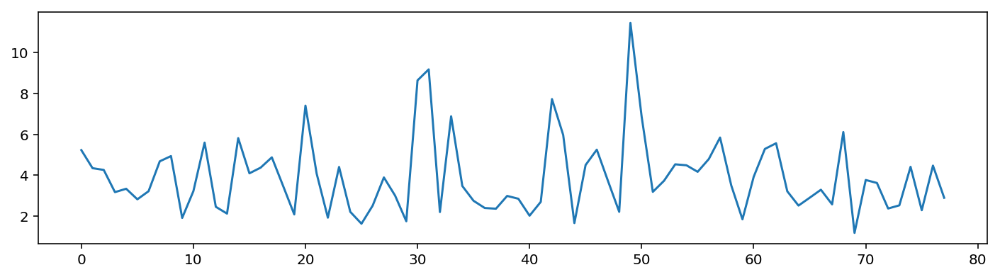

	 	 Test subset results
Test mean absolute percentage error per hour: 1.530953
Test mean absolute percentage error per day: 3.909240 
	 	 Validation Forecasting visualisation


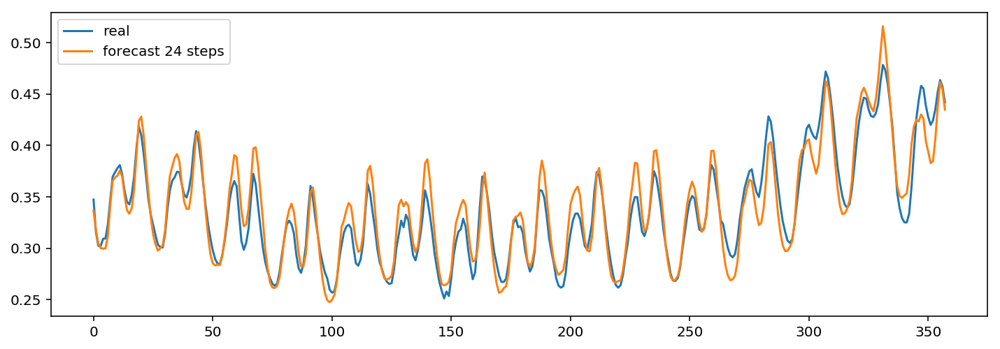

	 	 Forecasting a sample from Learning dataset


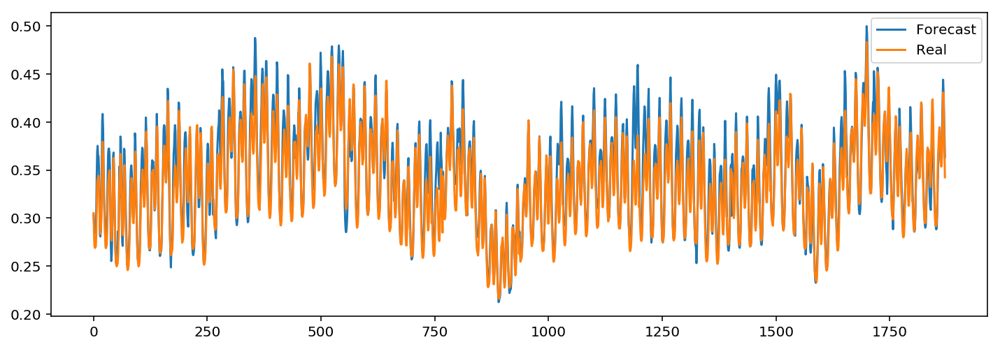

In [47]:
UsedInputsTemp= np.empty([9])
FinalErrorTemp= np.empty([2])
Parameters = np.empty([4])
ID= np.empty([1])
ID[0]=Model_ID


UsedInputsTemp[0] = previoushour = True
UsedInputsTemp[1] = timeSteps = 6
UsedInputsTemp[2] = previousDay = True
UsedInputsTemp[3] = previousWeek = True
UsedInputsTemp[4] = Temp = True
UsedInputsTemp[5] = TempMax = True
UsedInputsTemp[6] = TempMin = True
UsedInputsTemp[7] = dayIndicator = True
UsedInputsTemp[8] = HourIndicator = True

shift = False

learninginputs, learningoutputs, testinputs, testoutputs, nbrInputs = prepareInputs(daydata,season,UsedInputsTemp,testPeriod)
#learning vectors
inputx1 = np.array(pd.DataFrame(learninginputs.copy())).reshape(-1,nbrInputs)
outputx1 = np.array(pd.DataFrame(learningoutputs.copy()))

#test vectors
inputx2 = np.array(pd.DataFrame(testinputs.copy())).reshape(-1,nbrInputs)
outputx2 = np.array(pd.DataFrame(testoutputs.copy()))

Parameters[0]= HiddenNeurons1 = 30
Parameters[1]= HiddenNeurons2 = 20
Parameters[2]= LearningRate = 0.002

tempMLPmodels, tempErrorHistory,MLP_Model = create_Train_MLP_NN_Model(inputx1,outputx1,inputx2,outputx2,inputx1.shape[1],HiddenNeurons1=HiddenNeurons1,HiddenNeurons2=HiddenNeurons2
                                      ,Epoch=Epoch,LearningRate = LearningRate,Optimizer='Adam')

Parameters[3]= tempErrorHistory.argmin()

MLP_Model.save('Models/lstm_%d_%s_%s'%(Model_ID,season,today))
# MLP_Model = load_model('Models/lstm_%d_%s_%s'%(Model_ID,season,today))

clear_output()
print('==================================================================================')
print('\t \t test num : %s' %Model_ID )
print('==================================================================================')


LearningMAPE, testMAPE , LearningHourlyMAPE, LearningDailyForecast, LearningHourlyForecast  = getForecastingResults(
    tempMLPmodels, tempErrorHistory,learninginputs,learningoutputs,testinputs,testoutputs,MLP_Model,nbrInputs,shift,previoushour,season,timeSteps)
FinalErrorTemp[0] = LearningMAPE
FinalErrorTemp[1] = testMAPE

UsedInputList.append(UsedInputsTemp)
MAPErrorList.append(FinalErrorTemp)
ModelsList.append(MLP_Model)
ForecastingList.append(LearningDailyForecast)
Models_IDs.append(ID)
Models_parameters.append(Parameters)

print('==================================================================================')
print('\t \t Forecasting a sample from Learning dataset')
print('==================================================================================')
plt.figure(figsize=(12,4))
ForecastingList[Model_ID].index= range(ForecastingList[Model_ID].index.size)
plt.plot(ForecastingList[Model_ID].iloc[:,0],label='Forecast')
plt.plot(ForecastingList[Model_ID].iloc[:,1],label='Real')
plt.legend( loc=1, borderaxespad=0.4)
plt.show()

Model_ID = Model_ID + 1

	 	 test num : 31
	 	 learning subset results
Hourly Learning mean absolute percentage error of 1872 hours : 1.33592068549 
Daily Learning mean absolute percentage error of 78 days : 3.44623766343 
	 	 MAPError plot through Learning DataSet 


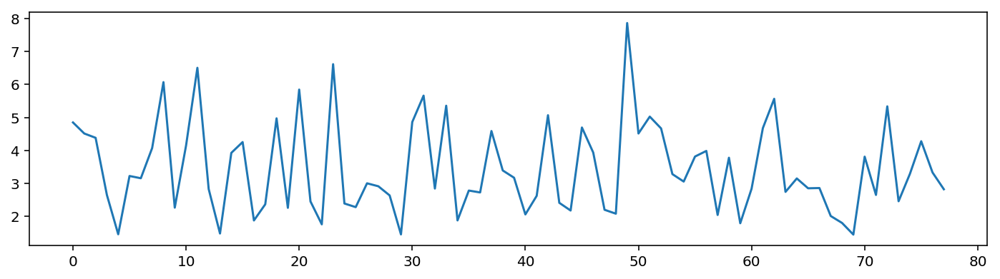

	 	 Test subset results
Test mean absolute percentage error per hour: 1.510118
Test mean absolute percentage error per day: 4.254936 
	 	 Validation Forecasting visualisation


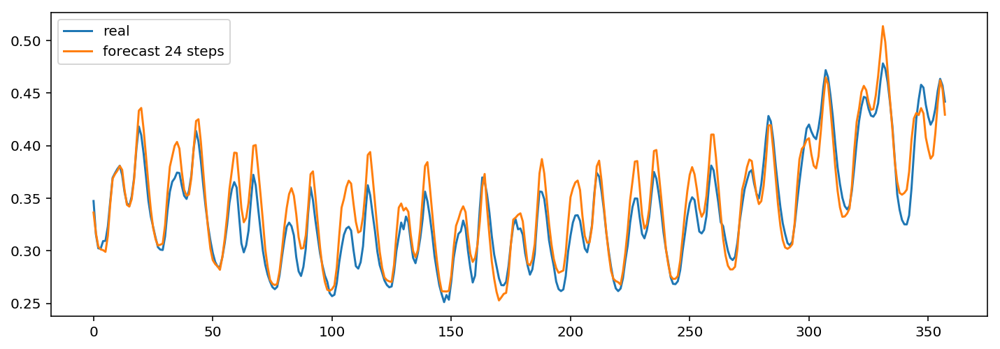

	 	 Forecasting a sample from Learning dataset


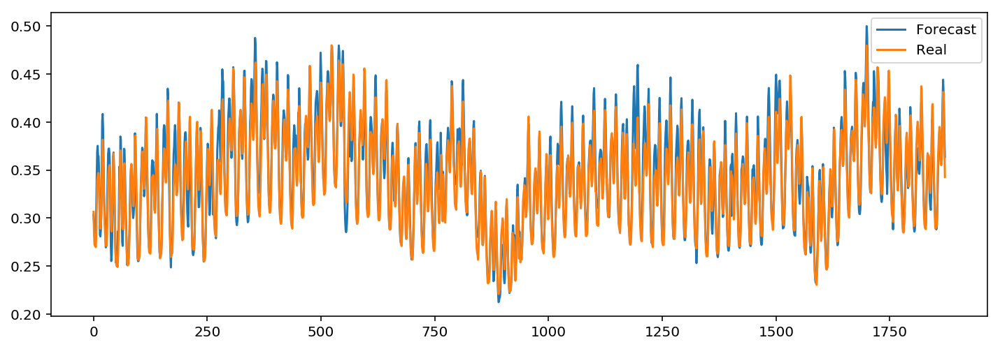

In [48]:
UsedInputsTemp= np.empty([9])
FinalErrorTemp= np.empty([2])
Parameters = np.empty([4])
ID= np.empty([1])
ID[0]=Model_ID


UsedInputsTemp[0] = previoushour = True
UsedInputsTemp[1] = timeSteps = 3
UsedInputsTemp[2] = previousDay = True
UsedInputsTemp[3] = previousWeek = True
UsedInputsTemp[4] = Temp = True
UsedInputsTemp[5] = TempMax = True
UsedInputsTemp[6] = TempMin = True
UsedInputsTemp[7] = dayIndicator = True
UsedInputsTemp[8] = HourIndicator = True

shift = False

learninginputs, learningoutputs, testinputs, testoutputs, nbrInputs = prepareInputs(daydata,season,UsedInputsTemp,testPeriod)
#learning vectors
inputx1 = np.array(pd.DataFrame(learninginputs.copy())).reshape(-1,nbrInputs)
outputx1 = np.array(pd.DataFrame(learningoutputs.copy()))

#test vectors
inputx2 = np.array(pd.DataFrame(testinputs.copy())).reshape(-1,nbrInputs)
outputx2 = np.array(pd.DataFrame(testoutputs.copy()))

Parameters[0]= HiddenNeurons1 = 30
Parameters[1]= HiddenNeurons2 = 20
Parameters[2]= LearningRate = 0.002

tempMLPmodels, tempErrorHistory,MLP_Model = create_Train_MLP_NN_Model(inputx1,outputx1,inputx2,outputx2,inputx1.shape[1],HiddenNeurons1=HiddenNeurons1,HiddenNeurons2=HiddenNeurons2
                                      ,Epoch=Epoch,LearningRate = LearningRate,Optimizer='Adam')

Parameters[3]= tempErrorHistory.argmin()

MLP_Model.save('Models/lstm_%d_%s_%s'%(Model_ID,season,today))
# MLP_Model = load_model('Models/lstm_%d_%s_%s'%(Model_ID,season,today))

clear_output()
print('==================================================================================')
print('\t \t test num : %s' %Model_ID )
print('==================================================================================')


LearningMAPE, testMAPE , LearningHourlyMAPE, LearningDailyForecast, LearningHourlyForecast  = getForecastingResults(
    tempMLPmodels, tempErrorHistory,learninginputs,learningoutputs,testinputs,testoutputs,MLP_Model,nbrInputs,shift,previoushour,season,timeSteps)
FinalErrorTemp[0] = LearningMAPE
FinalErrorTemp[1] = testMAPE

UsedInputList.append(UsedInputsTemp)
MAPErrorList.append(FinalErrorTemp)
ModelsList.append(MLP_Model)
ForecastingList.append(LearningDailyForecast)
Models_IDs.append(ID)
Models_parameters.append(Parameters)

print('==================================================================================')
print('\t \t Forecasting a sample from Learning dataset')
print('==================================================================================')
plt.figure(figsize=(12,4))
ForecastingList[Model_ID].index= range(ForecastingList[Model_ID].index.size)
plt.plot(ForecastingList[Model_ID].iloc[:,0],label='Forecast')
plt.plot(ForecastingList[Model_ID].iloc[:,1],label='Real')
plt.legend( loc=1, borderaxespad=0.4)
plt.show()

Model_ID = Model_ID + 1

	 	 test num : 32
	 	 learning subset results
Hourly Learning mean absolute percentage error of 1872 hours : 1.35333141864 
Daily Learning mean absolute percentage error of 78 days : 3.72474906154 
	 	 MAPError plot through Learning DataSet 


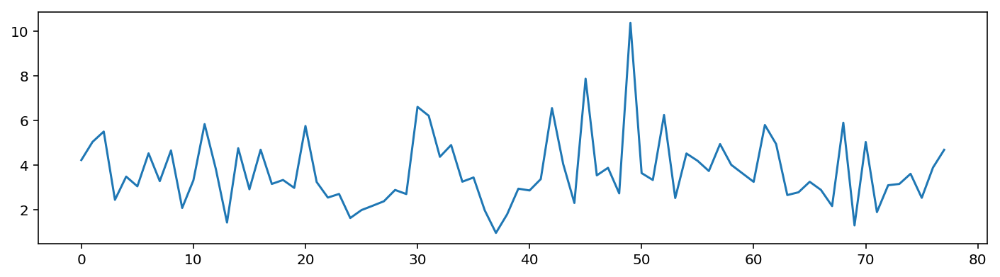

	 	 Test subset results
Test mean absolute percentage error per hour: 1.409913
Test mean absolute percentage error per day: 3.637942 
	 	 Validation Forecasting visualisation


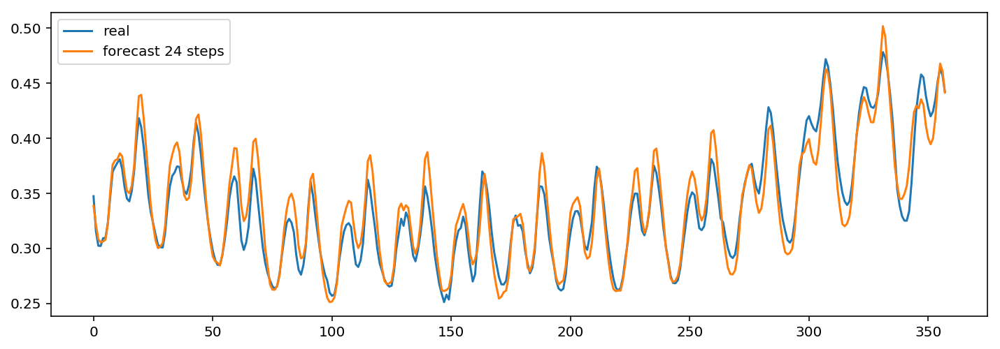

	 	 Forecasting a sample from Learning dataset


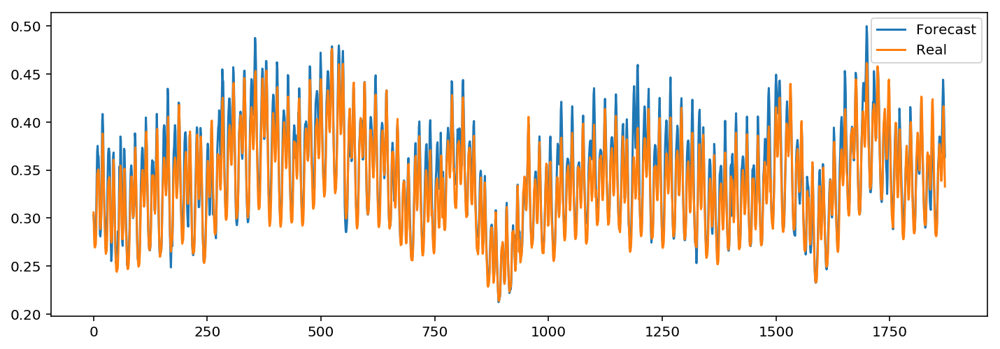

In [49]:
UsedInputsTemp= np.empty([9])
FinalErrorTemp= np.empty([2])
Parameters = np.empty([4])
ID= np.empty([1])
ID[0]=Model_ID


UsedInputsTemp[0] = previoushour = True
UsedInputsTemp[1] = timeSteps = 12
UsedInputsTemp[2] = previousDay = True
UsedInputsTemp[3] = previousWeek = True
UsedInputsTemp[4] = Temp = True
UsedInputsTemp[5] = TempMax = True
UsedInputsTemp[6] = TempMin = True
UsedInputsTemp[7] = dayIndicator = True
UsedInputsTemp[8] = HourIndicator = True

shift = False

learninginputs, learningoutputs, testinputs, testoutputs, nbrInputs = prepareInputs(daydata,season,UsedInputsTemp,testPeriod)
#learning vectors
inputx1 = np.array(pd.DataFrame(learninginputs.copy())).reshape(-1,nbrInputs)
outputx1 = np.array(pd.DataFrame(learningoutputs.copy()))

#test vectors
inputx2 = np.array(pd.DataFrame(testinputs.copy())).reshape(-1,nbrInputs)
outputx2 = np.array(pd.DataFrame(testoutputs.copy()))

Parameters[0]= HiddenNeurons1 = 30
Parameters[1]= HiddenNeurons2 = 20
Parameters[2]= LearningRate = 0.002

tempMLPmodels, tempErrorHistory,MLP_Model = create_Train_MLP_NN_Model(inputx1,outputx1,inputx2,outputx2,inputx1.shape[1],HiddenNeurons1=HiddenNeurons1,HiddenNeurons2=HiddenNeurons2
                                      ,Epoch=Epoch,LearningRate = LearningRate,Optimizer='Adam')

Parameters[3]= tempErrorHistory.argmin()

MLP_Model.save('Models/lstm_%d_%s_%s'%(Model_ID,season,today))
# MLP_Model = load_model('Models/lstm_%d_%s_%s'%(Model_ID,season,today))

clear_output()
print('==================================================================================')
print('\t \t test num : %s' %Model_ID )
print('==================================================================================')


LearningMAPE, testMAPE , LearningHourlyMAPE, LearningDailyForecast, LearningHourlyForecast  = getForecastingResults(
    tempMLPmodels, tempErrorHistory,learninginputs,learningoutputs,testinputs,testoutputs,MLP_Model,nbrInputs,shift,previoushour,season,timeSteps)
FinalErrorTemp[0] = LearningMAPE
FinalErrorTemp[1] = testMAPE

UsedInputList.append(UsedInputsTemp)
MAPErrorList.append(FinalErrorTemp)
ModelsList.append(MLP_Model)
ForecastingList.append(LearningDailyForecast)
Models_IDs.append(ID)
Models_parameters.append(Parameters)

print('==================================================================================')
print('\t \t Forecasting a sample from Learning dataset')
print('==================================================================================')
plt.figure(figsize=(12,4))
ForecastingList[Model_ID].index= range(ForecastingList[Model_ID].index.size)
plt.plot(ForecastingList[Model_ID].iloc[:,0],label='Forecast')
plt.plot(ForecastingList[Model_ID].iloc[:,1],label='Real')
plt.legend( loc=1, borderaxespad=0.4)
plt.show()

Model_ID = Model_ID + 1

In [51]:
UsedInputs = np.array(UsedInputList)

FinalError= np.array(MAPErrorList)

summary = pd.DataFrame(np.concatenate((Models_IDs,Models_parameters,UsedInputs,FinalError),axis=1),columns=
                       ['Model ID','Neurons L1','Neurons L2','Learning rate','Epochs','Previous hour','Time steps','Previous day'
                        ,'Previous week','Temperature','Temp Max','Temp Min','Day indicator','Hour indicator','Training MAPE %',
                        'Test MAPE %'])

summary

,Model ID,Neurons L1,Neurons L2,Learning rate,Epochs,Previous hour,Time steps,Previous day,Previous week,Temperature,Temp Max,Temp Min,Day indicator,Hour indicator,Training MAPE %,Test MAPE %
0,0.0,20.0,10.0,0.001,2574.0,1.0,24.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,4.085393,3.576533
1,1.0,20.0,10.0,0.001,2419.0,1.0,12.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,3.520566,3.594924
2,2.0,20.0,10.0,0.001,2175.0,1.0,12.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,3.082597,4.263560
3,3.0,20.0,10.0,0.001,2691.0,1.0,6.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,4.486152,3.269316
4,4.0,20.0,10.0,0.001,1606.0,1.0,3.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,4.042950,3.386997
5,5.0,20.0,10.0,0.001,805.0,1.0,12.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,3.801552,3.532179
6,6.0,60.0,30.0,0.001,786.0,1.0,12.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,3.822085,3.980042
7,7.0,50.0,10.0,0.001,492.0,1.0,12.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,3.266894,4.578066
8,8.0,80.0,50.0,0.001,314.0,1.0,12.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,3.364827,3.901970
9,9.0,90.0,30.0,0.002,376.0,1.0,12.0,1.0,1.0,1.0,1.0,1.0,0.0,1.0,4.039233,4.239113


	 	 test num : 33
	 	 learning subset results
Hourly Learning mean absolute percentage error of 1872 hours : 2.22115097947 
Daily Learning mean absolute percentage error of 78 days : 6.02720745405 
	 	 MAPError plot through Learning DataSet 


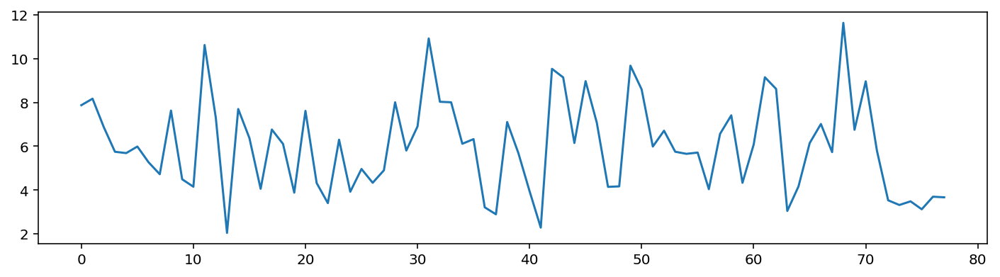

	 	 Test subset results
Test mean absolute percentage error per hour: 1.559394
Test mean absolute percentage error per day: 5.096891 
	 	 Validation Forecasting visualisation


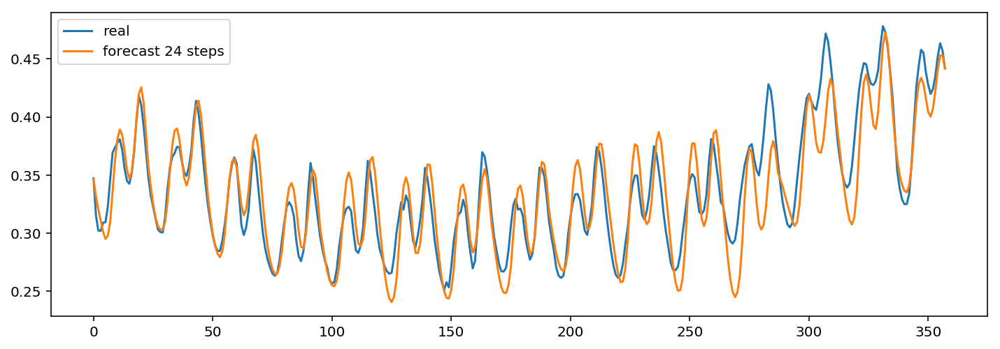

	 	 Forecasting a sample from Learning dataset


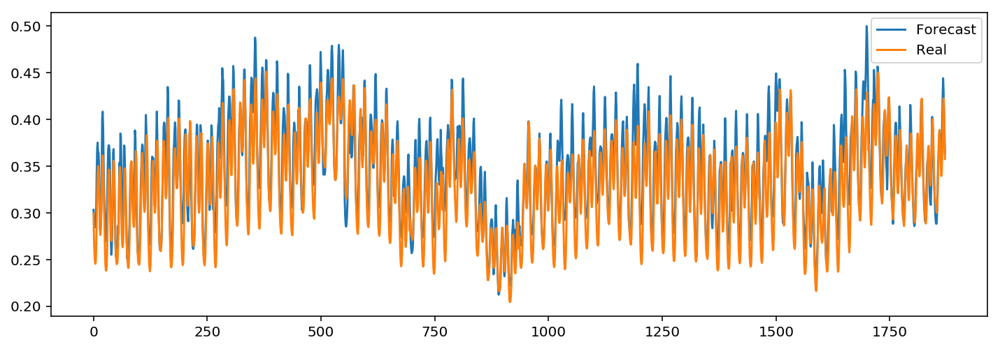

In [53]:
UsedInputsTemp= np.empty([10])
FinalErrorTemp= np.empty([2])
Parameters = np.empty([4])
ID= np.empty([1])
ID[0]=Model_ID


UsedInputsTemp[0] = previoushour = True
UsedInputsTemp[1] = timeSteps = 12
UsedInputsTemp[2] = previousDay = True
UsedInputsTemp[3] = previousWeek = True
UsedInputsTemp[4] = Temp = True
UsedInputsTemp[5] = TempMax = True
UsedInputsTemp[6] = TempMin = True
UsedInputsTemp[7] = dayIndicator = False
UsedInputsTemp[8] = HourIndicator = False
UsedInputsTemp[9] = MonthIndicator = False

shift = False

learninginputs, learningoutputs, testinputs, testoutputs, nbrInputs = prepareInputs(daydata,season,UsedInputsTemp,testPeriod)
#learning vectors
inputx1 = np.array(pd.DataFrame(learninginputs.copy())).reshape(-1,nbrInputs)
outputx1 = np.array(pd.DataFrame(learningoutputs.copy()))

#test vectors
inputx2 = np.array(pd.DataFrame(testinputs.copy())).reshape(-1,nbrInputs)
outputx2 = np.array(pd.DataFrame(testoutputs.copy()))

Parameters[0]= HiddenNeurons1 = 20
Parameters[1]= HiddenNeurons2 = 10
Parameters[2]= LearningRate = 0.002

tempMLPmodels, tempErrorHistory,MLP_Model = create_Train_MLP_NN_Model(inputx1,outputx1,inputx2,outputx2,inputx1.shape[1],HiddenNeurons1=HiddenNeurons1,HiddenNeurons2=HiddenNeurons2
                                      ,Epoch=Epoch,LearningRate = LearningRate,Optimizer='Adam')

Parameters[3]= tempErrorHistory.argmin()

MLP_Model.save('Models/lstm_%d_%s_%s'%(Model_ID,season,today))
# MLP_Model = load_model('Models/lstm_%d_%s_%s'%(Model_ID,season,today))

clear_output()
print('==================================================================================')
print('\t \t test num : %s' %Model_ID )
print('==================================================================================')


LearningMAPE, testMAPE , LearningHourlyMAPE, LearningDailyForecast, LearningHourlyForecast  = getForecastingResults(
    tempMLPmodels, tempErrorHistory,learninginputs,learningoutputs,testinputs,testoutputs,MLP_Model,nbrInputs,shift,previoushour,season,timeSteps)
FinalErrorTemp[0] = LearningMAPE
FinalErrorTemp[1] = testMAPE

UsedInputList.append(UsedInputsTemp)
MAPErrorList.append(FinalErrorTemp)
ModelsList.append(MLP_Model)
ForecastingList.append(LearningDailyForecast)
Models_IDs.append(ID)
Models_parameters.append(Parameters)

print('==================================================================================')
print('\t \t Forecasting a sample from Learning dataset')
print('==================================================================================')
plt.figure(figsize=(12,4))
ForecastingList[Model_ID].index= range(ForecastingList[Model_ID].index.size)
plt.plot(ForecastingList[Model_ID].iloc[:,0],label='Forecast')
plt.plot(ForecastingList[Model_ID].iloc[:,1],label='Real')
plt.legend( loc=1, borderaxespad=0.4)
plt.show()

Model_ID = Model_ID + 1

	 	 test num : 34
	 	 learning subset results
Hourly Learning mean absolute percentage error of 1872 hours : 1.98271982558 
Daily Learning mean absolute percentage error of 78 days : 6.22667637238 
	 	 MAPError plot through Learning DataSet 


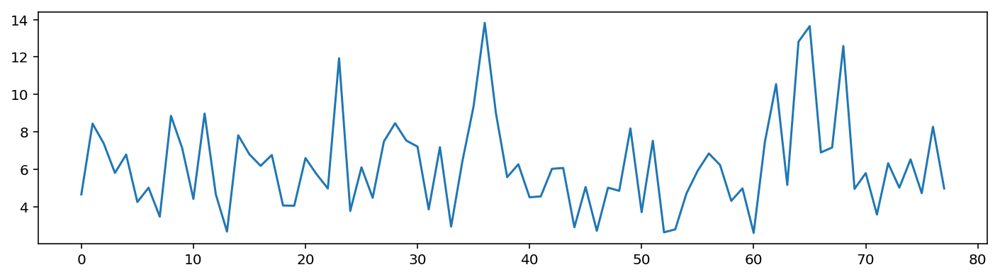

	 	 Test subset results
Test mean absolute percentage error per hour: 1.657869
Test mean absolute percentage error per day: 6.987802 
	 	 Validation Forecasting visualisation


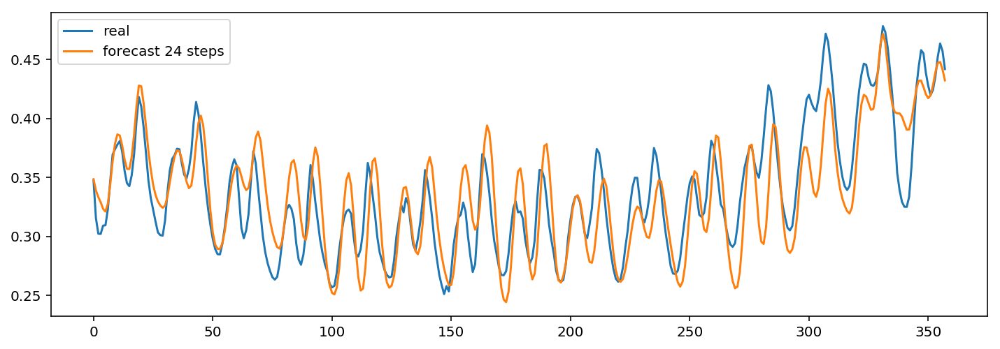

	 	 Forecasting a sample from Learning dataset


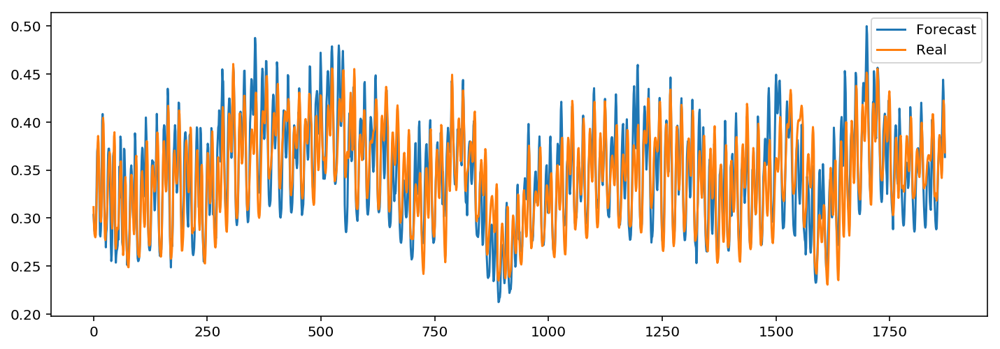

In [54]:
UsedInputsTemp= np.empty([10])
FinalErrorTemp= np.empty([2])
Parameters = np.empty([4])
ID= np.empty([1])
ID[0]=Model_ID


UsedInputsTemp[0] = previoushour = True
UsedInputsTemp[1] = timeSteps = 12
UsedInputsTemp[2] = previousDay = True
UsedInputsTemp[3] = previousWeek = True
UsedInputsTemp[4] = Temp = False
UsedInputsTemp[5] = TempMax = False
UsedInputsTemp[6] = TempMin = False
UsedInputsTemp[7] = dayIndicator = True
UsedInputsTemp[8] = HourIndicator = False
UsedInputsTemp[9] = MonthIndicator = False

shift = False

learninginputs, learningoutputs, testinputs, testoutputs, nbrInputs = prepareInputs(daydata,season,UsedInputsTemp,testPeriod)
#learning vectors
inputx1 = np.array(pd.DataFrame(learninginputs.copy())).reshape(-1,nbrInputs)
outputx1 = np.array(pd.DataFrame(learningoutputs.copy()))

#test vectors
inputx2 = np.array(pd.DataFrame(testinputs.copy())).reshape(-1,nbrInputs)
outputx2 = np.array(pd.DataFrame(testoutputs.copy()))

Parameters[0]= HiddenNeurons1 = 20
Parameters[1]= HiddenNeurons2 = 10
Parameters[2]= LearningRate = 0.002

tempMLPmodels, tempErrorHistory,MLP_Model = create_Train_MLP_NN_Model(inputx1,outputx1,inputx2,outputx2,inputx1.shape[1],HiddenNeurons1=HiddenNeurons1,HiddenNeurons2=HiddenNeurons2
                                      ,Epoch=Epoch,LearningRate = LearningRate,Optimizer='Adam')

Parameters[3]= tempErrorHistory.argmin()

MLP_Model.save('Models/lstm_%d_%s_%s'%(Model_ID,season,today))
# MLP_Model = load_model('Models/lstm_%d_%s_%s'%(Model_ID,season,today))

clear_output()
print('==================================================================================')
print('\t \t test num : %s' %Model_ID )
print('==================================================================================')


LearningMAPE, testMAPE , LearningHourlyMAPE, LearningDailyForecast, LearningHourlyForecast  = getForecastingResults(
    tempMLPmodels, tempErrorHistory,learninginputs,learningoutputs,testinputs,testoutputs,MLP_Model,nbrInputs,shift,previoushour,season,timeSteps)
FinalErrorTemp[0] = LearningMAPE
FinalErrorTemp[1] = testMAPE

UsedInputList.append(UsedInputsTemp)
MAPErrorList.append(FinalErrorTemp)
ModelsList.append(MLP_Model)
ForecastingList.append(LearningDailyForecast)
Models_IDs.append(ID)
Models_parameters.append(Parameters)

print('==================================================================================')
print('\t \t Forecasting a sample from Learning dataset')
print('==================================================================================')
plt.figure(figsize=(12,4))
ForecastingList[Model_ID].index= range(ForecastingList[Model_ID].index.size)
plt.plot(ForecastingList[Model_ID].iloc[:,0],label='Forecast')
plt.plot(ForecastingList[Model_ID].iloc[:,1],label='Real')
plt.legend( loc=1, borderaxespad=0.4)
plt.show()

Model_ID = Model_ID + 1

	 	 test num : 35
	 	 learning subset results
Hourly Learning mean absolute percentage error of 1872 hours : 1.47782774283 
Daily Learning mean absolute percentage error of 78 days : 4.60253009888 
	 	 MAPError plot through Learning DataSet 


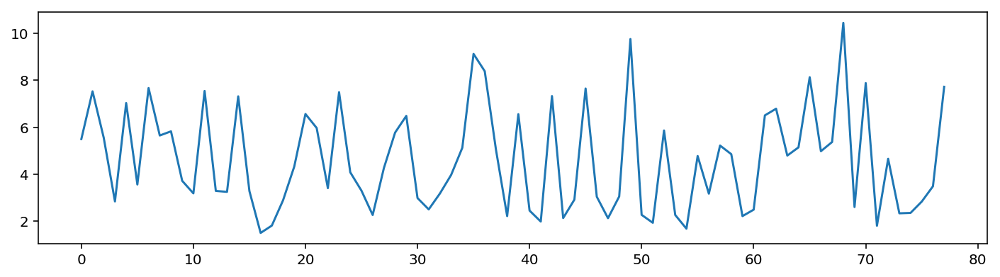

	 	 Test subset results
Test mean absolute percentage error per hour: 1.408297
Test mean absolute percentage error per day: 10.624811 
	 	 Validation Forecasting visualisation


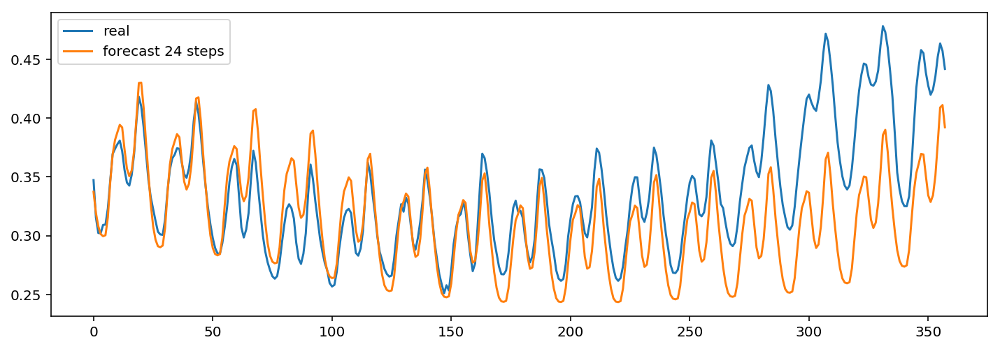

	 	 Forecasting a sample from Learning dataset


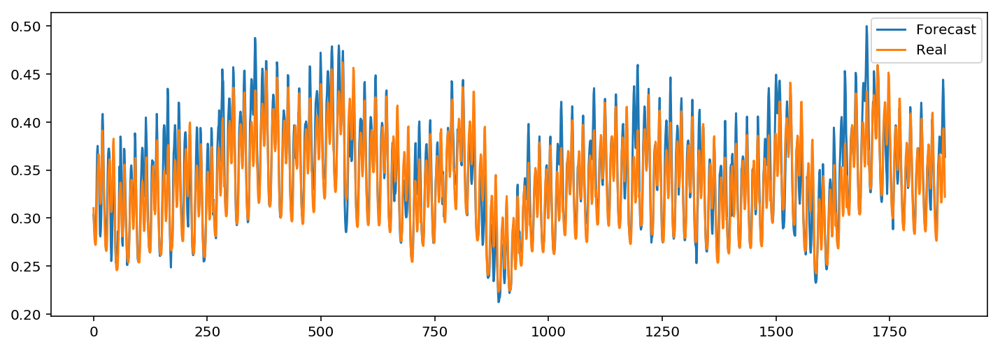

In [55]:
UsedInputsTemp= np.empty([10])
FinalErrorTemp= np.empty([2])
Parameters = np.empty([4])
ID= np.empty([1])
ID[0]=Model_ID


UsedInputsTemp[0] = previoushour = True
UsedInputsTemp[1] = timeSteps = 12
UsedInputsTemp[2] = previousDay = True
UsedInputsTemp[3] = previousWeek = True
UsedInputsTemp[4] = Temp = False
UsedInputsTemp[5] = TempMax = False
UsedInputsTemp[6] = TempMin = False
UsedInputsTemp[7] = dayIndicator = False
UsedInputsTemp[8] = HourIndicator = True
UsedInputsTemp[9] = MonthIndicator = False

shift = False

learninginputs, learningoutputs, testinputs, testoutputs, nbrInputs = prepareInputs(daydata,season,UsedInputsTemp,testPeriod)
#learning vectors
inputx1 = np.array(pd.DataFrame(learninginputs.copy())).reshape(-1,nbrInputs)
outputx1 = np.array(pd.DataFrame(learningoutputs.copy()))

#test vectors
inputx2 = np.array(pd.DataFrame(testinputs.copy())).reshape(-1,nbrInputs)
outputx2 = np.array(pd.DataFrame(testoutputs.copy()))

Parameters[0]= HiddenNeurons1 = 20
Parameters[1]= HiddenNeurons2 = 10
Parameters[2]= LearningRate = 0.002

tempMLPmodels, tempErrorHistory,MLP_Model = create_Train_MLP_NN_Model(inputx1,outputx1,inputx2,outputx2,inputx1.shape[1],HiddenNeurons1=HiddenNeurons1,HiddenNeurons2=HiddenNeurons2
                                      ,Epoch=Epoch,LearningRate = LearningRate,Optimizer='Adam')

Parameters[3]= tempErrorHistory.argmin()

MLP_Model.save('Models/lstm_%d_%s_%s'%(Model_ID,season,today))
# MLP_Model = load_model('Models/lstm_%d_%s_%s'%(Model_ID,season,today))

clear_output()
print('==================================================================================')
print('\t \t test num : %s' %Model_ID )
print('==================================================================================')


LearningMAPE, testMAPE , LearningHourlyMAPE, LearningDailyForecast, LearningHourlyForecast  = getForecastingResults(
    tempMLPmodels, tempErrorHistory,learninginputs,learningoutputs,testinputs,testoutputs,MLP_Model,nbrInputs,shift,previoushour,season,timeSteps)
FinalErrorTemp[0] = LearningMAPE
FinalErrorTemp[1] = testMAPE

UsedInputList.append(UsedInputsTemp)
MAPErrorList.append(FinalErrorTemp)
ModelsList.append(MLP_Model)
ForecastingList.append(LearningDailyForecast)
Models_IDs.append(ID)
Models_parameters.append(Parameters)

print('==================================================================================')
print('\t \t Forecasting a sample from Learning dataset')
print('==================================================================================')
plt.figure(figsize=(12,4))
ForecastingList[Model_ID].index= range(ForecastingList[Model_ID].index.size)
plt.plot(ForecastingList[Model_ID].iloc[:,0],label='Forecast')
plt.plot(ForecastingList[Model_ID].iloc[:,1],label='Real')
plt.legend( loc=1, borderaxespad=0.4)
plt.show()

Model_ID = Model_ID + 1

	 	 test num : 36
	 	 learning subset results
Hourly Learning mean absolute percentage error of 1872 hours : 2.0395557929 
Daily Learning mean absolute percentage error of 78 days : 6.84820412978 
	 	 MAPError plot through Learning DataSet 


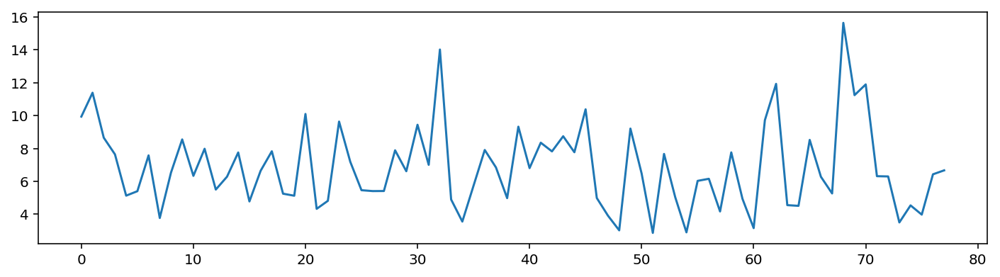

	 	 Test subset results
Test mean absolute percentage error per hour: 1.649177
Test mean absolute percentage error per day: 7.560090 
	 	 Validation Forecasting visualisation


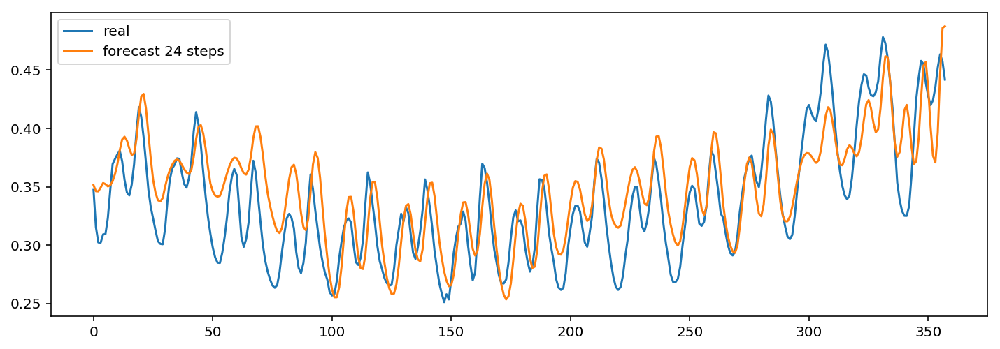

	 	 Forecasting a sample from Learning dataset


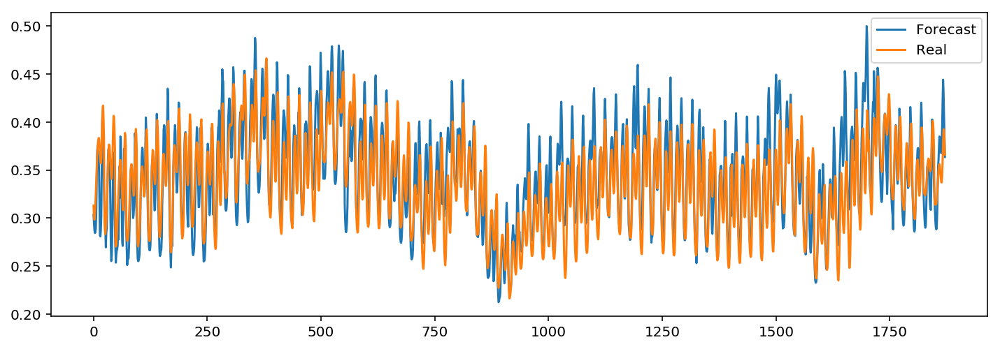

In [58]:
UsedInputsTemp= np.empty([10])
FinalErrorTemp= np.empty([2])
Parameters = np.empty([4])
ID= np.empty([1])
ID[0]=Model_ID


UsedInputsTemp[0] = previoushour = True
UsedInputsTemp[1] = timeSteps = 12
UsedInputsTemp[2] = previousDay = True
UsedInputsTemp[3] = previousWeek = True
UsedInputsTemp[4] = Temp = False
UsedInputsTemp[5] = TempMax = False
UsedInputsTemp[6] = TempMin = False
UsedInputsTemp[7] = dayIndicator = False
UsedInputsTemp[8] = HourIndicator = False
UsedInputsTemp[9] = MonthIndicator = True

shift = False

learninginputs, learningoutputs, testinputs, testoutputs, nbrInputs = prepareInputs(daydata,season,UsedInputsTemp,testPeriod)
#learning vectors
inputx1 = np.array(pd.DataFrame(learninginputs.copy())).reshape(-1,nbrInputs)
outputx1 = np.array(pd.DataFrame(learningoutputs.copy()))

#test vectors
inputx2 = np.array(pd.DataFrame(testinputs.copy())).reshape(-1,nbrInputs)
outputx2 = np.array(pd.DataFrame(testoutputs.copy()))

Parameters[0]= HiddenNeurons1 = 20
Parameters[1]= HiddenNeurons2 = 10
Parameters[2]= LearningRate = 0.002

tempMLPmodels, tempErrorHistory,MLP_Model = create_Train_MLP_NN_Model(inputx1,outputx1,inputx2,outputx2,inputx1.shape[1],HiddenNeurons1=HiddenNeurons1,HiddenNeurons2=HiddenNeurons2
                                      ,Epoch=Epoch,LearningRate = LearningRate,Optimizer='Adam')

Parameters[3]= tempErrorHistory.argmin()

MLP_Model.save('Models/lstm_%d_%s_%s'%(Model_ID,season,today))
# MLP_Model = load_model('Models/lstm_%d_%s_%s'%(Model_ID,season,today))

clear_output()
print('==================================================================================')
print('\t \t test num : %s' %Model_ID )
print('==================================================================================')


LearningMAPE, testMAPE , LearningHourlyMAPE, LearningDailyForecast, LearningHourlyForecast  = getForecastingResults(
    tempMLPmodels, tempErrorHistory,learninginputs,learningoutputs,testinputs,testoutputs,MLP_Model,nbrInputs,shift,previoushour,season,timeSteps)
FinalErrorTemp[0] = LearningMAPE
FinalErrorTemp[1] = testMAPE

UsedInputList.append(UsedInputsTemp)
MAPErrorList.append(FinalErrorTemp)
ModelsList.append(MLP_Model)
ForecastingList.append(LearningDailyForecast)
Models_IDs.append(ID)
Models_parameters.append(Parameters)

print('==================================================================================')
print('\t \t Forecasting a sample from Learning dataset')
print('==================================================================================')
plt.figure(figsize=(12,4))
ForecastingList[Model_ID].index= range(ForecastingList[Model_ID].index.size)
plt.plot(ForecastingList[Model_ID].iloc[:,0],label='Forecast')
plt.plot(ForecastingList[Model_ID].iloc[:,1],label='Real')
plt.legend( loc=1, borderaxespad=0.4)
plt.show()

Model_ID = Model_ID + 1

	 	 test num : 37
	 	 learning subset results
Hourly Learning mean absolute percentage error of 1872 hours : 2.37186073008 
Daily Learning mean absolute percentage error of 78 days : 5.79623483389 
	 	 MAPError plot through Learning DataSet 


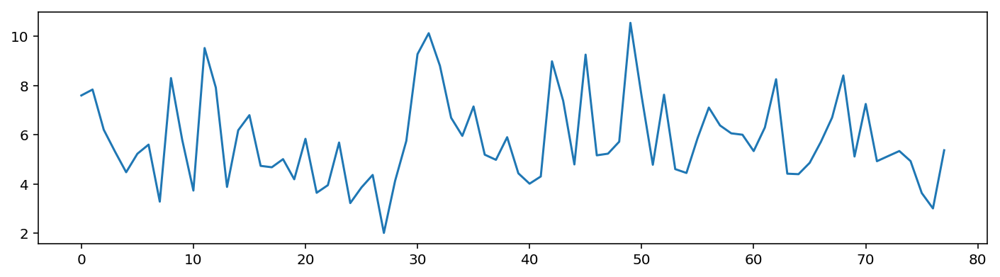

	 	 Test subset results
Test mean absolute percentage error per hour: 1.682496
Test mean absolute percentage error per day: 4.388564 
	 	 Validation Forecasting visualisation


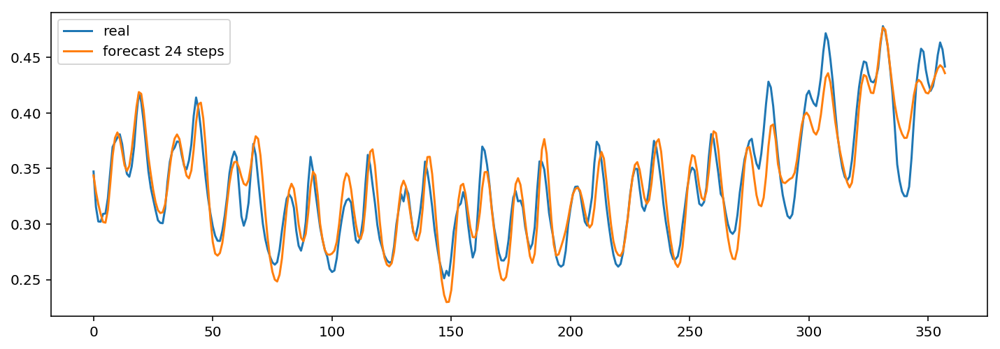

	 	 Forecasting a sample from Learning dataset


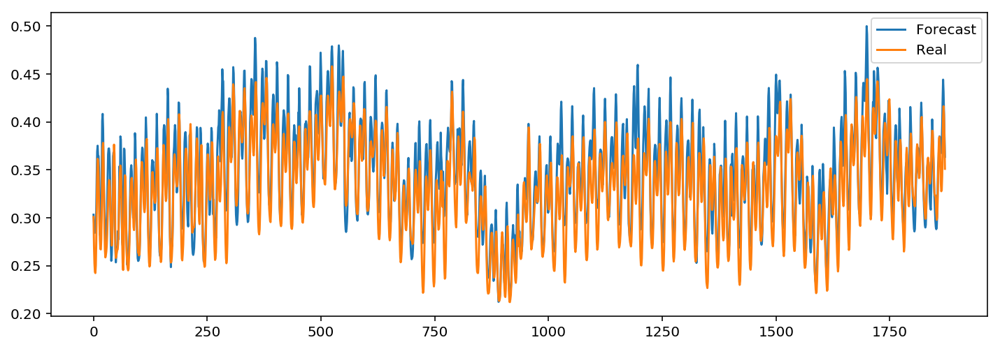

In [59]:
UsedInputsTemp= np.empty([10])
FinalErrorTemp= np.empty([2])
Parameters = np.empty([4])
ID= np.empty([1])
ID[0]=Model_ID


UsedInputsTemp[0] = previoushour = True
UsedInputsTemp[1] = timeSteps = 12
UsedInputsTemp[2] = previousDay = True
UsedInputsTemp[3] = previousWeek = True
UsedInputsTemp[4] = Temp = True
UsedInputsTemp[5] = TempMax = True
UsedInputsTemp[6] = TempMin = True
UsedInputsTemp[7] = dayIndicator = True
UsedInputsTemp[8] = HourIndicator = False
UsedInputsTemp[9] = MonthIndicator = False

shift = False

learninginputs, learningoutputs, testinputs, testoutputs, nbrInputs = prepareInputs(daydata,season,UsedInputsTemp,testPeriod)
#learning vectors
inputx1 = np.array(pd.DataFrame(learninginputs.copy())).reshape(-1,nbrInputs)
outputx1 = np.array(pd.DataFrame(learningoutputs.copy()))

#test vectors
inputx2 = np.array(pd.DataFrame(testinputs.copy())).reshape(-1,nbrInputs)
outputx2 = np.array(pd.DataFrame(testoutputs.copy()))

Parameters[0]= HiddenNeurons1 = 20
Parameters[1]= HiddenNeurons2 = 10
Parameters[2]= LearningRate = 0.002

tempMLPmodels, tempErrorHistory,MLP_Model = create_Train_MLP_NN_Model(inputx1,outputx1,inputx2,outputx2,inputx1.shape[1],HiddenNeurons1=HiddenNeurons1,HiddenNeurons2=HiddenNeurons2
                                      ,Epoch=Epoch,LearningRate = LearningRate,Optimizer='Adam')

Parameters[3]= tempErrorHistory.argmin()

MLP_Model.save('Models/lstm_%d_%s_%s'%(Model_ID,season,today))
# MLP_Model = load_model('Models/lstm_%d_%s_%s'%(Model_ID,season,today))

clear_output()
print('==================================================================================')
print('\t \t test num : %s' %Model_ID )
print('==================================================================================')


LearningMAPE, testMAPE , LearningHourlyMAPE, LearningDailyForecast, LearningHourlyForecast  = getForecastingResults(
    tempMLPmodels, tempErrorHistory,learninginputs,learningoutputs,testinputs,testoutputs,MLP_Model,nbrInputs,shift,previoushour,season,timeSteps)
FinalErrorTemp[0] = LearningMAPE
FinalErrorTemp[1] = testMAPE

UsedInputList.append(UsedInputsTemp)
MAPErrorList.append(FinalErrorTemp)
ModelsList.append(MLP_Model)
ForecastingList.append(LearningDailyForecast)
Models_IDs.append(ID)
Models_parameters.append(Parameters)

print('==================================================================================')
print('\t \t Forecasting a sample from Learning dataset')
print('==================================================================================')
plt.figure(figsize=(12,4))
ForecastingList[Model_ID].index= range(ForecastingList[Model_ID].index.size)
plt.plot(ForecastingList[Model_ID].iloc[:,0],label='Forecast')
plt.plot(ForecastingList[Model_ID].iloc[:,1],label='Real')
plt.legend( loc=1, borderaxespad=0.4)
plt.show()

Model_ID = Model_ID + 1

	 	 test num : 38
	 	 learning subset results
Hourly Learning mean absolute percentage error of 1872 hours : 1.43018529238 
Daily Learning mean absolute percentage error of 78 days : 3.65408434929 
	 	 MAPError plot through Learning DataSet 


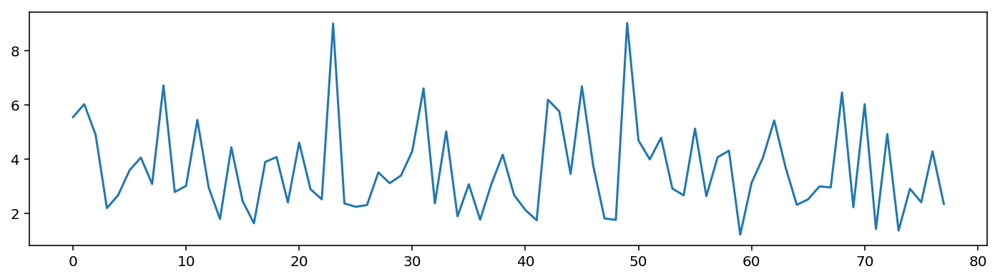

	 	 Test subset results
Test mean absolute percentage error per hour: 1.343629
Test mean absolute percentage error per day: 4.696764 
	 	 Validation Forecasting visualisation


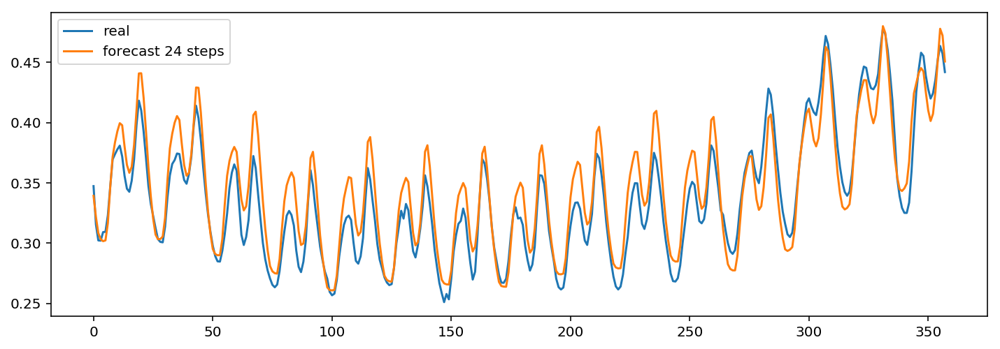

	 	 Forecasting a sample from Learning dataset


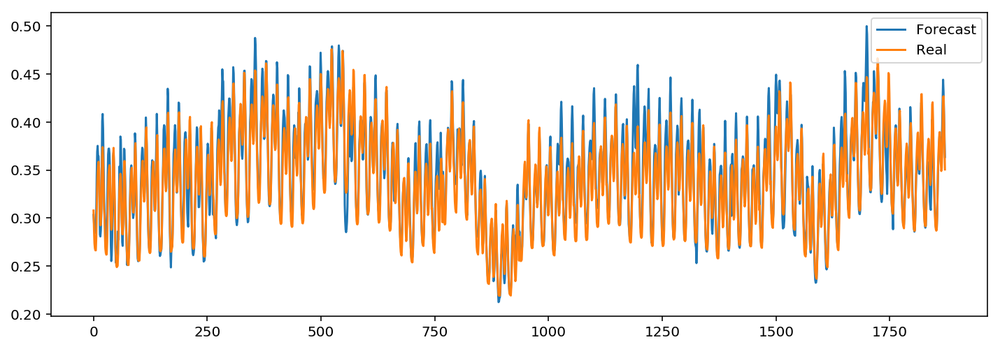

In [60]:
UsedInputsTemp= np.empty([10])
FinalErrorTemp= np.empty([2])
Parameters = np.empty([4])
ID= np.empty([1])
ID[0]=Model_ID


UsedInputsTemp[0] = previoushour = True
UsedInputsTemp[1] = timeSteps = 12
UsedInputsTemp[2] = previousDay = True
UsedInputsTemp[3] = previousWeek = True
UsedInputsTemp[4] = Temp = True
UsedInputsTemp[5] = TempMax = True
UsedInputsTemp[6] = TempMin = True
UsedInputsTemp[7] = dayIndicator = False
UsedInputsTemp[8] = HourIndicator = True
UsedInputsTemp[9] = MonthIndicator = False

shift = False

learninginputs, learningoutputs, testinputs, testoutputs, nbrInputs = prepareInputs(daydata,season,UsedInputsTemp,testPeriod)
#learning vectors
inputx1 = np.array(pd.DataFrame(learninginputs.copy())).reshape(-1,nbrInputs)
outputx1 = np.array(pd.DataFrame(learningoutputs.copy()))

#test vectors
inputx2 = np.array(pd.DataFrame(testinputs.copy())).reshape(-1,nbrInputs)
outputx2 = np.array(pd.DataFrame(testoutputs.copy()))

Parameters[0]= HiddenNeurons1 = 20
Parameters[1]= HiddenNeurons2 = 10
Parameters[2]= LearningRate = 0.002

tempMLPmodels, tempErrorHistory,MLP_Model = create_Train_MLP_NN_Model(inputx1,outputx1,inputx2,outputx2,inputx1.shape[1],HiddenNeurons1=HiddenNeurons1,HiddenNeurons2=HiddenNeurons2
                                      ,Epoch=Epoch,LearningRate = LearningRate,Optimizer='Adam')

Parameters[3]= tempErrorHistory.argmin()

MLP_Model.save('Models/lstm_%d_%s_%s'%(Model_ID,season,today))
# MLP_Model = load_model('Models/lstm_%d_%s_%s'%(Model_ID,season,today))

clear_output()
print('==================================================================================')
print('\t \t test num : %s' %Model_ID )
print('==================================================================================')


LearningMAPE, testMAPE , LearningHourlyMAPE, LearningDailyForecast, LearningHourlyForecast  = getForecastingResults(
    tempMLPmodels, tempErrorHistory,learninginputs,learningoutputs,testinputs,testoutputs,MLP_Model,nbrInputs,shift,previoushour,season,timeSteps)
FinalErrorTemp[0] = LearningMAPE
FinalErrorTemp[1] = testMAPE

UsedInputList.append(UsedInputsTemp)
MAPErrorList.append(FinalErrorTemp)
ModelsList.append(MLP_Model)
ForecastingList.append(LearningDailyForecast)
Models_IDs.append(ID)
Models_parameters.append(Parameters)

print('==================================================================================')
print('\t \t Forecasting a sample from Learning dataset')
print('==================================================================================')
plt.figure(figsize=(12,4))
ForecastingList[Model_ID].index= range(ForecastingList[Model_ID].index.size)
plt.plot(ForecastingList[Model_ID].iloc[:,0],label='Forecast')
plt.plot(ForecastingList[Model_ID].iloc[:,1],label='Real')
plt.legend( loc=1, borderaxespad=0.4)
plt.show()

Model_ID = Model_ID + 1

	 	 test num : 39
	 	 learning subset results
Hourly Learning mean absolute percentage error of 1872 hours : 1.319735096 
Daily Learning mean absolute percentage error of 78 days : 3.21226930618 
	 	 MAPError plot through Learning DataSet 


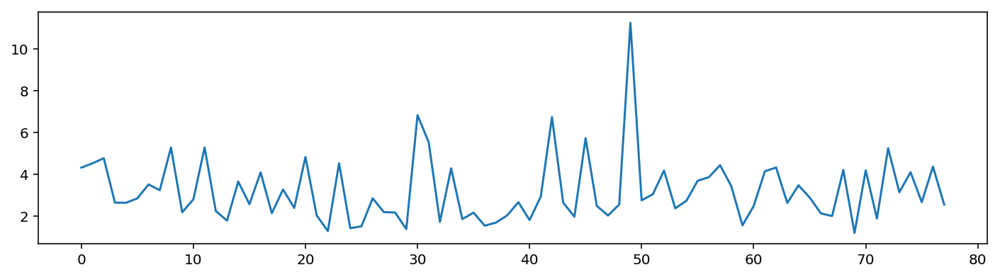

	 	 Test subset results
Test mean absolute percentage error per hour: 1.458417
Test mean absolute percentage error per day: 3.948391 
	 	 Validation Forecasting visualisation


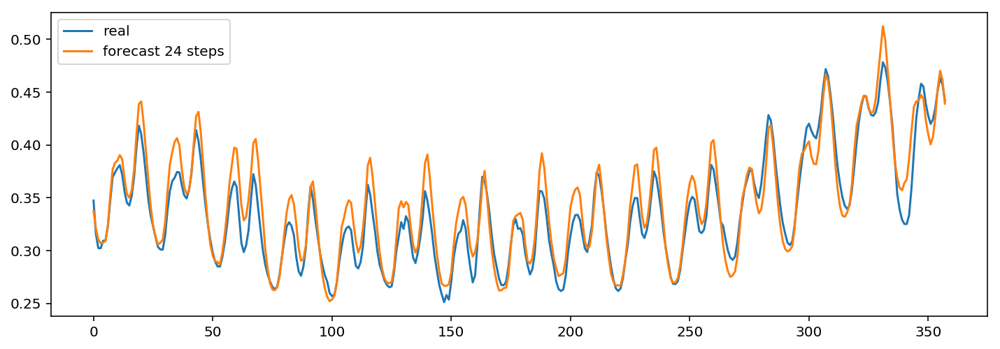

	 	 Forecasting a sample from Learning dataset


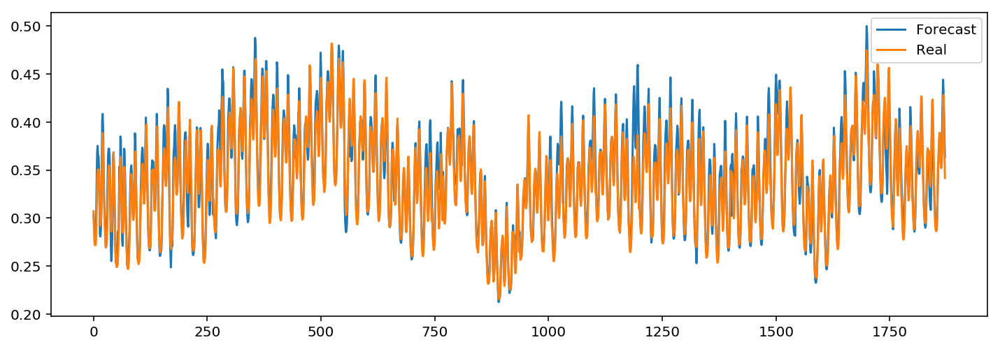

In [61]:
UsedInputsTemp= np.empty([10])
FinalErrorTemp= np.empty([2])
Parameters = np.empty([4])
ID= np.empty([1])
ID[0]=Model_ID


UsedInputsTemp[0] = previoushour = True
UsedInputsTemp[1] = timeSteps = 12
UsedInputsTemp[2] = previousDay = True
UsedInputsTemp[3] = previousWeek = True
UsedInputsTemp[4] = Temp = True
UsedInputsTemp[5] = TempMax = True
UsedInputsTemp[6] = TempMin = True
UsedInputsTemp[7] = dayIndicator = True
UsedInputsTemp[8] = HourIndicator = True
UsedInputsTemp[9] = MonthIndicator = False

shift = False

learninginputs, learningoutputs, testinputs, testoutputs, nbrInputs = prepareInputs(daydata,season,UsedInputsTemp,testPeriod)
#learning vectors
inputx1 = np.array(pd.DataFrame(learninginputs.copy())).reshape(-1,nbrInputs)
outputx1 = np.array(pd.DataFrame(learningoutputs.copy()))

#test vectors
inputx2 = np.array(pd.DataFrame(testinputs.copy())).reshape(-1,nbrInputs)
outputx2 = np.array(pd.DataFrame(testoutputs.copy()))

Parameters[0]= HiddenNeurons1 = 20
Parameters[1]= HiddenNeurons2 = 10
Parameters[2]= LearningRate = 0.002

tempMLPmodels, tempErrorHistory,MLP_Model = create_Train_MLP_NN_Model(inputx1,outputx1,inputx2,outputx2,inputx1.shape[1],HiddenNeurons1=HiddenNeurons1,HiddenNeurons2=HiddenNeurons2
                                      ,Epoch=Epoch,LearningRate = LearningRate,Optimizer='Adam')

Parameters[3]= tempErrorHistory.argmin()

MLP_Model.save('Models/lstm_%d_%s_%s'%(Model_ID,season,today))
# MLP_Model = load_model('Models/lstm_%d_%s_%s'%(Model_ID,season,today))

clear_output()
print('==================================================================================')
print('\t \t test num : %s' %Model_ID )
print('==================================================================================')


LearningMAPE, testMAPE , LearningHourlyMAPE, LearningDailyForecast, LearningHourlyForecast  = getForecastingResults(
    tempMLPmodels, tempErrorHistory,learninginputs,learningoutputs,testinputs,testoutputs,MLP_Model,nbrInputs,shift,previoushour,season,timeSteps)
FinalErrorTemp[0] = LearningMAPE
FinalErrorTemp[1] = testMAPE

UsedInputList.append(UsedInputsTemp)
MAPErrorList.append(FinalErrorTemp)
ModelsList.append(MLP_Model)
ForecastingList.append(LearningDailyForecast)
Models_IDs.append(ID)
Models_parameters.append(Parameters)

print('==================================================================================')
print('\t \t Forecasting a sample from Learning dataset')
print('==================================================================================')
plt.figure(figsize=(12,4))
ForecastingList[Model_ID].index= range(ForecastingList[Model_ID].index.size)
plt.plot(ForecastingList[Model_ID].iloc[:,0],label='Forecast')
plt.plot(ForecastingList[Model_ID].iloc[:,1],label='Real')
plt.legend( loc=1, borderaxespad=0.4)
plt.show()

Model_ID = Model_ID + 1

	 	 test num : 40
	 	 learning subset results
Hourly Learning mean absolute percentage error of 1872 hours : 0.944993102602 
Daily Learning mean absolute percentage error of 78 days : 2.13930485646 
	 	 MAPError plot through Learning DataSet 


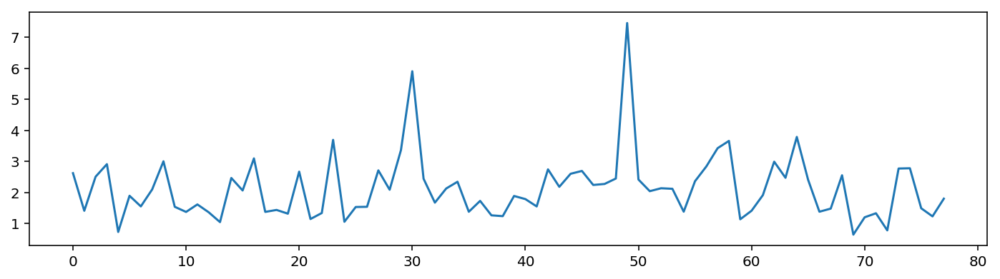

	 	 Test subset results
Test mean absolute percentage error per hour: 1.843918
Test mean absolute percentage error per day: 4.580689 
	 	 Validation Forecasting visualisation


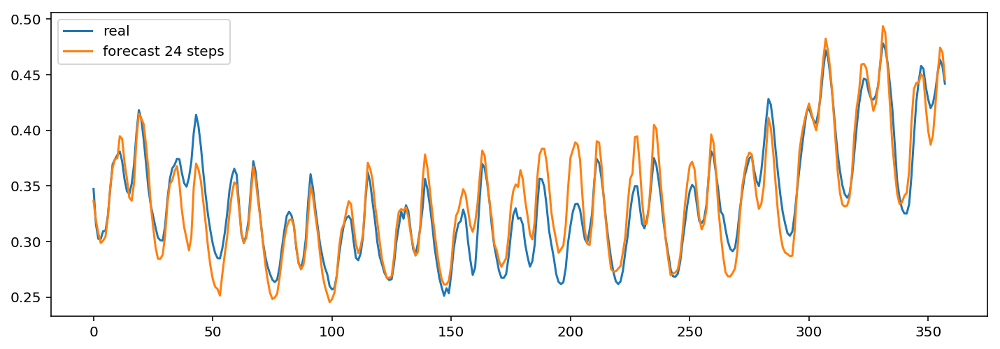

	 	 Forecasting a sample from Learning dataset


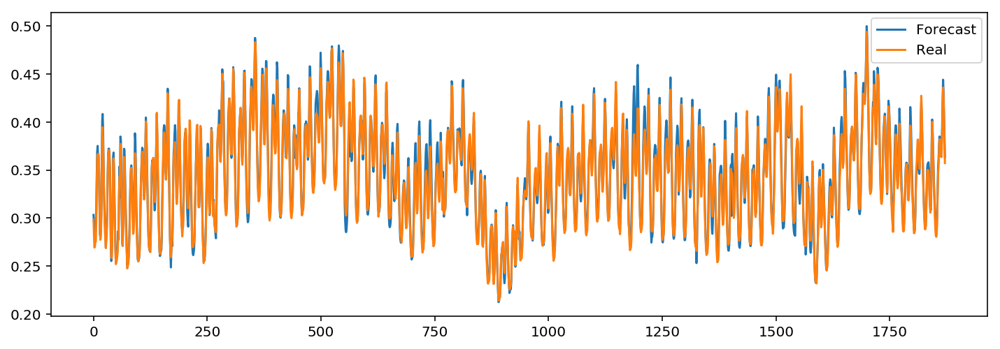

In [62]:
UsedInputsTemp= np.empty([10])
FinalErrorTemp= np.empty([2])
Parameters = np.empty([4])
ID= np.empty([1])
ID[0]=Model_ID


UsedInputsTemp[0] = previoushour = True
UsedInputsTemp[1] = timeSteps = 12
UsedInputsTemp[2] = previousDay = True
UsedInputsTemp[3] = previousWeek = True
UsedInputsTemp[4] = Temp = True
UsedInputsTemp[5] = TempMax = True
UsedInputsTemp[6] = TempMin = True
UsedInputsTemp[7] = dayIndicator = True
UsedInputsTemp[8] = HourIndicator = True
UsedInputsTemp[9] = MonthIndicator = True

shift = False

learninginputs, learningoutputs, testinputs, testoutputs, nbrInputs = prepareInputs(daydata,season,UsedInputsTemp,testPeriod)
#learning vectors
inputx1 = np.array(pd.DataFrame(learninginputs.copy())).reshape(-1,nbrInputs)
outputx1 = np.array(pd.DataFrame(learningoutputs.copy()))

#test vectors
inputx2 = np.array(pd.DataFrame(testinputs.copy())).reshape(-1,nbrInputs)
outputx2 = np.array(pd.DataFrame(testoutputs.copy()))

Parameters[0]= HiddenNeurons1 = 20
Parameters[1]= HiddenNeurons2 = 10
Parameters[2]= LearningRate = 0.002

tempMLPmodels, tempErrorHistory,MLP_Model = create_Train_MLP_NN_Model(inputx1,outputx1,inputx2,outputx2,inputx1.shape[1],HiddenNeurons1=HiddenNeurons1,HiddenNeurons2=HiddenNeurons2
                                      ,Epoch=Epoch,LearningRate = LearningRate,Optimizer='Adam')

Parameters[3]= tempErrorHistory.argmin()

MLP_Model.save('Models/lstm_%d_%s_%s'%(Model_ID,season,today))
# MLP_Model = load_model('Models/lstm_%d_%s_%s'%(Model_ID,season,today))

clear_output()
print('==================================================================================')
print('\t \t test num : %s' %Model_ID )
print('==================================================================================')


LearningMAPE, testMAPE , LearningHourlyMAPE, LearningDailyForecast, LearningHourlyForecast  = getForecastingResults(
    tempMLPmodels, tempErrorHistory,learninginputs,learningoutputs,testinputs,testoutputs,MLP_Model,nbrInputs,shift,previoushour,season,timeSteps)
FinalErrorTemp[0] = LearningMAPE
FinalErrorTemp[1] = testMAPE

UsedInputList.append(UsedInputsTemp)
MAPErrorList.append(FinalErrorTemp)
ModelsList.append(MLP_Model)
ForecastingList.append(LearningDailyForecast)
Models_IDs.append(ID)
Models_parameters.append(Parameters)

print('==================================================================================')
print('\t \t Forecasting a sample from Learning dataset')
print('==================================================================================')
plt.figure(figsize=(12,4))
ForecastingList[Model_ID].index= range(ForecastingList[Model_ID].index.size)
plt.plot(ForecastingList[Model_ID].iloc[:,0],label='Forecast')
plt.plot(ForecastingList[Model_ID].iloc[:,1],label='Real')
plt.legend( loc=1, borderaxespad=0.4)
plt.show()

Model_ID = Model_ID + 1

In [63]:
UsedInputs = np.array(UsedInputList[33:])

FinalError = np.array(MAPErrorList[33:])

summary = pd.DataFrame(np.concatenate((Models_IDs[33:],Models_parameters[33:],UsedInputs,FinalError),axis=1),columns=
                       ['Model ID','Neurons L1','Neurons L2','Learning rate','Epochs','Previous hour','Time steps','Previous day'
                        ,'Previous week','Temperature','Temp Max','Temp Min','Day indicator','Hour indicator','Month indicator','Training MAPE %',
                        'Test MAPE %'])

summary

,Model ID,Neurons L1,Neurons L2,Learning rate,Epochs,Previous hour,Time steps,Previous day,Previous week,Temperature,Temp Max,Temp Min,Day indicator,Hour indicator,Month indicator,Training MAPE %,Test MAPE %
0,33.0,20.0,10.0,0.002,982.0,1.0,12.0,1.0,1.0,1.0,1.0,1.0,0.0,0.0,0.0,6.027207,5.096891
1,34.0,20.0,10.0,0.002,949.0,1.0,12.0,1.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,6.226676,6.987802
2,35.0,20.0,10.0,0.002,873.0,1.0,12.0,1.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,4.602530,10.624811
3,36.0,20.0,10.0,0.002,994.0,1.0,12.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,6.848204,7.560090
4,37.0,20.0,10.0,0.002,873.0,1.0,12.0,1.0,1.0,1.0,1.0,1.0,1.0,0.0,0.0,5.796235,4.388564
5,38.0,20.0,10.0,0.002,967.0,1.0,12.0,1.0,1.0,1.0,1.0,1.0,0.0,1.0,0.0,3.654084,4.696764
6,39.0,20.0,10.0,0.002,899.0,1.0,12.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.0,3.212269,3.948391
7,40.0,20.0,10.0,0.002,983.0,1.0,12.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,2.139305,4.580689


In [94]:
UsedInputs = np.array(UsedInputList[:17])

FinalError = np.array(MAPErrorList[:17])

summary = pd.DataFrame(np.concatenate((Models_IDs[:17],Models_parameters[:17],UsedInputs,FinalError),axis=1),columns=
                       ['Model ID','Neurons L1','Neurons L2','Learning rate','Epochs','Previous hour','Time steps','Previous day'
                        ,'Previous week','Temperature','Temp Max','Temp Min','Day indicator','Hour indicator','Training MAPE %',
                        'Test MAPE %'])

summary

,Model ID,Neurons L1,Neurons L2,Learning rate,Epochs,Previous hour,Time steps,Previous day,Previous week,Temperature,Temp Max,Temp Min,Day indicator,Hour indicator,Training MAPE %,Test MAPE %
0,0.0,20.0,10.0,0.001,2574.0,1.0,24.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,4.085393,3.576533
1,1.0,20.0,10.0,0.001,2419.0,1.0,12.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,3.520566,3.594924
2,2.0,20.0,10.0,0.001,2175.0,1.0,12.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,3.082597,4.263560
3,3.0,20.0,10.0,0.001,2691.0,1.0,6.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,4.486152,3.269316
4,4.0,20.0,10.0,0.001,1606.0,1.0,3.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,4.042950,3.386997
5,5.0,20.0,10.0,0.001,805.0,1.0,12.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,3.801552,3.532179
6,6.0,60.0,30.0,0.001,786.0,1.0,12.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,3.822085,3.980042
7,7.0,50.0,10.0,0.001,492.0,1.0,12.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,3.266894,4.578066
8,8.0,80.0,50.0,0.001,314.0,1.0,12.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,3.364827,3.901970
9,9.0,90.0,30.0,0.002,376.0,1.0,12.0,1.0,1.0,1.0,1.0,1.0,0.0,1.0,4.039233,4.239113


In [22]:
def prepareInputs(daydata, season, UsedInputs,testPeriod):
    nbrInputs= 0
    
    previousHours = UsedInputs[0]
    timeSteps = int(UsedInputs[1])
    previousDay = UsedInputs[2]
    previousWeek = UsedInputs[3]
    temp = UsedInputs[4]
    tempMax = UsedInputs[5]
    tempMin = UsedInputs[6]
    dayIndicator = UsedInputs[7]
    HourIndicator= UsedInputs[8]
    print timeSteps
    if previousHours == True: 
        nbrInputs = nbrInputs + int(timeSteps)
    if previousDay == True: nbrInputs= nbrInputs+1
    if previousWeek == True : nbrInputs= nbrInputs+ 1
    if temp == True: nbrInputs= nbrInputs+1
    if tempMax == True: nbrInputs= nbrInputs+1
    if tempMin == True: nbrInputs= nbrInputs+1
    if dayIndicator== True: nbrInputs= nbrInputs+7
    if HourIndicator== True : nbrInputs= nbrInputs+24
    
    hourclusters= np.empty([(daydata.index.size*24),1])

    hourdataindex= pd.DataFrame(index=pd.date_range('2014-1-8 00:00:00', periods=(365)*24, freq='H'))

    for x in range(0,daydata.index.size):
        for y in range(0,24):
            hourclusters[(x * 24) + y,0] = daydata.iloc[x,24]
    hourclusters.size

    tempAlgiers=  pd.read_csv('../data/tempAlgiers.csv')
    tempA= tempAlgiers.loc[:,'Hour_1':'Hour_24']
    tempnp= np.array(tempA)
    tempnp= tempnp.reshape(-1,1)
    tempdata= pd.DataFrame(tempnp)

    tempmax= tempAlgiers.loc[:,'Tmax']
    tempmin= tempAlgiers.loc[:,'Tmin']




    tempmx= np.random.random([tempmax.size*24,1])
    tempmn= np.random.random([tempmin.size*24,1])



    for x in range(0,tempmax.size):
        for y in range(0,24):
            tempmx[(x * 24) + y,0] = tempmax.iloc[x]

    for x in range(0,tempmin.size):
        for y in range(0,24):
            tempmn[(x * 24) + y,0] = tempmin.iloc[x]
        

    samples = daydata.index.size*24
    daydata2= daydata.copy()
    del(daydata2['cluster'])

    data= pd.DataFrame(np.array(daydata2).reshape(-1,1))

    maxcons= data.values.max()
    mincons= data.values.min()

    maxtemp= np.max(tempdata.values)
    mintemp= tempdata.values.min()

    maxtempmax= np.max(tempmx)
    mintempmax= np.min(tempmx)

    maxtempmin= np.max(tempmn)
    mintempmin= np.min(tempmn)

    sigxx= np.empty((samples - 168 , nbrInputs))
    sigyy= np.empty((samples - 168 , 1))

    i= 0
    for x in list(range(168,samples)):
        i=0
        if previousHours == True: 
            for y in list(range(timeSteps)):
                sigxx[x - 168 , i] = (data.iloc[x - i - 1 , 0])/(2*maxcons)
                i= i + 1
        if previousDay == True: 
            sigxx[x - 168 , i] = (data.iloc[x - 24 , 0])/(2*maxcons)
            i= i+1
        if previousWeek == True : 
            sigxx[x - 168 , i] = (data.iloc[x - 168 , 0])/(2*maxcons)
            i= i+ 1
        if temp == True: 
            sigxx[x - 168 , i] = (tempdata.iloc[x])/(2*maxtemp)
            i= i+1
        if tempMax == True: 
            sigxx[x - 168 , i] = (tempmx[x]) / (2 * maxtempmax)
            i= i+1
        if tempMin == True: 
            sigxx[x - 168 , i] = (tempmn[x]) / (2 * maxtempmin)
            i= i+1
        if dayIndicator == True:
            ind=0
            for y in range(0,7):
                sigxx[x - 168 , i + ind] = 0
                ind = ind + 1
            sigxx[x - 168 , i + pd.datetime.weekday(hourdataindex.index[x])]=1
            i = i + 7
        if HourIndicator == True:
            ind=0
            for y in range(0,24):
                sigxx[x - 168 , i+ind]= 0
                ind = ind + 1
            sigxx[x - 168 , i + hourdataindex.index[x].hour]=1
        
    
    for x in list(range(168,samples)):
        sigyy[x - 168 , 0]= (data.iloc[x , 0])/(2*maxcons)

    sigmoidxx= df(sigxx.copy())
    sigmoidyy= df(sigyy.copy())

    sigmoidxx.index= pd.date_range('2014-1-8 00:00:00', periods=(365-7)*24, freq='H')
    sigmoidyy.index= pd.date_range('2014-1-8 00:00:00', periods=(365-7)*24, freq='H')

    sigmoidxx['cluster'] = hourclusters[168:]
    sigmoidyy['cluster'] = hourclusters[168:]
    dfhourclusters = df(hourclusters)
    
    SigmoidInputs =sigmoidxx[sigmoidxx.cluster==season].copy()
    
    SigmoidOutputs= sigmoidyy[sigmoidyy.cluster==SigmoidInputs.loc[SigmoidInputs.index[0],'cluster']]
    del(SigmoidInputs['cluster'],SigmoidOutputs['cluster'])
    
    learninginputs = pd.DataFrame(columns=SigmoidInputs.columns)
    learningoutputs = pd.DataFrame(columns=SigmoidOutputs.columns)           
    testinputs = pd.DataFrame(columns=SigmoidInputs.columns)
    testoutputs = pd.DataFrame(columns=SigmoidOutputs.columns)
    y=0

    learninginputs=learninginputs.append(SigmoidInputs.iloc[: 48])
    learningoutputs=learningoutputs.append(SigmoidOutputs.iloc[: 48])
    z=0
    for x in range(testPeriod/24):
        
        
        testinputs=testinputs.append(SigmoidInputs.iloc[ 48  + y : 48 + 24 + y])
        testoutputs=testoutputs.append(SigmoidOutputs.iloc[ 48  + y : 48 + 24 + y])
        z= 48 + 24 + y
        learninginputs=learninginputs.append(SigmoidInputs.iloc[z: z + 72])
        learningoutputs=learningoutputs.append(SigmoidOutputs.iloc[z: z + 72])

        y= y + 120
        
    learninginputs=learninginputs.append(SigmoidInputs.iloc[z-120: SigmoidInputs.size])
    learningoutputs=learningoutputs.append(SigmoidOutputs.iloc[z-120: SigmoidInputs.size])

    
#     learningoutputs = pd.DataFrame(SigmoidOutputs.iloc[:int(SigmoidOutputs.size-testPeriod)].values.copy(),
#                             index=SigmoidOutputs.iloc[:int(SigmoidOutputs.size-testPeriod)].index)
#     testoutputs = pd.DataFrame(SigmoidOutputs.iloc[int(SigmoidOutputs.size-testPeriod):].values.copy(),
#                             index=SigmoidOutputs.iloc[int(SigmoidOutputs.size-testPeriod):].index)

#     learninginputs = pd.DataFrame(SigmoidInputs.iloc[:int(SigmoidOutputs.size-testPeriod)].values.copy(),
#                             index=SigmoidOutputs.iloc[:int(SigmoidOutputs.size-testPeriod)].index)
#     testinputs = pd.DataFrame(SigmoidInputs.iloc[int(SigmoidOutputs.size-testPeriod):].values.copy(),
#                             index=SigmoidOutputs.iloc[int(SigmoidOutputs.size-testPeriod):].index)

    print('-------Input preparation process complet-------')
    return learninginputs, learningoutputs, testinputs, testoutputs, nbrInputs

	 	 test num : 41
	 	 learning subset results
Hourly Learning mean absolute percentage error of 1728 hours : 1.25499420322 
Daily Learning mean absolute percentage error of 72 days : 3.19829765293 
	 	 MAPError plot through Learning DataSet 


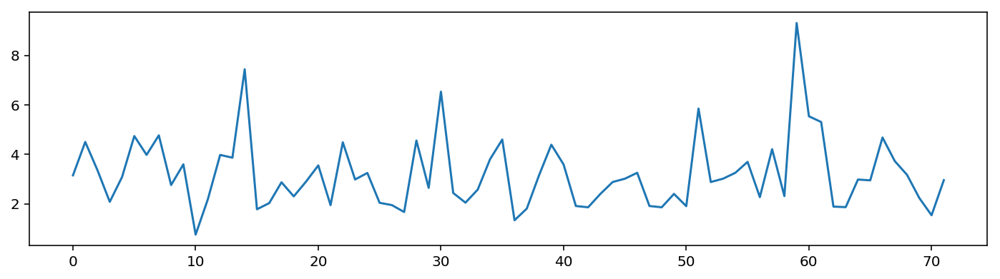

	 	 Test subset results
Test mean absolute percentage error per hour: 1.631622
Test mean absolute percentage error per day: 6.258961 
	 	 Validation Forecasting visualisation


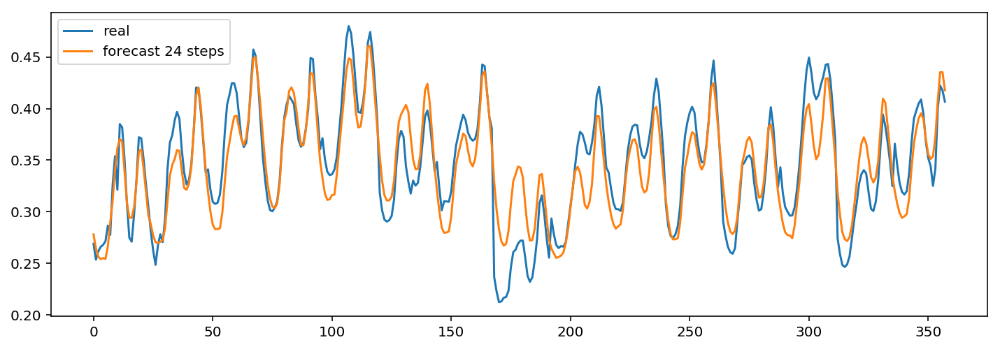

	 	 Forecasting a sample from Learning dataset


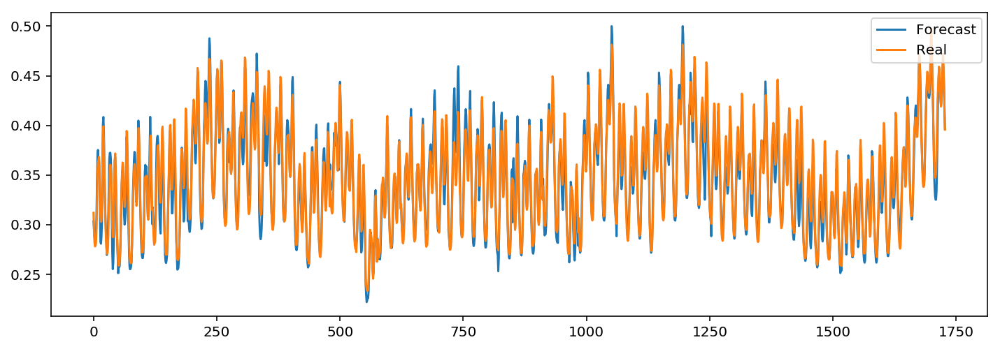

In [65]:
UsedInputsTemp= np.empty([10])
FinalErrorTemp= np.empty([2])
Parameters = np.empty([4])
ID= np.empty([1])
ID[0]=Model_ID


UsedInputsTemp[0] = previoushour = True
UsedInputsTemp[1] = timeSteps = 12
UsedInputsTemp[2] = previousDay = True
UsedInputsTemp[3] = previousWeek = True
UsedInputsTemp[4] = Temp = True
UsedInputsTemp[5] = TempMax = True
UsedInputsTemp[6] = TempMin = True
UsedInputsTemp[7] = dayIndicator = True
UsedInputsTemp[8] = HourIndicator = True
UsedInputsTemp[9] = MonthIndicator = True

shift = False

learninginputs, learningoutputs, testinputs, testoutputs, nbrInputs = prepareInputs(daydata,season,UsedInputsTemp,testPeriod)
#learning vectors
inputx1 = np.array(pd.DataFrame(learninginputs.copy())).reshape(-1,nbrInputs)
outputx1 = np.array(pd.DataFrame(learningoutputs.copy()))

#test vectors
inputx2 = np.array(pd.DataFrame(testinputs.copy())).reshape(-1,nbrInputs)
outputx2 = np.array(pd.DataFrame(testoutputs.copy()))

Parameters[0]= HiddenNeurons1 = 20
Parameters[1]= HiddenNeurons2 = 10
Parameters[2]= LearningRate = 0.002

tempMLPmodels, tempErrorHistory,MLP_Model = create_Train_MLP_NN_Model(inputx1,outputx1,inputx2,outputx2,inputx1.shape[1],HiddenNeurons1=HiddenNeurons1,HiddenNeurons2=HiddenNeurons2
                                      ,Epoch=Epoch,LearningRate = LearningRate,Optimizer='Adam')

Parameters[3]= tempErrorHistory.argmin()

MLP_Model.save('Models/lstm_%d_%s_%s'%(Model_ID,season,today))
# MLP_Model = load_model('Models/lstm_%d_%s_%s'%(Model_ID,season,today))

clear_output()
print('==================================================================================')
print('\t \t test num : %s' %Model_ID )
print('==================================================================================')


LearningMAPE, testMAPE , LearningHourlyMAPE, LearningDailyForecast, LearningHourlyForecast  = getForecastingResults(
    tempMLPmodels, tempErrorHistory,learninginputs,learningoutputs,testinputs,testoutputs,MLP_Model,nbrInputs,shift,previoushour,season,timeSteps)
FinalErrorTemp[0] = LearningMAPE
FinalErrorTemp[1] = testMAPE

UsedInputList.append(UsedInputsTemp)
MAPErrorList.append(FinalErrorTemp)
ModelsList.append(MLP_Model)
ForecastingList.append(LearningDailyForecast)
Models_IDs.append(ID)
Models_parameters.append(Parameters)

print('==================================================================================')
print('\t \t Forecasting a sample from Learning dataset')
print('==================================================================================')
plt.figure(figsize=(12,4))
ForecastingList[Model_ID].index= range(ForecastingList[Model_ID].index.size)
plt.plot(ForecastingList[Model_ID].iloc[:,0],label='Forecast')
plt.plot(ForecastingList[Model_ID].iloc[:,1],label='Real')
plt.legend( loc=1, borderaxespad=0.4)
plt.show()

Model_ID = Model_ID + 1

In [66]:
xmodel = ModelsList[1]
xmodel.optimizer.lr.get_value()

array(0.0010000000474974513, dtype=float32)

In [16]:
def getForecastingResults2(learninginputs,learningoutputs,testinputs,testoutputs,Model, nbrInputs, IsShift,previoushour,season,timeSteps):
    
    testPeriod= 360
    
    predictionPeriod = learninginputs.index.size-testPeriod
    temp=learninginputs.iloc[:predictionPeriod-24].resample('D').sum()
    temp= temp.dropna()
    temp2=learninginputs.iloc[:predictionPeriod-24]

    
    
    
    dstart= testinputs.index[0]
    dstarti= 0
    dend= testinputs.index[testinputs.index.size-2]
    dendi= testinputs.shape[0]-2
    dend2= testinputs.index[testinputs.index.size-1]
    dend2i= testinputs.shape[0]-1
    
    testPeriod= 360

    forecasting_history=pd.DataFrame(np.random.randn(dendi, 3),columns=['real', 'forecast 24 steps','forecast 1 step'],index=pd.date_range(dstart,freq='H',periods=358))
    Hforecasting_history=pd.DataFrame(np.random.randn(dendi, 2),columns=['real', 'forecast'])


    validationInputs= testinputs.iloc[dstarti:dend2i,:].copy()
    validationOutputs= testoutputs.iloc[dstarti:dendi,:].copy()
    
    HvalidationInputs= testinputs.iloc[dstarti:dend2i,:].copy()

    for x in range(dstarti,dendi):
        if IsShift == True:
            forecast=Model.predict(validationInputs.iloc[x + 1].values.reshape(-1,1,nbrInputs))
            Hforecast=Model.predict(HvalidationInputs.iloc[x + 1].values.reshape(-1,1,nbrInputs))
        else :
            forecast=Model.predict(validationInputs.iloc[x + 0].values.reshape(-1,1,nbrInputs))
            Hforecast=Model.predict(HvalidationInputs.iloc[x + 0].values.reshape(-1,1,nbrInputs))
        
        forecasting_history.iloc[x,0]= testoutputs.iloc[x,0]
        forecasting_history.iloc[x,1]= forecast[0][0]
        forecasting_history.iloc[x,2]= Hforecast[0][0]
        
        
        Hforecasting_history.iloc[x,0]= testoutputs.iloc[x,0]
        Hforecasting_history.iloc[x,1]= Hforecast[0][0]

        if previoushour == True: 
            if IsShift == True:
                if ((x + 2)) + 1 < testPeriod - 1: 
                    validationInputs.iloc[x + 2,0] = forecast[0]
            else :
                for z in range(0,timeSteps):
                    if ((x +1)) + z + 1 < testPeriod - 1: 
                        validationInputs.iloc[x + 1 + z , z] = forecast[0]


    HtestMAPE= mean_absolute_percentage_error(Hforecasting_history.iloc[:,1], Hforecasting_history.iloc[:,0])
    testMAPE= mean_absolute_percentage_error(forecasting_history.iloc[:,1], forecasting_history.iloc[:,0])
    
    HtestMAE= mean_absolute_error(Hforecasting_history.iloc[:,1], Hforecasting_history.iloc[:,0])
    testMAE= mean_absolute_error(forecasting_history.iloc[:,1], forecasting_history.iloc[:,0])
    print('==================================================================================')
    print('\t \t Test subset results')
    print('==================================================================================')


    print('Test mean absolute percentage error per hour: %f' %HtestMAPE)
    print('Test mean absolute percentage error per day: %f ' %testMAPE)

    print('Test mean absolute error per hour: %f' %HtestMAE)
    print('Test mean absolute error per day: %f ' %testMAE)
    
    return forecasting_history

In [23]:
def getForecastingResults4( learninginputs, learningoutputs, testinputs, testoutputs, Model, nbrInputs, IsShift, previoushour, season, timeSteps):
        
    predictionPeriod = learninginputs.index.size
    temp=learninginputs.iloc[:predictionPeriod].resample('D').sum()
    temp= temp.dropna()
    temp2=learninginputs.iloc[:predictionPeriod]

    Model = Model
        
    LearningForecastingError=pd.DataFrame(np.random.randn((predictionPeriod)/24, 1))

    learningInputs= learninginputs.iloc[:learningoutputs.index.size].copy()
    learningOutputs= learningoutputs.iloc[:learningoutputs.index.size].copy()
    HlearningInputs= learninginputs.iloc[:learninginputs.index.size].copy()

    LearningDailyForecast=pd.DataFrame(np.random.randn(predictionPeriod, 3),index=temp2.index)
    LearningHourlyForecast=pd.DataFrame(np.random.randn(predictionPeriod, 2),index=temp2.index)
    

    print('==============================================================================')
    print('\t \t learning subset results')
    print('==============================================================================')

    for y in range(0,predictionPeriod/24):
        dailyError = 0

        for x in range(0,24):

            if IsShift == True:
                Hforecast=Model.predict(HlearningInputs.iloc[x + (y * 24) + 1].values.reshape(-1,1,nbrInputs))
                forecast=Model.predict(learningInputs.iloc[x + (y * 24) + 1].values.reshape(-1,1,nbrInputs))
            else :
                Hforecast=Model.predict(HlearningInputs.iloc[x + (y * 24)].values.reshape(-1,1,nbrInputs))
                forecast=Model.predict(learningInputs.iloc[x + (y * 24)].values.reshape(-1,1,nbrInputs))
                
            dailyError = dailyError + (np.abs(((learningOutputs.iloc[x + (y * 24),0] - forecast[0]) / 
                                              learningOutputs.iloc[x + (y * 24),0]))*100)
            
            LearningDailyForecast.iloc[x + (y * 24),0]= learningOutputs.iloc[x + (y * 24),0]
            LearningDailyForecast.iloc[x + (y * 24),1]= forecast
            LearningDailyForecast.iloc[x + (y * 24),2]= Hforecast
            
            LearningHourlyForecast.iloc[x + (y * 24),0]= learningOutputs.iloc[x + (y * 24),0]
            LearningHourlyForecast.iloc[x + (y * 24),1]= Hforecast

            
            if previoushour == True: 
                if IsShift == True: 
                    if x + 2 < 24: learningInputs.iloc[(x + (y * 24)) + 2,0] = forecast[0]
                else :
                     for z in range(0,timeSteps):
                        if x + z + 1 < 24: learningInputs.iloc[(x + (y * 24)) + 1 + z, z] = forecast[0]
        
        dailyError = (dailyError / 24)

        LearningForecastingError.iloc[y,0] = dailyError

    HlearningMAPE= mean_absolute_percentage_error(LearningHourlyForecast.iloc[:,1], LearningHourlyForecast.iloc[:,0])
    LearningMAPE= mean_absolute_percentage_error(LearningDailyForecast.iloc[:,1], LearningDailyForecast.iloc[:,0])
    
    HlearningMAE= mean_absolute_error(LearningHourlyForecast.iloc[:,1], LearningHourlyForecast.iloc[:,0])
    LearningMAE= mean_absolute_error(LearningDailyForecast.iloc[:,1], LearningDailyForecast.iloc[:,0])
    
    HlearningRMSE= rmse(LearningHourlyForecast.iloc[:,1], LearningHourlyForecast.iloc[:,0])
    LearningRMSE= rmse(LearningDailyForecast.iloc[:,1], LearningDailyForecast.iloc[:,0])
    
#     HlearningMAPE= mean_absolute_percentage_error(LearningHourlyForecast.iloc[:,1], LearningHourlyForecast.iloc[:,0])
    print('Hourly Learning mean absolute percentage error of %d hours : %s ' %(LearningHourlyForecast.shape[0] , HlearningMAPE))

#     LearningMAPE = LearningForecastingError.mean()
    print('Daily Learning mean absolute percentage error of %d days : %s ' %(LearningHourlyForecast.shape[0]/24 ,LearningMAPE))
    
    
    
#     HlearningMAE= mean_absolute_error(LearningHourlyForecast.iloc[:,1], LearningHourlyForecast.iloc[:,0])
    print('Hourly Learning mean absolute error of %d hours : %s ' %(LearningHourlyForecast.shape[0] , HlearningMAE))

#     LearningMAE = LearningForecastingError.mean()
    print('Daily Learning mean absolute error of %d days : %s ' %(LearningHourlyForecast.shape[0]/24 ,LearningMAE))
    
    
    
#     HlearningMAE= mean_absolute_error(LearningHourlyForecast.iloc[:,1], LearningHourlyForecast.iloc[:,0])
    print('Hourly Learning root mean square error of %d hours : %s ' %(LearningHourlyForecast.shape[0] , HlearningRMSE))

#     LearningMAE = LearningForecastingError.mean()
    print('Daily Learning root mean square error of %d days : %s ' %(LearningHourlyForecast.shape[0]/24 ,LearningRMSE))
    
    print('==================================================================================')
    print('\t \t MAPError plot through Learning DataSet ')
    print('==================================================================================')
    
    fig = plt.figure(figsize=(12,3))
    plt.plot(LearningForecastingError,label='Error')
    plt.show()
    
    dstart= testinputs.index[0]
    dstarti= 0
    dend= testinputs.index[testinputs.index.size-2]
    dendi= testinputs.shape[0]-2
    dend2= testinputs.index[testinputs.index.size-1]
    dend2i= testinputs.shape[0]-1
    
    
    forecasting_history=pd.DataFrame(np.random.randn(dendi, 2),columns=['real', 'forecast 24 steps'])
    Hforecasting_history=pd.DataFrame(np.random.randn(dendi, 2),columns=['real', 'forecast'])


    validationInputs= testinputs.iloc[dstarti:dend2i,:].copy()
    validationOutputs= testoutputs.iloc[dstarti:dendi,:].copy()
    
    HvalidationInputs= testinputs.iloc[dstarti:dend2i,:].copy()

    for x in range(dstarti,dendi):
        if IsShift == True:
            forecast=Model.predict(validationInputs.iloc[x + 1].values.reshape(-1,1,nbrInputs))
            Hforecast=Model.predict(HvalidationInputs.iloc[x + 1].values.reshape(-1,nbrInputs))
        else :
            forecast=Model.predict(validationInputs.iloc[x + 0].values.reshape(-1,1,nbrInputs))
            Hforecast=Model.predict(HvalidationInputs.iloc[x + 0].values.reshape(-1,1,nbrInputs))
        
        forecasting_history.iloc[x,0]= testoutputs.iloc[x,0]
        forecasting_history.iloc[x,1]= forecast[0][0]
#         forecasting_history.iloc[x,2]= Hforecast[0][0]
        
        
        Hforecasting_history.iloc[x,0]= testoutputs.iloc[x,0]
        Hforecasting_history.iloc[x,1]= Hforecast[0][0]

        if previoushour == True: 
            if IsShift == True:
                if ((x + 2)) + 1 < testPeriod - 1: 
                    validationInputs.iloc[x + 2,0] = forecast[0]
            else :
                for z in range(0,timeSteps):
                    if ((x +1)) + z + 1 < testPeriod - 1: 
                        validationInputs.iloc[x + 1 + z , z] = forecast[0]

    
    HtestMAPE= mean_absolute_percentage_error(Hforecasting_history.iloc[:,1], Hforecasting_history.iloc[:,0])
    testMAPE= mean_absolute_percentage_error(forecasting_history.iloc[:,1], forecasting_history.iloc[:,0])
    
    HtestMAE= mean_absolute_error(Hforecasting_history.iloc[:,1], Hforecasting_history.iloc[:,0])
    testMAE= mean_absolute_error(forecasting_history.iloc[:,1], forecasting_history.iloc[:,0])
    
    HtestRMSE= rmse(Hforecasting_history.iloc[:,1], Hforecasting_history.iloc[:,0])
    testRMSE= rmse(forecasting_history.iloc[:,1], forecasting_history.iloc[:,0])
    
    print('==================================================================================')
    print('\t \t Test subset results')
    print('==================================================================================')


    print('Test mean absolute percentage error per hour: %f' %HtestMAPE)
    print('Test mean absolute percentage error per day: %f ' %testMAPE)
    
    print('Test mean absolute error per hour: %f' %HtestMAE)
    print('Test mean absolute error per day: %f ' %testMAE)
    
    print('Test mean absolute error per hour: %f' %HtestRMSE)
    print('Test mean absolute error per day: %f ' %testRMSE)


    print('==================================================================================')
    print('\t \t Validation Forecasting visualisation')
    print('==================================================================================')
    fig = plt.figure(figsize=(12,4))
    plt.plot(forecasting_history[:dendi], label=['real','forecast 24 steps'])
    plt.legend(labels=['real','forecast 24 steps'],loc= 'best')
    plt.show()
    
    return LearningMAPE, testMAPE, HlearningMAPE, LearningDailyForecast, LearningHourlyForecast

	 	 learning subset results
Hourly Learning mean absolute percentage error of 1872 hours : 1.16620788059 
Daily Learning mean absolute percentage error of 78 days : 3.5265676799 
Hourly Learning mean absolute error of 1872 hours : 0.00401083298959 
Daily Learning mean absolute error of 78 days : 0.0119833018796 
Hourly Learning root mean square error of 1872 hours : 0.0060569462303816405 
Daily Learning root mean square error of 78 days : 0.01574271752640826 
	 	 MAPError plot through Learning DataSet 


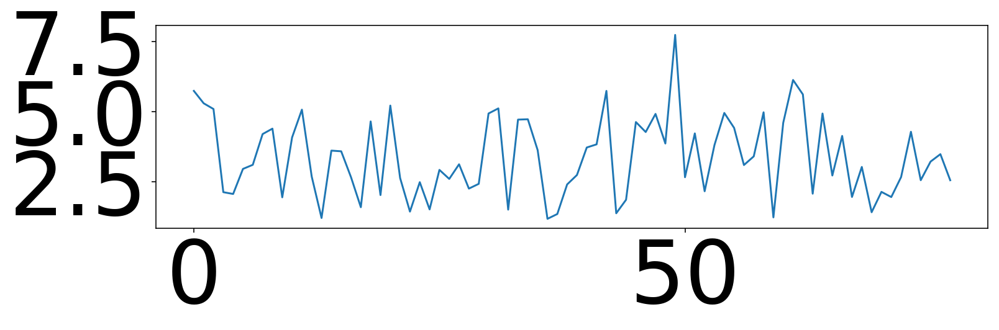

	 	 Test subset results
Test mean absolute percentage error per hour: 1.324619
Test mean absolute percentage error per day: 3.622896 
Test mean absolute error per hour: 0.004550
Test mean absolute error per day: 0.012566 
Test mean absolute error per hour: 0.006025
Test mean absolute error per day: 0.015863 
	 	 Validation Forecasting visualisation


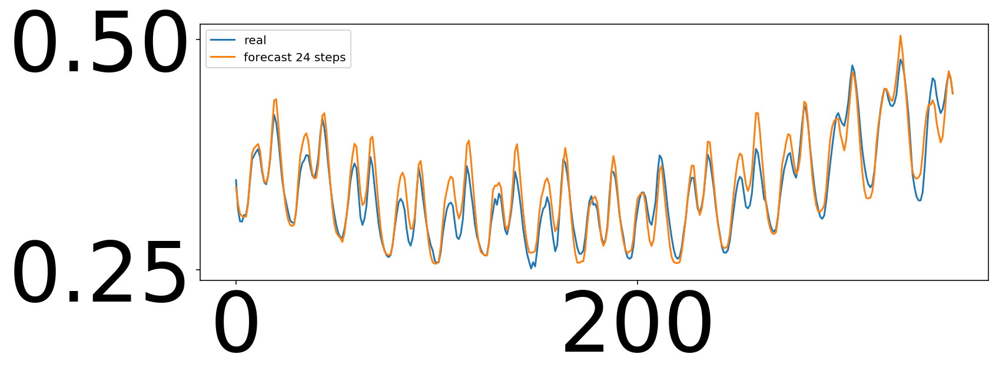

	 	 Test subset results
Test mean absolute percentage error per hour: 1.324619
Test mean absolute percentage error per day: 3.622896 
Test mean absolute error per hour: 0.004550
Test mean absolute error per day: 0.012566 


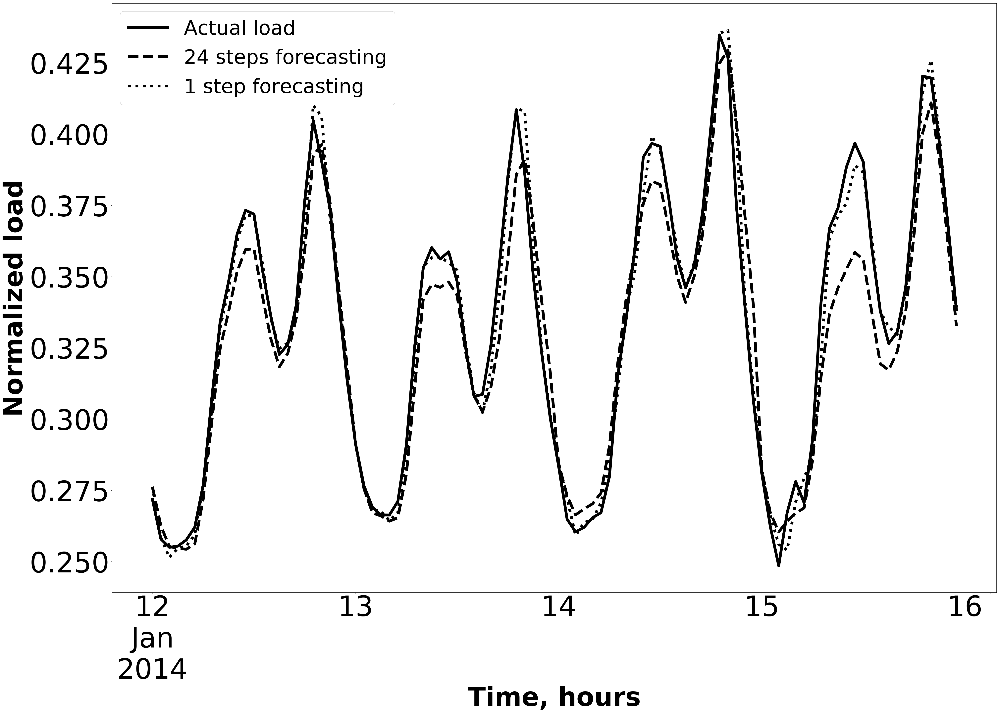

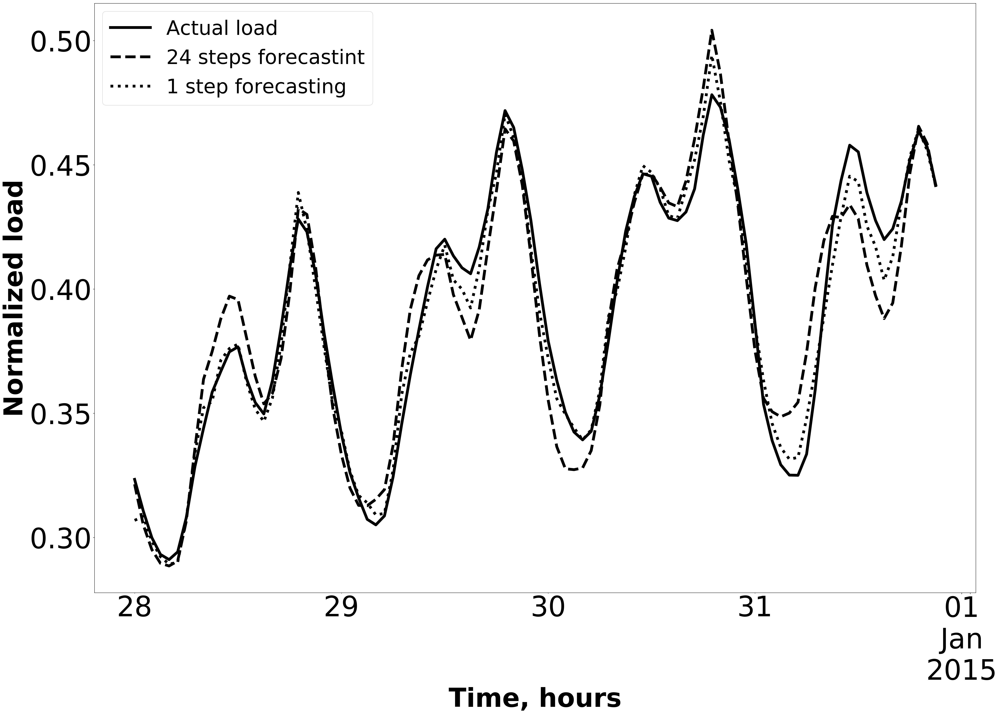

In [30]:
UsedInputsTemp= np.empty([9])
FinalErrorTemp= np.empty([2])
Parameters = np.empty([4])

UsedInputsTemp[0] = previoushour = True
UsedInputsTemp[1] = timeSteps = 12
UsedInputsTemp[2] = previousDay = True
UsedInputsTemp[3] = previousWeek = True
UsedInputsTemp[4] = Temp = True
UsedInputsTemp[5] = TempMax = True
UsedInputsTemp[6] = TempMin = True
UsedInputsTemp[7] = dayIndicator = True
UsedInputsTemp[8] = HourIndicator = True

shift = False

# learninginputs, learningoutputs, testinputs, testoutputs, nbrInputs = prepareInputs(daydata,season,UsedInputsTemp,testPeriod)


LSTM_Model = load_model('Models/winter/lstm_43_2018-07-22')
# LSTM_Model= ModelsList[43]
LearningMAPE, testMAPE , LearningHourlyMAPE, LearningDailyForecast, LearningHourlyForecast  = getForecastingResults4(
    learninginputs,learningoutputs,testinputs,testoutputs,LSTM_Model,nbrInputs,shift,previoushour,season,timeSteps)



# LearningDailyForecast=ForecastingList[0]

TestHourlyForecast = getForecastingResults2(
    learninginputs,learningoutputs,testinputs,testoutputs,LSTM_Model,nbrInputs,shift,previoushour,season,timeSteps)

plt.rc('xtick', labelsize=70)    # fontsize of the tick labels
plt.rc('ytick', labelsize=70)

a1=4
b1=8

a2=11
b2=15

LearningDailyForecast.iloc[a1*24:b1*24,0].plot(label='Actual load',c='black',marker='.',linewidth=7,linestyle='-',figsize=(35,25))
LearningDailyForecast.iloc[a1*24:b1*24,1].plot(label='24 steps forecasting',c='black',linewidth=7,linestyle='--')
LearningDailyForecast.iloc[a1*24:b1*24,2].plot(label='1 step forecasting',c='black',linewidth=7,linestyle=':')
plt.ylabel('Normalized load',fontsize=65,weight='bold')
plt.xlabel('Time, hours',fontsize=65,weight='bold')
plt.legend(fontsize=50, loc='upper left', borderaxespad=0.4)

plt.tight_layout()
plt.savefig('WinterLearning.pdf')

plt.show()


TestHourlyForecast.iloc[a2*24:b2*24,0].plot(label='Actual load',c='black',marker='.',linestyle='-',linewidth=7,figsize=(35,25))
TestHourlyForecast.iloc[a2*24:b2*24,1].plot(label='24 steps forecastint',c='black',linewidth=7,linestyle='--')
TestHourlyForecast.iloc[a2*24:b2*24,2].plot(label='1 step forecasting',c='black',linewidth=7,linestyle=':')
plt.legend( fontsize= 50,loc='best', borderaxespad=0.4)
plt.ylabel('Normalized load',fontsize=65,weight='bold')
plt.xlabel('Time, hours',fontsize=65,weight='bold')

plt.tight_layout()
plt.savefig('WinterTest.pdf')

plt.show()


	 	 learning subset results
Hourly Learning mean absolute percentage error of 1872 hours : 1.16620783397 
Daily Learning mean absolute percentage error of 78 days : 3.5265659048 
Hourly Learning mean absolute error of 1872 hours : 0.00401083271099 
Daily Learning mean absolute error of 78 days : 0.0119832965862 
	 	 MAPError plot through Learning DataSet 


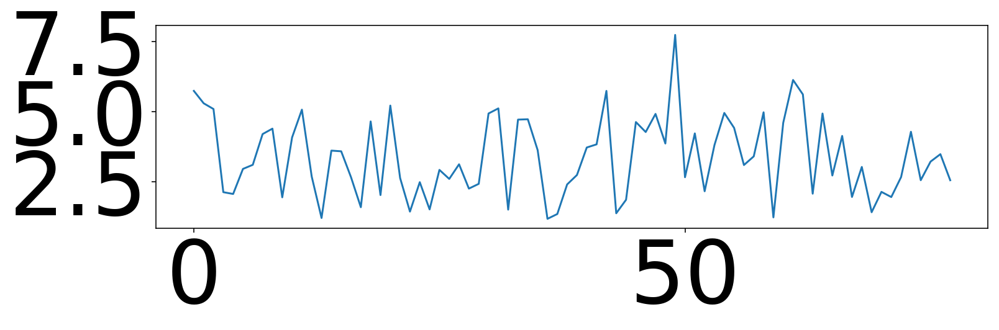

	 	 Test subset results
Test mean absolute percentage error per hour: 1.324619
Test mean absolute percentage error per day: 3.622898 
Test mean absolute error per hour: 0.004550
Test mean absolute error per day: 0.012566 
	 	 Validation Forecasting visualisation


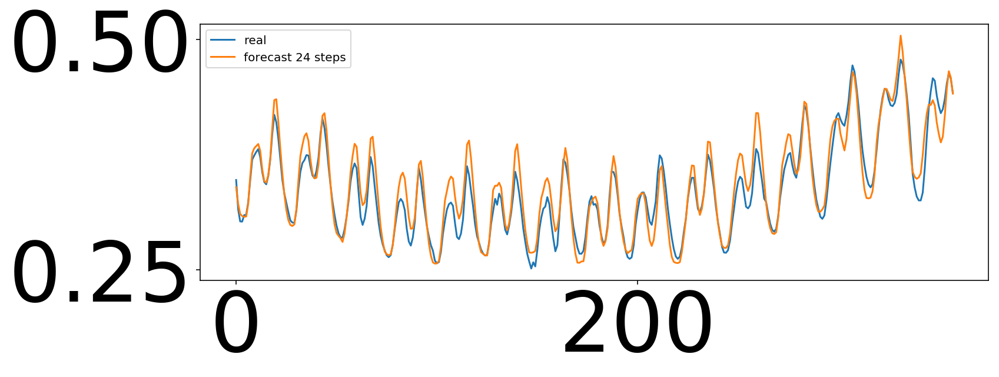

	 	 Forecasting a sample from Learning dataset


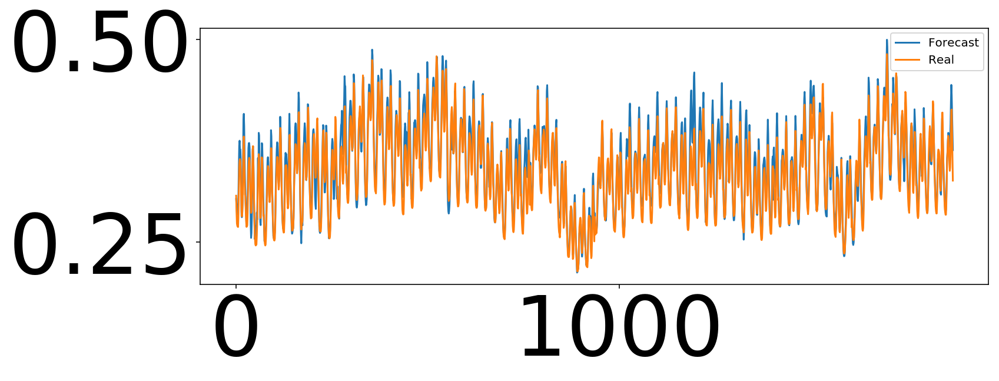

In [134]:
LearningMAPE, testMAPE , LearningHourlyMAPE, LearningDailyForecast, LearningHourlyForecast  = getForecastingResults(
    tempMLPmodels, tempErrorHistory,learninginputs,learningoutputs,testinputs,testoutputs,LSTM_Model,nbrInputs,shift,previoushour,season,timeSteps)
FinalErrorTemp[0] = LearningMAPE
FinalErrorTemp[1] = testMAPE

print('==================================================================================')
print('\t \t Forecasting a sample from Learning dataset')
print('==================================================================================')
plt.figure(figsize=(12,4))
ForecastingList[1].index= range(ForecastingList[1].index.size)
plt.plot(ForecastingList[1].iloc[:,0],label='Forecast')
plt.plot(ForecastingList[1].iloc[:,1],label='Real')
plt.legend( loc=1, borderaxespad=0.4)
plt.show()

	 	 learning subset results
Hourly Learning mean absolute percentage error of 1872 hours : 1.16620788059 
Daily Learning mean absolute percentage error of 78 days : 3.5265676799 
Hourly Learning mean absolute error of 1872 hours : 0.00401083298959 
Daily Learning mean absolute error of 78 days : 0.0119833018796 
Hourly Learning root mean square error of 1872 hours : 0.0060569462303816405 
Daily Learning root mean square error of 78 days : 0.01574271752640826 
	 	 MAPError plot through Learning DataSet 


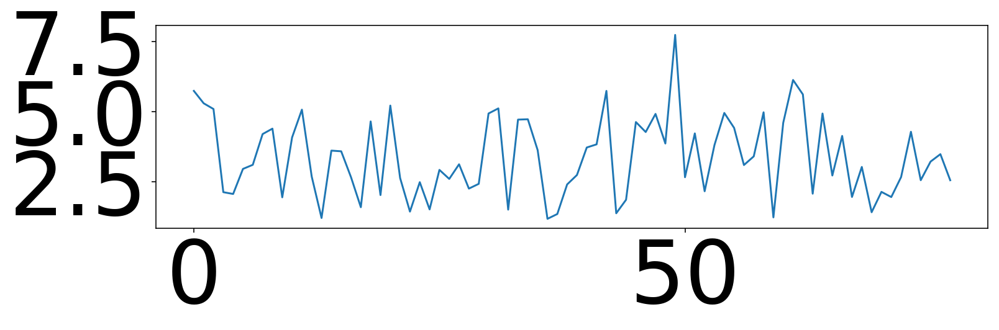

	 	 Test subset results
Test mean absolute percentage error per hour: 1.324619
Test mean absolute percentage error per day: 3.622896 
Test mean absolute error per hour: 0.004550
Test mean absolute error per day: 0.012566 
Test mean absolute error per hour: 0.006025
Test mean absolute error per day: 0.015863 
	 	 Validation Forecasting visualisation


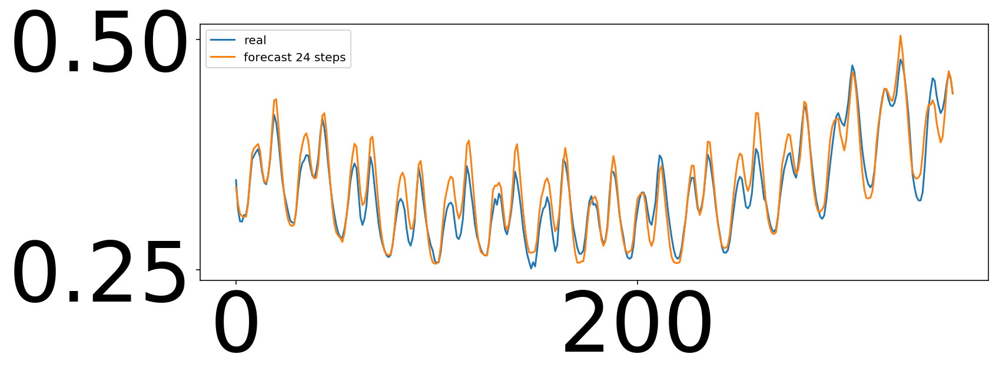

	 	 Forecasting a sample from Learning dataset


IndexError: list index out of range

<Figure size 864x288 with 0 Axes>

In [26]:
LearningMAPE, testMAPE , LearningHourlyMAPE, LearningDailyForecast, LearningHourlyForecast  = getForecastingResults4(
    learninginputs,learningoutputs,testinputs,testoutputs,LSTM_Model,nbrInputs,shift,previoushour,season,timeSteps)
FinalErrorTemp[0] = LearningMAPE
FinalErrorTemp[1] = testMAPE

print('==================================================================================')
print('\t \t Forecasting a sample from Learning dataset')
print('==================================================================================')
plt.figure(figsize=(12,4))
ForecastingList[1].index= range(ForecastingList[1].index.size)
plt.plot(ForecastingList[1].iloc[:,0],label='Forecast')
plt.plot(ForecastingList[1].iloc[:,1],label='Real')
plt.legend( loc=1, borderaxespad=0.4)
plt.show()